In [1]:
from importlib import reload
import os

import numpy as np

import mne
import mne_bids

In [2]:
def get_all_files(path, suffix, get_bids=False, prefix=None, bids_root=None, verbose=False):
    """Return all files in all (sub-)directories of path with given suffixes and prefixes (case-insensitive).

    Args:
        path (string)
        suffix (iterable): e.g. ["vhdr", "edf"] or ".json"
        get_bids (boolean): True if BIDS_Path type should be returned instead of string. Default: False
        bids_root (string/path): Path of BIDS root folder. Only required if get_bids=True.
        prefix (iterable): e.g. ["SelfpacedRota", "ButtonPress] (optional)

    Returns:
        filepaths (list of strings or list of BIDS_Path)
    """

    if isinstance(suffix, str):
        suffix = [suffix]
    if isinstance(prefix, str):
        prefix = [prefix]

    filepaths = []
    for root, dirs, files in os.walk(path):
        for file in files:
            for suff in suffix:
                if file.endswith(suff.lower()):
                    if not prefix:
                        filepaths.append(os.path.join(root, file))
                    else:
                        for pref in prefix:
                            if pref.lower() in file.lower():
                                filepaths.append(os.path.join(root, file))

    bids_paths = filepaths
    if get_bids:
        if not bids_root:
            print("Warning: No root folder given. Please pass bids_root parameter to create a complete BIDS_Path object.")
        bids_paths = []
        for filepath in filepaths:
            entities = mne_bids.get_entities_from_fname(filepath)
            try:
                bids_path = mne_bids.BIDSPath(subject=entities["subject"], session=entities["session"], task=entities["task"], run=entities["run"], acquisition=entities["acquisition"], datatype="ieeg", root=bids_root)
            except ValueError as err:
                print(f"ValueError while creating BIDS_Path object for file {filepath}: {err}")
            else:
                bids_paths.append(bids_path)

    if verbose:
        if not bids_paths:
            print("No corresponding files found.")
        else:    
            print('Corresponding files found:')
            for idx, file in enumerate(bids_paths):
                print(idx, ':', os.path.basename(file))
                
    return bids_paths

In [78]:
def rename_chs(raw_obj, new_chs, picks=None):
    """Rename channels and set new channel type."""
    assert (len(raw_obj.ch_names) == len(new_chs))
    renaming_dict = {}
    for idx, old_ch in enumerate(raw_obj.ch_names):
        renaming_dict[old_ch] = new_chs[idx][0:15]
    raw_obj = raw_obj.rename_channels(renaming_dict)
    type_dict = {}
    for ch in raw_obj.ch_names:
        if ch.startswith('ECOG'):
            type_dict[ch] = 'ecog'
        elif ch.startswith('LFP'):
            type_dict[ch] = 'seeg'
        elif ch.startswith('EMG'):
            type_dict[ch] = 'emg'
        elif ch.startswith('EEG'):
            type_dict[ch] = 'eeg'
        else:
            type_dict[ch] = 'misc'
    raw_obj = raw_obj.set_channel_types(type_dict)
    if picks:
        assert (len(picks) != len(raw_obj.ch_names))
        picks = [pick[0:15] for pick in picks]
        raw_obj.pick(picks=picks)
    raw_obj.reorder_channels(sorted(raw_obj.ch_names))
    ch_types = raw_obj.get_channel_types()
    for idx, ch in enumerate(raw_obj.ch_names):
        print(ch, ': ', ch_types[idx])
    return raw_obj

In [4]:
root = r'C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata'

In [5]:
out_path = r'C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new'

In [6]:
files = get_all_files(path=root,
    suffix="vhdr",
    get_bids=True,
    prefix=None,
    bids_root=root,
    verbose=True)

Corresponding files found:
0 : sub-001_ses-EphysMedOff01_task-BlockRotationR_acq-StimOffOn_run-01_ieeg.vhdr
1 : sub-001_ses-EphysMedOff01_task-Rest_acq-StimOff_run-01_ieeg.vhdr
2 : sub-001_ses-EphysMedOff01_task-Rest_acq-StimOff_run-02_ieeg.vhdr
3 : sub-001_ses-EphysMedOff01_task-Rest_acq-StimOn_run-01_ieeg.vhdr
4 : sub-001_ses-EphysMedOff01_task-Rest_acq-StimOn_run-02_ieeg.vhdr
5 : sub-001_ses-EphysMedOff01_task-Visuomotor_acq-StimOff_run-01_ieeg.vhdr
6 : sub-001_ses-EphysMedOff01_task-Visuomotor_acq-StimOn_run-01_ieeg.vhdr
7 : sub-001_ses-EphysMedOn01_task-BlockRotationWheel_acq-StimOff_run-01_ieeg.vhdr
8 : sub-001_ses-EphysMedOn01_task-FreeDrawing_acq-StimOff_run-01_ieeg.vhdr
9 : sub-001_ses-EphysMedOn01_task-Rest_acq-StimOff_run-01_ieeg.vhdr
10 : sub-001_ses-EphysMedOn01_task-Rest_acq-StimOn_run-01_ieeg.vhdr
11 : sub-001_ses-EphysMedOn01_task-SelfpacedForceWheel_acq-StimOff_run-01_ieeg.vhdr
12 : sub-001_ses-EphysMedOn02_task-BlockRotationL_acq-StimOffOn_run-01_ieeg.vhdr
13 : sub-00

In [7]:
raws = []
for file in files:
    raw = mne_bids.read_raw_bids(file)
    raws.append(raw)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOff01\ieeg\sub-001_ses-EphysMedOff01_task-BlockRotationR_acq-StimOffOn_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOff01\ieeg\sub-001_ses-EphysMedOff01_task-BlockRotationR_acq-StimOffOn_run-01_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOff01\ieeg\sub-001_ses-EphysMedOff01_task-Rest_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOff01\ieeg\sub-001_ses-EphysMedOff01_task-Rest_acq-StimOff_run-01_channels.tsv.
Extracting param

c:\users\richa\github\mne-bids\mne_bids\read.py:53: RuntimeWarning: 1 channel names are too long, have been truncated to 15 characters:
['ANALOG_2_ROTA_AO']
  raw = reader[ext](raw_fpath, **kwargs)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-001_ses-EphysMedOff01_task-BlockRotationR_acq-StimOffOn_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\**\sub-001_ses-EphysMedOff01*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-001_ses-EphysMedOff01_task-Rest_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\**\sub-001_ses-EphysMedOff01*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\read.py:53: RuntimeWarning: Online software filter d

Setting channel info structure...
Reading events from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOff01\ieeg\sub-001_ses-EphysMedOff01_task-Rest_acq-StimOn_run-02_events.tsv.
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOff01\ieeg\sub-001_ses-EphysMedOff01_task-Rest_acq-StimOn_run-02_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOff01\ieeg\sub-001_ses-EphysMedOff01_task-Visuomotor_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading events from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOff01\ieeg\sub-001_ses-EphysMedOff01_task-Visuomotor_acq-StimOff_run-01_events.tsv.
Reading channel info from C:\Users\richa\OneDr

c:\users\richa\github\mne-bids\mne_bids\read.py:53: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  raw = reader[ext](raw_fpath, **kwargs)
c:\users\richa\github\mne-bids\mne_bids\read.py:53: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  raw = reader[ext](raw_fpath, **kwargs)
c:\users\richa\github\mne-bids\mne_bids\read.py:53: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  raw = reader[ext](raw_fpath, **kwargs)
c:\users\richa\github\mne-bids\mne_bids\read.py:53: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  raw = reader[ext](raw_fpath, **kwargs)


Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOn01\ieeg\sub-001_ses-EphysMedOn01_task-BlockRotationWheel_acq-StimOff_run-01_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOn01\ieeg\sub-001_ses-EphysMedOn01_task-FreeDrawing_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOn01\ieeg\sub-001_ses-EphysMedOn01_task-FreeDrawing_acq-StimOff_run-01_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOn01\ieeg\sub-001_ses-EphysMedOn01_task-Rest_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info

c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-001_ses-EphysMedOn01_task-BlockRotationWheel_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\**\sub-001_ses-EphysMedOn01*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\read.py:53: RuntimeWarning: 2 channel names are too long, have been truncated to 15 characters:
['ANALOG_1_ROTA_AO', 'ANALOG_2_ROTA_AO']
  raw = reader[ext](raw_fpath, **kwargs)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-001_ses-EphysMedOn01_task-FreeDrawing_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\**\sub-001_ses-EphysMedOn01*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarnin

Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOn01\ieeg\sub-001_ses-EphysMedOn01_task-SelfpacedForceWheel_acq-StimOff_run-01_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOn02\ieeg\sub-001_ses-EphysMedOn02_task-BlockRotationL_acq-StimOffOn_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOn02\ieeg\sub-001_ses-EphysMedOn02_task-BlockRotationL_acq-StimOffOn_run-01_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOn02\ieeg\sub-001_ses-EphysMedOn02_task-BlockRotationR_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...

c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-001_ses-EphysMedOn01_task-SelfpacedForceWheel_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\**\sub-001_ses-EphysMedOn01*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\read.py:53: RuntimeWarning: 2 channel names are too long, have been truncated to 15 characters:
['ANALOG_1_ROTA_AO', 'ANALOG_2_ROTA_AO']
  raw = reader[ext](raw_fpath, **kwargs)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-001_ses-EphysMedOn02_task-BlockRotationL_acq-StimOffOn_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\**\sub-001_ses-EphysMedOn02*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\read.py:53: RuntimeWa

Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOn02\ieeg\sub-001_ses-EphysMedOn02_task-Rest_acq-StimOff_run-01_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOn02\ieeg\sub-001_ses-EphysMedOn02_task-Rest_acq-StimOn_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOn02\ieeg\sub-001_ses-EphysMedOn02_task-Rest_acq-StimOn_run-01_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOn02\ieeg\sub-001_ses-EphysMedOn02_task-Rest_acq-StimOn_run-02_ieeg.vhdr...
Setting channel info structure...
Reading channel i

c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-001_ses-EphysMedOn02_task-Rest_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\**\sub-001_ses-EphysMedOn02*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-001_ses-EphysMedOn02_task-Rest_acq-StimOn_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\**\sub-001_ses-EphysMedOn02*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\read.py:53: RuntimeWarning: 2 channel names are too long, have been truncated to 15 characters:
['ANALOG_1_ROTA_AO', 'ANALOG_2_ROTA_AO']
  raw = reader[ext](raw_fpath, **kwargs)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any ev

Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff01\ieeg\sub-002_ses-EphysMedOff01_task-Rest_acq-StimOff_run-02_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff02\ieeg\sub-002_ses-EphysMedOff02_task-Evoked_acq-StimOn_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff02\ieeg\sub-002_ses-EphysMedOff02_task-Evoked_acq-StimOn_run-01_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff02\ieeg\sub-002_ses-EphysMedOff02_task-Evoked_acq-StimOn_run-02_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\ri

c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-002_ses-EphysMedOff02_task-Evoked_acq-StimOn_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\**\sub-002_ses-EphysMedOff02*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-002_ses-EphysMedOff02_task-Evoked_acq-StimOn_run-02.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\**\sub-002_ses-EphysMedOff02*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-002_ses-EphysMedOff02_task-Evoked_acq-StimOn_run-03.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\**\

Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff02\ieeg\sub-002_ses-EphysMedOff02_task-Rest_acq-StimOff_run-02_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff02\ieeg\sub-002_ses-EphysMedOff02_task-Rest_acq-StimOff_run-03_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff02\ieeg\sub-002_ses-EphysMedOff02_task-Rest_acq-StimOff_run-03_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff02\ieeg\sub-002_ses-EphysMedOff02_task-SelfpacedRotationR_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info struc

c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-002_ses-EphysMedOff02_task-Rest_acq-StimOff_run-02.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\**\sub-002_ses-EphysMedOff02*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-002_ses-EphysMedOff02_task-Rest_acq-StimOff_run-03.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\**\sub-002_ses-EphysMedOff02*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-002_ses-EphysMedOff02_task-Speech_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\**\s

Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff03\ieeg\sub-002_ses-EphysMedOff03_task-Rest_acq-StimOff_run-01_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff03\ieeg\sub-002_ses-EphysMedOff03_task-Rest_acq-StimOff_run-02_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff03\ieeg\sub-002_ses-EphysMedOff03_task-Rest_acq-StimOff_run-02_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff03\ieeg\sub-002_ses-EphysMedOff03_task-Rest_acq-StimOff_run-03_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa

c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-002_ses-EphysMedOff03_task-Rest_acq-StimOff_run-02.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\**\sub-002_ses-EphysMedOff03*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-002_ses-EphysMedOff03_task-Rest_acq-StimOff_run-03.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\**\sub-002_ses-EphysMedOff03*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-002_ses-EphysMedOff03_task-Rest_acq-StimOff_run-04.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\**\sub

Setting channel info structure...
Reading events from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff03\ieeg\sub-002_ses-EphysMedOff03_task-SelfpacedRotationR_acq-StimOff_run-01_events.tsv.
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff03\ieeg\sub-002_ses-EphysMedOff03_task-SelfpacedRotationR_acq-StimOff_run-01_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff03\ieeg\sub-002_ses-EphysMedOff03_task-SelfpacedRotationR_acq-StimOn_run-01_ieeg.vhdr...
Setting channel info structure...
Reading events from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff03\ieeg\sub-002_ses-EphysMedOff03_task-SelfpacedRotationR_acq-StimOn_run-01_events.tsv.
Re

c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-003_ses-EphysMedOff01_task-BlockRotationR_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-003\**\sub-003_ses-EphysMedOff01*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\read.py:53: RuntimeWarning: 1 channel names are too long, have been truncated to 15 characters:
['Counter 2power24']
  raw = reader[ext](raw_fpath, **kwargs)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-003_ses-EphysMedOff01_task-Rest_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-003\**\sub-003_ses-EphysMedOff01*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\read.py:53: RuntimeWarning: 1 channel names are too lo

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-003\ses-EphysMedOff01\ieeg\sub-003_ses-EphysMedOff01_task-UPDRSIII_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-003\ses-EphysMedOff01\ieeg\sub-003_ses-EphysMedOff01_task-UPDRSIII_acq-StimOff_run-01_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-003\ses-EphysMedOff01\ieeg\sub-003_ses-EphysMedOff01_task-UPDRSIII_acq-StimOff_run-02_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-003\ses-EphysMedOff01\ieeg\sub-003_ses-EphysMedOff01_task-UPDRSIII_acq-StimOff_run-02_channels.tsv.
Extracting parameters fr

c:\users\richa\github\mne-bids\mne_bids\read.py:53: RuntimeWarning: 1 channel names are too long, have been truncated to 15 characters:
['Counter 2power24']
  raw = reader[ext](raw_fpath, **kwargs)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-003_ses-EphysMedOff01_task-UPDRSIII_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-003\**\sub-003_ses-EphysMedOff01*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\read.py:53: RuntimeWarning: 1 channel names are too long, have been truncated to 15 characters:
['Counter 2power24']
  raw = reader[ext](raw_fpath, **kwargs)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-003_ses-EphysMedOff01_task-UPDRSIII_acq-StimOff_run-02.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin 

Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-003\ses-EphysMedOn02\ieeg\sub-003_ses-EphysMedOn02_task-UPDRSIII_acq-StimOff_run-01_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-003\ses-EphysMedOn03\ieeg\sub-003_ses-EphysMedOn03_task-BlockRotationR_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-003\ses-EphysMedOn03\ieeg\sub-003_ses-EphysMedOn03_task-BlockRotationR_acq-StimOff_run-01_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-003\ses-EphysMedOn03\ieeg\sub-003_ses-EphysMedOn03_task-Rest_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info str

c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-003_ses-EphysMedOn02_task-UPDRSIII_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-003\**\sub-003_ses-EphysMedOn02*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-003_ses-EphysMedOn03_task-BlockRotationR_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-003\**\sub-003_ses-EphysMedOn03*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\read.py:53: RuntimeWarning: 1 channel names are too long, have been truncated to 15 characters:
['Counter 2power24']
  raw = reader[ext](raw_fpath, **kwargs)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.

Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOff01\ieeg\sub-004_ses-EphysMedOff01_task-BlockRotationL_acq-StimOff_run-01_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOff01\ieeg\sub-004_ses-EphysMedOff01_task-BlockRotationR_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOff01\ieeg\sub-004_ses-EphysMedOff01_task-BlockRotationR_acq-StimOff_run-01_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOff01\ieeg\sub-004_ses-EphysMedOff01_task-RestTransition_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...


c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOff01_task-BlockRotationR_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\**\sub-004_ses-EphysMedOff01*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOff01_task-RestTransition_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\**\sub-004_ses-EphysMedOff01*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOff01_task-RestTransition_acq-StimOff_run-02.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_E

Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOff01\ieeg\sub-004_ses-EphysMedOff01_task-RestTransition_acq-StimOff_run-02_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOff01\ieeg\sub-004_ses-EphysMedOff01_task-Rest_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOff01\ieeg\sub-004_ses-EphysMedOff01_task-Rest_acq-StimOff_run-01_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOff01\ieeg\sub-004_ses-EphysMedOff01_task-Rest_acq-StimOff_run-02_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\U

c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOff01_task-Rest_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\**\sub-004_ses-EphysMedOff01*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOff01_task-Rest_acq-StimOff_run-02.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\**\sub-004_ses-EphysMedOff01*events.tsv"
  warn(msg)


Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOff01\ieeg\sub-004_ses-EphysMedOff01_task-SelfpacedRotationR_acq-StimOff_run-01_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOff01\ieeg\sub-004_ses-EphysMedOff01_task-Speech_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOff01\ieeg\sub-004_ses-EphysMedOff01_task-Speech_acq-StimOff_run-01_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOff01\ieeg\sub-004_ses-EphysMedOff01_task-UPDRSIII_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel in

c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOff01_task-Speech_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\**\sub-004_ses-EphysMedOff01*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOff01_task-UPDRSIII_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\**\sub-004_ses-EphysMedOff01*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOn01_task-BlockRotationL_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-Rest_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-Rest_acq-StimOff_run-01_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-Rest_acq-StimOff_run-02_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-Rest_acq-StimOff_run-02_channels.tsv.
Extracting parameters from C:\Users\richa\OneDri

c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOn01_task-Rest_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\**\sub-004_ses-EphysMedOn01*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOn01_task-Rest_acq-StimOff_run-02.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\**\sub-004_ses-EphysMedOn01*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOn01_task-Rest_acq-StimOff_run-03.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\**\sub-004_

Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-Rest_acq-StimOff_run-04_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-SelfpacedRotationL_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading events from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-SelfpacedRotationL_acq-StimOff_run-01_events.tsv.
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-SelfpacedRotationL_acq-StimOff_run-01_channels.tsv.
Extracting parameters from C:\Users\richa\OneDri

c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOn01_task-Speech_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\**\sub-004_ses-EphysMedOn01*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOn02_task-BlockRotationL_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\**\sub-004_ses-EphysMedOn02*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOn02_task-BlockRotationR_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawda

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn02\ieeg\sub-004_ses-EphysMedOn02_task-Rest_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn02\ieeg\sub-004_ses-EphysMedOn02_task-Rest_acq-StimOff_run-01_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn02\ieeg\sub-004_ses-EphysMedOn02_task-Rest_acq-StimOn_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn02\ieeg\sub-004_ses-EphysMedOn02_task-Rest_acq-StimOn_run-01_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive

c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOn02_task-Rest_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\**\sub-004_ses-EphysMedOn02*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOn02_task-Rest_acq-StimOn_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\**\sub-004_ses-EphysMedOn02*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOn02_task-Rest_acq-StimOn_run-02.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\**\sub-004_se

In [8]:
from mne_bids.copyfiles import copyfile_brainvision
from pybv import write_brainvision

def bids_rewrite_file(raw, bids_path, new_root, return_raw=True):
    """Write new BrainVision data in BIDS format after it has been modified.

    Parameters
    ----------
    raw : raw MNE object
        The raw MNE object for this function to write
    bids_path : BIDSPath MNE-BIDS object
        The MNE BIDSPath to the file to be overwritten
    new_root : Root of new BIDS dataset
    return_raw : boolean, optional
        Set to True to return the new raw object that has been written.
        Default is False.
    Returns
    -------
    raw_new : raw MNE object or None
        The newly written raw object.
    """
    data = raw.get_data()
    sfreq = raw.info['sfreq']
    ch_names = raw.ch_names
    ch_types = raw.get_channel_types()
    events, event_id = mne.events_from_annotations(raw)
    events_new = np.vstack((events[:, 0], events[:, 2])).T
    
    new_path = bids_path.copy().update(root=new_root)
    folder = bids_path.directory
    dummy_name = os.path.join(folder, 'dummy.vhdr')

    # rewrite datafile
    write_brainvision(data=data, sfreq=sfreq, ch_names=ch_names,
                      fname_base='dummy', folder_out=folder,
                      events=events_new)
    new_raw = mne.io.read_raw_brainvision(dummy_name)
    new_raw.line_freq = 50
    type_dict = {}
    for ch, ch_type in zip(ch_names, ch_types):
        type_dict[ch] = ch_type
    new_raw = new_raw.set_channel_types(type_dict)
    new_types = new_raw.get_channel_types()
    for ch, ch_type in zip(new_raw.ch_names, new_types):
        print(ch, ': ', ch_type)
    
    mne_bids.write_raw_bids(new_raw, new_path, overwrite=True, 
                            events_data=events, event_id=event_id, 
                            verbose=False)
    suffixes = ['.eeg', '.vhdr', '.vmrk']
    dummy_files = [os.path.join(folder, 'dummy' + suffix)
                   for suffix in suffixes]
    for dummy_file in dummy_files:
        os.remove(dummy_file)

    # check for success
    test_raw = mne_bids.read_raw_bids(new_path, verbose=False)
    if return_raw is True:
        return test_raw

# File 0

In [10]:
raws[0]

<RawBrainVision | sub-001_ses-EphysMedOff01_task-BlockRotationR_acq-StimOffOn_run-01_ieeg.eeg, 14 x 2340659 (468.1 s), ~23 kB, data not loaded>

In [11]:
raw = raws[0]
file = files[0]

In [12]:
raw.ch_names

['ANALOG_2_ROTA_A',
 'ECOG_12_L_SM_AT',
 'ECOG_13_L_SM_AT',
 'ECOG_14_L_SM_AT',
 'ECOG_15_L_SM_AT',
 'ECOG_16_L_SM_AT',
 'LFP_12_L_STN_BS',
 'LFP_13_L_STN_BS',
 'LFP_14_L_STN_BS',
 'LFP_15_L_STN_BS',
 'LFP_16_L_STN_BS',
 'LFP_17_L_STN_BS',
 'LFP_18_L_STN_BS',
 'LFP_18_R_STN_BS']

In [13]:
new_chs =  ['ANALOG_R_ROTA_CH',
           'ECOG_L_1_2_SMC_AT',
           'ECOG_L_1_3_SMC_AT',
           'ECOG_L_1_4_SMC_AT',
           'ECOG_L_1_5_SMC_AT',
           'ECOG_L_1_6_SMC_AT',
            'LFP_L_1_2_STN_BS',
            'LFP_L_1_3_STN_BS',
            'LFP_L_1_4_STN_BS',
            'LFP_L_1_5_STN_BS',
            'LFP_L_1_6_STN_BS',
            'LFP_L_1_7_STN_BS',
            'LFP_L_1_8_STN_BS',
            'LFP_R_1_8_STN_BS']

In [14]:
raw = rename_chs(raw, new_chs)

ANALOG_R_ROTA_C :  misc
ECOG_L_1_2_SMC_ :  ecog
ECOG_L_1_3_SMC_ :  ecog
ECOG_L_1_4_SMC_ :  ecog
ECOG_L_1_5_SMC_ :  ecog
ECOG_L_1_6_SMC_ :  ecog
LFP_L_1_2_STN_B :  seeg
LFP_L_1_3_STN_B :  seeg
LFP_L_1_4_STN_B :  seeg
LFP_L_1_5_STN_B :  seeg
LFP_L_1_6_STN_B :  seeg
LFP_L_1_7_STN_B :  seeg
LFP_L_1_8_STN_B :  seeg
LFP_R_1_8_STN_B :  seeg


In [21]:
raw.ch_names

['ANALOG_R_ROTA_C',
 'ECOG_L_1_2_SMC_',
 'ECOG_L_1_3_SMC_',
 'ECOG_L_1_4_SMC_',
 'ECOG_L_1_5_SMC_',
 'ECOG_L_1_6_SMC_',
 'LFP_L_1_2_STN_B',
 'LFP_L_1_3_STN_B',
 'LFP_L_1_4_STN_B',
 'LFP_L_1_5_STN_B',
 'LFP_L_1_6_STN_B',
 'LFP_L_1_7_STN_B',
 'LFP_L_1_8_STN_B',
 'LFP_R_1_8_STN_B']

In [24]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\ses-EphysMedOff01\ieeg\dummy.vhdr...
Setting channel info structure...
ANALOG_R_ROTA_C :  misc
ECOG_L_1_2_SMC_ :  ecog
ECOG_L_1_3_SMC_ :  ecog
ECOG_L_1_4_SMC_ :  ecog
ECOG_L_1_5_SMC_ :  ecog
ECOG_L_1_6_SMC_ :  ecog
LFP_L_1_2_STN_B :  seeg
LFP_L_1_3_STN_B :  seeg
LFP_L_1_4_STN_B :  seeg
LFP_L_1_5_STN_B :  seeg
LFP_L_1_6_STN_B :  seeg
LFP_L_1_7_STN_B :  seeg
LFP_L_1_8_STN_B :  seeg
LFP_R_1_8_STN_B :  seeg
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\ses-EphysMedOff01\ieeg\dummy.vhdr...
Setting channel info structure...

Writing 'C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\README'...

References
----------
Appelhoff, S., Sanderson, M., Brooks, T., Vliet, M., Quentin, R., Holdgraf, C., Chaumon, M., Mikulan, E.,

c:\users\richa\github\mne-bids\mne_bids\read.py:154: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '
c:\users\richa\github\mne-bids\mne_bids\path.py:1092: RuntimeWarning: Did not find any events.tsv associated with sub-001_ses-EphysMedOff01_task-BlockRotationR_acq-StimOffOn_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\**\sub-001_ses-EphysMedOff01*events.tsv"
  warn(msg)


# File 1

In [29]:
i = 1

In [30]:
raws[i]

<RawBrainVision | sub-001_ses-EphysMedOff01_task-Rest_acq-StimOff_run-01_ieeg.eeg, 13 x 936375 (187.3 s), ~22 kB, data not loaded>

In [31]:
raw = raws[i]
file = files[i]

In [32]:
raw.ch_names

['ECOG_12_L_SM_AT',
 'ECOG_13_L_SM_AT',
 'ECOG_14_L_SM_AT',
 'ECOG_15_L_SM_AT',
 'ECOG_16_L_SM_AT',
 'LFP_12_L_STN_BS',
 'LFP_13_L_STN_BS',
 'LFP_14_L_STN_BS',
 'LFP_15_L_STN_BS',
 'LFP_16_L_STN_BS',
 'LFP_17_L_STN_BS',
 'LFP_18_L_STN_BS',
 'LFP_18_R_STN_BS']

In [33]:
new_chs =  ['ECOG_L_1_2_SMC_AT',
           'ECOG_L_1_3_SMC_AT',
           'ECOG_L_1_4_SMC_AT',
           'ECOG_L_1_5_SMC_AT',
           'ECOG_L_1_6_SMC_AT',
            'LFP_L_1_2_STN_BS',
            'LFP_L_1_3_STN_BS',
            'LFP_L_1_4_STN_BS',
            'LFP_L_1_5_STN_BS',
            'LFP_L_1_6_STN_BS',
            'LFP_L_1_7_STN_BS',
            'LFP_L_1_8_STN_BS',
            'LFP_R_1_8_STN_BS']

In [34]:
raw = rename_chs(raw, new_chs)

ECOG_L_1_2_SMC_ :  ecog
ECOG_L_1_3_SMC_ :  ecog
ECOG_L_1_4_SMC_ :  ecog
ECOG_L_1_5_SMC_ :  ecog
ECOG_L_1_6_SMC_ :  ecog
LFP_L_1_2_STN_B :  seeg
LFP_L_1_3_STN_B :  seeg
LFP_L_1_4_STN_B :  seeg
LFP_L_1_5_STN_B :  seeg
LFP_L_1_6_STN_B :  seeg
LFP_L_1_7_STN_B :  seeg
LFP_L_1_8_STN_B :  seeg
LFP_R_1_8_STN_B :  seeg


In [36]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOff01\ieeg\dummy.vhdr...
Setting channel info structure...
ECOG_L_1_2_SMC_ :  ecog
ECOG_L_1_3_SMC_ :  ecog
ECOG_L_1_4_SMC_ :  ecog
ECOG_L_1_5_SMC_ :  ecog
ECOG_L_1_6_SMC_ :  ecog
LFP_L_1_2_STN_B :  seeg
LFP_L_1_3_STN_B :  seeg
LFP_L_1_4_STN_B :  seeg
LFP_L_1_5_STN_B :  seeg
LFP_L_1_6_STN_B :  seeg
LFP_L_1_7_STN_B :  seeg
LFP_L_1_8_STN_B :  seeg
LFP_R_1_8_STN_B :  seeg
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOff01\ieeg\dummy.vhdr...
Setting channel info structure...
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\ses-EphysMedOff01\ieeg\sub-001_ses-EphysMedOff01_task-Rest_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info 

c:\users\richa\github\mne-bids\mne_bids\read.py:154: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '
c:\users\richa\github\mne-bids\mne_bids\path.py:1092: RuntimeWarning: Did not find any events.tsv associated with sub-001_ses-EphysMedOff01_task-Rest_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\**\sub-001_ses-EphysMedOff01*events.tsv"
  warn(msg)


# File 2

In [45]:
i = 2

In [46]:
raws[i]

<RawBrainVision | sub-001_ses-EphysMedOff01_task-Rest_acq-StimOff_run-02_ieeg.eeg, 23 x 910100 (182.0 s), ~31 kB, data not loaded>

In [48]:
raw = raws[i]
file = files[i]

In [49]:
raw.ch_names

['ECOGL12',
 'ECOGL13',
 'ECOGL14',
 'ECOGL15',
 'ECOGL16',
 'STNL1',
 'STNL2',
 'STNL3',
 'STNL4',
 'STNL5',
 'STNL6',
 'STNL7',
 'STNL8',
 'STNR1',
 'STNR2',
 'STNR3',
 'STNR4',
 'STNR5',
 'STNR6',
 'STNR7',
 'STNR8',
 'AO0',
 'AO1']

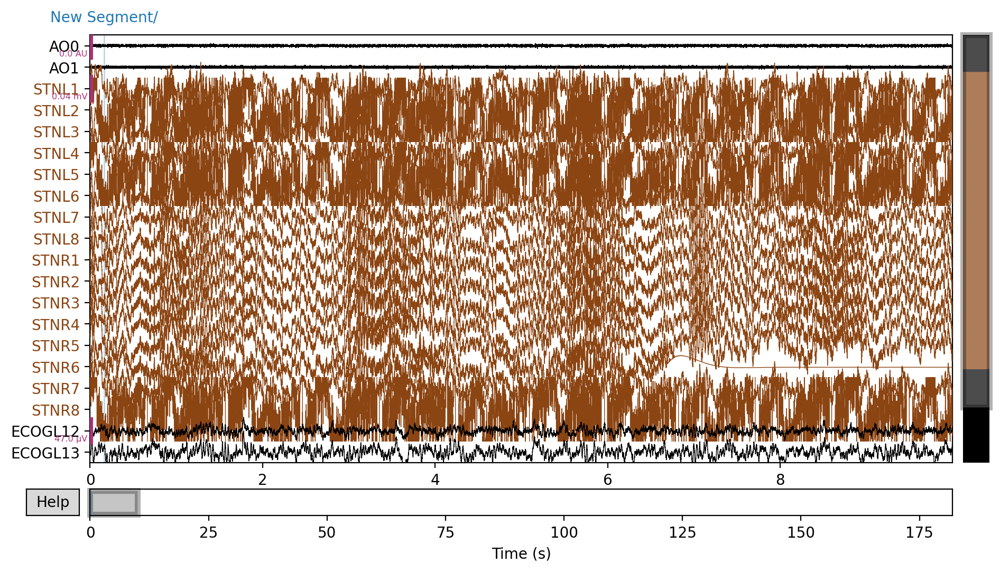

Channels marked as bad: none


In [42]:
%matplotlib qt
raw.plot(scalings='auto')

In [51]:
new_chs =  ['ECOG_L_1_2_SMC_AT',
           'ECOG_L_1_3_SMC_AT',
           'ECOG_L_1_4_SMC_AT',
           'ECOG_L_1_5_SMC_AT',
           'ECOG_L_1_6_SMC_AT',
            'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
            'LFP_R_1_STN_BS',
            'LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_R_8_STN_BS',
           'AO0',
           'AO1']

In [52]:
raw = rename_chs(raw, new_chs)

ECOG_L_1_2_SMC_ :  ecog
ECOG_L_1_3_SMC_ :  ecog
ECOG_L_1_4_SMC_ :  ecog
ECOG_L_1_5_SMC_ :  ecog
ECOG_L_1_6_SMC_ :  ecog
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
AO0 :  misc
AO1 :  misc


In [54]:
picks = ['ECOG_L_1_2_SMC_AT',
           'ECOG_L_1_3_SMC_AT',
           'ECOG_L_1_4_SMC_AT',
           'ECOG_L_1_5_SMC_AT',
           'ECOG_L_1_6_SMC_AT',
            'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
            'LFP_R_1_STN_BS',
            'LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_R_8_STN_BS']
picks = [pick[0:15] for pick in picks]
raw.pick(picks=picks)

<RawBrainVision | sub-001_ses-EphysMedOff01_task-Rest_acq-StimOff_run-02_ieeg.eeg, 21 x 910100 (182.0 s), ~29 kB, data not loaded>

In [55]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOff01\ieeg\dummy.vhdr...
Setting channel info structure...
ECOG_L_1_2_SMC_ :  ecog
ECOG_L_1_3_SMC_ :  ecog
ECOG_L_1_4_SMC_ :  ecog
ECOG_L_1_5_SMC_ :  ecog
ECOG_L_1_6_SMC_ :  ecog
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOff01\ieeg\dummy.vhdr...
Setting channel info structure...
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin

c:\users\richa\github\mne-bids\mne_bids\read.py:154: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '
c:\users\richa\github\mne-bids\mne_bids\path.py:1092: RuntimeWarning: Did not find any events.tsv associated with sub-001_ses-EphysMedOff01_task-Rest_acq-StimOff_run-02.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\**\sub-001_ses-EphysMedOff01*events.tsv"
  warn(msg)


In [56]:
test_raw = mne_bids.read_raw_bids(file.update(root=out_path))

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\ses-EphysMedOff01\ieeg\sub-001_ses-EphysMedOff01_task-Rest_acq-StimOff_run-02_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\ses-EphysMedOff01\ieeg\sub-001_ses-EphysMedOff01_task-Rest_acq-StimOff_run-02_channels.tsv.


c:\users\richa\github\mne-bids\mne_bids\path.py:1092: RuntimeWarning: Did not find any events.tsv associated with sub-001_ses-EphysMedOff01_task-Rest_acq-StimOff_run-02.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\**\sub-001_ses-EphysMedOff01*events.tsv"
  warn(msg)


In [58]:
test_raw.ch_names

['ECOG_L_1_2_SMC_',
 'ECOG_L_1_3_SMC_',
 'ECOG_L_1_4_SMC_',
 'ECOG_L_1_5_SMC_',
 'ECOG_L_1_6_SMC_',
 'LFP_L_1_STN_BS',
 'LFP_L_2_STN_BS',
 'LFP_L_3_STN_BS',
 'LFP_L_4_STN_BS',
 'LFP_L_5_STN_BS',
 'LFP_L_6_STN_BS',
 'LFP_L_7_STN_BS',
 'LFP_L_8_STN_BS',
 'LFP_R_1_STN_BS',
 'LFP_R_2_STN_BS',
 'LFP_R_3_STN_BS',
 'LFP_R_4_STN_BS',
 'LFP_R_5_STN_BS',
 'LFP_R_6_STN_BS',
 'LFP_R_7_STN_BS',
 'LFP_R_8_STN_BS']

# File 3

In [59]:
i = 3

In [60]:
raws[i]

<RawBrainVision | sub-001_ses-EphysMedOff01_task-Rest_acq-StimOn_run-01_ieeg.eeg, 13 x 1120364 (224.1 s), ~22 kB, data not loaded>

In [61]:
raw = raws[i]
file = files[i]

In [62]:
raw.ch_names

['ECOG_12_L_SM_AT',
 'ECOG_13_L_SM_AT',
 'ECOG_14_L_SM_AT',
 'ECOG_15_L_SM_AT',
 'ECOG_16_L_SM_AT',
 'LFP_12_L_STN_BS',
 'LFP_13_L_STN_BS',
 'LFP_14_L_STN_BS',
 'LFP_15_L_STN_BS',
 'LFP_16_L_STN_BS',
 'LFP_17_L_STN_BS',
 'LFP_18_L_STN_BS',
 'LFP_18_R_STN_BS']

In [63]:
new_chs =  ['ECOG_L_1_2_SMC_AT',
           'ECOG_L_1_3_SMC_AT',
           'ECOG_L_1_4_SMC_AT',
           'ECOG_L_1_5_SMC_AT',
           'ECOG_L_1_6_SMC_AT',
             'LFP_L_1_2_STN_BS',
            'LFP_L_1_3_STN_BS',
            'LFP_L_1_4_STN_BS',
            'LFP_L_1_5_STN_BS',
            'LFP_L_1_6_STN_BS',
            'LFP_L_1_7_STN_BS',
            'LFP_L_1_8_STN_BS',
            'LFP_R_1_8_STN_BS']

In [64]:
raw = rename_chs(raw, new_chs)

ECOG_L_1_2_SMC_ :  ecog
ECOG_L_1_3_SMC_ :  ecog
ECOG_L_1_4_SMC_ :  ecog
ECOG_L_1_5_SMC_ :  ecog
ECOG_L_1_6_SMC_ :  ecog
LFP_L_1_2_STN_B :  seeg
LFP_L_1_3_STN_B :  seeg
LFP_L_1_4_STN_B :  seeg
LFP_L_1_5_STN_B :  seeg
LFP_L_1_6_STN_B :  seeg
LFP_L_1_7_STN_B :  seeg
LFP_L_1_8_STN_B :  seeg
LFP_R_1_8_STN_B :  seeg


In [65]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOff01\ieeg\dummy.vhdr...
Setting channel info structure...
ECOG_L_1_2_SMC_ :  ecog
ECOG_L_1_3_SMC_ :  ecog
ECOG_L_1_4_SMC_ :  ecog
ECOG_L_1_5_SMC_ :  ecog
ECOG_L_1_6_SMC_ :  ecog
LFP_L_1_2_STN_B :  seeg
LFP_L_1_3_STN_B :  seeg
LFP_L_1_4_STN_B :  seeg
LFP_L_1_5_STN_B :  seeg
LFP_L_1_6_STN_B :  seeg
LFP_L_1_7_STN_B :  seeg
LFP_L_1_8_STN_B :  seeg
LFP_R_1_8_STN_B :  seeg
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOff01\ieeg\dummy.vhdr...
Setting channel info structure...
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\ses-EphysMedOff01\ieeg\sub-001_ses-EphysMedOff01_task-Rest_acq-StimOn_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info f

c:\users\richa\github\mne-bids\mne_bids\read.py:154: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '
c:\users\richa\github\mne-bids\mne_bids\path.py:1092: RuntimeWarning: Did not find any events.tsv associated with sub-001_ses-EphysMedOff01_task-Rest_acq-StimOn_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\**\sub-001_ses-EphysMedOff01*events.tsv"
  warn(msg)


# Next file

In [66]:
i = 4

In [67]:
raws[i]

<RawBrainVision | sub-001_ses-EphysMedOff01_task-Rest_acq-StimOn_run-02_ieeg.eeg, 7 x 910500 (182.1 s), ~16 kB, data not loaded>

In [68]:
raw = raws[i]
file = files[i]

In [69]:
raw.ch_names

['ECOGL12', 'ECOGL13', 'ECOGL14', 'ECOGL15', 'ECOGL16', 'AO0', 'AO1']

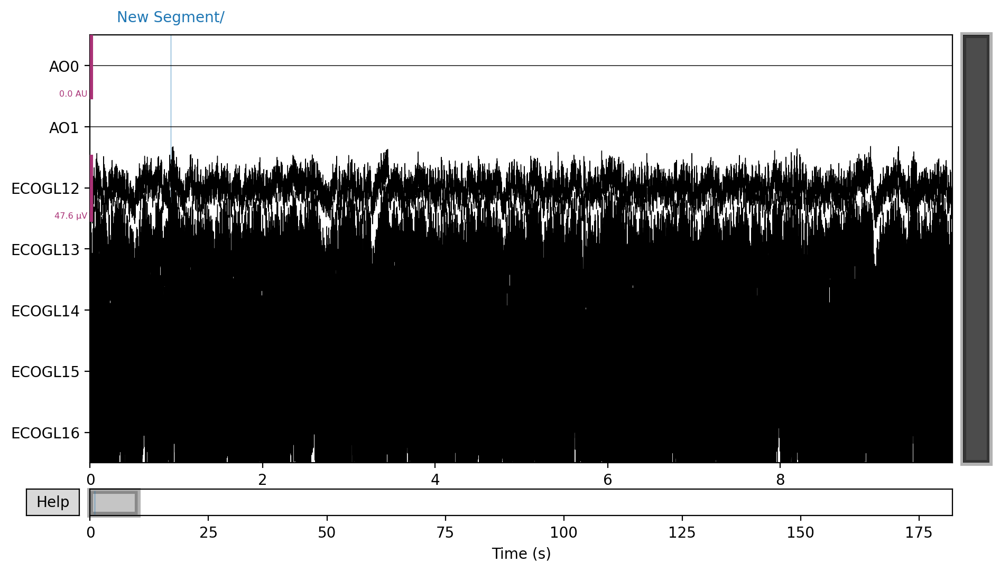

Channels marked as bad: ['ECOGL12', 'ECOGL14', 'ECOGL15', 'ECOGL16']


In [72]:
raw.plot(scalings='auto')

In [70]:
new_chs =  ['ECOG_L_1_2_SMC_AT',
           'ECOG_L_1_3_SMC_AT',
           'ECOG_L_1_4_SMC_AT',
           'ECOG_L_1_5_SMC_AT',
           'ECOG_L_1_6_SMC_AT',
            'AO0', 'AO1']

In [73]:
raw = rename_chs(raw, new_chs, picks=None)

ECOG_L_1_2_SMC_ :  ecog
ECOG_L_1_3_SMC_ :  ecog
ECOG_L_1_4_SMC_ :  ecog
ECOG_L_1_5_SMC_ :  ecog
ECOG_L_1_6_SMC_ :  ecog
AO0 :  misc
AO1 :  misc


In [74]:
picks = ['ECOG_L_1_2_SMC_AT',
           'ECOG_L_1_3_SMC_AT',
           'ECOG_L_1_4_SMC_AT',
           'ECOG_L_1_5_SMC_AT',
           'ECOG_L_1_6_SMC_AT']
picks = [pick[0:15] for pick in picks]
raw.pick(picks=picks)

<RawBrainVision | sub-001_ses-EphysMedOff01_task-Rest_acq-StimOn_run-02_ieeg.eeg, 5 x 910500 (182.1 s), ~14 kB, data not loaded>

In [76]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOff01\ieeg\dummy.vhdr...
Setting channel info structure...
ECOG_L_1_2_SMC_ :  ecog
ECOG_L_1_3_SMC_ :  ecog
ECOG_L_1_4_SMC_ :  ecog
ECOG_L_1_5_SMC_ :  ecog
ECOG_L_1_6_SMC_ :  ecog
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOff01\ieeg\dummy.vhdr...
Setting channel info structure...
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\ses-EphysMedOff01\ieeg\sub-001_ses-EphysMedOff01_task-Rest_acq-StimOn_run-02_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\ses-EphysMedOff01\ieeg\sub-001_ses-EphysMedOff01_task-Rest_acq-StimOn_run-02_ch

c:\users\richa\github\mne-bids\mne_bids\read.py:154: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '
c:\users\richa\github\mne-bids\mne_bids\path.py:1092: RuntimeWarning: Did not find any events.tsv associated with sub-001_ses-EphysMedOff01_task-Rest_acq-StimOn_run-02.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\**\sub-001_ses-EphysMedOff01*events.tsv"
  warn(msg)


# Next file

In [77]:
i = 5

In [78]:
raws[i]

<RawBrainVision | sub-001_ses-EphysMedOff01_task-Visuomotor_acq-StimOff_run-01_ieeg.eeg, 23 x 9032400 (1806.5 s), ~31 kB, data not loaded>

In [79]:
raw = raws[i]
file = files[i]

In [80]:
raw.ch_names

['ECOGL12',
 'ECOGL13',
 'ECOGL14',
 'ECOGL15',
 'ECOGL16',
 'STNL1',
 'STNL2',
 'STNL3',
 'STNL4',
 'STNL5',
 'STNL6',
 'STNL7',
 'STNL8',
 'STNR1',
 'STNR2',
 'STNR3',
 'STNR4',
 'STNR5',
 'STNR6',
 'STNR7',
 'STNR8',
 'AO0',
 'AO1']

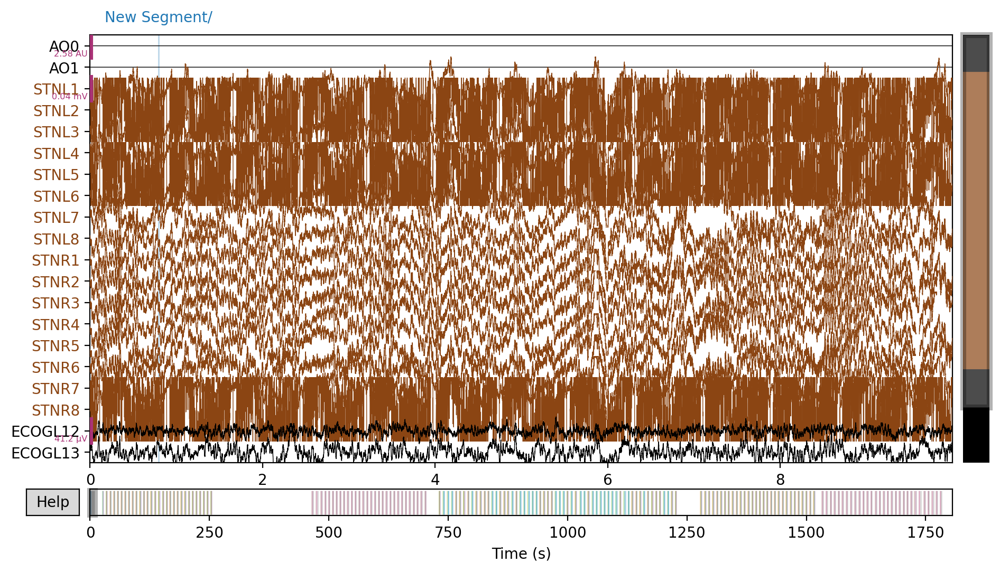

Channels marked as bad: none


In [81]:
raw.plot(scalings='auto')

In [82]:
new_chs =  ['ECOG_L_1_2_SMC_AT',
           'ECOG_L_1_3_SMC_AT',
           'ECOG_L_1_4_SMC_AT',
           'ECOG_L_1_5_SMC_AT',
           'ECOG_L_1_6_SMC_AT',
            'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
            'LFP_R_1_STN_BS',
            'LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_R_8_STN_BS',
           'AO0',
           'AO1']

In [83]:
picks = ['ECOG_L_1_2_SMC_AT',
           'ECOG_L_1_3_SMC_AT',
           'ECOG_L_1_4_SMC_AT',
           'ECOG_L_1_5_SMC_AT',
           'ECOG_L_1_6_SMC_AT',
            'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
            'LFP_R_1_STN_BS',
            'LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_R_8_STN_BS']
raw = rename_chs(raw, new_chs, picks=None)

ECOG_L_1_2_SMC_ :  ecog
ECOG_L_1_3_SMC_ :  ecog
ECOG_L_1_4_SMC_ :  ecog
ECOG_L_1_5_SMC_ :  ecog
ECOG_L_1_6_SMC_ :  ecog
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
AO0 :  misc
AO1 :  misc


In [85]:
raw = raw.pick(picks=[pick[0:15] for pick in picks])

In [90]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Used Annotations descriptions: ['New Segment/', 'Stimulus/S  1', 'Stimulus/S  2', 'Stimulus/S  3', 'Stimulus/S  9', 'Stimulus/S 10', 'Stimulus/S 11', 'Stimulus/S 16', 'Stimulus/S 17', 'Stimulus/S 18', 'Stimulus/S 24', 'Stimulus/S 25', 'Stimulus/S 26']
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOff01\ieeg\dummy.vhdr...
Setting channel info structure...
ECOG_L_1_2_SMC_ :  ecog
ECOG_L_1_3_SMC_ :  ecog
ECOG_L_1_4_SMC_ :  ecog
ECOG_L_1_5_SMC_ :  ecog
ECOG_L_1_6_SMC_ :  ecog
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
Extracting parameters from C:\Users\richa\OneDrive - Char

# Next file

In [77]:
i = 5

In [78]:
raws[i]

<RawBrainVision | sub-001_ses-EphysMedOff01_task-Visuomotor_acq-StimOff_run-01_ieeg.eeg, 23 x 9032400 (1806.5 s), ~31 kB, data not loaded>

In [79]:
raw = raws[i]
file = files[i]

In [80]:
raw.ch_names

['ECOGL12',
 'ECOGL13',
 'ECOGL14',
 'ECOGL15',
 'ECOGL16',
 'STNL1',
 'STNL2',
 'STNL3',
 'STNL4',
 'STNL5',
 'STNL6',
 'STNL7',
 'STNL8',
 'STNR1',
 'STNR2',
 'STNR3',
 'STNR4',
 'STNR5',
 'STNR6',
 'STNR7',
 'STNR8',
 'AO0',
 'AO1']

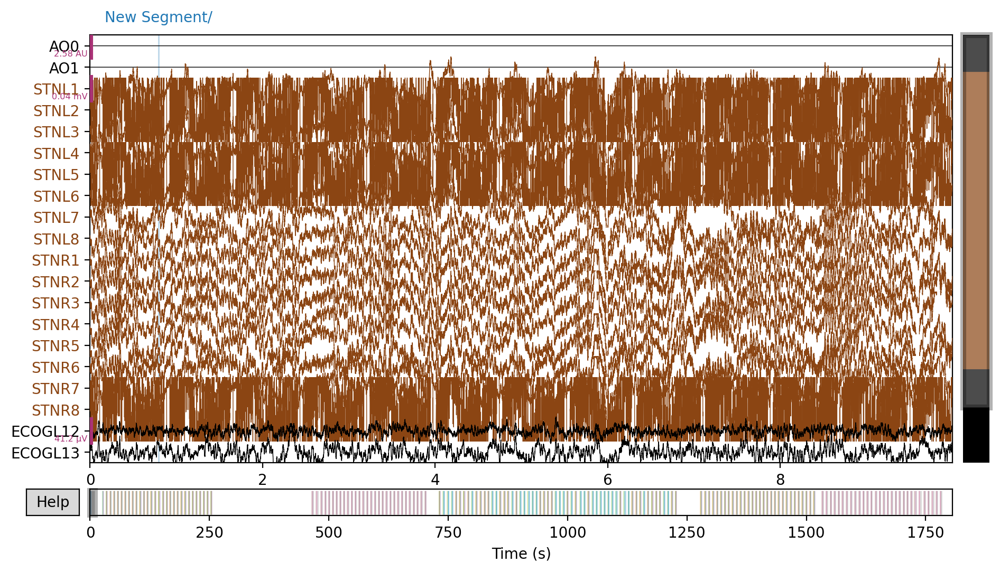

Channels marked as bad: none


In [81]:
raw.plot(scalings='auto')

In [82]:
new_chs =  ['ECOG_L_1_2_SMC_AT',
           'ECOG_L_1_3_SMC_AT',
           'ECOG_L_1_4_SMC_AT',
           'ECOG_L_1_5_SMC_AT',
           'ECOG_L_1_6_SMC_AT',
            'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
            'LFP_R_1_STN_BS',
            'LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_R_8_STN_BS',
           'AO0',
           'AO1']

In [83]:
picks = ['ECOG_L_1_2_SMC_AT',
           'ECOG_L_1_3_SMC_AT',
           'ECOG_L_1_4_SMC_AT',
           'ECOG_L_1_5_SMC_AT',
           'ECOG_L_1_6_SMC_AT',
            'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
            'LFP_R_1_STN_BS',
            'LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_R_8_STN_BS']
raw = rename_chs(raw, new_chs, picks=None)

ECOG_L_1_2_SMC_ :  ecog
ECOG_L_1_3_SMC_ :  ecog
ECOG_L_1_4_SMC_ :  ecog
ECOG_L_1_5_SMC_ :  ecog
ECOG_L_1_6_SMC_ :  ecog
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
AO0 :  misc
AO1 :  misc


In [85]:
raw = raw.pick(picks=[pick[0:15] for pick in picks])

In [104]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Used Annotations descriptions: ['New Segment/', 'Stimulus/S  1', 'Stimulus/S  2', 'Stimulus/S  3', 'Stimulus/S  9', 'Stimulus/S 10', 'Stimulus/S 11', 'Stimulus/S 16', 'Stimulus/S 17', 'Stimulus/S 18', 'Stimulus/S 24', 'Stimulus/S 25', 'Stimulus/S 26']
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOff01\ieeg\dummy.vhdr...
Setting channel info structure...
ECOG_L_1_2_SMC_ :  ecog
ECOG_L_1_3_SMC_ :  ecog
ECOG_L_1_4_SMC_ :  ecog
ECOG_L_1_5_SMC_ :  ecog
ECOG_L_1_6_SMC_ :  ecog
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
Extracting parameters from C:\Users\richa\OneDrive - Char

In [105]:
test_raw = mne.io.read_raw_brainvision(file.update(root=out_path).fpath)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\ses-EphysMedOff01\ieeg\sub-001_ses-EphysMedOff01_task-Visuomotor_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...


In [106]:
test_raw.annotations

<Annotations | 540 segments: Stimulus/S 1 (59), Stimulus/S 2 (60), ...>

# Next file

In [107]:
i = 6

In [108]:
raws[i]

<RawBrainVision | sub-001_ses-EphysMedOff01_task-Visuomotor_acq-StimOn_run-01_ieeg.eeg, 7 x 8351300 (1670.3 s), ~16 kB, data not loaded>

In [109]:
raw = raws[i]
file = files[i]

In [110]:
raw.ch_names

['ECOGL12', 'ECOGL13', 'ECOGL14', 'ECOGL15', 'ECOGL16', 'AO0', 'AO1']

In [111]:
new_chs =  ['ECOG_L_1_2_SMC_AT',
           'ECOG_L_1_3_SMC_AT',
           'ECOG_L_1_4_SMC_AT',
           'ECOG_L_1_5_SMC_AT',
           'ECOG_L_1_6_SMC_AT',
           'AO0',
           'AO1']

In [112]:
picks = ['ECOG_L_1_2_SMC_AT',
           'ECOG_L_1_3_SMC_AT',
           'ECOG_L_1_4_SMC_AT',
           'ECOG_L_1_5_SMC_AT',
           'ECOG_L_1_6_SMC_AT']
raw = rename_chs(raw, new_chs, picks=picks)

ECOG_L_1_2_SMC_ :  ecog
ECOG_L_1_3_SMC_ :  ecog
ECOG_L_1_4_SMC_ :  ecog
ECOG_L_1_5_SMC_ :  ecog
ECOG_L_1_6_SMC_ :  ecog


In [113]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Used Annotations descriptions: ['New Segment/', 'Stimulus/S  1', 'Stimulus/S  2', 'Stimulus/S  3', 'Stimulus/S  9', 'Stimulus/S 10', 'Stimulus/S 11', 'Stimulus/S 16', 'Stimulus/S 17', 'Stimulus/S 18', 'Stimulus/S 24', 'Stimulus/S 25', 'Stimulus/S 26']
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOff01\ieeg\dummy.vhdr...
Setting channel info structure...
ECOG_L_1_2_SMC_ :  ecog
ECOG_L_1_3_SMC_ :  ecog
ECOG_L_1_4_SMC_ :  ecog
ECOG_L_1_5_SMC_ :  ecog
ECOG_L_1_6_SMC_ :  ecog
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOff01\ieeg\dummy.vhdr...
Setting channel info structure...
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\ses-EphysMedOff01\ieeg\sub-001_ses-EphysMedOff01_task-Visuomotor_acq-StimOn_run-01_iee

# Next file

In [114]:
i = 7

In [115]:
raws[i]

<RawBrainVision | sub-001_ses-EphysMedOn01_task-BlockRotationWheel_acq-StimOff_run-01_ieeg.eeg, 15 x 1262369 (252.5 s), ~24 kB, data not loaded>

In [116]:
raw = raws[i]
file = files[i]

In [119]:
data = raw.get_data()

In [123]:
from matplotlib import pyplot as plt

plt.plot(data[3,:])

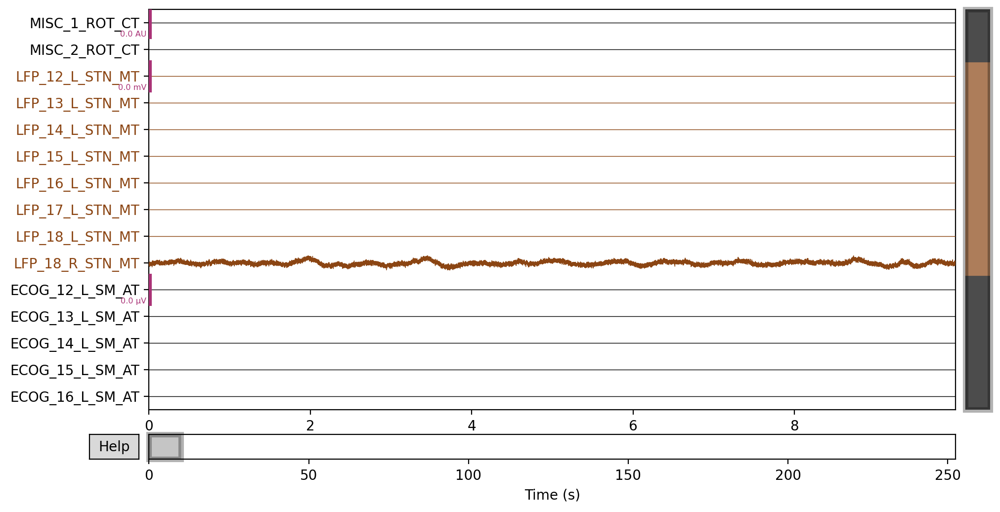

Channels marked as bad: ['LFP_18_R_STN_MT']


In [118]:
raw.plot(scalings='auto')

In [124]:
raw.ch_names

['MISC_1_ROT_CT',
 'MISC_2_ROT_CT',
 'ECOG_12_L_SM_AT',
 'ECOG_13_L_SM_AT',
 'ECOG_14_L_SM_AT',
 'ECOG_15_L_SM_AT',
 'ECOG_16_L_SM_AT',
 'LFP_12_L_STN_MT',
 'LFP_13_L_STN_MT',
 'LFP_14_L_STN_MT',
 'LFP_15_L_STN_MT',
 'LFP_16_L_STN_MT',
 'LFP_17_L_STN_MT',
 'LFP_18_L_STN_MT',
 'LFP_18_R_STN_MT']

In [125]:
new_chs =  ['ANALOG_1_ROTA_CT',
            'ANALOG_2_ROTA_CT',
            'ECOG_L_1_2_SMC_AT',
           'ECOG_L_1_3_SMC_AT',
           'ECOG_L_1_4_SMC_AT',
           'ECOG_L_1_5_SMC_AT',
           'ECOG_L_1_6_SMC_AT',
             'LFP_L_1_2_STN_BS',
            'LFP_L_1_3_STN_BS',
            'LFP_L_1_4_STN_BS',
            'LFP_L_1_5_STN_BS',
            'LFP_L_1_6_STN_BS',
            'LFP_L_1_7_STN_BS',
            'LFP_L_1_8_STN_BS',
            'LFP_R_1_8_STN_BS']

In [126]:
picks = None
raw = rename_chs(raw, new_chs, picks=picks)

ANALOG_1_ROTA_C :  misc
ANALOG_2_ROTA_C :  misc
ECOG_L_1_2_SMC_ :  ecog
ECOG_L_1_3_SMC_ :  ecog
ECOG_L_1_4_SMC_ :  ecog
ECOG_L_1_5_SMC_ :  ecog
ECOG_L_1_6_SMC_ :  ecog
LFP_L_1_2_STN_B :  seeg
LFP_L_1_3_STN_B :  seeg
LFP_L_1_4_STN_B :  seeg
LFP_L_1_5_STN_B :  seeg
LFP_L_1_6_STN_B :  seeg
LFP_L_1_7_STN_B :  seeg
LFP_L_1_8_STN_B :  seeg
LFP_R_1_8_STN_B :  seeg


In [127]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOn01\ieeg\dummy.vhdr...
Setting channel info structure...
ANALOG_1_ROTA_C :  misc
ANALOG_2_ROTA_C :  misc
ECOG_L_1_2_SMC_ :  ecog
ECOG_L_1_3_SMC_ :  ecog
ECOG_L_1_4_SMC_ :  ecog
ECOG_L_1_5_SMC_ :  ecog
ECOG_L_1_6_SMC_ :  ecog
LFP_L_1_2_STN_B :  seeg
LFP_L_1_3_STN_B :  seeg
LFP_L_1_4_STN_B :  seeg
LFP_L_1_5_STN_B :  seeg
LFP_L_1_6_STN_B :  seeg
LFP_L_1_7_STN_B :  seeg
LFP_L_1_8_STN_B :  seeg
LFP_R_1_8_STN_B :  seeg
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOn01\ieeg\dummy.vhdr...
Setting channel info structure...
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\ses-EphysMedOn01\ieeg\sub-001_ses-EphysMedOn01_task-BlockRotationWheel_acq-StimOff_run-01_ieeg.vhdr.

c:\users\richa\github\mne-bids\mne_bids\read.py:154: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '
c:\users\richa\github\mne-bids\mne_bids\path.py:1092: RuntimeWarning: Did not find any events.tsv associated with sub-001_ses-EphysMedOn01_task-BlockRotationWheel_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\**\sub-001_ses-EphysMedOn01*events.tsv"
  warn(msg)


# Next file

In [128]:
i = 8

In [129]:
raws[i]

<RawBrainVision | sub-001_ses-EphysMedOn01_task-FreeDrawing_acq-StimOff_run-01_ieeg.eeg, 15 x 1057621 (211.5 s), ~24 kB, data not loaded>

In [130]:
raw = raws[i]
file = files[i]

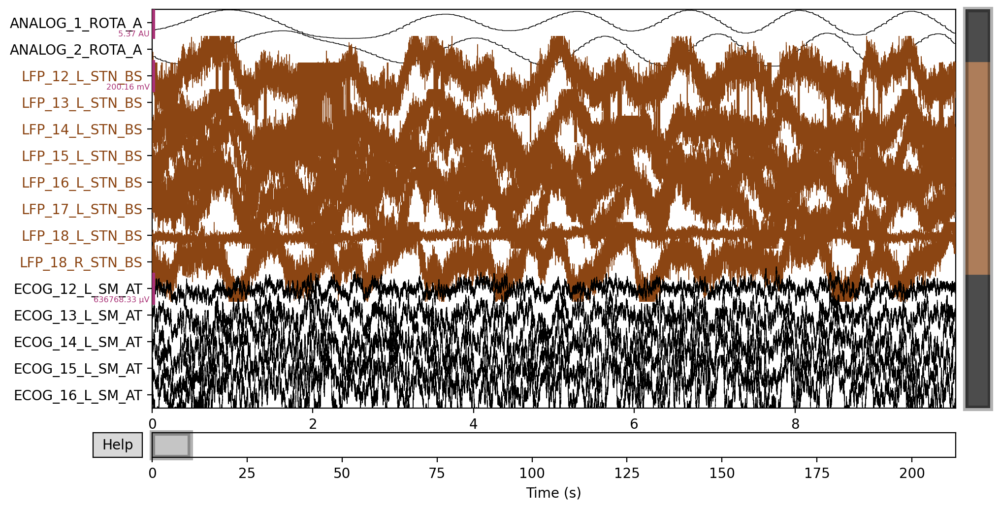

Channels marked as bad: none


In [133]:
raw.plot(scalings='auto')

In [132]:
raw.ch_names

['ANALOG_1_ROTA_A',
 'ANALOG_2_ROTA_A',
 'ECOG_12_L_SM_AT',
 'ECOG_13_L_SM_AT',
 'ECOG_14_L_SM_AT',
 'ECOG_15_L_SM_AT',
 'ECOG_16_L_SM_AT',
 'LFP_12_L_STN_BS',
 'LFP_13_L_STN_BS',
 'LFP_14_L_STN_BS',
 'LFP_15_L_STN_BS',
 'LFP_16_L_STN_BS',
 'LFP_17_L_STN_BS',
 'LFP_18_L_STN_BS',
 'LFP_18_R_STN_BS']

In [134]:
new_chs =  ['ANALOG_1_ROTA_A',
            'ANALOG_2_ROTA_A',
            'ECOG_L_1_2_SMC_AT',
           'ECOG_L_1_3_SMC_AT',
           'ECOG_L_1_4_SMC_AT',
           'ECOG_L_1_5_SMC_AT',
           'ECOG_L_1_6_SMC_AT',
             'LFP_L_1_2_STN_BS',
            'LFP_L_1_3_STN_BS',
            'LFP_L_1_4_STN_BS',
            'LFP_L_1_5_STN_BS',
            'LFP_L_1_6_STN_BS',
            'LFP_L_1_7_STN_BS',
            'LFP_L_1_8_STN_BS',
            'LFP_R_1_8_STN_BS']

In [135]:
picks = None
raw = rename_chs(raw, new_chs, picks=picks)

ANALOG_1_ROTA_A :  misc
ANALOG_2_ROTA_A :  misc
ECOG_L_1_2_SMC_ :  ecog
ECOG_L_1_3_SMC_ :  ecog
ECOG_L_1_4_SMC_ :  ecog
ECOG_L_1_5_SMC_ :  ecog
ECOG_L_1_6_SMC_ :  ecog
LFP_L_1_2_STN_B :  seeg
LFP_L_1_3_STN_B :  seeg
LFP_L_1_4_STN_B :  seeg
LFP_L_1_5_STN_B :  seeg
LFP_L_1_6_STN_B :  seeg
LFP_L_1_7_STN_B :  seeg
LFP_L_1_8_STN_B :  seeg
LFP_R_1_8_STN_B :  seeg


In [136]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOn01\ieeg\dummy.vhdr...
Setting channel info structure...
ANALOG_1_ROTA_A :  misc
ANALOG_2_ROTA_A :  misc
ECOG_L_1_2_SMC_ :  ecog
ECOG_L_1_3_SMC_ :  ecog
ECOG_L_1_4_SMC_ :  ecog
ECOG_L_1_5_SMC_ :  ecog
ECOG_L_1_6_SMC_ :  ecog
LFP_L_1_2_STN_B :  seeg
LFP_L_1_3_STN_B :  seeg
LFP_L_1_4_STN_B :  seeg
LFP_L_1_5_STN_B :  seeg
LFP_L_1_6_STN_B :  seeg
LFP_L_1_7_STN_B :  seeg
LFP_L_1_8_STN_B :  seeg
LFP_R_1_8_STN_B :  seeg
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOn01\ieeg\dummy.vhdr...
Setting channel info structure...
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\ses-EphysMedOn01\ieeg\sub-001_ses-EphysMedOn01_task-FreeDrawing_acq-StimOff_run-01_ieeg.vhdr...
Sett

c:\users\richa\github\mne-bids\mne_bids\read.py:154: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '
c:\users\richa\github\mne-bids\mne_bids\path.py:1092: RuntimeWarning: Did not find any events.tsv associated with sub-001_ses-EphysMedOn01_task-FreeDrawing_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\**\sub-001_ses-EphysMedOn01*events.tsv"
  warn(msg)


# Next file

In [137]:
i = 9

In [138]:
raws[i]

<RawBrainVision | sub-001_ses-EphysMedOn01_task-Rest_acq-StimOff_run-01_ieeg.eeg, 13 x 1227371 (245.5 s), ~22 kB, data not loaded>

In [139]:
raw = raws[i]
file = files[i]

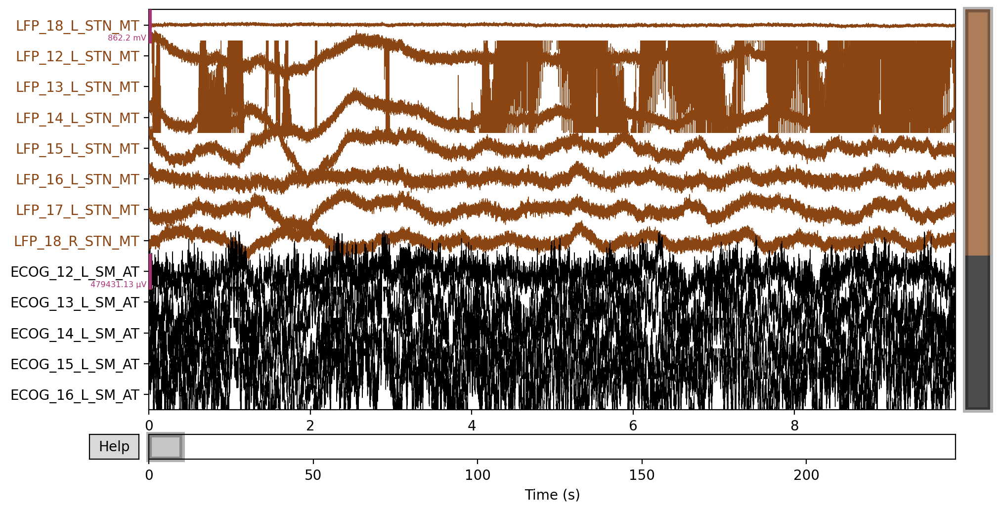

Channels marked as bad: none


In [140]:
raw.plot(scalings='auto')

In [141]:
raw.ch_names

['ECOG_12_L_SM_AT',
 'ECOG_13_L_SM_AT',
 'ECOG_14_L_SM_AT',
 'ECOG_15_L_SM_AT',
 'ECOG_16_L_SM_AT',
 'LFP_18_L_STN_MT',
 'LFP_12_L_STN_MT',
 'LFP_13_L_STN_MT',
 'LFP_14_L_STN_MT',
 'LFP_15_L_STN_MT',
 'LFP_16_L_STN_MT',
 'LFP_17_L_STN_MT',
 'LFP_18_R_STN_MT']

In [142]:
new_chs =  ['ECOG_L_1_2_SMC_AT',
           'ECOG_L_1_3_SMC_AT',
           'ECOG_L_1_4_SMC_AT',
           'ECOG_L_1_5_SMC_AT',
           'ECOG_L_1_6_SMC_AT',
            'LFP_L_1_8_STN_BS',
            'LFP_L_1_2_STN_BS',
            'LFP_L_1_3_STN_BS',
            'LFP_L_1_4_STN_BS',
            'LFP_L_1_5_STN_BS',
            'LFP_L_1_6_STN_BS',
            'LFP_L_1_7_STN_BS',
            'LFP_R_1_8_STN_BS']

In [143]:
picks = None
raw = rename_chs(raw, new_chs, picks=picks)

ECOG_L_1_2_SMC_ :  ecog
ECOG_L_1_3_SMC_ :  ecog
ECOG_L_1_4_SMC_ :  ecog
ECOG_L_1_5_SMC_ :  ecog
ECOG_L_1_6_SMC_ :  ecog
LFP_L_1_8_STN_B :  seeg
LFP_L_1_2_STN_B :  seeg
LFP_L_1_3_STN_B :  seeg
LFP_L_1_4_STN_B :  seeg
LFP_L_1_5_STN_B :  seeg
LFP_L_1_6_STN_B :  seeg
LFP_L_1_7_STN_B :  seeg
LFP_R_1_8_STN_B :  seeg


In [144]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOn01\ieeg\dummy.vhdr...
Setting channel info structure...
ECOG_L_1_2_SMC_ :  ecog
ECOG_L_1_3_SMC_ :  ecog
ECOG_L_1_4_SMC_ :  ecog
ECOG_L_1_5_SMC_ :  ecog
ECOG_L_1_6_SMC_ :  ecog
LFP_L_1_8_STN_B :  seeg
LFP_L_1_2_STN_B :  seeg
LFP_L_1_3_STN_B :  seeg
LFP_L_1_4_STN_B :  seeg
LFP_L_1_5_STN_B :  seeg
LFP_L_1_6_STN_B :  seeg
LFP_L_1_7_STN_B :  seeg
LFP_R_1_8_STN_B :  seeg
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOn01\ieeg\dummy.vhdr...
Setting channel info structure...
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\ses-EphysMedOn01\ieeg\sub-001_ses-EphysMedOn01_task-Rest_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from

c:\users\richa\github\mne-bids\mne_bids\read.py:154: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '
c:\users\richa\github\mne-bids\mne_bids\path.py:1092: RuntimeWarning: Did not find any events.tsv associated with sub-001_ses-EphysMedOn01_task-Rest_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\**\sub-001_ses-EphysMedOn01*events.tsv"
  warn(msg)


# Next file

In [150]:
i = 10

In [151]:
raws[i]

<RawBrainVision | sub-001_ses-EphysMedOn01_task-Rest_acq-StimOn_run-01_ieeg.eeg, 7 x 5881173 (1176.2 s), ~16 kB, data not loaded>

In [152]:
raw = raws[i]
file = files[i]

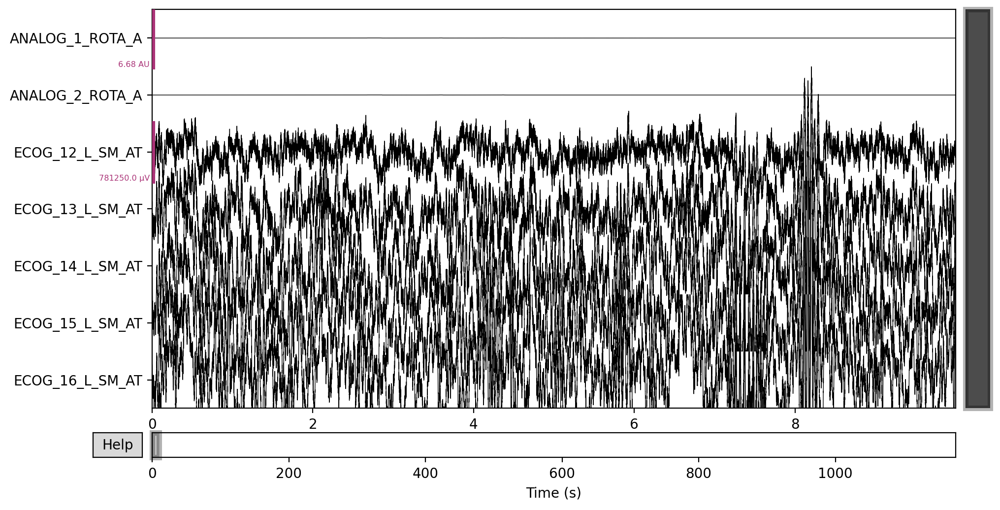

Channels marked as bad: ['ECOG_12_L_SM_AT', 'ECOG_14_L_SM_AT', 'ECOG_13_L_SM_AT', 'ECOG_15_L_SM_AT', 'ECOG_16_L_SM_AT']


In [153]:
raw.plot(scalings='auto')

In [154]:
raw.ch_names

['ANALOG_1_ROTA_A',
 'ANALOG_2_ROTA_A',
 'ECOG_12_L_SM_AT',
 'ECOG_13_L_SM_AT',
 'ECOG_14_L_SM_AT',
 'ECOG_15_L_SM_AT',
 'ECOG_16_L_SM_AT']

In [155]:
new_chs =  ['ANALOG_1_ROTA_A',
            'ANALOG_2_ROTA_A',
            'ECOG_L_1_2_SMC_AT',
           'ECOG_L_1_3_SMC_AT',
           'ECOG_L_1_4_SMC_AT',
           'ECOG_L_1_5_SMC_AT',
           'ECOG_L_1_6_SMC_AT']

In [156]:
picks = [  'ECOG_L_1_2_SMC_AT',
           'ECOG_L_1_3_SMC_AT',
           'ECOG_L_1_4_SMC_AT',
           'ECOG_L_1_5_SMC_AT',
           'ECOG_L_1_6_SMC_AT']
raw = rename_chs(raw, new_chs, picks=picks)

ECOG_L_1_2_SMC_ :  ecog
ECOG_L_1_3_SMC_ :  ecog
ECOG_L_1_4_SMC_ :  ecog
ECOG_L_1_5_SMC_ :  ecog
ECOG_L_1_6_SMC_ :  ecog


In [157]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOn01\ieeg\dummy.vhdr...
Setting channel info structure...
ECOG_L_1_2_SMC_ :  ecog
ECOG_L_1_3_SMC_ :  ecog
ECOG_L_1_4_SMC_ :  ecog
ECOG_L_1_5_SMC_ :  ecog
ECOG_L_1_6_SMC_ :  ecog
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOn01\ieeg\dummy.vhdr...
Setting channel info structure...
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\ses-EphysMedOn01\ieeg\sub-001_ses-EphysMedOn01_task-Rest_acq-StimOn_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\ses-EphysMedOn01\ieeg\sub-001_ses-EphysMedOn01_task-Rest_acq-StimOn_run-01_channels

c:\users\richa\github\mne-bids\mne_bids\read.py:154: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '
c:\users\richa\github\mne-bids\mne_bids\path.py:1092: RuntimeWarning: Did not find any events.tsv associated with sub-001_ses-EphysMedOn01_task-Rest_acq-StimOn_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\**\sub-001_ses-EphysMedOn01*events.tsv"
  warn(msg)


# Next file

In [158]:
i = 11

In [159]:
raws[i]

<RawBrainVision | sub-001_ses-EphysMedOn01_task-SelfpacedForceWheel_acq-StimOff_run-01_ieeg.eeg, 14 x 2376620 (475.3 s), ~23 kB, data not loaded>

In [160]:
raw = raws[i]
file = files[i]

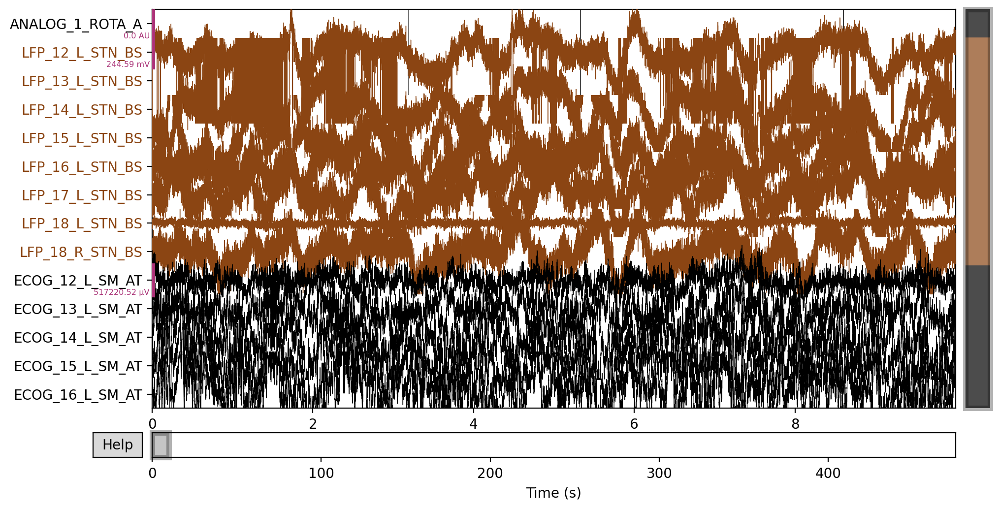

Channels marked as bad: none


In [161]:
raw.plot(scalings='auto')

In [163]:
raw.ch_names

['ANALOG_1_ROTA_A',
 'ECOG_12_L_SM_AT',
 'ECOG_13_L_SM_AT',
 'ECOG_14_L_SM_AT',
 'ECOG_15_L_SM_AT',
 'ECOG_16_L_SM_AT',
 'LFP_12_L_STN_BS',
 'LFP_13_L_STN_BS',
 'LFP_14_L_STN_BS',
 'LFP_15_L_STN_BS',
 'LFP_16_L_STN_BS',
 'LFP_17_L_STN_BS',
 'LFP_18_L_STN_BS',
 'LFP_18_R_STN_BS']

In [164]:
new_chs =  ['ANALOG_ROTAWHEEL',
            'ECOG_L_1_2_SMC_AT',
           'ECOG_L_1_3_SMC_AT',
           'ECOG_L_1_4_SMC_AT',
           'ECOG_L_1_5_SMC_AT',
           'ECOG_L_1_6_SMC_AT',
             'LFP_L_1_2_STN_BS',
            'LFP_L_1_3_STN_BS',
            'LFP_L_1_4_STN_BS',
            'LFP_L_1_5_STN_BS',
            'LFP_L_1_6_STN_BS',
            'LFP_L_1_7_STN_BS',
            'LFP_L_1_8_STN_BS',
            'LFP_R_1_8_STN_BS']

In [165]:
picks = None
raw = rename_chs(raw, new_chs, picks=picks)

ANALOG_ROTAWHEE :  misc
ECOG_L_1_2_SMC_ :  ecog
ECOG_L_1_3_SMC_ :  ecog
ECOG_L_1_4_SMC_ :  ecog
ECOG_L_1_5_SMC_ :  ecog
ECOG_L_1_6_SMC_ :  ecog
LFP_L_1_2_STN_B :  seeg
LFP_L_1_3_STN_B :  seeg
LFP_L_1_4_STN_B :  seeg
LFP_L_1_5_STN_B :  seeg
LFP_L_1_6_STN_B :  seeg
LFP_L_1_7_STN_B :  seeg
LFP_L_1_8_STN_B :  seeg
LFP_R_1_8_STN_B :  seeg


In [166]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOn01\ieeg\dummy.vhdr...
Setting channel info structure...
ANALOG_ROTAWHEE :  misc
ECOG_L_1_2_SMC_ :  ecog
ECOG_L_1_3_SMC_ :  ecog
ECOG_L_1_4_SMC_ :  ecog
ECOG_L_1_5_SMC_ :  ecog
ECOG_L_1_6_SMC_ :  ecog
LFP_L_1_2_STN_B :  seeg
LFP_L_1_3_STN_B :  seeg
LFP_L_1_4_STN_B :  seeg
LFP_L_1_5_STN_B :  seeg
LFP_L_1_6_STN_B :  seeg
LFP_L_1_7_STN_B :  seeg
LFP_L_1_8_STN_B :  seeg
LFP_R_1_8_STN_B :  seeg
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOn01\ieeg\dummy.vhdr...
Setting channel info structure...
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\ses-EphysMedOn01\ieeg\sub-001_ses-EphysMedOn01_task-SelfpacedForceWheel_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info

c:\users\richa\github\mne-bids\mne_bids\read.py:154: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '
c:\users\richa\github\mne-bids\mne_bids\path.py:1092: RuntimeWarning: Did not find any events.tsv associated with sub-001_ses-EphysMedOn01_task-SelfpacedForceWheel_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\**\sub-001_ses-EphysMedOn01*events.tsv"
  warn(msg)


# Next file

In [150]:
i = 12

In [151]:
raws[i]

<RawBrainVision | sub-001_ses-EphysMedOn02_task-BlockRotationL_acq-StimOffOn_run-01_ieeg.eeg, 15 x 2557096 (511.4 s), ~24 kB, data not loaded>

In [157]:
file = files[i]
raw = mne_bids.read_raw_bids(file)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOn02\ieeg\sub-001_ses-EphysMedOn02_task-BlockRotationL_acq-StimOffOn_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOn02\ieeg\sub-001_ses-EphysMedOn02_task-BlockRotationL_acq-StimOffOn_run-01_channels.tsv.


c:\users\richa\github\mne-bids\mne_bids\read.py:53: RuntimeWarning: 2 channel names are too long, have been truncated to 15 characters:
['ANALOG_1_ROTA_AO', 'ANALOG_2_ROTA_AO']
  raw = reader[ext](raw_fpath, **kwargs)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-001_ses-EphysMedOn02_task-BlockRotationL_acq-StimOffOn_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\**\sub-001_ses-EphysMedOn02*events.tsv"
  warn(msg)


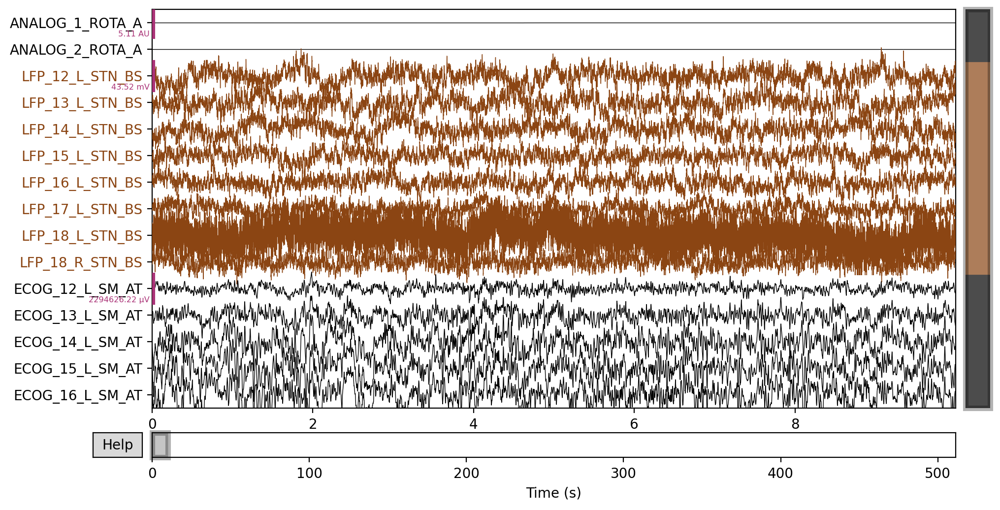

Channels marked as bad: none


In [153]:
raw.plot(scalings='auto')

In [158]:
raw.ch_names

['ANALOG_1_ROTA_A',
 'ANALOG_2_ROTA_A',
 'ECOG_12_L_SM_AT',
 'ECOG_13_L_SM_AT',
 'ECOG_14_L_SM_AT',
 'ECOG_15_L_SM_AT',
 'ECOG_16_L_SM_AT',
 'LFP_12_L_STN_BS',
 'LFP_13_L_STN_BS',
 'LFP_14_L_STN_BS',
 'LFP_15_L_STN_BS',
 'LFP_16_L_STN_BS',
 'LFP_17_L_STN_BS',
 'LFP_18_L_STN_BS',
 'LFP_18_R_STN_BS']

In [161]:
raw = mne.add_reference_channels(raw.load_data(), 
                                 ['ECOG_L_1_SMC_AT', 'LFP_L_1_STN_BS', 'LFP_R_1_STN_BS'])

Reading 0 ... 2557095  =      0.000 ...   511.419 secs...


In [163]:
raw = raw.set_channel_types({'ECOG_L_1_SMC_AT': 'ecog', 
                             'LFP_L_1_STN_BS': 'seeg', 
                             'LFP_R_1_STN_BS': 'seeg'})

In [164]:
raw.ch_names

['ANALOG_1_ROTA_A',
 'ANALOG_2_ROTA_A',
 'ECOG_12_L_SM_AT',
 'ECOG_13_L_SM_AT',
 'ECOG_14_L_SM_AT',
 'ECOG_15_L_SM_AT',
 'ECOG_16_L_SM_AT',
 'LFP_12_L_STN_BS',
 'LFP_13_L_STN_BS',
 'LFP_14_L_STN_BS',
 'LFP_15_L_STN_BS',
 'LFP_16_L_STN_BS',
 'LFP_17_L_STN_BS',
 'LFP_18_L_STN_BS',
 'LFP_18_R_STN_BS',
 'ECOG_L_1_SMC_AT',
 'LFP_L_1_STN_BS',
 'LFP_R_1_STN_BS']

In [165]:
new_chs =  ['ANALOG_L_ROTA_CH',
            'ANALOG_R_ROTA_CH',
            'ECOG_L_1_2_SMC_AT',
            'ECOG_L_1_3_SMC_AT',
            'ECOG_L_1_4_SMC_AT',
            'ECOG_L_1_5_SMC_AT',
            'ECOG_L_1_6_SMC_AT',
            'LFP_L_1_2_STN_BS',
            'LFP_L_1_3_STN_BS',
            'LFP_L_1_4_STN_BS',
            'LFP_L_1_5_STN_BS',
            'LFP_L_1_6_STN_BS',
            'LFP_L_1_7_STN_BS',
            'LFP_L_1_8_STN_BS',
            'LFP_R_1_8_STN_BS',
            'ECOG_L_1_SMC_AT',
             'LFP_L_1_STN_BS',
             'LFP_R_1_STN_BS']

In [166]:
picks = ['ANALOG_L_ROTA_CH',
            'ECOG_L_1_2_SMC_AT',
           'ECOG_L_1_3_SMC_AT',
           'ECOG_L_1_4_SMC_AT',
           'ECOG_L_1_5_SMC_AT',
           'ECOG_L_1_6_SMC_AT',
             'LFP_L_1_2_STN_BS',
            'LFP_L_1_3_STN_BS',
            'LFP_L_1_4_STN_BS',
            'LFP_L_1_5_STN_BS',
            'LFP_L_1_6_STN_BS',
            'LFP_L_1_7_STN_BS',
            'LFP_L_1_8_STN_BS',
            'LFP_R_1_8_STN_BS',
             'ECOG_L_1_SMC_AT',
             'LFP_L_1_STN_BS',
             'LFP_R_1_STN_BS']
raw = rename_chs(raw, new_chs, picks=picks)

ANALOG_L_ROTA_C :  misc
ECOG_L_1_2_SMC_ :  ecog
ECOG_L_1_3_SMC_ :  ecog
ECOG_L_1_4_SMC_ :  ecog
ECOG_L_1_5_SMC_ :  ecog
ECOG_L_1_6_SMC_ :  ecog
ECOG_L_1_SMC_AT :  ecog
LFP_L_1_2_STN_B :  seeg
LFP_L_1_3_STN_B :  seeg
LFP_L_1_4_STN_B :  seeg
LFP_L_1_5_STN_B :  seeg
LFP_L_1_6_STN_B :  seeg
LFP_L_1_7_STN_B :  seeg
LFP_L_1_8_STN_B :  seeg
LFP_L_1_STN_BS :  seeg
LFP_R_1_8_STN_B :  seeg
LFP_R_1_STN_BS :  seeg


In [167]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOn02\ieeg\dummy.vhdr...
Setting channel info structure...
ANALOG_L_ROTA_C :  misc
ECOG_L_1_2_SMC_ :  ecog
ECOG_L_1_3_SMC_ :  ecog
ECOG_L_1_4_SMC_ :  ecog
ECOG_L_1_5_SMC_ :  ecog
ECOG_L_1_6_SMC_ :  ecog
ECOG_L_1_SMC_AT :  ecog
LFP_L_1_2_STN_B :  seeg
LFP_L_1_3_STN_B :  seeg
LFP_L_1_4_STN_B :  seeg
LFP_L_1_5_STN_B :  seeg
LFP_L_1_6_STN_B :  seeg
LFP_L_1_7_STN_B :  seeg
LFP_L_1_8_STN_B :  seeg
LFP_L_1_STN_BS :  seeg
LFP_R_1_8_STN_B :  seeg
LFP_R_1_STN_BS :  seeg
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOn02\ieeg\dummy.vhdr...
Setting channel info structure...
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\ses-EphysMedOn02\ieeg\sub-001_ses-EphysMedOn02_task-Bl

c:\users\richa\github\mne-bids\mne_bids\read.py:156: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-001_ses-EphysMedOn02_task-BlockRotationL_acq-StimOffOn_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\**\sub-001_ses-EphysMedOn02*events.tsv"
  warn(msg)


# Next file

In [177]:
i = 13

In [178]:
raws[i]

<RawBrainVision | sub-001_ses-EphysMedOn02_task-BlockRotationR_acq-StimOff_run-01_ieeg.eeg, 14 x 1240486 (248.1 s), ~23 kB, data not loaded>

In [179]:
raw = raws[i]
file = files[i]

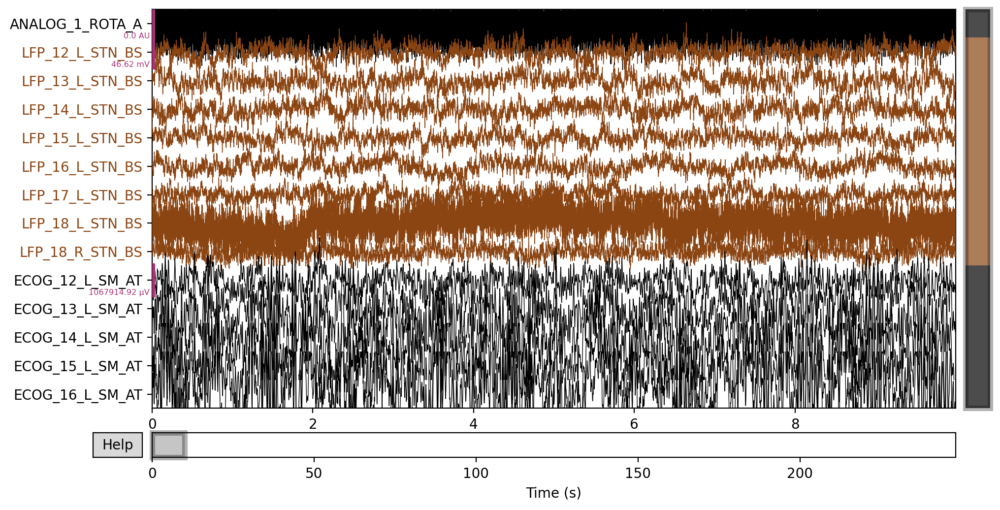

Channels marked as bad: ['LFP_12_L_STN_BS', 'LFP_13_L_STN_BS']


In [180]:
raw.plot(scalings='auto')

In [181]:
raw.ch_names

['ANALOG_1_ROTA_A',
 'ECOG_12_L_SM_AT',
 'ECOG_13_L_SM_AT',
 'ECOG_14_L_SM_AT',
 'ECOG_15_L_SM_AT',
 'ECOG_16_L_SM_AT',
 'LFP_12_L_STN_BS',
 'LFP_13_L_STN_BS',
 'LFP_14_L_STN_BS',
 'LFP_15_L_STN_BS',
 'LFP_16_L_STN_BS',
 'LFP_17_L_STN_BS',
 'LFP_18_L_STN_BS',
 'LFP_18_R_STN_BS']

In [182]:
new_chs =  ['ANALOG_L_ROTA_CH',
            'ECOG_L_1_2_SMC_AT',
           'ECOG_L_1_3_SMC_AT',
           'ECOG_L_1_4_SMC_AT',
           'ECOG_L_1_5_SMC_AT',
           'ECOG_L_1_6_SMC_AT',
             'LFP_L_1_2_STN_BS',
            'LFP_L_1_3_STN_BS',
            'LFP_L_1_4_STN_BS',
            'LFP_L_1_5_STN_BS',
            'LFP_L_1_6_STN_BS',
            'LFP_L_1_7_STN_BS',
            'LFP_L_1_8_STN_BS',
            'LFP_R_1_8_STN_BS']

In [183]:
picks = None
raw = rename_chs(raw, new_chs, picks=picks)

ANALOG_L_ROTA_C :  misc
ECOG_L_1_2_SMC_ :  ecog
ECOG_L_1_3_SMC_ :  ecog
ECOG_L_1_4_SMC_ :  ecog
ECOG_L_1_5_SMC_ :  ecog
ECOG_L_1_6_SMC_ :  ecog
LFP_L_1_2_STN_B :  seeg
LFP_L_1_3_STN_B :  seeg
LFP_L_1_4_STN_B :  seeg
LFP_L_1_5_STN_B :  seeg
LFP_L_1_6_STN_B :  seeg
LFP_L_1_7_STN_B :  seeg
LFP_L_1_8_STN_B :  seeg
LFP_R_1_8_STN_B :  seeg


In [184]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOn02\ieeg\dummy.vhdr...
Setting channel info structure...
ANALOG_L_ROTA_C :  misc
ECOG_L_1_2_SMC_ :  ecog
ECOG_L_1_3_SMC_ :  ecog
ECOG_L_1_4_SMC_ :  ecog
ECOG_L_1_5_SMC_ :  ecog
ECOG_L_1_6_SMC_ :  ecog
LFP_L_1_2_STN_B :  seeg
LFP_L_1_3_STN_B :  seeg
LFP_L_1_4_STN_B :  seeg
LFP_L_1_5_STN_B :  seeg
LFP_L_1_6_STN_B :  seeg
LFP_L_1_7_STN_B :  seeg
LFP_L_1_8_STN_B :  seeg
LFP_R_1_8_STN_B :  seeg
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOn02\ieeg\dummy.vhdr...
Setting channel info structure...
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\ses-EphysMedOn02\ieeg\sub-001_ses-EphysMedOn02_task-BlockRotationR_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info stru

c:\users\richa\github\mne-bids\mne_bids\read.py:154: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '
c:\users\richa\github\mne-bids\mne_bids\path.py:1092: RuntimeWarning: Did not find any events.tsv associated with sub-001_ses-EphysMedOn02_task-BlockRotationR_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\**\sub-001_ses-EphysMedOn02*events.tsv"
  warn(msg)


# Next file

In [187]:
i = 14

In [188]:
raws[i]

<RawBrainVision | sub-001_ses-EphysMedOn02_task-ContinuousStopping_acq-StimOffOn_run-01_ieeg.eeg, 15 x 3985076 (797.0 s), ~24 kB, data not loaded>

In [189]:
raw = raws[i]
file = files[i]

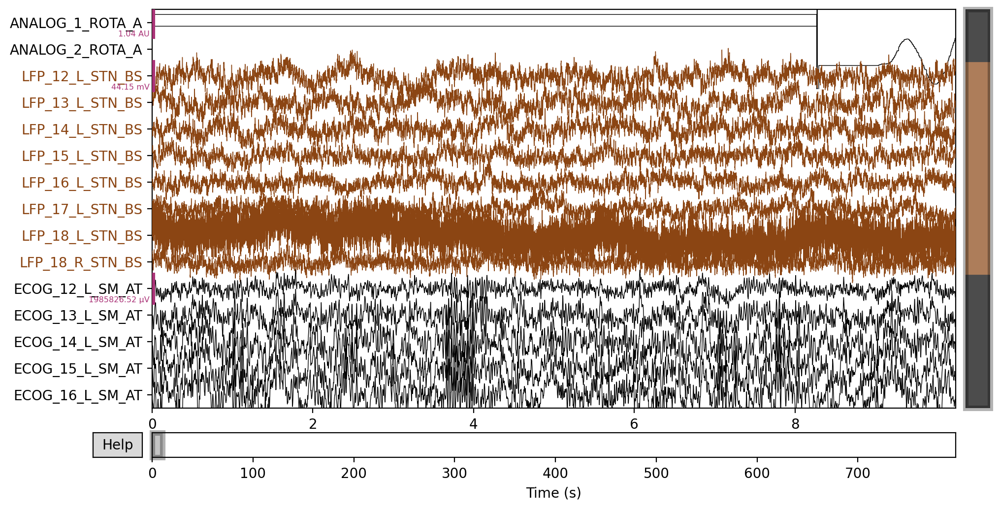

Channels marked as bad: none


In [190]:
raw.plot(scalings='auto')

In [191]:
raw.ch_names

['ANALOG_1_ROTA_A',
 'ANALOG_2_ROTA_A',
 'ECOG_12_L_SM_AT',
 'ECOG_13_L_SM_AT',
 'ECOG_14_L_SM_AT',
 'ECOG_15_L_SM_AT',
 'ECOG_16_L_SM_AT',
 'LFP_12_L_STN_BS',
 'LFP_13_L_STN_BS',
 'LFP_14_L_STN_BS',
 'LFP_15_L_STN_BS',
 'LFP_16_L_STN_BS',
 'LFP_17_L_STN_BS',
 'LFP_18_L_STN_BS',
 'LFP_18_R_STN_BS']

In [192]:
new_chs =  ['ANALOG_1',
            'ANALOG_2',
            'ECOG_L_1_2_SMC_AT',
           'ECOG_L_1_3_SMC_AT',
           'ECOG_L_1_4_SMC_AT',
           'ECOG_L_1_5_SMC_AT',
           'ECOG_L_1_6_SMC_AT',
             'LFP_L_1_2_STN_BS',
            'LFP_L_1_3_STN_BS',
            'LFP_L_1_4_STN_BS',
            'LFP_L_1_5_STN_BS',
            'LFP_L_1_6_STN_BS',
            'LFP_L_1_7_STN_BS',
            'LFP_L_1_8_STN_BS',
            'LFP_R_1_8_STN_BS']

In [193]:
picks = None
raw = rename_chs(raw, new_chs, picks=picks)

ANALOG_1 :  misc
ANALOG_2 :  misc
ECOG_L_1_2_SMC_ :  ecog
ECOG_L_1_3_SMC_ :  ecog
ECOG_L_1_4_SMC_ :  ecog
ECOG_L_1_5_SMC_ :  ecog
ECOG_L_1_6_SMC_ :  ecog
LFP_L_1_2_STN_B :  seeg
LFP_L_1_3_STN_B :  seeg
LFP_L_1_4_STN_B :  seeg
LFP_L_1_5_STN_B :  seeg
LFP_L_1_6_STN_B :  seeg
LFP_L_1_7_STN_B :  seeg
LFP_L_1_8_STN_B :  seeg
LFP_R_1_8_STN_B :  seeg


In [194]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOn02\ieeg\dummy.vhdr...
Setting channel info structure...
ANALOG_1 :  misc
ANALOG_2 :  misc
ECOG_L_1_2_SMC_ :  ecog
ECOG_L_1_3_SMC_ :  ecog
ECOG_L_1_4_SMC_ :  ecog
ECOG_L_1_5_SMC_ :  ecog
ECOG_L_1_6_SMC_ :  ecog
LFP_L_1_2_STN_B :  seeg
LFP_L_1_3_STN_B :  seeg
LFP_L_1_4_STN_B :  seeg
LFP_L_1_5_STN_B :  seeg
LFP_L_1_6_STN_B :  seeg
LFP_L_1_7_STN_B :  seeg
LFP_L_1_8_STN_B :  seeg
LFP_R_1_8_STN_B :  seeg
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOn02\ieeg\dummy.vhdr...
Setting channel info structure...
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\ses-EphysMedOn02\ieeg\sub-001_ses-EphysMedOn02_task-ContinuousStopping_acq-StimOffOn_run-01_ieeg.vhdr...
Setting c

c:\users\richa\github\mne-bids\mne_bids\read.py:154: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '
c:\users\richa\github\mne-bids\mne_bids\path.py:1092: RuntimeWarning: Did not find any events.tsv associated with sub-001_ses-EphysMedOn02_task-ContinuousStopping_acq-StimOffOn_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\**\sub-001_ses-EphysMedOn02*events.tsv"
  warn(msg)


# Next file

In [199]:
i = 15

In [200]:
raws[i]

<RawBrainVision | sub-001_ses-EphysMedOn02_task-Rest_acq-StimOff_run-01_ieeg.eeg, 13 x 907572 (181.5 s), ~22 kB, data not loaded>

In [201]:
raw = raws[i]
file = files[i]

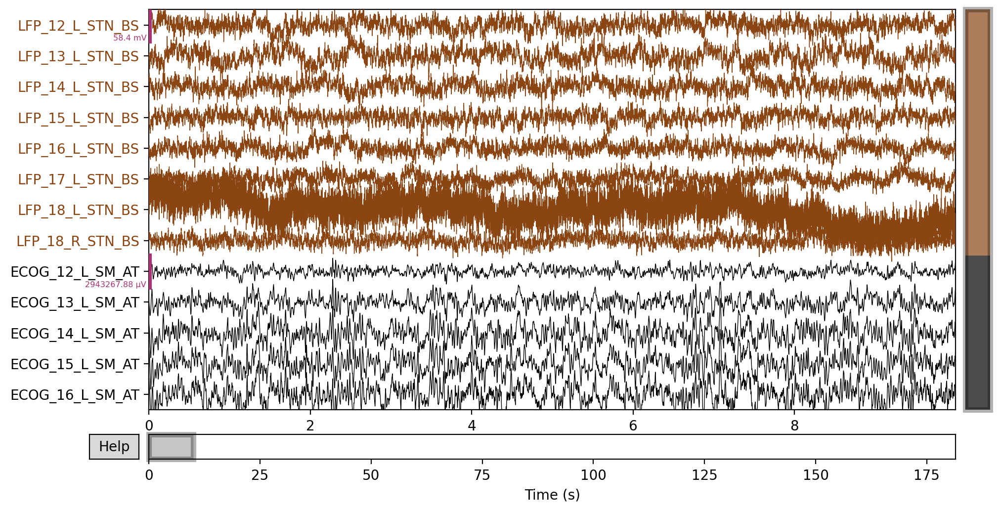

Channels marked as bad: none


In [202]:
raw.plot(scalings='auto')

In [203]:
raw.ch_names

['ECOG_12_L_SM_AT',
 'ECOG_13_L_SM_AT',
 'ECOG_14_L_SM_AT',
 'ECOG_15_L_SM_AT',
 'ECOG_16_L_SM_AT',
 'LFP_12_L_STN_BS',
 'LFP_13_L_STN_BS',
 'LFP_14_L_STN_BS',
 'LFP_15_L_STN_BS',
 'LFP_16_L_STN_BS',
 'LFP_17_L_STN_BS',
 'LFP_18_L_STN_BS',
 'LFP_18_R_STN_BS']

In [204]:
new_chs =  ['ECOG_L_1_2_SMC_AT',
           'ECOG_L_1_3_SMC_AT',
           'ECOG_L_1_4_SMC_AT',
           'ECOG_L_1_5_SMC_AT',
           'ECOG_L_1_6_SMC_AT',
             'LFP_L_1_2_STN_BS',
            'LFP_L_1_3_STN_BS',
            'LFP_L_1_4_STN_BS',
            'LFP_L_1_5_STN_BS',
            'LFP_L_1_6_STN_BS',
            'LFP_L_1_7_STN_BS',
            'LFP_L_1_8_STN_BS',
            'LFP_R_1_8_STN_BS']

In [205]:
picks = None
raw = rename_chs(raw, new_chs, picks=picks)

ECOG_L_1_2_SMC_ :  ecog
ECOG_L_1_3_SMC_ :  ecog
ECOG_L_1_4_SMC_ :  ecog
ECOG_L_1_5_SMC_ :  ecog
ECOG_L_1_6_SMC_ :  ecog
LFP_L_1_2_STN_B :  seeg
LFP_L_1_3_STN_B :  seeg
LFP_L_1_4_STN_B :  seeg
LFP_L_1_5_STN_B :  seeg
LFP_L_1_6_STN_B :  seeg
LFP_L_1_7_STN_B :  seeg
LFP_L_1_8_STN_B :  seeg
LFP_R_1_8_STN_B :  seeg


In [206]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOn02\ieeg\dummy.vhdr...
Setting channel info structure...
ECOG_L_1_2_SMC_ :  ecog
ECOG_L_1_3_SMC_ :  ecog
ECOG_L_1_4_SMC_ :  ecog
ECOG_L_1_5_SMC_ :  ecog
ECOG_L_1_6_SMC_ :  ecog
LFP_L_1_2_STN_B :  seeg
LFP_L_1_3_STN_B :  seeg
LFP_L_1_4_STN_B :  seeg
LFP_L_1_5_STN_B :  seeg
LFP_L_1_6_STN_B :  seeg
LFP_L_1_7_STN_B :  seeg
LFP_L_1_8_STN_B :  seeg
LFP_R_1_8_STN_B :  seeg
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOn02\ieeg\dummy.vhdr...
Setting channel info structure...
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\ses-EphysMedOn02\ieeg\sub-001_ses-EphysMedOn02_task-Rest_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from

c:\users\richa\github\mne-bids\mne_bids\read.py:154: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '
c:\users\richa\github\mne-bids\mne_bids\path.py:1092: RuntimeWarning: Did not find any events.tsv associated with sub-001_ses-EphysMedOn02_task-Rest_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\**\sub-001_ses-EphysMedOn02*events.tsv"
  warn(msg)


# Next file

In [207]:
i = 16

In [208]:
raws[i]

<RawBrainVision | sub-001_ses-EphysMedOn02_task-Rest_acq-StimOn_run-01_ieeg.eeg, 15 x 1329524 (265.9 s), ~24 kB, data not loaded>

In [209]:
raw = raws[i]
file = files[i]

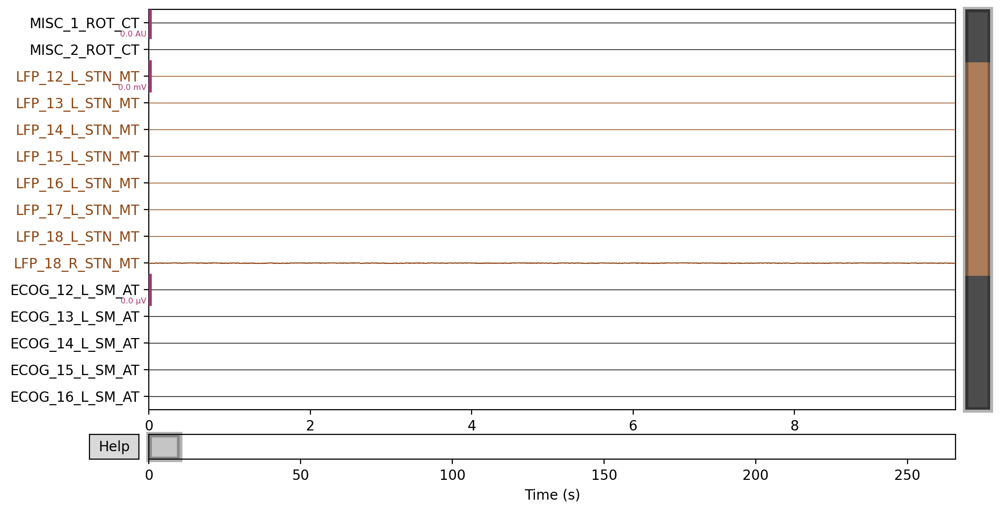

Channels marked as bad: none


In [210]:
raw.plot(scalings='auto')

In [211]:
raw.ch_names

['MISC_1_ROT_CT',
 'MISC_2_ROT_CT',
 'ECOG_12_L_SM_AT',
 'ECOG_13_L_SM_AT',
 'ECOG_14_L_SM_AT',
 'ECOG_15_L_SM_AT',
 'ECOG_16_L_SM_AT',
 'LFP_12_L_STN_MT',
 'LFP_13_L_STN_MT',
 'LFP_14_L_STN_MT',
 'LFP_15_L_STN_MT',
 'LFP_16_L_STN_MT',
 'LFP_17_L_STN_MT',
 'LFP_18_L_STN_MT',
 'LFP_18_R_STN_MT']

In [212]:
new_chs =  ['MISC_1_ROT_CT',
             'MISC_2_ROT_CT',
            'ECOG_L_1_2_SMC_AT',
           'ECOG_L_1_3_SMC_AT',
           'ECOG_L_1_4_SMC_AT',
           'ECOG_L_1_5_SMC_AT',
           'ECOG_L_1_6_SMC_AT',
             'LFP_L_1_2_STN_BS',
            'LFP_L_1_3_STN_BS',
            'LFP_L_1_4_STN_BS',
            'LFP_L_1_5_STN_BS',
            'LFP_L_1_6_STN_BS',
            'LFP_L_1_7_STN_BS',
            'LFP_L_1_8_STN_BS',
            'LFP_R_1_8_STN_BS']

In [213]:
picks = ['ECOG_L_1_2_SMC_AT',
           'ECOG_L_1_3_SMC_AT',
           'ECOG_L_1_4_SMC_AT',
           'ECOG_L_1_5_SMC_AT',
           'ECOG_L_1_6_SMC_AT',
             'LFP_L_1_2_STN_BS',
            'LFP_L_1_3_STN_BS',
            'LFP_L_1_4_STN_BS',
            'LFP_L_1_5_STN_BS',
            'LFP_L_1_6_STN_BS',
            'LFP_L_1_7_STN_BS',
            'LFP_L_1_8_STN_BS',
            'LFP_R_1_8_STN_BS']
raw = rename_chs(raw, new_chs, picks=picks)

ECOG_L_1_2_SMC_ :  ecog
ECOG_L_1_3_SMC_ :  ecog
ECOG_L_1_4_SMC_ :  ecog
ECOG_L_1_5_SMC_ :  ecog
ECOG_L_1_6_SMC_ :  ecog
LFP_L_1_2_STN_B :  seeg
LFP_L_1_3_STN_B :  seeg
LFP_L_1_4_STN_B :  seeg
LFP_L_1_5_STN_B :  seeg
LFP_L_1_6_STN_B :  seeg
LFP_L_1_7_STN_B :  seeg
LFP_L_1_8_STN_B :  seeg
LFP_R_1_8_STN_B :  seeg


In [214]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOn02\ieeg\dummy.vhdr...
Setting channel info structure...
ECOG_L_1_2_SMC_ :  ecog
ECOG_L_1_3_SMC_ :  ecog
ECOG_L_1_4_SMC_ :  ecog
ECOG_L_1_5_SMC_ :  ecog
ECOG_L_1_6_SMC_ :  ecog
LFP_L_1_2_STN_B :  seeg
LFP_L_1_3_STN_B :  seeg
LFP_L_1_4_STN_B :  seeg
LFP_L_1_5_STN_B :  seeg
LFP_L_1_6_STN_B :  seeg
LFP_L_1_7_STN_B :  seeg
LFP_L_1_8_STN_B :  seeg
LFP_R_1_8_STN_B :  seeg
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOn02\ieeg\dummy.vhdr...
Setting channel info structure...
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\ses-EphysMedOn02\ieeg\sub-001_ses-EphysMedOn02_task-Rest_acq-StimOn_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from 

c:\users\richa\github\mne-bids\mne_bids\read.py:154: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '
c:\users\richa\github\mne-bids\mne_bids\path.py:1092: RuntimeWarning: Did not find any events.tsv associated with sub-001_ses-EphysMedOn02_task-Rest_acq-StimOn_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\**\sub-001_ses-EphysMedOn02*events.tsv"
  warn(msg)


# Next file

In [219]:
i = 17

In [220]:
raws[i]

<RawBrainVision | sub-001_ses-EphysMedOn02_task-Rest_acq-StimOn_run-02_ieeg.eeg, 15 x 604809 (121.0 s), ~24 kB, data not loaded>

In [221]:
raw = raws[i]
file = files[i]

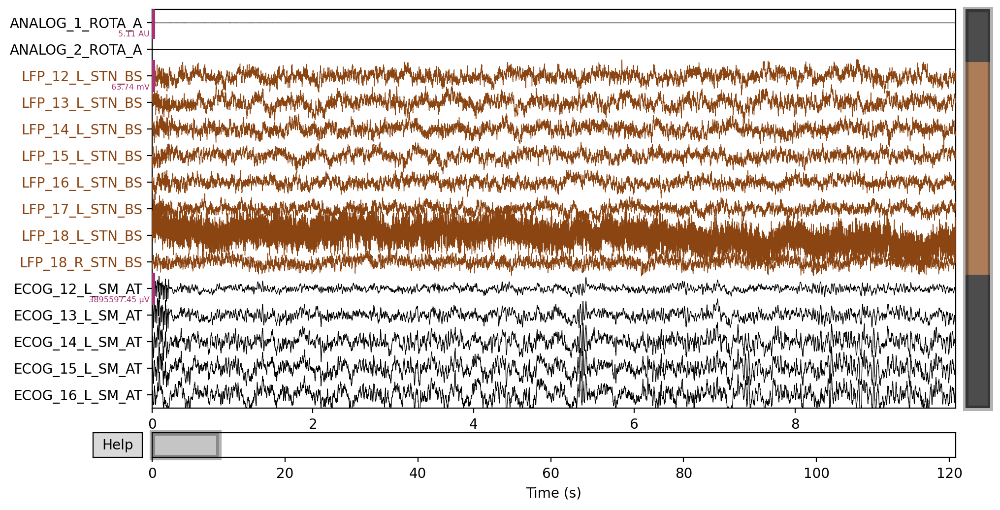

Channels marked as bad: none


In [224]:
raw.plot(scalings='auto')

In [225]:
raw.ch_names

['ANALOG_1_ROTA_A',
 'ANALOG_2_ROTA_A',
 'ECOG_12_L_SM_AT',
 'ECOG_13_L_SM_AT',
 'ECOG_14_L_SM_AT',
 'ECOG_15_L_SM_AT',
 'ECOG_16_L_SM_AT',
 'LFP_12_L_STN_BS',
 'LFP_13_L_STN_BS',
 'LFP_14_L_STN_BS',
 'LFP_15_L_STN_BS',
 'LFP_16_L_STN_BS',
 'LFP_17_L_STN_BS',
 'LFP_18_L_STN_BS',
 'LFP_18_R_STN_BS']

In [226]:
new_chs =  ['ANALOG_1_ROTA_A',
 'ANALOG_2_ROTA_A',
            'ECOG_L_1_2_SMC_AT',
           'ECOG_L_1_3_SMC_AT',
           'ECOG_L_1_4_SMC_AT',
           'ECOG_L_1_5_SMC_AT',
           'ECOG_L_1_6_SMC_AT',
             'LFP_L_1_2_STN_BS',
            'LFP_L_1_3_STN_BS',
            'LFP_L_1_4_STN_BS',
            'LFP_L_1_5_STN_BS',
            'LFP_L_1_6_STN_BS',
            'LFP_L_1_7_STN_BS',
            'LFP_L_1_8_STN_BS',
            'LFP_R_1_8_STN_BS']

In [227]:
picks = ['ECOG_L_1_2_SMC_AT',
           'ECOG_L_1_3_SMC_AT',
           'ECOG_L_1_4_SMC_AT',
           'ECOG_L_1_5_SMC_AT',
           'ECOG_L_1_6_SMC_AT',
             'LFP_L_1_2_STN_BS',
            'LFP_L_1_3_STN_BS',
            'LFP_L_1_4_STN_BS',
            'LFP_L_1_5_STN_BS',
            'LFP_L_1_6_STN_BS',
            'LFP_L_1_7_STN_BS',
            'LFP_L_1_8_STN_BS',
            'LFP_R_1_8_STN_BS']
raw = rename_chs(raw, new_chs, picks=picks)

ECOG_L_1_2_SMC_ :  ecog
ECOG_L_1_3_SMC_ :  ecog
ECOG_L_1_4_SMC_ :  ecog
ECOG_L_1_5_SMC_ :  ecog
ECOG_L_1_6_SMC_ :  ecog
LFP_L_1_2_STN_B :  seeg
LFP_L_1_3_STN_B :  seeg
LFP_L_1_4_STN_B :  seeg
LFP_L_1_5_STN_B :  seeg
LFP_L_1_6_STN_B :  seeg
LFP_L_1_7_STN_B :  seeg
LFP_L_1_8_STN_B :  seeg
LFP_R_1_8_STN_B :  seeg


In [228]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOn02\ieeg\dummy.vhdr...
Setting channel info structure...
ECOG_L_1_2_SMC_ :  ecog
ECOG_L_1_3_SMC_ :  ecog
ECOG_L_1_4_SMC_ :  ecog
ECOG_L_1_5_SMC_ :  ecog
ECOG_L_1_6_SMC_ :  ecog
LFP_L_1_2_STN_B :  seeg
LFP_L_1_3_STN_B :  seeg
LFP_L_1_4_STN_B :  seeg
LFP_L_1_5_STN_B :  seeg
LFP_L_1_6_STN_B :  seeg
LFP_L_1_7_STN_B :  seeg
LFP_L_1_8_STN_B :  seeg
LFP_R_1_8_STN_B :  seeg
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-001\ses-EphysMedOn02\ieeg\dummy.vhdr...
Setting channel info structure...
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\ses-EphysMedOn02\ieeg\sub-001_ses-EphysMedOn02_task-Rest_acq-StimOn_run-02_ieeg.vhdr...
Setting channel info structure...
Reading channel info from 

c:\users\richa\github\mne-bids\mne_bids\read.py:154: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '
c:\users\richa\github\mne-bids\mne_bids\path.py:1092: RuntimeWarning: Did not find any events.tsv associated with sub-001_ses-EphysMedOn02_task-Rest_acq-StimOn_run-02.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\**\sub-001_ses-EphysMedOn02*events.tsv"
  warn(msg)


# Next file

In [55]:
i = 18

In [56]:
raws[i]

<RawBrainVision | sub-002_ses-EphysMedOff01_task-Rest_acq-StimOff_run-01_ieeg.eeg, 27 x 1232738 (300.8 s), ~35 kB, data not loaded>

In [57]:
raw = raws[i]
file = files[i]

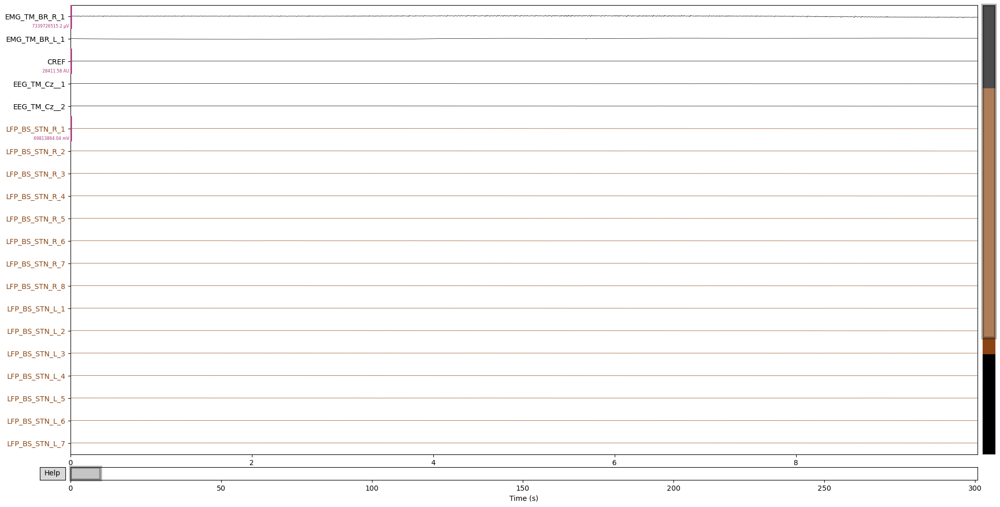

Channels marked as bad: none


In [58]:
raw.plot(scalings='auto')

In [59]:
raw.ch_names

['CREF',
 'LFP_BS_STN_R_1',
 'LFP_BS_STN_R_2',
 'LFP_BS_STN_R_3',
 'LFP_BS_STN_R_4',
 'LFP_BS_STN_R_5',
 'LFP_BS_STN_R_6',
 'LFP_BS_STN_R_7',
 'LFP_BS_STN_R_8',
 'LFP_BS_STN_L_1',
 'LFP_BS_STN_L_2',
 'LFP_BS_STN_L_3',
 'LFP_BS_STN_L_4',
 'LFP_BS_STN_L_5',
 'LFP_BS_STN_L_6',
 'LFP_BS_STN_L_7',
 'LFP_BS_STN_L_8',
 'EEG_TM_Cz__1',
 'EEG_TM_Cz__2',
 'ECOG_AT_SM_L_1',
 'ECOG_AT_SM_L_2',
 'ECOG_AT_SM_L_3',
 'ECOG_AT_SM_L_4',
 'ECOG_AT_SM_L_5',
 'ECOG_AT_SM_L_6',
 'EMG_TM_BR_R_1',
 'EMG_TM_BR_L_1']

In [60]:
new_chs =  ['REF_EARLOBE',
            'LFP_R_1_STN_BS',
            'LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_R_8_STN_BS',
            'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
             'EEG_Cz_TM',
             'EEG_Fz_TM',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
           'ECOG_L_3_SMC_AT',
           'ECOG_L_4_SMC_AT',
           'ECOG_L_5_SMC_AT',
           'ECOG_L_6_SMC_AT',
             'EMG_R_BR_TM',
             'EMG_L_BR_TM']

In [61]:
picks = None
raw = rename_chs(raw, new_chs, picks=picks)

REF_EARLOBE :  misc
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EMG_R_BR_TM :  emg
EMG_L_BR_TM :  emg


In [62]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff01\ieeg\dummy.vhdr...
Setting channel info structure...
REF_EARLOBE :  misc
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EMG_R_BR_TM :  emg
EMG_L_BR_TM :  emg
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff01\ieeg\dummy.vhdr...
Setting channel info str

c:\users\richa\github\mne-bids\mne_bids\read.py:156: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '


Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\ses-EphysMedOff01\ieeg\sub-002_ses-EphysMedOff01_task-Rest_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\ses-EphysMedOff01\ieeg\sub-002_ses-EphysMedOff01_task-Rest_acq-StimOff_run-01_channels.tsv.


c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-002_ses-EphysMedOff01_task-Rest_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\**\sub-002_ses-EphysMedOff01*events.tsv"
  warn(msg)


# Next file

In [297]:
i = 19

In [298]:
raws[i]

<RawBrainVision | sub-002_ses-EphysMedOff01_task-Rest_acq-StimOff_run-02_ieeg.eeg, 26 x 826710 (201.7 s), ~35 kB, data not loaded>

In [299]:
raw = raws[i]
file = files[i]

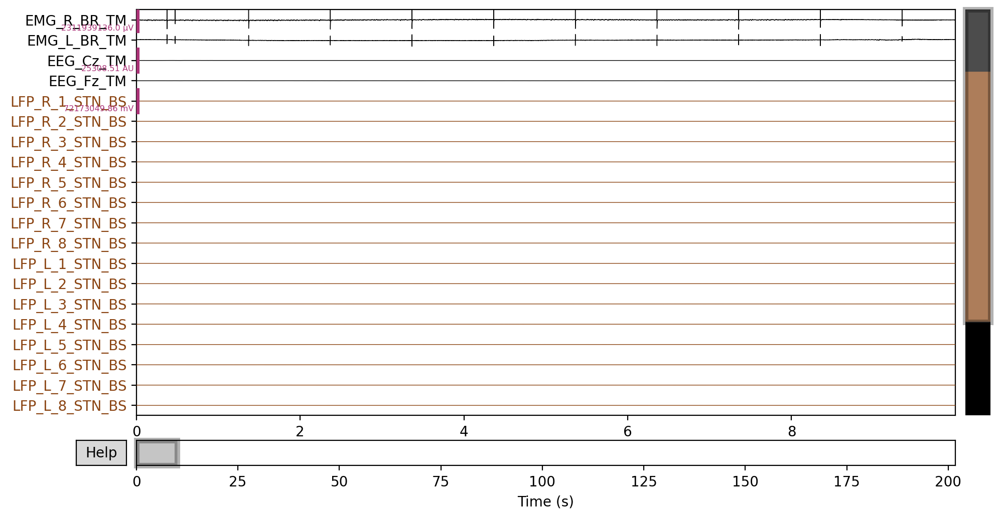

Channels marked as bad: none


In [300]:
raw.plot(scalings='auto')

In [301]:
raw.ch_names

['LFP_R_1_STN_BS',
 'LFP_R_2_STN_BS',
 'LFP_R_3_STN_BS',
 'LFP_R_4_STN_BS',
 'LFP_R_5_STN_BS',
 'LFP_R_6_STN_BS',
 'LFP_R_7_STN_BS',
 'LFP_R_8_STN_BS',
 'LFP_L_1_STN_BS',
 'LFP_L_2_STN_BS',
 'LFP_L_3_STN_BS',
 'LFP_L_4_STN_BS',
 'LFP_L_5_STN_BS',
 'LFP_L_6_STN_BS',
 'LFP_L_7_STN_BS',
 'LFP_L_8_STN_BS',
 'EEG_Cz_TM',
 'EEG_Fz_TM',
 'ECOG_L_1_SMC_AT',
 'ECOG_L_2_SMC_AT',
 'ECOG_L_3_SMC_AT',
 'ECOG_L_4_SMC_AT',
 'ECOG_L_5_SMC_AT',
 'ECOG_L_6_SMC_AT',
 'EMG_R_BR_TM',
 'EMG_L_BR_TM']

In [244]:
new_chs =  ['LFP_R_1_STN_BS',
            'LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_R_8_STN_BS',
            'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
             'EEG_Cz_TM',
             'EEG_Fz_TM',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
           'ECOG_L_3_SMC_AT',
           'ECOG_L_4_SMC_AT',
           'ECOG_L_5_SMC_AT',
           'ECOG_L_6_SMC_AT',
             'EMG_R_BR_TM',
             'EMG_L_BR_TM']

In [245]:
picks = None
raw = rename_chs(raw, new_chs, picks=picks)

LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
EEG_Cz_TM :  misc
EEG_Fz_TM :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EMG_R_BR_TM :  emg
EMG_L_BR_TM :  emg


In [246]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff01\ieeg\dummy.vhdr...
Setting channel info structure...
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
EEG_Cz_TM :  misc
EEG_Fz_TM :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EMG_R_BR_TM :  emg
EMG_L_BR_TM :  emg
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff01\ieeg\dummy.vhdr...
Setting channel info structure...
Extracti

c:\users\richa\github\mne-bids\mne_bids\read.py:154: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '
c:\users\richa\github\mne-bids\mne_bids\path.py:1092: RuntimeWarning: Did not find any events.tsv associated with sub-002_ses-EphysMedOff01_task-Rest_acq-StimOff_run-02.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\**\sub-002_ses-EphysMedOff01*events.tsv"
  warn(msg)


# Next file

In [247]:
i = 20

In [248]:
raws[i]

<RawBrainVision | sub-002_ses-EphysMedOff02_task-Evoked_acq-StimOn_run-01_ieeg.eeg, 11 x 83271 (60.5 s), ~20 kB, data not loaded>

In [249]:
raw = raws[i]
file = files[i]

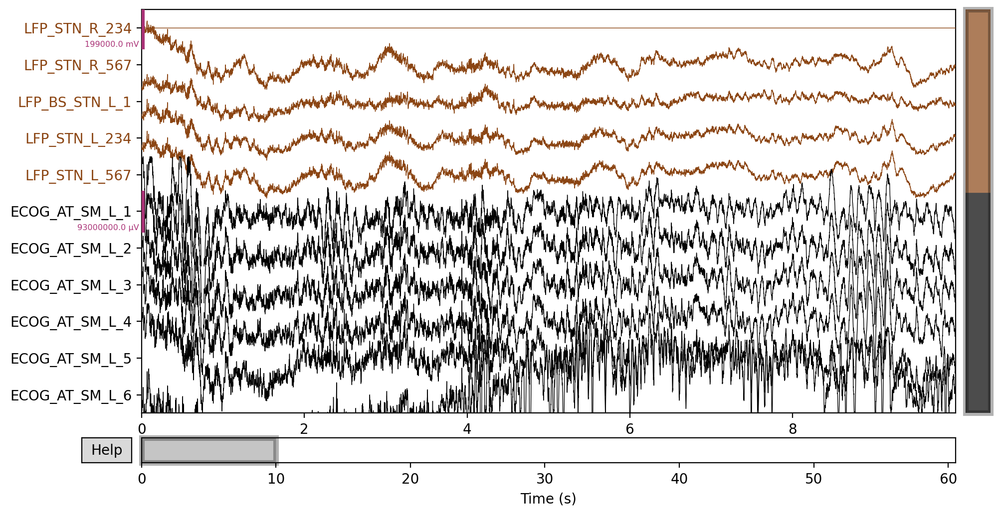

Channels marked as bad: none


In [250]:
raw.plot(scalings='auto')

In [251]:
raw.ch_names

['LFP_STN_R_234',
 'LFP_STN_R_567',
 'LFP_BS_STN_L_1',
 'LFP_STN_L_234',
 'LFP_STN_L_567',
 'ECOG_AT_SM_L_1',
 'ECOG_AT_SM_L_2',
 'ECOG_AT_SM_L_3',
 'ECOG_AT_SM_L_4',
 'ECOG_AT_SM_L_5',
 'ECOG_AT_SM_L_6']

In [252]:
new_chs =  ['LFP_R_234_STN_BS',
             'LFP_R_567_STN_BS',
             'LFP_L_1_STN_BS',
             'LFP_L_234_STN_BS',
             'LFP_L_567_STN_BS',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
           'ECOG_L_3_SMC_AT',
           'ECOG_L_4_SMC_AT',
           'ECOG_L_5_SMC_AT',
           'ECOG_L_6_SMC_AT']

In [253]:
picks = None
raw = rename_chs(raw, new_chs, picks=picks)

LFP_R_234_STN_B :  seeg
LFP_R_567_STN_B :  seeg
LFP_L_1_STN_BS :  seeg
LFP_L_234_STN_B :  seeg
LFP_L_567_STN_B :  seeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog


In [254]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff02\ieeg\dummy.vhdr...
Setting channel info structure...
LFP_R_234_STN_B :  seeg
LFP_R_567_STN_B :  seeg
LFP_L_1_STN_BS :  seeg
LFP_L_234_STN_B :  seeg
LFP_L_567_STN_B :  seeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff02\ieeg\dummy.vhdr...
Setting channel info structure...
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\ses-EphysMedOff02\ieeg\sub-002_ses-EphysMedOff02_task-Evoked_acq-StimOn_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Univers

c:\users\richa\github\mne-bids\mne_bids\read.py:154: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '
c:\users\richa\github\mne-bids\mne_bids\path.py:1092: RuntimeWarning: Did not find any events.tsv associated with sub-002_ses-EphysMedOff02_task-Evoked_acq-StimOn_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\**\sub-002_ses-EphysMedOff02*events.tsv"
  warn(msg)


# Next file

In [257]:
i = 21

In [258]:
raws[i]

<RawBrainVision | sub-002_ses-EphysMedOff02_task-Evoked_acq-StimOn_run-02_ieeg.eeg, 11 x 126288 (91.8 s), ~20 kB, data not loaded>

In [259]:
raw = raws[i]
file = files[i]

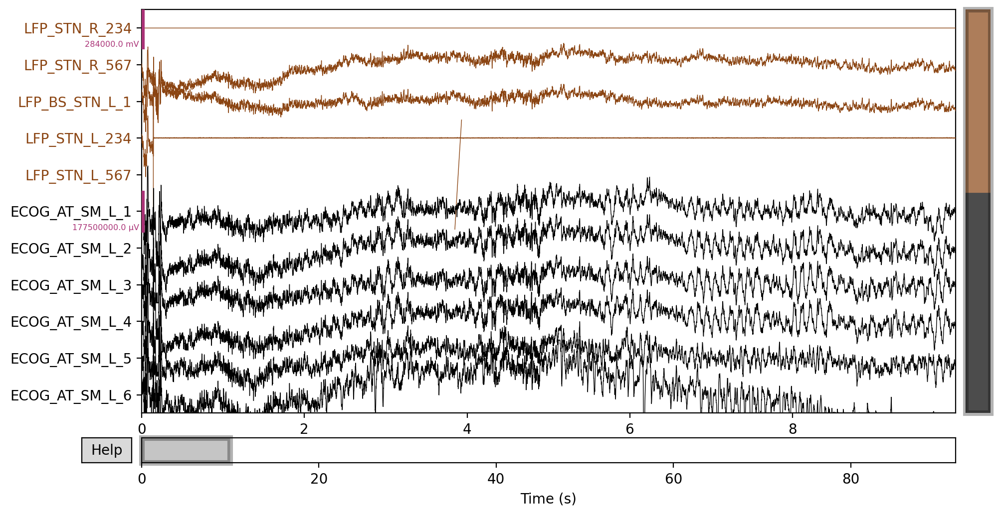

Channels marked as bad: none


In [260]:
raw.plot(scalings='auto')

In [261]:
raw.ch_names

['LFP_STN_R_234',
 'LFP_STN_R_567',
 'LFP_BS_STN_L_1',
 'LFP_STN_L_234',
 'LFP_STN_L_567',
 'ECOG_AT_SM_L_1',
 'ECOG_AT_SM_L_2',
 'ECOG_AT_SM_L_3',
 'ECOG_AT_SM_L_4',
 'ECOG_AT_SM_L_5',
 'ECOG_AT_SM_L_6']

In [262]:
new_chs =  ['LFP_R_234_STN_BS',
             'LFP_R_567_STN_BS',
             'LFP_L_1_STN_BS',
             'LFP_L_234_STN_BS',
             'LFP_L_567_STN_BS',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
           'ECOG_L_3_SMC_AT',
           'ECOG_L_4_SMC_AT',
           'ECOG_L_5_SMC_AT',
           'ECOG_L_6_SMC_AT']

In [263]:
picks = None
raw = rename_chs(raw, new_chs, picks=picks)

LFP_R_234_STN_B :  seeg
LFP_R_567_STN_B :  seeg
LFP_L_1_STN_BS :  seeg
LFP_L_234_STN_B :  seeg
LFP_L_567_STN_B :  seeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog


In [264]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff02\ieeg\dummy.vhdr...
Setting channel info structure...
LFP_R_234_STN_B :  seeg
LFP_R_567_STN_B :  seeg
LFP_L_1_STN_BS :  seeg
LFP_L_234_STN_B :  seeg
LFP_L_567_STN_B :  seeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff02\ieeg\dummy.vhdr...
Setting channel info structure...
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\ses-EphysMedOff02\ieeg\sub-002_ses-EphysMedOff02_task-Evoked_acq-StimOn_run-02_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Univers

c:\users\richa\github\mne-bids\mne_bids\read.py:154: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '
c:\users\richa\github\mne-bids\mne_bids\path.py:1092: RuntimeWarning: Did not find any events.tsv associated with sub-002_ses-EphysMedOff02_task-Evoked_acq-StimOn_run-02.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\**\sub-002_ses-EphysMedOff02*events.tsv"
  warn(msg)


# Next file

In [265]:
i = 22

In [266]:
raws[i]

<RawBrainVision | sub-002_ses-EphysMedOff02_task-Evoked_acq-StimOn_run-03_ieeg.eeg, 11 x 728127 (529.3 s), ~20 kB, data not loaded>

In [267]:
raw = raws[i]
file = files[i]

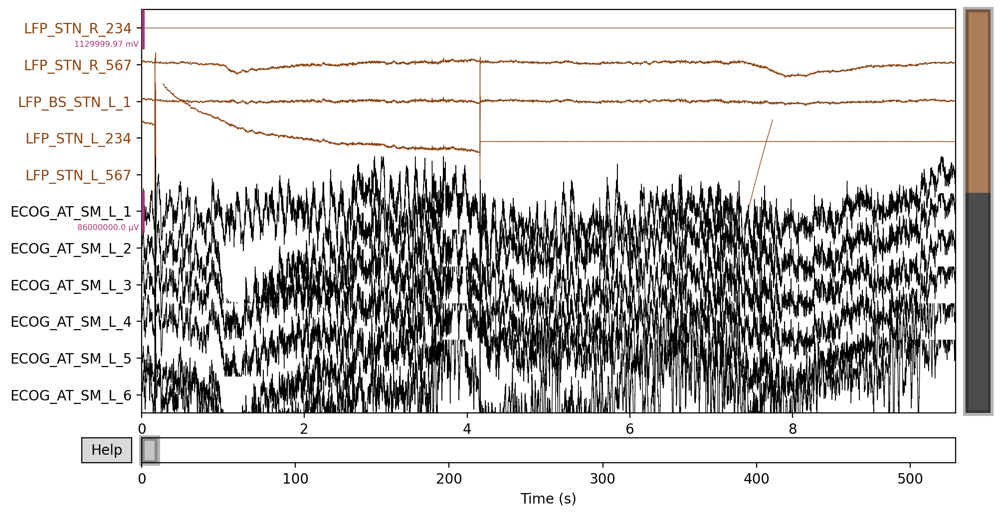

Channels marked as bad: none


In [268]:
raw.plot(scalings='auto')

In [269]:
raw.ch_names

['LFP_STN_R_234',
 'LFP_STN_R_567',
 'LFP_BS_STN_L_1',
 'LFP_STN_L_234',
 'LFP_STN_L_567',
 'ECOG_AT_SM_L_1',
 'ECOG_AT_SM_L_2',
 'ECOG_AT_SM_L_3',
 'ECOG_AT_SM_L_4',
 'ECOG_AT_SM_L_5',
 'ECOG_AT_SM_L_6']

In [270]:
new_chs =  ['LFP_R_234_STN_BS',
             'LFP_R_567_STN_BS',
             'LFP_L_1_STN_BS',
             'LFP_L_234_STN_BS',
             'LFP_L_567_STN_BS',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
           'ECOG_L_3_SMC_AT',
           'ECOG_L_4_SMC_AT',
           'ECOG_L_5_SMC_AT',
           'ECOG_L_6_SMC_AT']

In [271]:
picks = None
raw = rename_chs(raw, new_chs, picks=picks)

LFP_R_234_STN_B :  seeg
LFP_R_567_STN_B :  seeg
LFP_L_1_STN_BS :  seeg
LFP_L_234_STN_B :  seeg
LFP_L_567_STN_B :  seeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog


In [272]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff02\ieeg\dummy.vhdr...
Setting channel info structure...
LFP_R_234_STN_B :  seeg
LFP_R_567_STN_B :  seeg
LFP_L_1_STN_BS :  seeg
LFP_L_234_STN_B :  seeg
LFP_L_567_STN_B :  seeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff02\ieeg\dummy.vhdr...
Setting channel info structure...
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\ses-EphysMedOff02\ieeg\sub-002_ses-EphysMedOff02_task-Evoked_acq-StimOn_run-03_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Univers

c:\users\richa\github\mne-bids\mne_bids\read.py:154: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '
c:\users\richa\github\mne-bids\mne_bids\path.py:1092: RuntimeWarning: Did not find any events.tsv associated with sub-002_ses-EphysMedOff02_task-Evoked_acq-StimOn_run-03.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\**\sub-002_ses-EphysMedOff02*events.tsv"
  warn(msg)


# Next file

In [274]:
i = 23

In [275]:
raws[i]

<RawBrainVision | sub-002_ses-EphysMedOff02_task-Rest_acq-StimOff_run-01_ieeg.eeg, 22 x 743208 (181.3 s), ~30 kB, data not loaded>

In [276]:
raw = raws[i]
file = files[i]

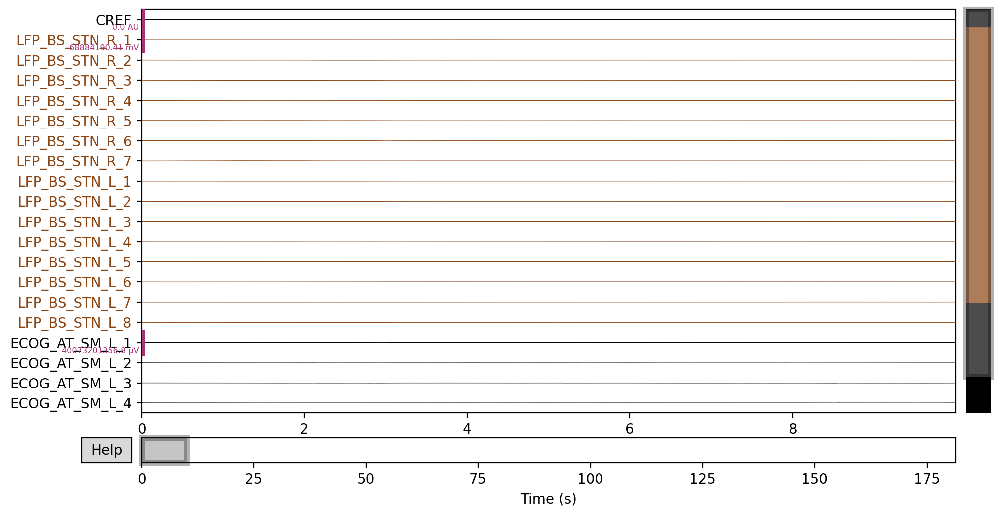

Channels marked as bad: none


In [280]:
raw.plot(scalings='auto')

In [286]:
raw.ch_names

['CREF',
 'LFP_BS_STN_R_1',
 'LFP_BS_STN_R_2',
 'LFP_BS_STN_R_3',
 'LFP_BS_STN_R_4',
 'LFP_BS_STN_R_5',
 'LFP_BS_STN_R_6',
 'LFP_BS_STN_R_7',
 'LFP_BS_STN_L_1',
 'LFP_BS_STN_L_2',
 'LFP_BS_STN_L_3',
 'LFP_BS_STN_L_4',
 'LFP_BS_STN_L_5',
 'LFP_BS_STN_L_6',
 'LFP_BS_STN_L_7',
 'LFP_BS_STN_L_8',
 'ECOG_AT_SM_L_1',
 'ECOG_AT_SM_L_2',
 'ECOG_AT_SM_L_3',
 'ECOG_AT_SM_L_4',
 'ECOG_AT_SM_L_5',
 'ECOG_AT_SM_L_6']

In [289]:
new_chs =  ['LFP_R_8_STN_BS',
            'LFP_R_1_STN_BS',
            'LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
           'ECOG_L_3_SMC_AT',
           'ECOG_L_4_SMC_AT',
           'ECOG_L_5_SMC_AT',
           'ECOG_L_6_SMC_AT']

In [290]:
picks = None
raw = rename_chs(raw, new_chs, picks=picks)

LFP_R_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog


In [291]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff02\ieeg\dummy.vhdr...
Setting channel info structure...
LFP_R_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff02\ieeg\dummy.vhdr...
Setting channel info structure...
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin

c:\users\richa\github\mne-bids\mne_bids\read.py:154: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '
c:\users\richa\github\mne-bids\mne_bids\path.py:1092: RuntimeWarning: Did not find any events.tsv associated with sub-002_ses-EphysMedOff02_task-Rest_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\**\sub-002_ses-EphysMedOff02*events.tsv"
  warn(msg)


# Next file

In [304]:
i = 24

In [305]:
raws[i]

<RawBrainVision | sub-002_ses-EphysMedOff02_task-Rest_acq-StimOff_run-02_ieeg.eeg, 22 x 732218 (178.7 s), ~30 kB, data not loaded>

In [306]:
raw = raws[i]
file = files[i]

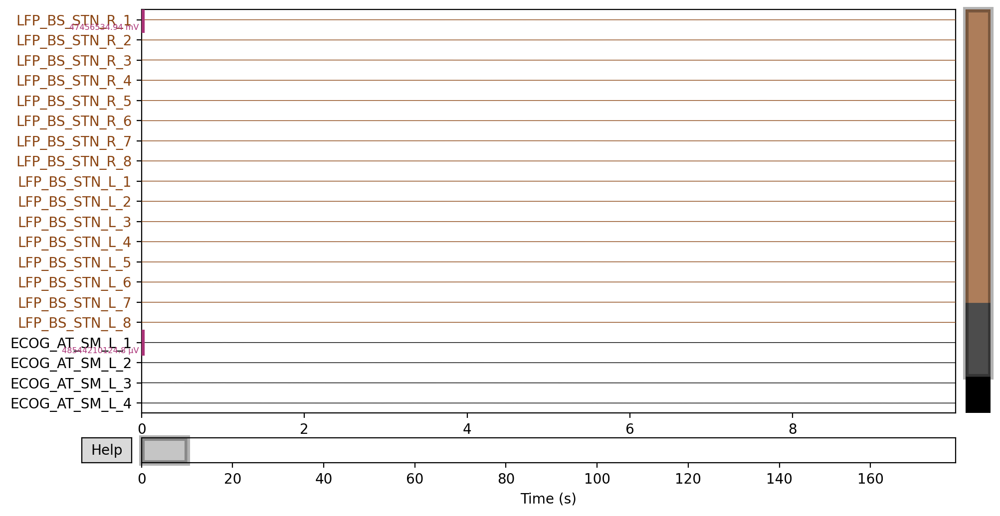

Channels marked as bad: none


In [307]:
raw.plot(scalings='auto')

In [308]:
raw.ch_names

['LFP_BS_STN_R_1',
 'LFP_BS_STN_R_2',
 'LFP_BS_STN_R_3',
 'LFP_BS_STN_R_4',
 'LFP_BS_STN_R_5',
 'LFP_BS_STN_R_6',
 'LFP_BS_STN_R_7',
 'LFP_BS_STN_R_8',
 'LFP_BS_STN_L_1',
 'LFP_BS_STN_L_2',
 'LFP_BS_STN_L_3',
 'LFP_BS_STN_L_4',
 'LFP_BS_STN_L_5',
 'LFP_BS_STN_L_6',
 'LFP_BS_STN_L_7',
 'LFP_BS_STN_L_8',
 'ECOG_AT_SM_L_1',
 'ECOG_AT_SM_L_2',
 'ECOG_AT_SM_L_3',
 'ECOG_AT_SM_L_4',
 'ECOG_AT_SM_L_5',
 'ECOG_AT_SM_L_6']

In [309]:
new_chs =  ['LFP_R_1_STN_BS',
            'LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_R_8_STN_BS',
            'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
           'ECOG_L_3_SMC_AT',
           'ECOG_L_4_SMC_AT',
           'ECOG_L_5_SMC_AT',
           'ECOG_L_6_SMC_AT']

In [310]:
picks = None
raw = rename_chs(raw, new_chs, picks=picks)

LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog


In [311]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff02\ieeg\dummy.vhdr...
Setting channel info structure...
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff02\ieeg\dummy.vhdr...
Setting channel info structure...
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin

c:\users\richa\github\mne-bids\mne_bids\read.py:154: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '
c:\users\richa\github\mne-bids\mne_bids\path.py:1092: RuntimeWarning: Did not find any events.tsv associated with sub-002_ses-EphysMedOff02_task-Rest_acq-StimOff_run-02.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\**\sub-002_ses-EphysMedOff02*events.tsv"
  warn(msg)


# Next file

In [312]:
i = 25

In [313]:
raws[i]

<RawBrainVision | sub-002_ses-EphysMedOff02_task-Rest_acq-StimOff_run-03_ieeg.eeg, 11 x 442712 (321.9 s), ~20 kB, data not loaded>

In [314]:
raw = raws[i]
file = files[i]

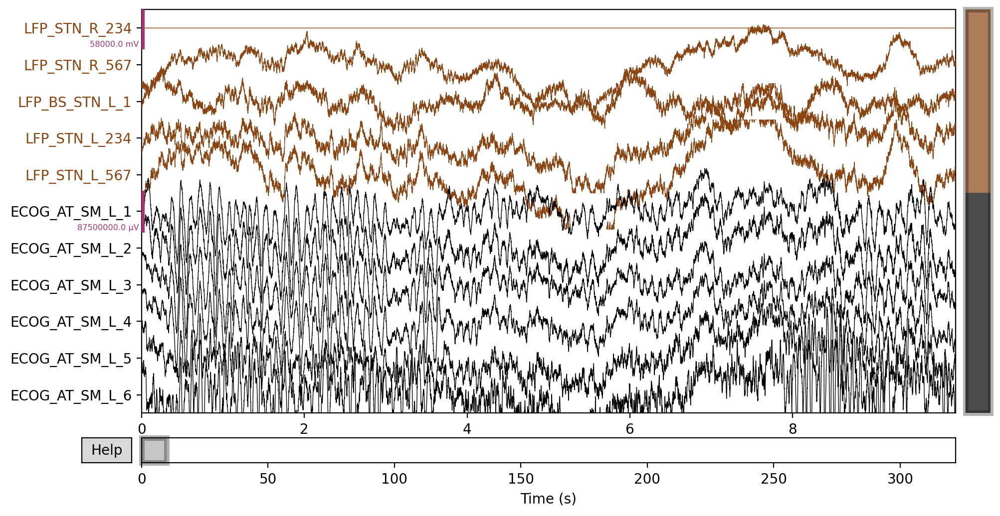

Channels marked as bad: none


In [315]:
raw.plot(scalings='auto')

In [316]:
raw.ch_names

['LFP_STN_R_234',
 'LFP_STN_R_567',
 'LFP_BS_STN_L_1',
 'LFP_STN_L_234',
 'LFP_STN_L_567',
 'ECOG_AT_SM_L_1',
 'ECOG_AT_SM_L_2',
 'ECOG_AT_SM_L_3',
 'ECOG_AT_SM_L_4',
 'ECOG_AT_SM_L_5',
 'ECOG_AT_SM_L_6']

In [317]:
new_chs =  ['LFP_R_234_STN_BS',
             'LFP_R_567_STN_BS',
             'LFP_L_1_STN_BS',
             'LFP_L_234_STN_BS',
             'LFP_L_567_STN_BS',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
           'ECOG_L_3_SMC_AT',
           'ECOG_L_4_SMC_AT',
           'ECOG_L_5_SMC_AT',
           'ECOG_L_6_SMC_AT']

In [318]:
picks = None
raw = rename_chs(raw, new_chs, picks=picks)

LFP_R_234_STN_B :  seeg
LFP_R_567_STN_B :  seeg
LFP_L_1_STN_BS :  seeg
LFP_L_234_STN_B :  seeg
LFP_L_567_STN_B :  seeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog


In [319]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff02\ieeg\dummy.vhdr...
Setting channel info structure...
LFP_R_234_STN_B :  seeg
LFP_R_567_STN_B :  seeg
LFP_L_1_STN_BS :  seeg
LFP_L_234_STN_B :  seeg
LFP_L_567_STN_B :  seeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff02\ieeg\dummy.vhdr...
Setting channel info structure...
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\ses-EphysMedOff02\ieeg\sub-002_ses-EphysMedOff02_task-Rest_acq-StimOff_run-03_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universi

c:\users\richa\github\mne-bids\mne_bids\read.py:154: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '
c:\users\richa\github\mne-bids\mne_bids\path.py:1092: RuntimeWarning: Did not find any events.tsv associated with sub-002_ses-EphysMedOff02_task-Rest_acq-StimOff_run-03.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\**\sub-002_ses-EphysMedOff02*events.tsv"
  warn(msg)


# Next file

In [322]:
i = 26

In [323]:
raws[i]

<RawBrainVision | sub-002_ses-EphysMedOff02_task-SelfpacedRotationR_acq-StimOff_run-01_ieeg.eeg, 12 x 613328 (446.1 s), ~21 kB, data not loaded>

In [324]:
raw = raws[i]
file = files[i]

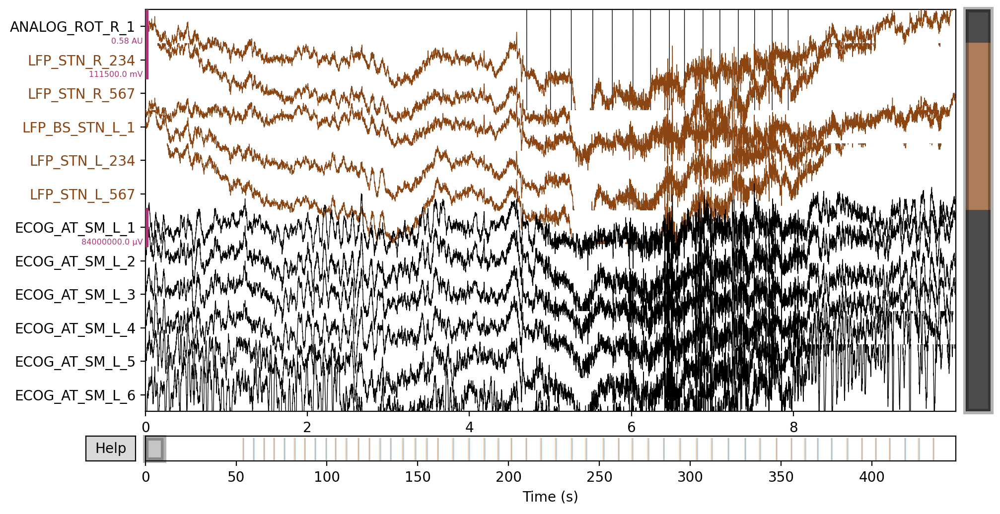

Channels marked as bad: none


In [325]:
raw.plot(scalings='auto')

In [326]:
raw.ch_names

['LFP_STN_R_234',
 'LFP_STN_R_567',
 'LFP_BS_STN_L_1',
 'LFP_STN_L_234',
 'LFP_STN_L_567',
 'ECOG_AT_SM_L_1',
 'ECOG_AT_SM_L_2',
 'ECOG_AT_SM_L_3',
 'ECOG_AT_SM_L_4',
 'ECOG_AT_SM_L_5',
 'ECOG_AT_SM_L_6',
 'ANALOG_ROT_R_1']

In [327]:
new_chs =  ['LFP_R_234_STN_BS',
             'LFP_R_567_STN_BS',
             'LFP_L_1_STN_BS',
             'LFP_L_234_STN_BS',
             'LFP_L_567_STN_BS',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
           'ECOG_L_3_SMC_AT',
           'ECOG_L_4_SMC_AT',
           'ECOG_L_5_SMC_AT',
           'ECOG_L_6_SMC_AT',
           'ANALOG_R_ROTA_CH']

In [328]:
picks = None
raw = rename_chs(raw, new_chs, picks=picks)

LFP_R_234_STN_B :  seeg
LFP_R_567_STN_B :  seeg
LFP_L_1_STN_BS :  seeg
LFP_L_234_STN_B :  seeg
LFP_L_567_STN_B :  seeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
ANALOG_R_ROTA_C :  misc


In [330]:
raw = mne.add_reference_channels(raw.load_data(), ['EEG_AO'])

Reading 0 ... 613327  =      0.000 ...   446.056 secs...


In [332]:
raw = raw.set_channel_types({'EEG_AO': 'misc'})

In [333]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Used Annotations descriptions: ['Movement_End', 'Movement_Onset']
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff02\ieeg\dummy.vhdr...
Setting channel info structure...
LFP_R_234_STN_B :  seeg
LFP_R_567_STN_B :  seeg
LFP_L_1_STN_BS :  seeg
LFP_L_234_STN_B :  seeg
LFP_L_567_STN_B :  seeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
ANALOG_R_ROTA_C :  misc
EEG_AO :  misc
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff02\ieeg\dummy.vhdr...
Setting channel info structure...
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\ses-EphysMedOff02\ieeg\sub-002_ses-EphysMedOff02_task-SelfpacedRotationR_acq-StimOff_run-0

# Next file

In [334]:
i = 27

In [335]:
raws[i]

<RawBrainVision | sub-002_ses-EphysMedOff02_task-Speech_acq-StimOff_run-01_ieeg.eeg, 22 x 915908 (223.5 s), ~30 kB, data not loaded>

In [336]:
raw = raws[i]
file = files[i]

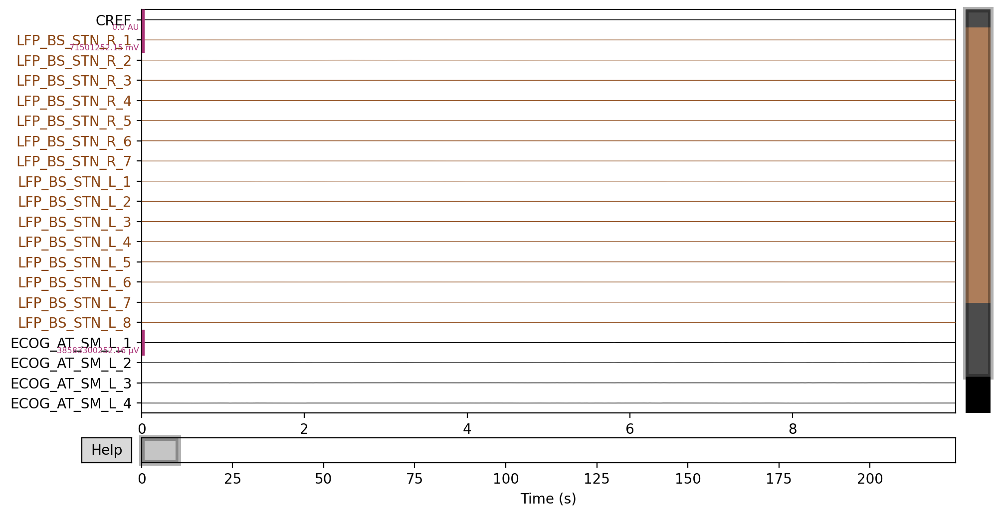

Channels marked as bad: none


In [337]:
raw.plot(scalings='auto')

In [338]:
raw.ch_names

['CREF',
 'LFP_BS_STN_R_1',
 'LFP_BS_STN_R_2',
 'LFP_BS_STN_R_3',
 'LFP_BS_STN_R_4',
 'LFP_BS_STN_R_5',
 'LFP_BS_STN_R_6',
 'LFP_BS_STN_R_7',
 'LFP_BS_STN_L_1',
 'LFP_BS_STN_L_2',
 'LFP_BS_STN_L_3',
 'LFP_BS_STN_L_4',
 'LFP_BS_STN_L_5',
 'LFP_BS_STN_L_6',
 'LFP_BS_STN_L_7',
 'LFP_BS_STN_L_8',
 'ECOG_AT_SM_L_1',
 'ECOG_AT_SM_L_2',
 'ECOG_AT_SM_L_3',
 'ECOG_AT_SM_L_4',
 'ECOG_AT_SM_L_5',
 'ECOG_AT_SM_L_6']

In [339]:
new_chs =  ['LFP_R_8_STN_BS',
            'LFP_R_1_STN_BS',
            'LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
           'ECOG_L_3_SMC_AT',
           'ECOG_L_4_SMC_AT',
           'ECOG_L_5_SMC_AT',
           'ECOG_L_6_SMC_AT']

In [340]:
picks = None
raw = rename_chs(raw, new_chs, picks=picks)

LFP_R_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog


In [341]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff02\ieeg\dummy.vhdr...
Setting channel info structure...
LFP_R_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff02\ieeg\dummy.vhdr...
Setting channel info structure...
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin

c:\users\richa\github\mne-bids\mne_bids\read.py:154: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '
c:\users\richa\github\mne-bids\mne_bids\path.py:1092: RuntimeWarning: Did not find any events.tsv associated with sub-002_ses-EphysMedOff02_task-Speech_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\**\sub-002_ses-EphysMedOff02*events.tsv"
  warn(msg)


# Next file

In [354]:
i = 28

In [355]:
raws[i]

<RawBrainVision | sub-002_ses-EphysMedOff03_task-Rest_acq-StimOff_run-01_ieeg.eeg, 24 x 1248962 (304.7 s), ~32 kB, data not loaded>

In [356]:
raw = raws[i]
file = files[i]

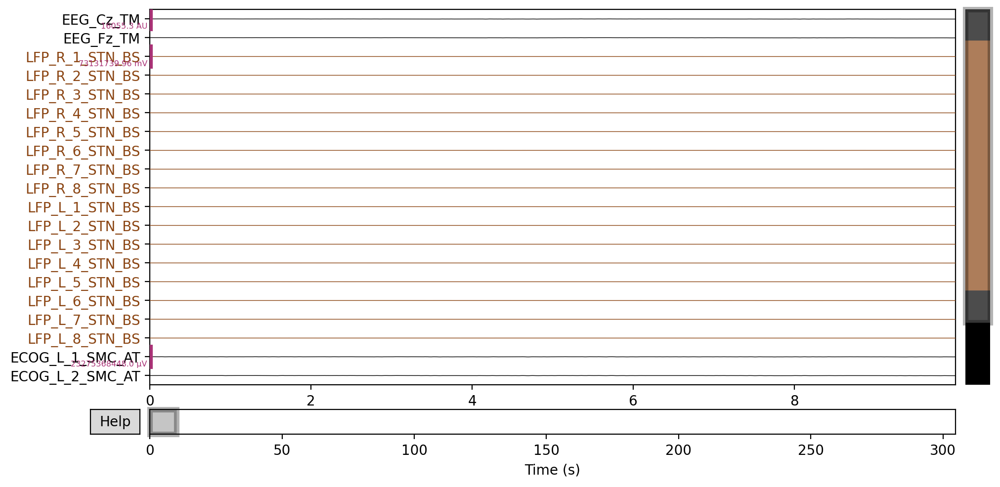

Channels marked as bad: none


In [357]:
raw.plot(scalings='auto')

In [358]:
raw.ch_names

['LFP_R_1_STN_BS',
 'LFP_R_2_STN_BS',
 'LFP_R_3_STN_BS',
 'LFP_R_4_STN_BS',
 'LFP_R_5_STN_BS',
 'LFP_R_6_STN_BS',
 'LFP_R_7_STN_BS',
 'LFP_R_8_STN_BS',
 'LFP_L_1_STN_BS',
 'LFP_L_2_STN_BS',
 'LFP_L_3_STN_BS',
 'LFP_L_4_STN_BS',
 'LFP_L_5_STN_BS',
 'LFP_L_6_STN_BS',
 'LFP_L_7_STN_BS',
 'LFP_L_8_STN_BS',
 'EEG_Cz_TM',
 'EEG_Fz_TM',
 'ECOG_L_1_SMC_AT',
 'ECOG_L_2_SMC_AT',
 'ECOG_L_3_SMC_AT',
 'ECOG_L_4_SMC_AT',
 'ECOG_L_5_SMC_AT',
 'ECOG_L_6_SMC_AT']

In [348]:
new_chs =  ['CREF',
            'LFP_R_1_STN_BS',
            'LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_R_8_STN_BS',
            'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
            'EEG_Cz_TM',
             'EEG_Fz_TM',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
           'ECOG_L_3_SMC_AT',
           'ECOG_L_4_SMC_AT',
           'ECOG_L_5_SMC_AT',
           'ECOG_L_6_SMC_AT']

In [349]:
picks = ['LFP_R_1_STN_BS',
            'LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_R_8_STN_BS',
            'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
            'EEG_Cz_TM',
             'EEG_Fz_TM',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
           'ECOG_L_3_SMC_AT',
           'ECOG_L_4_SMC_AT',
           'ECOG_L_5_SMC_AT',
           'ECOG_L_6_SMC_AT']
raw = rename_chs(raw, new_chs, picks=picks)

LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
EEG_Cz_TM :  misc
EEG_Fz_TM :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog


In [350]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff03\ieeg\dummy.vhdr...
Setting channel info structure...
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
EEG_Cz_TM :  misc
EEG_Fz_TM :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff03\ieeg\dummy.vhdr...
Setting channel info structure...
Extracting parameters from C:\Users\richa\OneD

c:\users\richa\github\mne-bids\mne_bids\read.py:154: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '
c:\users\richa\github\mne-bids\mne_bids\path.py:1092: RuntimeWarning: Did not find any events.tsv associated with sub-002_ses-EphysMedOff03_task-Rest_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\**\sub-002_ses-EphysMedOff03*events.tsv"
  warn(msg)


# Next file

In [359]:
i = 29

In [360]:
raws[i]

<RawBrainVision | sub-002_ses-EphysMedOff03_task-Rest_acq-StimOff_run-02_ieeg.eeg, 25 x 1230914 (300.3 s), ~33 kB, data not loaded>

In [361]:
raw = raws[i]
file = files[i]

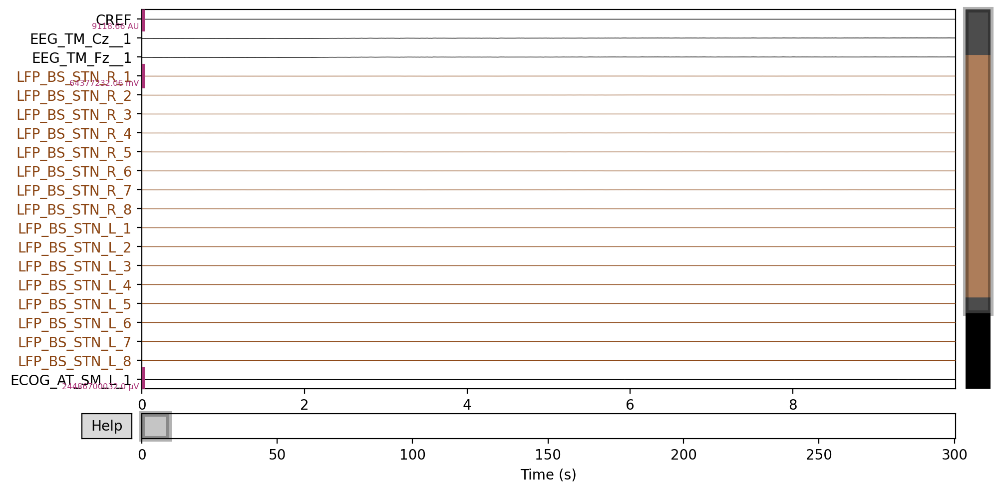

Channels marked as bad: none


In [362]:
raw.plot(scalings='auto')

In [363]:
raw.ch_names

['CREF',
 'LFP_BS_STN_R_1',
 'LFP_BS_STN_R_2',
 'LFP_BS_STN_R_3',
 'LFP_BS_STN_R_4',
 'LFP_BS_STN_R_5',
 'LFP_BS_STN_R_6',
 'LFP_BS_STN_R_7',
 'LFP_BS_STN_R_8',
 'LFP_BS_STN_L_1',
 'LFP_BS_STN_L_2',
 'LFP_BS_STN_L_3',
 'LFP_BS_STN_L_4',
 'LFP_BS_STN_L_5',
 'LFP_BS_STN_L_6',
 'LFP_BS_STN_L_7',
 'LFP_BS_STN_L_8',
 'EEG_TM_Cz__1',
 'EEG_TM_Fz__1',
 'ECOG_AT_SM_L_1',
 'ECOG_AT_SM_L_2',
 'ECOG_AT_SM_L_3',
 'ECOG_AT_SM_L_4',
 'ECOG_AT_SM_L_5',
 'ECOG_AT_SM_L_6']

In [372]:
new_chs =  ['REF_EARLOBE',
            'LFP_R_1_STN_BS',
            'LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_R_8_STN_BS',
            'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
             'EEG_Cz_TM',
             'EEG_Fz_TM',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
           'ECOG_L_3_SMC_AT',
           'ECOG_L_4_SMC_AT',
           'ECOG_L_5_SMC_AT',
           'ECOG_L_6_SMC_AT']

In [365]:
picks = None
raw = rename_chs(raw, new_chs, picks=picks)

REF_EARLOBE :  misc
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
EEG_Cz_TM :  misc
EEG_Fz_TM :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog


In [366]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff03\ieeg\dummy.vhdr...
Setting channel info structure...
REF_EARLOBE :  misc
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
EEG_Cz_TM :  misc
EEG_Fz_TM :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff03\ieeg\dummy.vhdr...
Setting channel info structure...
Extracting parameters from

c:\users\richa\github\mne-bids\mne_bids\read.py:154: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '
c:\users\richa\github\mne-bids\mne_bids\path.py:1092: RuntimeWarning: Did not find any events.tsv associated with sub-002_ses-EphysMedOff03_task-Rest_acq-StimOff_run-02.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\**\sub-002_ses-EphysMedOff03*events.tsv"
  warn(msg)


# Next file

In [367]:
i = 30

In [368]:
raws[i]

<RawBrainVision | sub-002_ses-EphysMedOff03_task-Rest_acq-StimOff_run-03_ieeg.eeg, 25 x 117719 (28.7 s), ~33 kB, data not loaded>

In [369]:
raw = raws[i]
file = files[i]

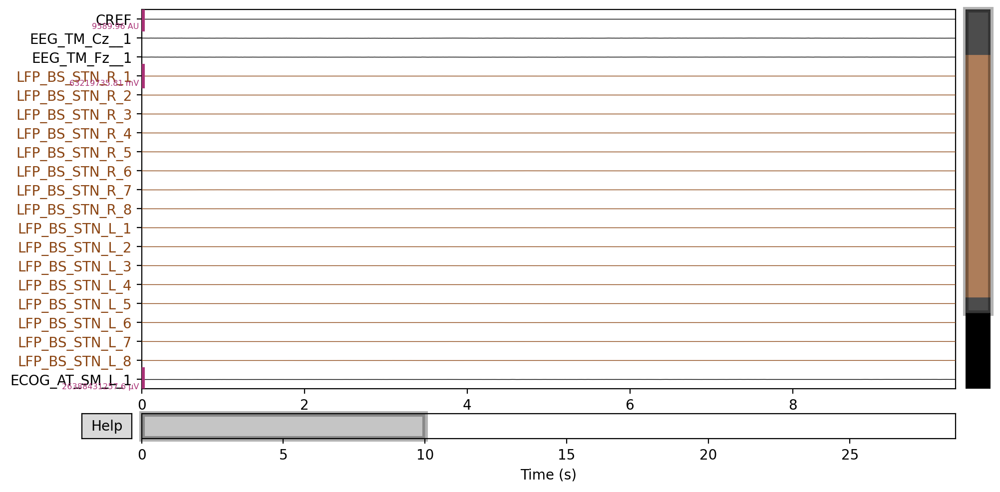

Channels marked as bad: none


In [370]:
raw.plot(scalings='auto')

In [371]:
raw.ch_names

['CREF',
 'LFP_BS_STN_R_1',
 'LFP_BS_STN_R_2',
 'LFP_BS_STN_R_3',
 'LFP_BS_STN_R_4',
 'LFP_BS_STN_R_5',
 'LFP_BS_STN_R_6',
 'LFP_BS_STN_R_7',
 'LFP_BS_STN_R_8',
 'LFP_BS_STN_L_1',
 'LFP_BS_STN_L_2',
 'LFP_BS_STN_L_3',
 'LFP_BS_STN_L_4',
 'LFP_BS_STN_L_5',
 'LFP_BS_STN_L_6',
 'LFP_BS_STN_L_7',
 'LFP_BS_STN_L_8',
 'EEG_TM_Cz__1',
 'EEG_TM_Fz__1',
 'ECOG_AT_SM_L_1',
 'ECOG_AT_SM_L_2',
 'ECOG_AT_SM_L_3',
 'ECOG_AT_SM_L_4',
 'ECOG_AT_SM_L_5',
 'ECOG_AT_SM_L_6']

In [373]:
new_chs =  ['REF_GREF',
            'LFP_R_1_STN_BS',
            'LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_R_8_STN_BS',
            'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
             'EEG_Cz_TM',
             'EEG_Fz_TM',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
           'ECOG_L_3_SMC_AT',
           'ECOG_L_4_SMC_AT',
           'ECOG_L_5_SMC_AT',
           'ECOG_L_6_SMC_AT']

In [374]:
picks = None
raw = rename_chs(raw, new_chs, picks=picks)

REF_GREF :  misc
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
EEG_Cz_TM :  misc
EEG_Fz_TM :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog


In [375]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff03\ieeg\dummy.vhdr...
Setting channel info structure...
REF_GREF :  misc
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
EEG_Cz_TM :  misc
EEG_Fz_TM :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff03\ieeg\dummy.vhdr...
Setting channel info structure...
Extracting parameters from C:

c:\users\richa\github\mne-bids\mne_bids\read.py:154: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '
c:\users\richa\github\mne-bids\mne_bids\path.py:1092: RuntimeWarning: Did not find any events.tsv associated with sub-002_ses-EphysMedOff03_task-Rest_acq-StimOff_run-03.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\**\sub-002_ses-EphysMedOff03*events.tsv"
  warn(msg)


# Next file

In [376]:
i = 31

In [377]:
raws[i]

<RawBrainVision | sub-002_ses-EphysMedOff03_task-Rest_acq-StimOff_run-04_ieeg.eeg, 28 x 241786 (175.8 s), ~36 kB, data not loaded>

In [378]:
raw = raws[i]
file = files[i]

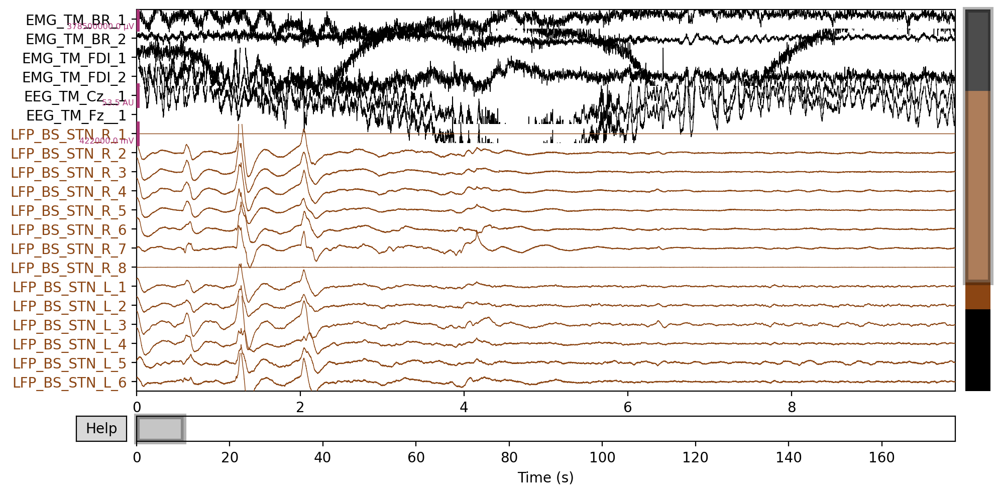

Channels marked as bad: none


In [379]:
raw.plot(scalings='auto')

In [380]:
raw.ch_names

['LFP_BS_STN_R_1',
 'LFP_BS_STN_R_2',
 'LFP_BS_STN_R_3',
 'LFP_BS_STN_R_4',
 'LFP_BS_STN_R_5',
 'LFP_BS_STN_R_6',
 'LFP_BS_STN_R_7',
 'LFP_BS_STN_R_8',
 'LFP_BS_STN_L_1',
 'LFP_BS_STN_L_2',
 'LFP_BS_STN_L_3',
 'LFP_BS_STN_L_4',
 'LFP_BS_STN_L_5',
 'LFP_BS_STN_L_6',
 'LFP_BS_STN_L_7',
 'LFP_BS_STN_L_8',
 'ECOG_AT_SM_L_1',
 'ECOG_AT_SM_L_2',
 'ECOG_AT_SM_L_3',
 'ECOG_AT_SM_L_4',
 'ECOG_AT_SM_L_5',
 'ECOG_AT_SM_L_6',
 'EEG_TM_Cz__1',
 'EEG_TM_Fz__1',
 'EMG_TM_BR_1',
 'EMG_TM_BR_2',
 'EMG_TM_FDI_1',
 'EMG_TM_FDI_2']

In [381]:
new_chs =  ['LFP_R_1_STN_BS',
            'LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_R_8_STN_BS',
            'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
           'ECOG_L_3_SMC_AT',
           'ECOG_L_4_SMC_AT',
           'ECOG_L_5_SMC_AT',
           'ECOG_L_6_SMC_AT',
             'EEG_Cz_AO',
             'EEG_Fz_AO',
             'EMG_1_BR_AO',
             'EMG_2_BR_AO',
             'EMG_1_FDI_AO',
             'EMG_2_FDI_AO']

In [382]:
picks = None
raw = rename_chs(raw, new_chs, picks=picks)

LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_AO :  misc
EEG_Fz_AO :  misc
EMG_1_BR_AO :  emg
EMG_2_BR_AO :  emg
EMG_1_FDI_AO :  emg
EMG_2_FDI_AO :  emg


In [383]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff03\ieeg\dummy.vhdr...
Setting channel info structure...
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_AO :  misc
EEG_Fz_AO :  misc
EMG_1_BR_AO :  emg
EMG_2_BR_AO :  emg
EMG_1_FDI_AO :  emg
EMG_2_FDI_AO :  emg
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff03\ieeg\dummy.vhdr...
Se

c:\users\richa\github\mne-bids\mne_bids\read.py:154: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '
c:\users\richa\github\mne-bids\mne_bids\path.py:1092: RuntimeWarning: Did not find any events.tsv associated with sub-002_ses-EphysMedOff03_task-Rest_acq-StimOff_run-04.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\**\sub-002_ses-EphysMedOff03*events.tsv"
  warn(msg)


# Next

In [384]:
i = 32

In [385]:
raws[i]

<RawBrainVision | sub-002_ses-EphysMedOff03_task-Rest_acq-StimOn_run-01_ieeg.eeg, 28 x 418229 (304.1 s), ~36 kB, data not loaded>

In [386]:
raw = raws[i]
file = files[i]

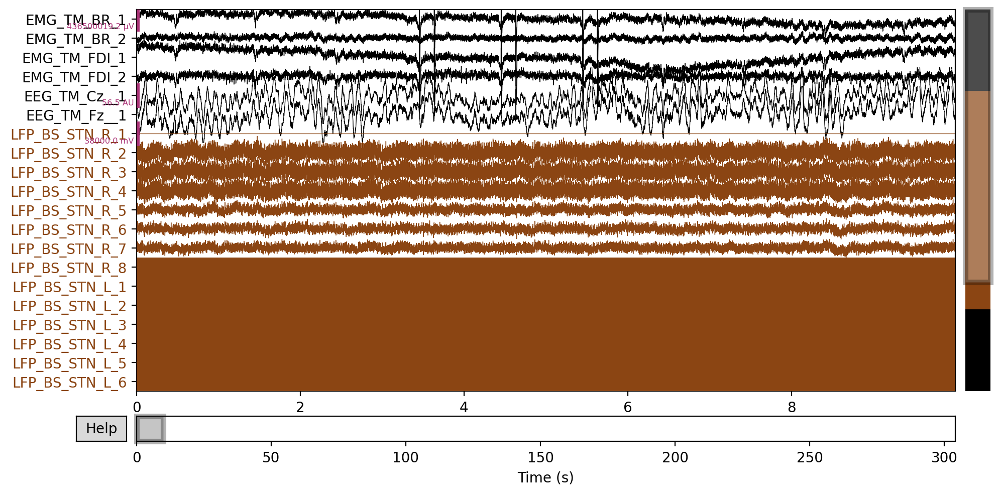

Channels marked as bad: ['LFP_BS_STN_L_2', 'LFP_BS_STN_L_3', 'LFP_BS_STN_L_5', 'LFP_BS_STN_L_4', 'LFP_BS_STN_L_6', 'LFP_BS_STN_L_7']


In [387]:
raw.plot(scalings='auto')

In [388]:
raw.ch_names

['LFP_BS_STN_R_1',
 'LFP_BS_STN_R_2',
 'LFP_BS_STN_R_3',
 'LFP_BS_STN_R_4',
 'LFP_BS_STN_R_5',
 'LFP_BS_STN_R_6',
 'LFP_BS_STN_R_7',
 'LFP_BS_STN_R_8',
 'LFP_BS_STN_L_1',
 'LFP_BS_STN_L_2',
 'LFP_BS_STN_L_3',
 'LFP_BS_STN_L_4',
 'LFP_BS_STN_L_5',
 'LFP_BS_STN_L_6',
 'LFP_BS_STN_L_7',
 'LFP_BS_STN_L_8',
 'ECOG_AT_SM_L_1',
 'ECOG_AT_SM_L_2',
 'ECOG_AT_SM_L_3',
 'ECOG_AT_SM_L_4',
 'ECOG_AT_SM_L_5',
 'ECOG_AT_SM_L_6',
 'EEG_TM_Cz__1',
 'EEG_TM_Fz__1',
 'EMG_TM_BR_1',
 'EMG_TM_BR_2',
 'EMG_TM_FDI_1',
 'EMG_TM_FDI_2']

In [389]:
new_chs =  ['LFP_R_1_STN_BS',
            'LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_R_8_STN_BS',
            'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
           'ECOG_L_3_SMC_AT',
           'ECOG_L_4_SMC_AT',
           'ECOG_L_5_SMC_AT',
           'ECOG_L_6_SMC_AT',
             'EEG_Cz_AO',
             'EEG_Fz_AO',
             'EMG_1_BR_AO',
             'EMG_2_BR_AO',
             'EMG_1_FDI_AO',
             'EMG_2_FDI_AO']

In [390]:
picks = None
raw = rename_chs(raw, new_chs, picks=picks)

LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_AO :  misc
EEG_Fz_AO :  misc
EMG_1_BR_AO :  emg
EMG_2_BR_AO :  emg
EMG_1_FDI_AO :  emg
EMG_2_FDI_AO :  emg


In [391]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff03\ieeg\dummy.vhdr...
Setting channel info structure...
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_AO :  misc
EEG_Fz_AO :  misc
EMG_1_BR_AO :  emg
EMG_2_BR_AO :  emg
EMG_1_FDI_AO :  emg
EMG_2_FDI_AO :  emg
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff03\ieeg\dummy.vhdr...
Se

c:\users\richa\github\mne-bids\mne_bids\read.py:154: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '
c:\users\richa\github\mne-bids\mne_bids\path.py:1092: RuntimeWarning: Did not find any events.tsv associated with sub-002_ses-EphysMedOff03_task-Rest_acq-StimOn_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\**\sub-002_ses-EphysMedOff03*events.tsv"
  warn(msg)


# Next

In [392]:
i = 33

In [393]:
raws[i]

<RawBrainVision | sub-002_ses-EphysMedOff03_task-Rest_acq-StimOn_run-02_ieeg.eeg, 28 x 166240 (120.9 s), ~36 kB, data not loaded>

In [394]:
raw = raws[i]
file = files[i]

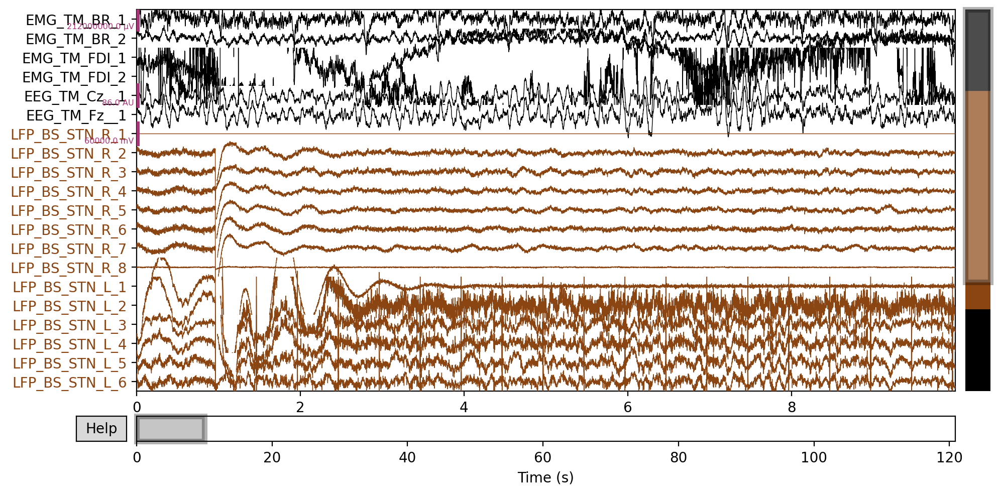

Channels marked as bad: none


In [395]:
raw.plot(scalings='auto')

In [396]:
raw.ch_names

['LFP_BS_STN_R_1',
 'LFP_BS_STN_R_2',
 'LFP_BS_STN_R_3',
 'LFP_BS_STN_R_4',
 'LFP_BS_STN_R_5',
 'LFP_BS_STN_R_6',
 'LFP_BS_STN_R_7',
 'LFP_BS_STN_R_8',
 'LFP_BS_STN_L_1',
 'LFP_BS_STN_L_2',
 'LFP_BS_STN_L_3',
 'LFP_BS_STN_L_4',
 'LFP_BS_STN_L_5',
 'LFP_BS_STN_L_6',
 'LFP_BS_STN_L_7',
 'LFP_BS_STN_L_8',
 'ECOG_AT_SM_L_1',
 'ECOG_AT_SM_L_2',
 'ECOG_AT_SM_L_3',
 'ECOG_AT_SM_L_4',
 'ECOG_AT_SM_L_5',
 'ECOG_AT_SM_L_6',
 'EEG_TM_Cz__1',
 'EEG_TM_Fz__1',
 'EMG_TM_BR_1',
 'EMG_TM_BR_2',
 'EMG_TM_FDI_1',
 'EMG_TM_FDI_2']

In [397]:
new_chs =  ['LFP_R_1_STN_BS',
            'LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_R_8_STN_BS',
            'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
           'ECOG_L_3_SMC_AT',
           'ECOG_L_4_SMC_AT',
           'ECOG_L_5_SMC_AT',
           'ECOG_L_6_SMC_AT',
             'EEG_Cz_AO',
             'EEG_Fz_AO',
             'EMG_1_BR_AO',
             'EMG_2_BR_AO',
             'EMG_1_FDI_AO',
             'EMG_2_FDI_AO']

In [398]:
picks = None
raw = rename_chs(raw, new_chs, picks=picks)

LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_AO :  misc
EEG_Fz_AO :  misc
EMG_1_BR_AO :  emg
EMG_2_BR_AO :  emg
EMG_1_FDI_AO :  emg
EMG_2_FDI_AO :  emg


In [399]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff03\ieeg\dummy.vhdr...
Setting channel info structure...
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_AO :  misc
EEG_Fz_AO :  misc
EMG_1_BR_AO :  emg
EMG_2_BR_AO :  emg
EMG_1_FDI_AO :  emg
EMG_2_FDI_AO :  emg
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff03\ieeg\dummy.vhdr...
Se

c:\users\richa\github\mne-bids\mne_bids\read.py:154: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '
c:\users\richa\github\mne-bids\mne_bids\path.py:1092: RuntimeWarning: Did not find any events.tsv associated with sub-002_ses-EphysMedOff03_task-Rest_acq-StimOn_run-02.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\**\sub-002_ses-EphysMedOff03*events.tsv"
  warn(msg)


# Next

In [400]:
i = 34

In [401]:
raws[i]

<RawBrainVision | sub-002_ses-EphysMedOff03_task-SelfpacedRotationR_acq-StimOff_run-01_ieeg.eeg, 29 x 675534 (491.1 s), ~37 kB, data not loaded>

In [402]:
raw = raws[i]
file = files[i]

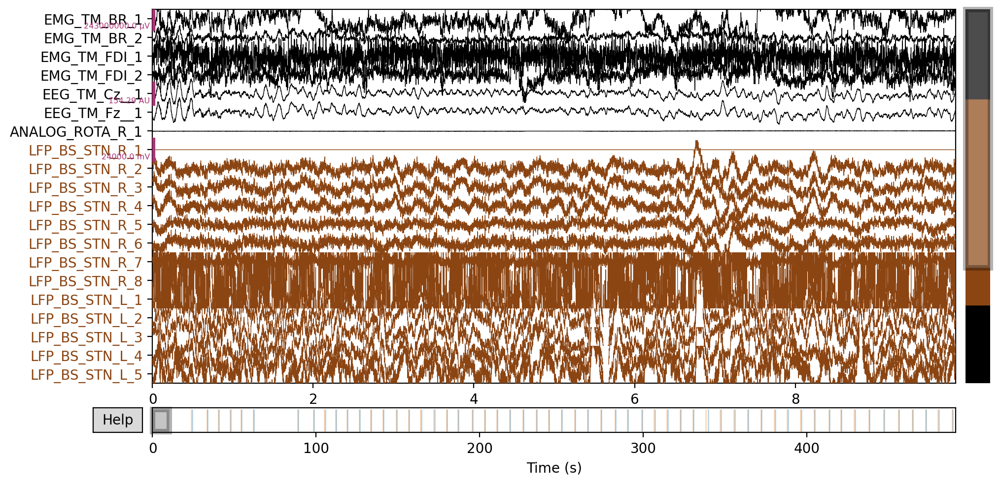

Channels marked as bad: none


In [403]:
raw.plot(scalings='auto')

In [404]:
raw.ch_names

['LFP_BS_STN_R_1',
 'LFP_BS_STN_R_2',
 'LFP_BS_STN_R_3',
 'LFP_BS_STN_R_4',
 'LFP_BS_STN_R_5',
 'LFP_BS_STN_R_6',
 'LFP_BS_STN_R_7',
 'LFP_BS_STN_R_8',
 'LFP_BS_STN_L_1',
 'LFP_BS_STN_L_2',
 'LFP_BS_STN_L_3',
 'LFP_BS_STN_L_4',
 'LFP_BS_STN_L_5',
 'LFP_BS_STN_L_6',
 'LFP_BS_STN_L_7',
 'LFP_BS_STN_L_8',
 'ECOG_AT_SM_L_1',
 'ECOG_AT_SM_L_2',
 'ECOG_AT_SM_L_3',
 'ECOG_AT_SM_L_4',
 'ECOG_AT_SM_L_5',
 'ECOG_AT_SM_L_6',
 'EEG_TM_Cz__1',
 'EEG_TM_Fz__1',
 'EMG_TM_BR_1',
 'EMG_TM_BR_2',
 'EMG_TM_FDI_1',
 'EMG_TM_FDI_2',
 'ANALOG_ROTA_R_1']

In [405]:
new_chs =  ['LFP_R_1_STN_BS',
            'LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_R_8_STN_BS',
            'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
           'ECOG_L_3_SMC_AT',
           'ECOG_L_4_SMC_AT',
           'ECOG_L_5_SMC_AT',
           'ECOG_L_6_SMC_AT',
             'EEG_Cz_AO',
             'EEG_Fz_AO',
             'EMG_1_BR_AO',
             'EMG_2_BR_AO',
             'EMG_1_FDI_AO',
             'EMG_2_FDI_AO',
           'ANALOG_R_ROTA_CH']

In [406]:
picks = None
raw = rename_chs(raw, new_chs, picks=picks)

LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_AO :  misc
EEG_Fz_AO :  misc
EMG_1_BR_AO :  emg
EMG_2_BR_AO :  emg
EMG_1_FDI_AO :  emg
EMG_2_FDI_AO :  emg
ANALOG_R_ROTA_C :  misc


In [413]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Used Annotations descriptions: ['Movement_End', 'Movement_Onset']
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff03\ieeg\dummy.vhdr...
Setting channel info structure...
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_AO :  misc
EEG_Fz_AO :  misc
EMG_1_BR_AO :  emg
EMG_2_BR_AO :  emg
EMG_1_FDI_AO :  emg
EMG_2_FDI_AO :  emg
ANALOG_R_ROTA_C :  misc
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizi

In [414]:
test_raw.annotations

<Annotations | 114 segments: Movement_End (57), Movement_Onset (57)>

# Next

In [15]:
i = 35

In [16]:
raws[i]

<RawBrainVision | sub-002_ses-EphysMedOff03_task-SelfpacedRotationR_acq-StimOn_run-01_ieeg.eeg, 29 x 578489 (420.6 s), ~37 kB, data not loaded>

In [17]:
raw = raws[i]
file = files[i]

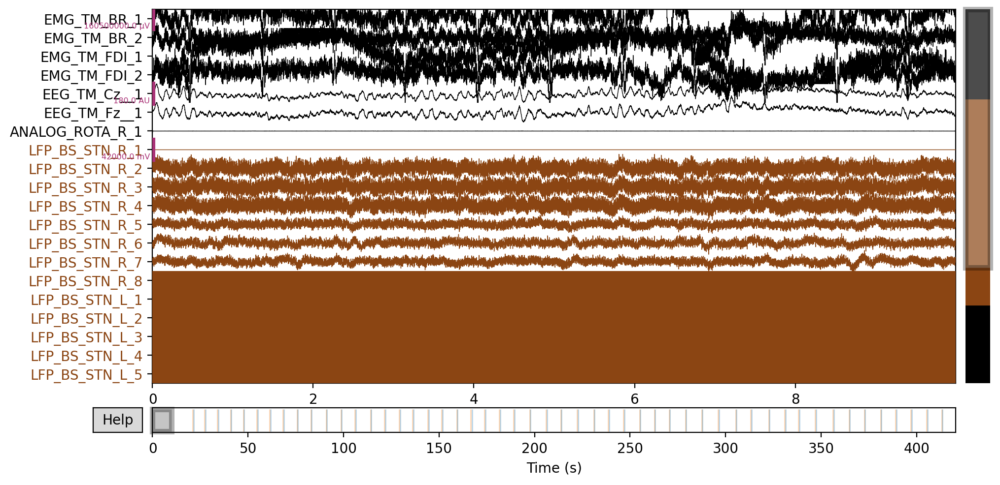

Channels marked as bad: none


In [420]:
raw.plot(scalings='auto')

In [18]:
raw.ch_names

['LFP_BS_STN_R_1',
 'LFP_BS_STN_R_2',
 'LFP_BS_STN_R_3',
 'LFP_BS_STN_R_4',
 'LFP_BS_STN_R_5',
 'LFP_BS_STN_R_6',
 'LFP_BS_STN_R_7',
 'LFP_BS_STN_R_8',
 'LFP_BS_STN_L_1',
 'LFP_BS_STN_L_2',
 'LFP_BS_STN_L_3',
 'LFP_BS_STN_L_4',
 'LFP_BS_STN_L_5',
 'LFP_BS_STN_L_6',
 'LFP_BS_STN_L_7',
 'LFP_BS_STN_L_8',
 'ECOG_AT_SM_L_1',
 'ECOG_AT_SM_L_2',
 'ECOG_AT_SM_L_3',
 'ECOG_AT_SM_L_4',
 'ECOG_AT_SM_L_5',
 'ECOG_AT_SM_L_6',
 'EEG_TM_Cz__1',
 'EEG_TM_Fz__1',
 'EMG_TM_BR_1',
 'EMG_TM_BR_2',
 'EMG_TM_FDI_1',
 'EMG_TM_FDI_2',
 'ANALOG_ROTA_R_1']

In [19]:
new_chs =  ['LFP_R_1_STN_BS',
            'LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_R_8_STN_BS',
            'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
           'ECOG_L_3_SMC_AT',
           'ECOG_L_4_SMC_AT',
           'ECOG_L_5_SMC_AT',
           'ECOG_L_6_SMC_AT',
             'EEG_Cz_AO',
             'EEG_Fz_AO',
             'EMG_1_BR_AO',
             'EMG_2_BR_AO',
             'EMG_1_FDI_AO',
             'EMG_2_FDI_AO',
            'ANALOG_R_ROTA_CH']

In [20]:
picks = None
raw = rename_chs(raw, new_chs, picks=picks)

LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_AO :  misc
EEG_Fz_AO :  misc
EMG_1_BR_AO :  emg
EMG_2_BR_AO :  emg
EMG_1_FDI_AO :  emg
EMG_2_FDI_AO :  emg
ANALOG_R_ROTA_C :  misc


In [21]:
reload(mne_bids)
raw = raw.set_channel_types({'EEG_Cz_AO': 'eeg', 'EEG_Fz_AO': 'eeg'})
test_raw = bids_rewrite_file(raw, file, out_path, True)

Used Annotations descriptions: ['Movement_End', 'Movement_Onset']
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff03\ieeg\dummy.vhdr...
Setting channel info structure...
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_AO :  eeg
EEG_Fz_AO :  eeg
EMG_1_BR_AO :  emg
EMG_2_BR_AO :  emg
EMG_1_FDI_AO :  emg
EMG_2_FDI_AO :  emg
ANALOG_R_ROTA_C :  misc
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin 

# Next

In [15]:
i = 35

In [16]:
raws[i]

<RawBrainVision | sub-002_ses-EphysMedOff03_task-SelfpacedRotationR_acq-StimOn_run-01_ieeg.eeg, 29 x 578489 (420.6 s), ~37 kB, data not loaded>

In [17]:
raw = raws[i]
file = files[i]

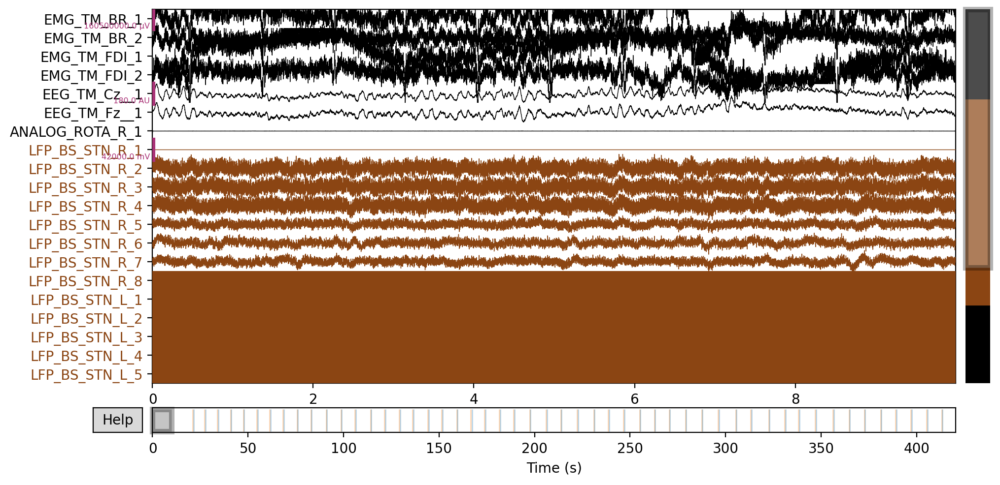

Channels marked as bad: none


In [420]:
raw.plot(scalings='auto')

In [18]:
raw.ch_names

['LFP_BS_STN_R_1',
 'LFP_BS_STN_R_2',
 'LFP_BS_STN_R_3',
 'LFP_BS_STN_R_4',
 'LFP_BS_STN_R_5',
 'LFP_BS_STN_R_6',
 'LFP_BS_STN_R_7',
 'LFP_BS_STN_R_8',
 'LFP_BS_STN_L_1',
 'LFP_BS_STN_L_2',
 'LFP_BS_STN_L_3',
 'LFP_BS_STN_L_4',
 'LFP_BS_STN_L_5',
 'LFP_BS_STN_L_6',
 'LFP_BS_STN_L_7',
 'LFP_BS_STN_L_8',
 'ECOG_AT_SM_L_1',
 'ECOG_AT_SM_L_2',
 'ECOG_AT_SM_L_3',
 'ECOG_AT_SM_L_4',
 'ECOG_AT_SM_L_5',
 'ECOG_AT_SM_L_6',
 'EEG_TM_Cz__1',
 'EEG_TM_Fz__1',
 'EMG_TM_BR_1',
 'EMG_TM_BR_2',
 'EMG_TM_FDI_1',
 'EMG_TM_FDI_2',
 'ANALOG_ROTA_R_1']

In [19]:
new_chs =  ['LFP_R_1_STN_BS',
            'LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_R_8_STN_BS',
            'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
           'ECOG_L_3_SMC_AT',
           'ECOG_L_4_SMC_AT',
           'ECOG_L_5_SMC_AT',
           'ECOG_L_6_SMC_AT',
             'EEG_Cz_AO',
             'EEG_Fz_AO',
             'EMG_1_BR_AO',
             'EMG_2_BR_AO',
             'EMG_1_FDI_AO',
             'EMG_2_FDI_AO',
            'ANALOG_R_ROTA_CH']

In [20]:
picks = None
raw = rename_chs(raw, new_chs, picks=picks)

LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_AO :  misc
EEG_Fz_AO :  misc
EMG_1_BR_AO :  emg
EMG_2_BR_AO :  emg
EMG_1_FDI_AO :  emg
EMG_2_FDI_AO :  emg
ANALOG_R_ROTA_C :  misc


In [21]:
reload(mne_bids)
raw = raw.set_channel_types({'EEG_Cz_AO': 'eeg', 'EEG_Fz_AO': 'eeg'})
test_raw = bids_rewrite_file(raw, file, out_path, True)

Used Annotations descriptions: ['Movement_End', 'Movement_Onset']
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-002\ses-EphysMedOff03\ieeg\dummy.vhdr...
Setting channel info structure...
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_AO :  eeg
EEG_Fz_AO :  eeg
EMG_1_BR_AO :  emg
EMG_2_BR_AO :  emg
EMG_1_FDI_AO :  emg
EMG_2_FDI_AO :  emg
ANALOG_R_ROTA_C :  misc
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin 

In [27]:
%matplotlib qt

# Next

In [23]:
i = 36

In [24]:
raws[i]

<RawBrainVision | sub-003_ses-EphysMedOff01_task-BlockRotationR_acq-StimOff_run-01_ieeg.eeg, 25 x 554415 (403.2 s), ~33 kB, data not loaded>

In [25]:
raw = raws[i]
file = files[i]

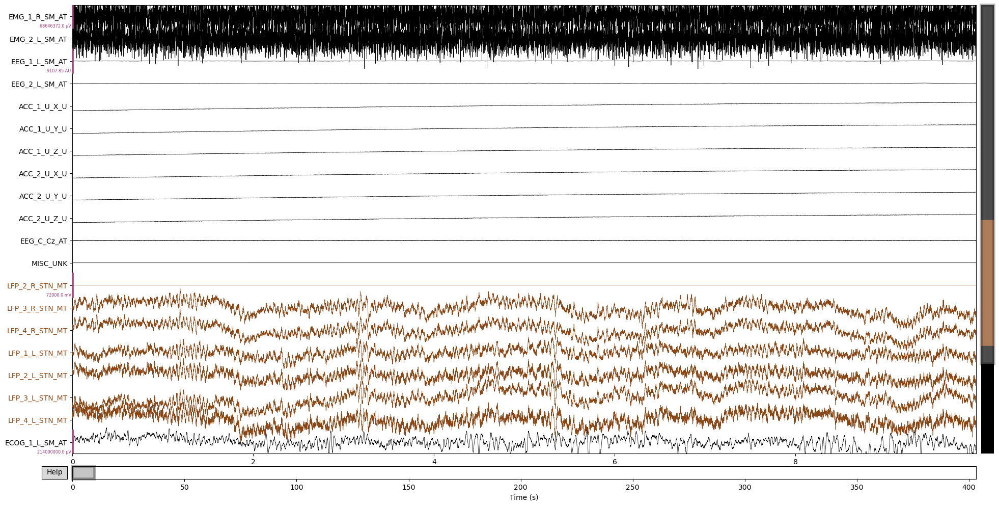

Channels marked as bad: ['ACC_2_U_Z_U', 'ACC_2_U_Y_U', 'ACC_1_U_Z_U', 'ACC_2_U_X_U', 'ACC_1_U_Y_U', 'ACC_1_U_X_U', 'EMG_2_L_SM_AT', 'EMG_1_R_SM_AT', 'EEG_1_L_SM_AT']


In [30]:
raw.plot(scalings='auto')

In [29]:
raw.ch_names

['LFP_2_R_STN_MT',
 'LFP_3_R_STN_MT',
 'LFP_4_R_STN_MT',
 'LFP_1_L_STN_MT',
 'LFP_2_L_STN_MT',
 'LFP_3_L_STN_MT',
 'LFP_4_L_STN_MT',
 'EEG_1_L_SM_AT',
 'EEG_2_L_SM_AT',
 'ECOG_1_L_SM_AT',
 'ECOG_2_L_SM_AT',
 'ECOG_3_L_SM_AT',
 'ECOG_4_L_SM_AT',
 'ECOG_5_L_SM_AT',
 'ECOG_6_L_SM_AT',
 'ACC_1_U_X_U',
 'ACC_1_U_Y_U',
 'ACC_1_U_Z_U',
 'ACC_2_U_X_U',
 'ACC_2_U_Y_U',
 'ACC_2_U_Z_U',
 'EMG_1_R_SM_AT',
 'EMG_2_L_SM_AT',
 'EEG_C_Cz_AT',
 'MISC_UNK']

In [32]:
new_chs =  ['LFP_R_2_STN_MT',
             'LFP_R_3_STN_MT',
             'LFP_R_4_STN_MT',
             'LFP_L_1_STN_MT',
             'LFP_L_2_STN_MT',
             'LFP_L_3_STN_MT',
             'LFP_L_4_STN_MT',
             'EMG_L_1_AO',
             'EMG_L_2_AO',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
           'ECOG_L_3_SMC_AT',
           'ECOG_L_4_SMC_AT',
           'ECOG_L_5_SMC_AT',
           'ECOG_L_6_SMC_AT',
            'ACC_R_X_D2_AO',
            'ACC_R_Y_D2_AO',
            'ACC_R_Z_D2_AO',
             'ACC_L_X_D2_AO',
            'ACC_L_Y_D2_AO',
            'ACC_L_Z_D2_AO',
             'EMG_R_1_AO',
             'EMG_R_2_AO',
             'EEG_Cz_AO',
             'ANALOG_R_ROTA_CH']

In [33]:
picks = None
raw = rename_chs(raw, new_chs, picks=picks)

LFP_R_2_STN_MT :  seeg
LFP_R_3_STN_MT :  seeg
LFP_R_4_STN_MT :  seeg
LFP_L_1_STN_MT :  seeg
LFP_L_2_STN_MT :  seeg
LFP_L_3_STN_MT :  seeg
LFP_L_4_STN_MT :  seeg
EMG_L_1_AO :  emg
EMG_L_2_AO :  emg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
ACC_R_X_D2_AO :  misc
ACC_R_Y_D2_AO :  misc
ACC_R_Z_D2_AO :  misc
ACC_L_X_D2_AO :  misc
ACC_L_Y_D2_AO :  misc
ACC_L_Z_D2_AO :  misc
EMG_R_1_AO :  emg
EMG_R_2_AO :  emg
EEG_Cz_AO :  eeg
ANALOG_R_ROTA_C :  misc


In [38]:
raw = mne.add_reference_channels(raw.load_data(), 'LFP_R_1_STN_MT')
raw = raw.set_channel_types({'LFP_R_1_STN_MT': 'seeg'})
test_raw = bids_rewrite_file(raw, file, out_path, True)

Reading 0 ... 554414  =      0.000 ...   403.210 secs...
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-003\ses-EphysMedOff01\ieeg\dummy.vhdr...
Setting channel info structure...
LFP_R_2_STN_MT :  seeg
LFP_R_3_STN_MT :  seeg
LFP_R_4_STN_MT :  seeg
LFP_L_1_STN_MT :  seeg
LFP_L_2_STN_MT :  seeg
LFP_L_3_STN_MT :  seeg
LFP_L_4_STN_MT :  seeg
EMG_L_1_AO :  emg
EMG_L_2_AO :  emg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
ACC_R_X_D2_AO :  misc
ACC_R_Y_D2_AO :  misc
ACC_R_Z_D2_AO :  misc
ACC_L_X_D2_AO :  misc
ACC_L_Y_D2_AO :  misc
ACC_L_Z_D2_AO :  misc
EMG_R_1_AO :  emg
EMG_R_2_AO :  emg
EEG_Cz_AO :  eeg
ANALOG_R_ROTA_C :  misc
LFP_R_1_STN_MT :  seeg
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-003\ses-EphysMedOff01\ieeg\dummy.vhdr..

c:\users\richa\github\mne-bids\mne_bids\read.py:156: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '


Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-003\ses-EphysMedOff01\ieeg\sub-003_ses-EphysMedOff01_task-BlockRotationR_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-003\ses-EphysMedOff01\ieeg\sub-003_ses-EphysMedOff01_task-BlockRotationR_acq-StimOff_run-01_channels.tsv.


c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-003_ses-EphysMedOff01_task-BlockRotationR_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-003\**\sub-003_ses-EphysMedOff01*events.tsv"
  warn(msg)


# Next

In [23]:
i = 37

In [24]:
raws[i]

<RawBrainVision | sub-003_ses-EphysMedOff01_task-Rest_acq-StimOff_run-01_ieeg.eeg, 27 x 2536498 (619.3 s), ~35 kB, data not loaded>

In [25]:
raw = raws[i]
file = files[i]

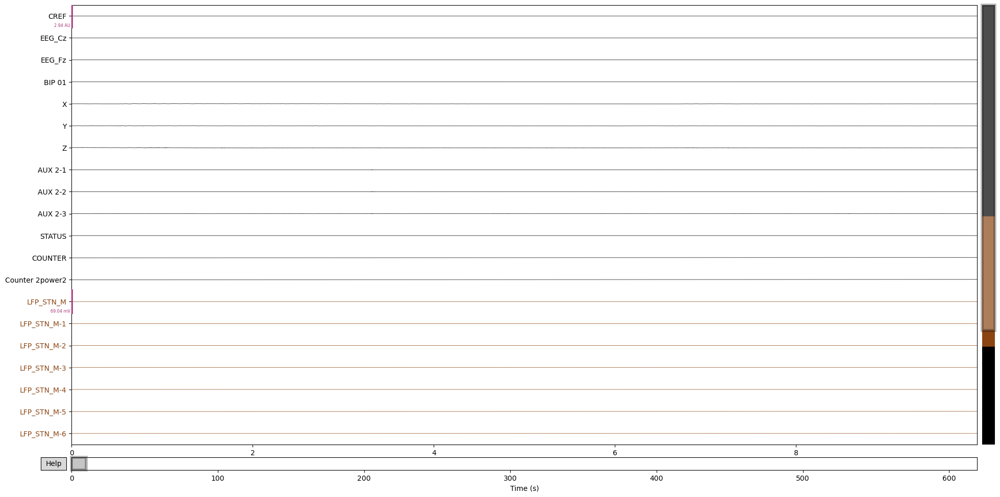

Channels marked as bad: none


In [26]:
raw.plot(scalings='auto')

In [43]:
raw.ch_names

['CREF',
 'LFP_STN_M',
 'LFP_STN_M-1',
 'LFP_STN_M-2',
 'LFP_STN_M-3',
 'LFP_STN_M-4',
 'LFP_STN_M-5',
 'LFP_STN_M-6',
 'LFP_STN_M-7',
 'EEG_Cz',
 'EEG_Fz',
 'ECOG_SM_A',
 'ECOG_SM_A-1',
 'ECOG_SM_A-2',
 'ECOG_SM_A-3',
 'ECOG_SM_A-4',
 'ECOG_SM_A-5',
 'BIP 01',
 'X',
 'Y',
 'Z',
 'AUX 2-1',
 'AUX 2-2',
 'AUX 2-3',
 'STATUS',
 'COUNTER',
 'Counter 2power2']

In [44]:
new_chs =  ['CREF',
            'LFP_R_1_STN_MT',
            'LFP_R_2_STN_MT',
             'LFP_R_3_STN_MT',
             'LFP_R_4_STN_MT',
             'LFP_L_1_STN_MT',
             'LFP_L_2_STN_MT',
             'LFP_L_3_STN_MT',
             'LFP_L_4_STN_MT',
            'EEG_Cz_TM',
             'EEG_Fz_TM',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
           'ECOG_L_3_SMC_AT',
           'ECOG_L_4_SMC_AT',
           'ECOG_L_5_SMC_AT',
           'ECOG_L_6_SMC_AT',
             'EMG_R_BR_TM',
            'ACC_R_X_D2_TM',
            'ACC_R_Y_D2_TM',
            'ACC_R_Z_D2_TM',
             'AUX 2-1',
             'AUX 2-2',
             'AUX 2-3',
             'STATUS',
             'COUNTER',
             'Counter 2power2']

In [45]:
picks = ['LFP_R_1_STN_MT',
        'LFP_R_2_STN_MT',
         'LFP_R_3_STN_MT',
         'LFP_R_4_STN_MT',
         'LFP_L_1_STN_MT',
         'LFP_L_2_STN_MT',
         'LFP_L_3_STN_MT',
         'LFP_L_4_STN_MT',
        'EEG_Cz_TM',
         'EEG_Fz_TM',
        'ECOG_L_1_SMC_AT',
        'ECOG_L_2_SMC_AT',
       'ECOG_L_3_SMC_AT',
       'ECOG_L_4_SMC_AT',
       'ECOG_L_5_SMC_AT',
       'ECOG_L_6_SMC_AT',
         'EMG_R_BR_TM',
        'ACC_R_X_D2_TM',
        'ACC_R_Y_D2_TM',
        'ACC_R_Z_D2_TM']
raw = rename_chs(raw, new_chs, picks=picks)

LFP_R_1_STN_MT :  seeg
LFP_R_2_STN_MT :  seeg
LFP_R_3_STN_MT :  seeg
LFP_R_4_STN_MT :  seeg
LFP_L_1_STN_MT :  seeg
LFP_L_2_STN_MT :  seeg
LFP_L_3_STN_MT :  seeg
LFP_L_4_STN_MT :  seeg
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EMG_R_BR_TM :  emg
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc


In [46]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-003\ses-EphysMedOff01\ieeg\dummy.vhdr...
Setting channel info structure...
LFP_R_1_STN_MT :  seeg
LFP_R_2_STN_MT :  seeg
LFP_R_3_STN_MT :  seeg
LFP_R_4_STN_MT :  seeg
LFP_L_1_STN_MT :  seeg
LFP_L_2_STN_MT :  seeg
LFP_L_3_STN_MT :  seeg
LFP_L_4_STN_MT :  seeg
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EMG_R_BR_TM :  emg
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-003\ses-EphysMedOff01\ieeg\dummy.vhdr...
Setting channel info structure...
Reading 0 ... 2536497  =      0.000 ...   619.262 secs...


c:\users\richa\github\mne-bids\mne_bids\read.py:156: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '


Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-003\ses-EphysMedOff01\ieeg\sub-003_ses-EphysMedOff01_task-Rest_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-003\ses-EphysMedOff01\ieeg\sub-003_ses-EphysMedOff01_task-Rest_acq-StimOff_run-01_channels.tsv.


c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-003_ses-EphysMedOff01_task-Rest_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-003\**\sub-003_ses-EphysMedOff01*events.tsv"
  warn(msg)


# Next

In [47]:
i = 38

In [48]:
raws[i]

<RawBrainVision | sub-003_ses-EphysMedOff01_task-Rest_acq-StimOff_run-02_ieeg.eeg, 27 x 494827 (120.8 s), ~35 kB, data not loaded>

In [49]:
raw = raws[i]
file = files[i]

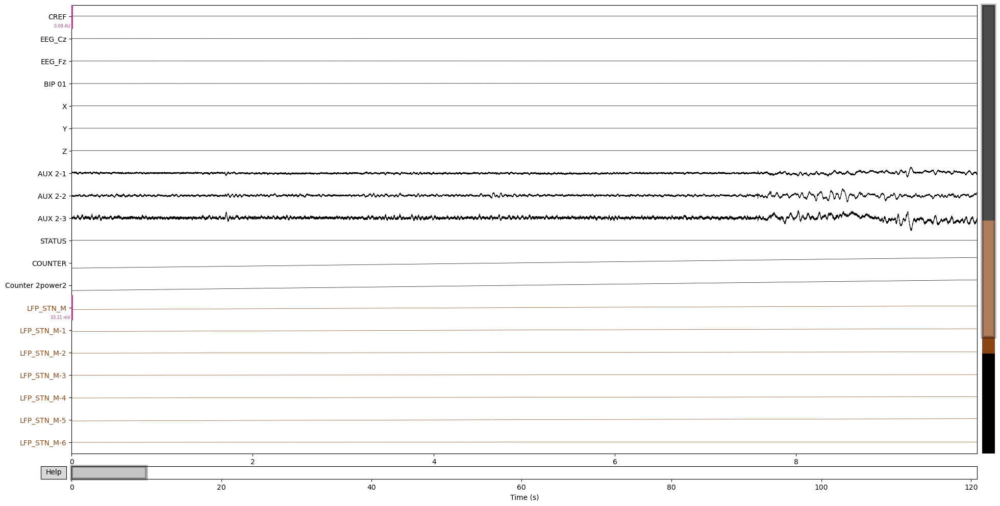

Channels marked as bad: none


In [50]:
raw.plot(scalings='auto')

In [51]:
raw.ch_names

['CREF',
 'LFP_STN_M',
 'LFP_STN_M-1',
 'LFP_STN_M-2',
 'LFP_STN_M-3',
 'LFP_STN_M-4',
 'LFP_STN_M-5',
 'LFP_STN_M-6',
 'LFP_STN_M-7',
 'EEG_Cz',
 'EEG_Fz',
 'ECOG_SM_A',
 'ECOG_SM_A-1',
 'ECOG_SM_A-2',
 'ECOG_SM_A-3',
 'ECOG_SM_A-4',
 'ECOG_SM_A-5',
 'BIP 01',
 'X',
 'Y',
 'Z',
 'AUX 2-1',
 'AUX 2-2',
 'AUX 2-3',
 'STATUS',
 'COUNTER',
 'Counter 2power2']

In [52]:
new_chs =  ['REF_EARLOBE',
            'LFP_R_1_STN_MT',
            'LFP_R_2_STN_MT',
             'LFP_R_3_STN_MT',
             'LFP_R_4_STN_MT',
             'LFP_L_1_STN_MT',
             'LFP_L_2_STN_MT',
             'LFP_L_3_STN_MT',
             'LFP_L_4_STN_MT',
            'EEG_Cz_TM',
             'EEG_Fz_TM',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
           'ECOG_L_3_SMC_AT',
           'ECOG_L_4_SMC_AT',
           'ECOG_L_5_SMC_AT',
           'ECOG_L_6_SMC_AT',
             'EMG_R_BR_TM',
            'ACC_R_X_D2_TM',
            'ACC_R_Y_D2_TM',
            'ACC_R_Z_D2_TM',
             'AUX 2-1',
             'AUX 2-2',
             'AUX 2-3',
             'STATUS',
             'COUNTER',
             'Counter 2power2']

In [53]:
picks = ['REF_EARLOBE',
         'LFP_R_1_STN_MT',
        'LFP_R_2_STN_MT',
         'LFP_R_3_STN_MT',
         'LFP_R_4_STN_MT',
         'LFP_L_1_STN_MT',
         'LFP_L_2_STN_MT',
         'LFP_L_3_STN_MT',
         'LFP_L_4_STN_MT',
        'EEG_Cz_TM',
         'EEG_Fz_TM',
        'ECOG_L_1_SMC_AT',
        'ECOG_L_2_SMC_AT',
       'ECOG_L_3_SMC_AT',
       'ECOG_L_4_SMC_AT',
       'ECOG_L_5_SMC_AT',
       'ECOG_L_6_SMC_AT',
         'EMG_R_BR_TM',
        'ACC_R_X_D2_TM',
        'ACC_R_Y_D2_TM',
        'ACC_R_Z_D2_TM']
raw = rename_chs(raw, new_chs, picks=picks)

REF_EARLOBE :  misc
LFP_R_1_STN_MT :  seeg
LFP_R_2_STN_MT :  seeg
LFP_R_3_STN_MT :  seeg
LFP_R_4_STN_MT :  seeg
LFP_L_1_STN_MT :  seeg
LFP_L_2_STN_MT :  seeg
LFP_L_3_STN_MT :  seeg
LFP_L_4_STN_MT :  seeg
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EMG_R_BR_TM :  emg
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc


In [54]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-003\ses-EphysMedOff01\ieeg\dummy.vhdr...
Setting channel info structure...
REF_EARLOBE :  misc
LFP_R_1_STN_MT :  seeg
LFP_R_2_STN_MT :  seeg
LFP_R_3_STN_MT :  seeg
LFP_R_4_STN_MT :  seeg
LFP_L_1_STN_MT :  seeg
LFP_L_2_STN_MT :  seeg
LFP_L_3_STN_MT :  seeg
LFP_L_4_STN_MT :  seeg
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EMG_R_BR_TM :  emg
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-003\ses-EphysMedOff01\ieeg\dummy.vhdr...
Setting channel info structure...
Reading 0 ... 494826  =      0.000 ...   120.807 secs...
Extracting parameters from C:\Users\richa\OneDrive - Charité - Univers

c:\users\richa\github\mne-bids\mne_bids\read.py:156: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-003_ses-EphysMedOff01_task-Rest_acq-StimOff_run-02.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-003\**\sub-003_ses-EphysMedOff01*events.tsv"
  warn(msg)


# Next

In [63]:
i = 39

In [64]:
raws[i]

<RawBrainVision | sub-003_ses-EphysMedOff01_task-Rest_acq-StimOff_run-03_ieeg.eeg, 27 x 741561 (181.0 s), ~35 kB, data not loaded>

In [65]:
raw = raws[i]
file = files[i]

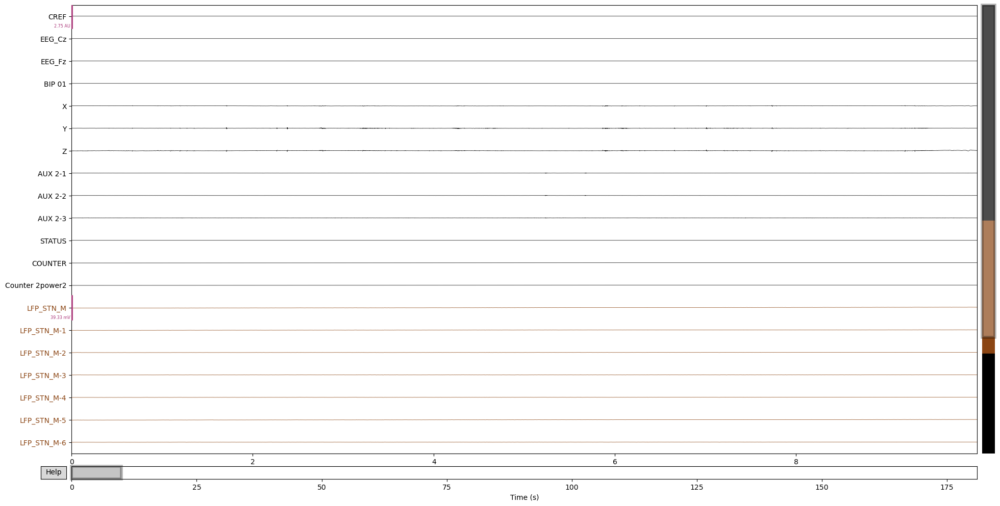

Channels marked as bad: none


In [66]:
raw.plot(scalings='auto')

In [67]:
raw.ch_names

['CREF',
 'LFP_STN_M',
 'LFP_STN_M-1',
 'LFP_STN_M-2',
 'LFP_STN_M-3',
 'LFP_STN_M-4',
 'LFP_STN_M-5',
 'LFP_STN_M-6',
 'LFP_STN_M-7',
 'EEG_Cz',
 'EEG_Fz',
 'ECOG_SM_A',
 'ECOG_SM_A-1',
 'ECOG_SM_A-2',
 'ECOG_SM_A-3',
 'ECOG_SM_A-4',
 'ECOG_SM_A-5',
 'BIP 01',
 'X',
 'Y',
 'Z',
 'AUX 2-1',
 'AUX 2-2',
 'AUX 2-3',
 'STATUS',
 'COUNTER',
 'Counter 2power2']

In [69]:
new_chs =  ['REF_MASTOID',
            'LFP_R_1_STN_MT',
            'LFP_R_2_STN_MT',
             'LFP_R_3_STN_MT',
             'LFP_R_4_STN_MT',
             'LFP_L_1_STN_MT',
             'LFP_L_2_STN_MT',
             'LFP_L_3_STN_MT',
             'LFP_L_4_STN_MT',
            'EEG_Cz_TM',
             'EEG_Fz_TM',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
           'ECOG_L_3_SMC_AT',
           'ECOG_L_4_SMC_AT',
           'ECOG_L_5_SMC_AT',
           'ECOG_L_6_SMC_AT',
             'EMG_R_BR_TM',
            'ACC_R_X_D2_TM',
            'ACC_R_Y_D2_TM',
            'ACC_R_Z_D2_TM',
             'AUX 2-1',
             'AUX 2-2',
             'AUX 2-3',
             'STATUS',
             'COUNTER',
             'Counter 2power2']

In [70]:
picks = ['REF_MASTOID',
         'LFP_R_1_STN_MT',
        'LFP_R_2_STN_MT',
         'LFP_R_3_STN_MT',
         'LFP_R_4_STN_MT',
         'LFP_L_1_STN_MT',
         'LFP_L_2_STN_MT',
         'LFP_L_3_STN_MT',
         'LFP_L_4_STN_MT',
        'EEG_Cz_TM',
         'EEG_Fz_TM',
        'ECOG_L_1_SMC_AT',
        'ECOG_L_2_SMC_AT',
       'ECOG_L_3_SMC_AT',
       'ECOG_L_4_SMC_AT',
       'ECOG_L_5_SMC_AT',
       'ECOG_L_6_SMC_AT',
         'EMG_R_BR_TM',
        'ACC_R_X_D2_TM',
        'ACC_R_Y_D2_TM',
        'ACC_R_Z_D2_TM']
raw = rename_chs(raw, new_chs, picks=picks)

REF_MASTOID :  misc
LFP_R_1_STN_MT :  seeg
LFP_R_2_STN_MT :  seeg
LFP_R_3_STN_MT :  seeg
LFP_R_4_STN_MT :  seeg
LFP_L_1_STN_MT :  seeg
LFP_L_2_STN_MT :  seeg
LFP_L_3_STN_MT :  seeg
LFP_L_4_STN_MT :  seeg
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EMG_R_BR_TM :  emg
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc


In [71]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-003\ses-EphysMedOff01\ieeg\dummy.vhdr...
Setting channel info structure...
REF_MASTOID :  misc
LFP_R_1_STN_MT :  seeg
LFP_R_2_STN_MT :  seeg
LFP_R_3_STN_MT :  seeg
LFP_R_4_STN_MT :  seeg
LFP_L_1_STN_MT :  seeg
LFP_L_2_STN_MT :  seeg
LFP_L_3_STN_MT :  seeg
LFP_L_4_STN_MT :  seeg
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EMG_R_BR_TM :  emg
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-003\ses-EphysMedOff01\ieeg\dummy.vhdr...
Setting channel info structure...
Reading 0 ... 741560  =      0.000 ...   181.045 secs...
Extracting parameters from C:\Users\richa\OneDrive - Charité - Univers

c:\users\richa\github\mne-bids\mne_bids\read.py:156: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '


Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-003\ses-EphysMedOff01\ieeg\sub-003_ses-EphysMedOff01_task-Rest_acq-StimOff_run-03_channels.tsv.


c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-003_ses-EphysMedOff01_task-Rest_acq-StimOff_run-03.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-003\**\sub-003_ses-EphysMedOff01*events.tsv"
  warn(msg)


# Next

In [72]:
i = 40

In [73]:
raws[i]

<RawBrainVision | sub-003_ses-EphysMedOff01_task-SelfpacedRotationR_acq-StimOff_run-01_ieeg.eeg, 25 x 589105 (428.4 s), ~33 kB, data not loaded>

In [74]:
raw = raws[i]
file = files[i]

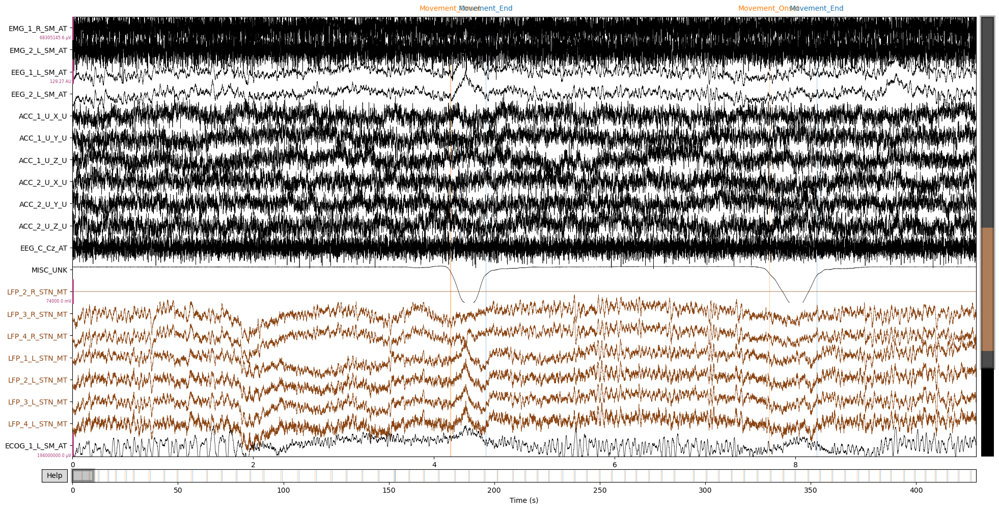

In [78]:
raw.plot(scalings='auto')

In [76]:
raw.ch_names

['LFP_2_R_STN_MT',
 'LFP_3_R_STN_MT',
 'LFP_4_R_STN_MT',
 'LFP_1_L_STN_MT',
 'LFP_2_L_STN_MT',
 'LFP_3_L_STN_MT',
 'LFP_4_L_STN_MT',
 'EEG_1_L_SM_AT',
 'EEG_2_L_SM_AT',
 'ECOG_1_L_SM_AT',
 'ECOG_2_L_SM_AT',
 'ECOG_3_L_SM_AT',
 'ECOG_4_L_SM_AT',
 'ECOG_5_L_SM_AT',
 'ECOG_6_L_SM_AT',
 'ACC_1_U_X_U',
 'ACC_1_U_Y_U',
 'ACC_1_U_Z_U',
 'ACC_2_U_X_U',
 'ACC_2_U_Y_U',
 'ACC_2_U_Z_U',
 'EMG_1_R_SM_AT',
 'EMG_2_L_SM_AT',
 'EEG_C_Cz_AT',
 'MISC_UNK']

In [79]:
new_chs =  ['LFP_R_2_STN_MT',
             'LFP_R_3_STN_MT',
             'LFP_R_4_STN_MT',
             'LFP_L_1_STN_MT',
             'LFP_L_2_STN_MT',
             'LFP_L_3_STN_MT',
             'LFP_L_4_STN_MT',
            'EEG_Cz_AO',
             'EEG_Fz_AO',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
           'ECOG_L_3_SMC_AT',
           'ECOG_L_4_SMC_AT',
           'ECOG_L_5_SMC_AT',
           'ECOG_L_6_SMC_AT',
            'ACC_R_X_D2_TM',
            'ACC_R_Y_D2_TM',
            'ACC_R_Z_D2_TM',
            'ACC_L_X_D2_TM',
            'ACC_L_Y_D2_TM',
            'ACC_L_Z_D2_TM',
             'EMG_R_BR_AO',
             'EMG_L_BR_AO',
            'EEG_Cz_Fz_AO',
             'ANALOG_R_ROTA_CH']

In [80]:
picks = None
raw = rename_chs(raw, new_chs, picks=picks)

LFP_R_2_STN_MT :  seeg
LFP_R_3_STN_MT :  seeg
LFP_R_4_STN_MT :  seeg
LFP_L_1_STN_MT :  seeg
LFP_L_2_STN_MT :  seeg
LFP_L_3_STN_MT :  seeg
LFP_L_4_STN_MT :  seeg
EEG_Cz_AO :  eeg
EEG_Fz_AO :  eeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc
ACC_L_X_D2_TM :  misc
ACC_L_Y_D2_TM :  misc
ACC_L_Z_D2_TM :  misc
EMG_R_BR_AO :  emg
EMG_L_BR_AO :  emg
EEG_Cz_Fz_AO :  eeg
ANALOG_R_ROTA_C :  misc


In [82]:
raw = mne.add_reference_channels(raw.load_data(), 'LFP_R_1_STN_MT')
raw = raw.set_channel_types({'LFP_R_1_STN_MT': 'seeg'})
test_raw = bids_rewrite_file(raw, file, out_path, True)

Reading 0 ... 589104  =      0.000 ...   428.439 secs...
Used Annotations descriptions: ['Movement_End', 'Movement_Onset']
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-003\ses-EphysMedOff01\ieeg\dummy.vhdr...
Setting channel info structure...
LFP_R_2_STN_MT :  seeg
LFP_R_3_STN_MT :  seeg
LFP_R_4_STN_MT :  seeg
LFP_L_1_STN_MT :  seeg
LFP_L_2_STN_MT :  seeg
LFP_L_3_STN_MT :  seeg
LFP_L_4_STN_MT :  seeg
EEG_Cz_AO :  eeg
EEG_Fz_AO :  eeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc
ACC_L_X_D2_TM :  misc
ACC_L_Y_D2_TM :  misc
ACC_L_Z_D2_TM :  misc
EMG_R_BR_AO :  emg
EMG_L_BR_AO :  emg
EEG_Cz_Fz_AO :  eeg
ANALOG_R_ROTA_C :  misc
LFP_R_1_STN_MT :  seeg
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BID

# Next

In [27]:
i = 41

In [28]:
raws[i]

<RawBrainVision | sub-003_ses-EphysMedOff01_task-UPDRSIII_acq-StimOff_run-01_ieeg.eeg, 27 x 107210 (26.2 s), ~35 kB, data not loaded>

In [29]:
raw = raws[i]
file = files[i]

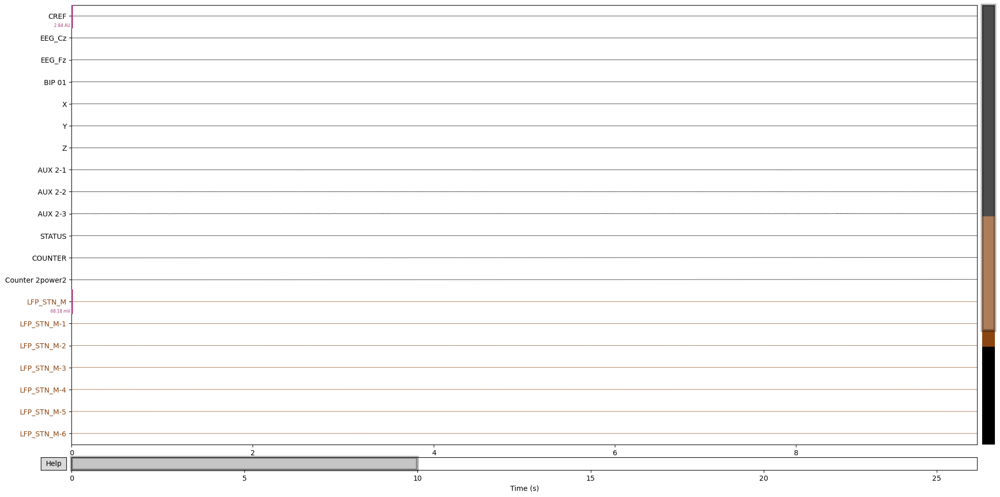

Channels marked as bad: none


In [30]:
raw.plot(scalings='auto')

In [31]:
raw.ch_names

['CREF',
 'LFP_STN_M',
 'LFP_STN_M-1',
 'LFP_STN_M-2',
 'LFP_STN_M-3',
 'LFP_STN_M-4',
 'LFP_STN_M-5',
 'LFP_STN_M-6',
 'LFP_STN_M-7',
 'EEG_Cz',
 'EEG_Fz',
 'ECOG_SM_A',
 'ECOG_SM_A-1',
 'ECOG_SM_A-2',
 'ECOG_SM_A-3',
 'ECOG_SM_A-4',
 'ECOG_SM_A-5',
 'BIP 01',
 'X',
 'Y',
 'Z',
 'AUX 2-1',
 'AUX 2-2',
 'AUX 2-3',
 'STATUS',
 'COUNTER',
 'Counter 2power2']

In [18]:
data = raw.get_data()[21:24]

In [21]:
from matplotlib import pyplot as plt

plt.plot(data[0,0:100000])

In [32]:
new_chs =  ['CREF',
            'LFP_R_1_STN_MT',
            'LFP_R_2_STN_MT',
             'LFP_R_3_STN_MT',
             'LFP_R_4_STN_MT',
             'LFP_L_1_STN_MT',
             'LFP_L_2_STN_MT',
             'LFP_L_3_STN_MT',
             'LFP_L_4_STN_MT',
            'EEG_Cz_TM',
             'EEG_Fz_TM',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
           'ECOG_L_3_SMC_AT',
           'ECOG_L_4_SMC_AT',
           'ECOG_L_5_SMC_AT',
           'ECOG_L_6_SMC_AT',
             'EMG_R_BR_TM',
            'X',
            'Y',
            'Z',
            'ACC_R_X_D2_TM',
            'ACC_R_Y_D2_TM',
            'ACC_R_Z_D2_TM',
             'STATUS',
             'COUNTER',
             'Counter 2power2']

In [33]:
picks =  ['LFP_R_1_STN_MT',
            'LFP_R_2_STN_MT',
             'LFP_R_3_STN_MT',
             'LFP_R_4_STN_MT',
             'LFP_L_1_STN_MT',
             'LFP_L_2_STN_MT',
             'LFP_L_3_STN_MT',
             'LFP_L_4_STN_MT',
            'EEG_Cz_TM',
             'EEG_Fz_TM',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
           'ECOG_L_3_SMC_AT',
           'ECOG_L_4_SMC_AT',
           'ECOG_L_5_SMC_AT',
           'ECOG_L_6_SMC_AT',
             'EMG_R_BR_TM',
            'ACC_R_X_D2_TM',
            'ACC_R_Y_D2_TM',
            'ACC_R_Z_D2_TM']
raw = rename_chs(raw, new_chs, picks=picks)

LFP_R_1_STN_MT :  seeg
LFP_R_2_STN_MT :  seeg
LFP_R_3_STN_MT :  seeg
LFP_R_4_STN_MT :  seeg
LFP_L_1_STN_MT :  seeg
LFP_L_2_STN_MT :  seeg
LFP_L_3_STN_MT :  seeg
LFP_L_4_STN_MT :  seeg
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EMG_R_BR_TM :  emg
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc


In [34]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-003\ses-EphysMedOff01\ieeg\dummy.vhdr...
Setting channel info structure...
LFP_R_1_STN_MT :  seeg
LFP_R_2_STN_MT :  seeg
LFP_R_3_STN_MT :  seeg
LFP_R_4_STN_MT :  seeg
LFP_L_1_STN_MT :  seeg
LFP_L_2_STN_MT :  seeg
LFP_L_3_STN_MT :  seeg
LFP_L_4_STN_MT :  seeg
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EMG_R_BR_TM :  emg
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-003\ses-EphysMedOff01\ieeg\dummy.vhdr...
Setting channel info structure...
Reading 0 ... 107209  =      0.000 ...    26.174 secs...
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\

c:\users\richa\github\mne-bids\mne_bids\read.py:156: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-003_ses-EphysMedOff01_task-UPDRSIII_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-003\**\sub-003_ses-EphysMedOff01*events.tsv"
  warn(msg)


# Next

In [35]:
i = 42

In [36]:
raws[i]

<RawBrainVision | sub-003_ses-EphysMedOff01_task-UPDRSIII_acq-StimOff_run-02_ieeg.eeg, 27 x 1553186 (379.2 s), ~35 kB, data not loaded>

In [37]:
raw = raws[i]
file = files[i]

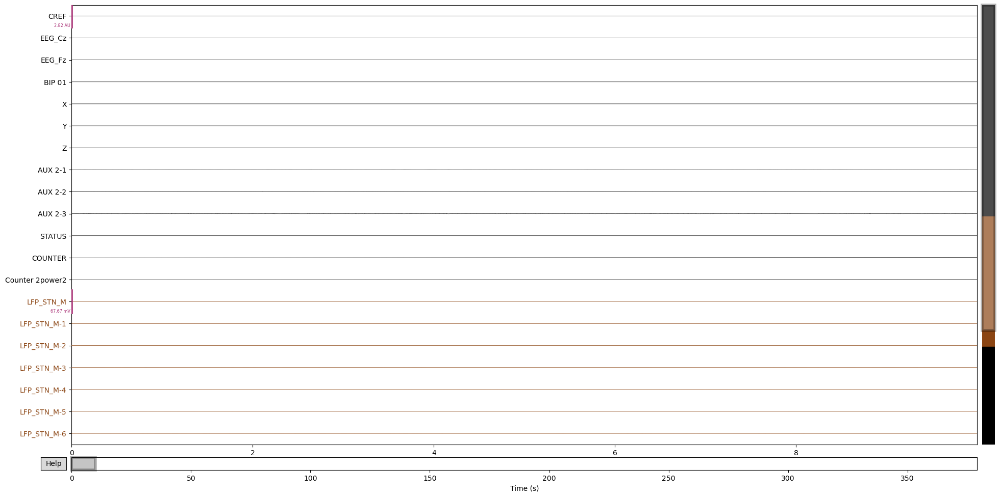

Channels marked as bad: none


In [38]:
raw.plot(scalings='auto')

In [39]:
raw.ch_names

['CREF',
 'LFP_STN_M',
 'LFP_STN_M-1',
 'LFP_STN_M-2',
 'LFP_STN_M-3',
 'LFP_STN_M-4',
 'LFP_STN_M-5',
 'LFP_STN_M-6',
 'LFP_STN_M-7',
 'EEG_Cz',
 'EEG_Fz',
 'ECOG_SM_A',
 'ECOG_SM_A-1',
 'ECOG_SM_A-2',
 'ECOG_SM_A-3',
 'ECOG_SM_A-4',
 'ECOG_SM_A-5',
 'BIP 01',
 'X',
 'Y',
 'Z',
 'AUX 2-1',
 'AUX 2-2',
 'AUX 2-3',
 'STATUS',
 'COUNTER',
 'Counter 2power2']

In [40]:
new_chs =  ['CREF',
            'LFP_R_1_STN_MT',
            'LFP_R_2_STN_MT',
             'LFP_R_3_STN_MT',
             'LFP_R_4_STN_MT',
             'LFP_L_1_STN_MT',
             'LFP_L_2_STN_MT',
             'LFP_L_3_STN_MT',
             'LFP_L_4_STN_MT',
            'EEG_Cz_TM',
             'EEG_Fz_TM',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
           'ECOG_L_3_SMC_AT',
           'ECOG_L_4_SMC_AT',
           'ECOG_L_5_SMC_AT',
           'ECOG_L_6_SMC_AT',
             'EMG_R_BR_TM',
            'X',
            'Y',
            'Z',
            'ACC_R_X_D2_TM',
            'ACC_R_Y_D2_TM',
            'ACC_R_Z_D2_TM',
             'STATUS',
             'COUNTER',
             'Counter 2power2']

In [41]:
picks =  ['LFP_R_1_STN_MT',
            'LFP_R_2_STN_MT',
             'LFP_R_3_STN_MT',
             'LFP_R_4_STN_MT',
             'LFP_L_1_STN_MT',
             'LFP_L_2_STN_MT',
             'LFP_L_3_STN_MT',
             'LFP_L_4_STN_MT',
            'EEG_Cz_TM',
             'EEG_Fz_TM',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
           'ECOG_L_3_SMC_AT',
           'ECOG_L_4_SMC_AT',
           'ECOG_L_5_SMC_AT',
           'ECOG_L_6_SMC_AT',
             'EMG_R_BR_TM',
            'ACC_R_X_D2_TM',
            'ACC_R_Y_D2_TM',
            'ACC_R_Z_D2_TM']
raw = rename_chs(raw, new_chs, picks=picks)

LFP_R_1_STN_MT :  seeg
LFP_R_2_STN_MT :  seeg
LFP_R_3_STN_MT :  seeg
LFP_R_4_STN_MT :  seeg
LFP_L_1_STN_MT :  seeg
LFP_L_2_STN_MT :  seeg
LFP_L_3_STN_MT :  seeg
LFP_L_4_STN_MT :  seeg
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EMG_R_BR_TM :  emg
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc


In [42]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-003\ses-EphysMedOff01\ieeg\dummy.vhdr...
Setting channel info structure...
LFP_R_1_STN_MT :  seeg
LFP_R_2_STN_MT :  seeg
LFP_R_3_STN_MT :  seeg
LFP_R_4_STN_MT :  seeg
LFP_L_1_STN_MT :  seeg
LFP_L_2_STN_MT :  seeg
LFP_L_3_STN_MT :  seeg
LFP_L_4_STN_MT :  seeg
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EMG_R_BR_TM :  emg
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-003\ses-EphysMedOff01\ieeg\dummy.vhdr...
Setting channel info structure...
Reading 0 ... 1553185  =      0.000 ...   379.196 secs...


c:\users\richa\github\mne-bids\mne_bids\read.py:156: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '


Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-003\ses-EphysMedOff01\ieeg\sub-003_ses-EphysMedOff01_task-UPDRSIII_acq-StimOff_run-02_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-003\ses-EphysMedOff01\ieeg\sub-003_ses-EphysMedOff01_task-UPDRSIII_acq-StimOff_run-02_channels.tsv.


c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-003_ses-EphysMedOff01_task-UPDRSIII_acq-StimOff_run-02.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-003\**\sub-003_ses-EphysMedOff01*events.tsv"
  warn(msg)


# Next

In [43]:
i = 43

In [44]:
raws[i]

<RawBrainVision | sub-003_ses-EphysMedOn01_task-Rest_acq-StimOff_run-01_ieeg.eeg, 27 x 1729554 (422.3 s), ~35 kB, data not loaded>

In [45]:
raw = raws[i]
file = files[i]

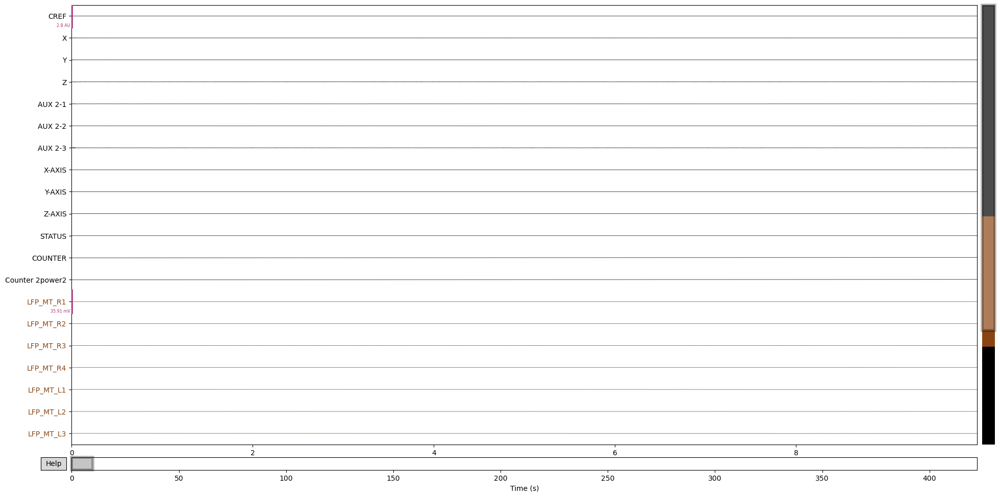

Channels marked as bad: none


In [49]:
raw.plot(scalings='auto')

In [47]:
raw.ch_names

['CREF',
 'LFP_MT_R1',
 'LFP_MT_R2',
 'LFP_MT_R3',
 'LFP_MT_R4',
 'LFP_MT_L1',
 'LFP_MT_L2',
 'LFP_MT_L3',
 'LFP_MT_L4',
 'ECOG_AT_L',
 'ECOG_AT_L-1',
 'ECOG_AT_L-2',
 'ECOG_AT_L-3',
 'ECOG_AT_L-4',
 'ECOG_AT_L-5',
 'X',
 'Y',
 'Z',
 'AUX 2-1',
 'AUX 2-2',
 'AUX 2-3',
 'X-AXIS',
 'Y-AXIS',
 'Z-AXIS',
 'STATUS',
 'COUNTER',
 'Counter 2power2']

In [51]:
new_chs =  ['CREF',
            'LFP_R_1_STN_MT',
            'LFP_R_2_STN_MT',
             'LFP_R_3_STN_MT',
             'LFP_R_4_STN_MT',
             'LFP_L_1_STN_MT',
             'LFP_L_2_STN_MT',
             'LFP_L_3_STN_MT',
             'LFP_L_4_STN_MT',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
           'ECOG_L_3_SMC_AT',
           'ECOG_L_4_SMC_AT',
           'ECOG_L_5_SMC_AT',
           'ECOG_L_6_SMC_AT',
            'X',
            'Y',
            'Z',
            'ACC_R_X_D2_TM',
            'ACC_R_Y_D2_TM',
            'ACC_R_Z_D2_TM',
             'X-AXIS',
             'Y-AXIS',
             'Z-AXIS',
             'STATUS',
             'COUNTER',
             'Counter 2power2']

In [52]:
picks =  ['LFP_R_1_STN_MT',
            'LFP_R_2_STN_MT',
             'LFP_R_3_STN_MT',
             'LFP_R_4_STN_MT',
             'LFP_L_1_STN_MT',
             'LFP_L_2_STN_MT',
             'LFP_L_3_STN_MT',
             'LFP_L_4_STN_MT',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
           'ECOG_L_3_SMC_AT',
           'ECOG_L_4_SMC_AT',
           'ECOG_L_5_SMC_AT',
           'ECOG_L_6_SMC_AT',]
raw = rename_chs(raw, new_chs, picks=picks)

LFP_R_1_STN_MT :  seeg
LFP_R_2_STN_MT :  seeg
LFP_R_3_STN_MT :  seeg
LFP_R_4_STN_MT :  seeg
LFP_L_1_STN_MT :  seeg
LFP_L_2_STN_MT :  seeg
LFP_L_3_STN_MT :  seeg
LFP_L_4_STN_MT :  seeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog


In [53]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-003\ses-EphysMedOn01\ieeg\dummy.vhdr...
Setting channel info structure...
LFP_R_1_STN_MT :  seeg
LFP_R_2_STN_MT :  seeg
LFP_R_3_STN_MT :  seeg
LFP_R_4_STN_MT :  seeg
LFP_L_1_STN_MT :  seeg
LFP_L_2_STN_MT :  seeg
LFP_L_3_STN_MT :  seeg
LFP_L_4_STN_MT :  seeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-003\ses-EphysMedOn01\ieeg\dummy.vhdr...
Setting channel info structure...
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-003\ses-EphysMedOn01\ieeg\sub-003_ses-EphysMedOn01_task-Rest_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading c

c:\users\richa\github\mne-bids\mne_bids\read.py:156: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-003_ses-EphysMedOn01_task-Rest_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-003\**\sub-003_ses-EphysMedOn01*events.tsv"
  warn(msg)


# Next

In [54]:
i = 44

In [55]:
raws[i]

<RawBrainVision | sub-003_ses-EphysMedOn02_task-RestAndSpeech_acq-StimOff_run-01_ieeg.eeg, 27 x 7374991 (1800.5 s), ~35 kB, data not loaded>

In [56]:
raw = raws[i]
file = files[i]

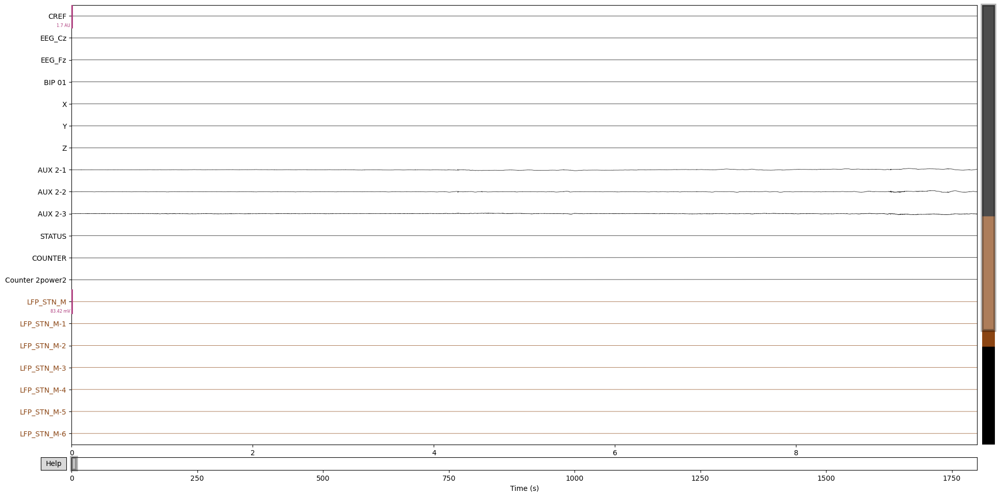

Channels marked as bad: none


In [60]:
raw.plot(scalings='auto')

In [58]:
raw.ch_names

['CREF',
 'LFP_STN_M',
 'LFP_STN_M-1',
 'LFP_STN_M-2',
 'LFP_STN_M-3',
 'LFP_STN_M-4',
 'LFP_STN_M-5',
 'LFP_STN_M-6',
 'LFP_STN_M-7',
 'EEG_Cz',
 'EEG_Fz',
 'ECOG_SM_A',
 'ECOG_SM_A-1',
 'ECOG_SM_A-2',
 'ECOG_SM_A-3',
 'ECOG_SM_A-4',
 'ECOG_SM_A-5',
 'BIP 01',
 'X',
 'Y',
 'Z',
 'AUX 2-1',
 'AUX 2-2',
 'AUX 2-3',
 'STATUS',
 'COUNTER',
 'Counter 2power2']

In [61]:
new_chs =  ['CREF',
            'LFP_R_1_STN_MT',
            'LFP_R_2_STN_MT',
             'LFP_R_3_STN_MT',
             'LFP_R_4_STN_MT',
             'LFP_L_1_STN_MT',
             'LFP_L_2_STN_MT',
             'LFP_L_3_STN_MT',
             'LFP_L_4_STN_MT',
            'EEG_Cz_TM',
             'EEG_Fz_TM',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
           'ECOG_L_3_SMC_AT',
           'ECOG_L_4_SMC_AT',
           'ECOG_L_5_SMC_AT',
           'ECOG_L_6_SMC_AT',
             'EMG_R_BR_TM',
            'X',
            'Y',
            'Z',
            'ACC_R_X_D2_TM',
            'ACC_R_Y_D2_TM',
            'ACC_R_Z_D2_TM',
             'STATUS',
             'COUNTER',
             'Counter 2power2']

In [62]:
picks =  ['LFP_R_1_STN_MT',
            'LFP_R_2_STN_MT',
             'LFP_R_3_STN_MT',
             'LFP_R_4_STN_MT',
             'LFP_L_1_STN_MT',
             'LFP_L_2_STN_MT',
             'LFP_L_3_STN_MT',
             'LFP_L_4_STN_MT',
            'EEG_Cz_TM',
             'EEG_Fz_TM',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
           'ECOG_L_3_SMC_AT',
           'ECOG_L_4_SMC_AT',
           'ECOG_L_5_SMC_AT',
           'ECOG_L_6_SMC_AT',
             'EMG_R_BR_TM',
            'ACC_R_X_D2_TM',
            'ACC_R_Y_D2_TM',
            'ACC_R_Z_D2_TM']
raw = rename_chs(raw, new_chs, picks=picks)

LFP_R_1_STN_MT :  seeg
LFP_R_2_STN_MT :  seeg
LFP_R_3_STN_MT :  seeg
LFP_R_4_STN_MT :  seeg
LFP_L_1_STN_MT :  seeg
LFP_L_2_STN_MT :  seeg
LFP_L_3_STN_MT :  seeg
LFP_L_4_STN_MT :  seeg
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EMG_R_BR_TM :  emg
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc


In [63]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-003\ses-EphysMedOn02\ieeg\dummy.vhdr...
Setting channel info structure...
LFP_R_1_STN_MT :  seeg
LFP_R_2_STN_MT :  seeg
LFP_R_3_STN_MT :  seeg
LFP_R_4_STN_MT :  seeg
LFP_L_1_STN_MT :  seeg
LFP_L_2_STN_MT :  seeg
LFP_L_3_STN_MT :  seeg
LFP_L_4_STN_MT :  seeg
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EMG_R_BR_TM :  emg
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-003\ses-EphysMedOn02\ieeg\dummy.vhdr...
Setting channel info structure...
Reading 0 ... 7374990  =      0.000 ...  1800.534 secs...


c:\users\richa\github\mne-bids\mne_bids\read.py:156: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '


Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-003\ses-EphysMedOn02\ieeg\sub-003_ses-EphysMedOn02_task-RestAndSpeech_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-003\ses-EphysMedOn02\ieeg\sub-003_ses-EphysMedOn02_task-RestAndSpeech_acq-StimOff_run-01_channels.tsv.


c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-003_ses-EphysMedOn02_task-RestAndSpeech_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-003\**\sub-003_ses-EphysMedOn02*events.tsv"
  warn(msg)


# Next

In [9]:
i = 45

In [10]:
raws[i]

<RawBrainVision | sub-003_ses-EphysMedOn02_task-UPDRSIII_acq-StimOff_run-01_ieeg.eeg, 24 x 512928 (373.0 s), ~32 kB, data not loaded>

In [11]:
raw = raws[i]
file = files[i]

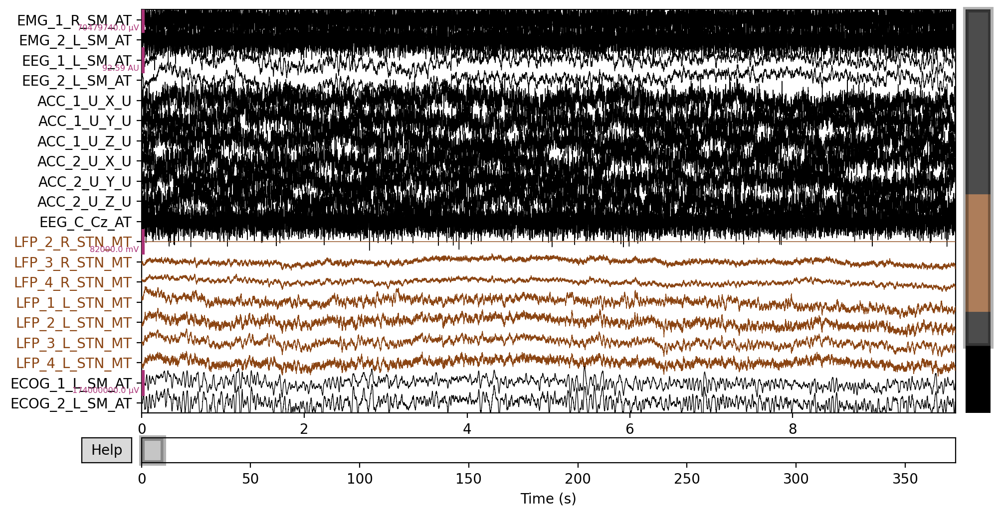

Channels marked as bad: none


In [30]:
raw.plot(scalings='auto')

In [12]:
raw.ch_names

['LFP_2_R_STN_MT',
 'LFP_3_R_STN_MT',
 'LFP_4_R_STN_MT',
 'LFP_1_L_STN_MT',
 'LFP_2_L_STN_MT',
 'LFP_3_L_STN_MT',
 'LFP_4_L_STN_MT',
 'EEG_1_L_SM_AT',
 'EEG_2_L_SM_AT',
 'ECOG_1_L_SM_AT',
 'ECOG_2_L_SM_AT',
 'ECOG_3_L_SM_AT',
 'ECOG_4_L_SM_AT',
 'ECOG_5_L_SM_AT',
 'ECOG_6_L_SM_AT',
 'ACC_1_U_X_U',
 'ACC_1_U_Y_U',
 'ACC_1_U_Z_U',
 'ACC_2_U_X_U',
 'ACC_2_U_Y_U',
 'ACC_2_U_Z_U',
 'EMG_1_R_SM_AT',
 'EMG_2_L_SM_AT',
 'EEG_C_Cz_AT']

In [13]:
EMG_raw = raw.copy().pick(picks=['EEG_C_Cz_AT']).load_data().filter(l_freq=15, h_freq=500, picks='all')

Reading 0 ... 512927  =      0.000 ...   373.038 secs...
No data channels found. The highpass and lowpass values in the measurement info will not be updated.
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 15 - 5e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 15.00
- Lower transition bandwidth: 3.75 Hz (-6 dB cutoff frequency: 13.12 Hz)
- Upper passband edge: 500.00 Hz
- Upper transition bandwidth: 125.00 Hz (-6 dB cutoff frequency: 562.50 Hz)
- Filter length: 1211 samples (0.881 sec)



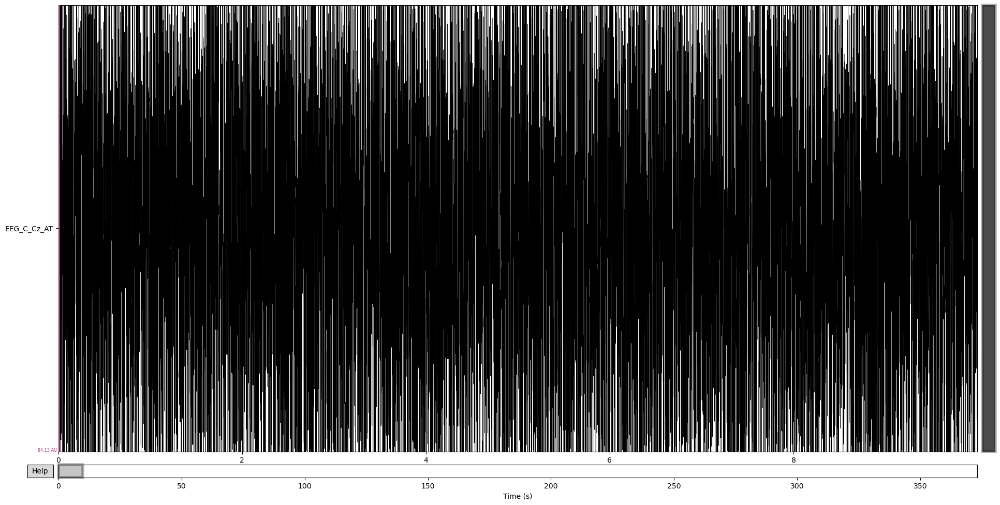

Channels marked as bad: none


In [73]:
EMG_raw.plot(scalings='auto')

Reading 0 ... 512927  =      0.000 ...   373.038 secs...
EEG channel type selected for re-referencing
Bipolar channel added as "EMG_BIP".
Creating RawArray with float64 data, n_channels=5, n_times=512928
    Range : 0 ... 512927 =      0.000 ...   373.038 secs
Ready.


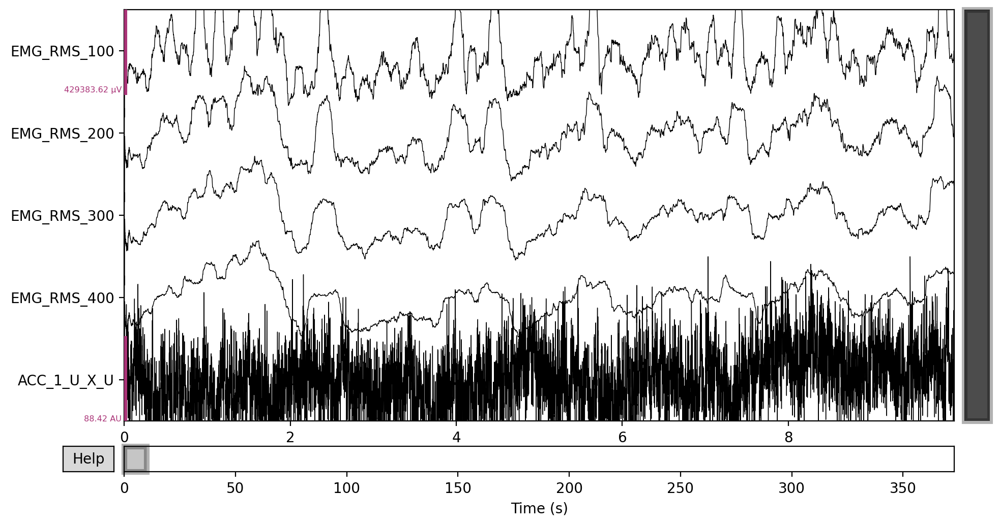

Channels marked as bad: none


In [29]:
raw_rms_0 = emg.get_emg_rms(raw, emg_ch=['EMG_2_L_SM_AT'], 
                            window_len=np.arange(100,500,100, dtype=int), 
                            analog_ch='ACC_1_U_X_U', rereference=False)
raw_rms_0.plot(scalings='auto')

In [14]:
import numpy as np

data = EMG_raw.get_data()
data = np.abs(data)
data = mne.filter.filter_data(data, sfreq=EMG_raw.info['sfreq'], l_freq=5, h_freq=None)


Setting up high-pass filter at 5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal highpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 5.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 4.00 Hz)
- Filter length: 2269 samples (1.650 sec)



In [31]:
new_chs =  ['LFP_R_2_STN_MT',
             'LFP_R_3_STN_MT',
             'LFP_R_4_STN_MT',
             'LFP_L_1_STN_MT',
             'LFP_L_2_STN_MT',
             'LFP_L_3_STN_MT',
             'LFP_L_4_STN_MT',
            'EEG_Cz_AO',
             'EEG_Fz_AO',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
           'ECOG_L_3_SMC_AT',
           'ECOG_L_4_SMC_AT',
           'ECOG_L_5_SMC_AT',
           'ECOG_L_6_SMC_AT',
            'ACC_R_X_D2_AO',
            'ACC_R_Y_D2_AO',
            'ACC_R_Z_D2_AO',
            'ACC_L_X_D2_AO',
            'ACC_L_Y_D2_AO',
            'ACC_L_Z_D2_AO',
             'EMG_R_BR_AO',
            'EMG_L_BR_AO',
           'EEG_Cz_Fz_AO']

In [32]:
picks =  None
raw = rename_chs(raw, new_chs, picks=picks)

LFP_R_2_STN_MT :  seeg
LFP_R_3_STN_MT :  seeg
LFP_R_4_STN_MT :  seeg
LFP_L_1_STN_MT :  seeg
LFP_L_2_STN_MT :  seeg
LFP_L_3_STN_MT :  seeg
LFP_L_4_STN_MT :  seeg
EEG_Cz_AO :  eeg
EEG_Fz_AO :  eeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
ACC_R_X_D2_AO :  misc
ACC_R_Y_D2_AO :  misc
ACC_R_Z_D2_AO :  misc
ACC_L_X_D2_AO :  misc
ACC_L_Y_D2_AO :  misc
ACC_L_Z_D2_AO :  misc
EMG_R_BR_AO :  emg
EMG_L_BR_AO :  emg
EEG_Cz_Fz_AO :  eeg


In [33]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-003\ses-EphysMedOn02\ieeg\dummy.vhdr...
Setting channel info structure...
LFP_R_2_STN_MT :  seeg
LFP_R_3_STN_MT :  seeg
LFP_R_4_STN_MT :  seeg
LFP_L_1_STN_MT :  seeg
LFP_L_2_STN_MT :  seeg
LFP_L_3_STN_MT :  seeg
LFP_L_4_STN_MT :  seeg
EEG_Cz_AO :  eeg
EEG_Fz_AO :  eeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
ACC_R_X_D2_AO :  misc
ACC_R_Y_D2_AO :  misc
ACC_R_Z_D2_AO :  misc
ACC_L_X_D2_AO :  misc
ACC_L_Y_D2_AO :  misc
ACC_L_Z_D2_AO :  misc
EMG_R_BR_AO :  emg
EMG_L_BR_AO :  emg
EEG_Cz_Fz_AO :  eeg
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-003\ses-EphysMedOn02\ieeg\dummy.vhdr...
Setting channel info structure...
Reading 0 ... 512927  =      0.000 ...   373.038 secs...


c:\users\richa\github\mne-bids\mne_bids\read.py:156: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '


Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-003\ses-EphysMedOn02\ieeg\sub-003_ses-EphysMedOn02_task-UPDRSIII_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-003\ses-EphysMedOn02\ieeg\sub-003_ses-EphysMedOn02_task-UPDRSIII_acq-StimOff_run-01_channels.tsv.


c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-003_ses-EphysMedOn02_task-UPDRSIII_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-003\**\sub-003_ses-EphysMedOn02*events.tsv"
  warn(msg)


# Next

In [34]:
i = 46

In [35]:
raws[i]

<RawBrainVision | sub-003_ses-EphysMedOn03_task-BlockRotationR_acq-StimOff_run-01_ieeg.eeg, 25 x 536676 (390.2 s), ~33 kB, data not loaded>

In [36]:
raw = raws[i]
file = files[i]

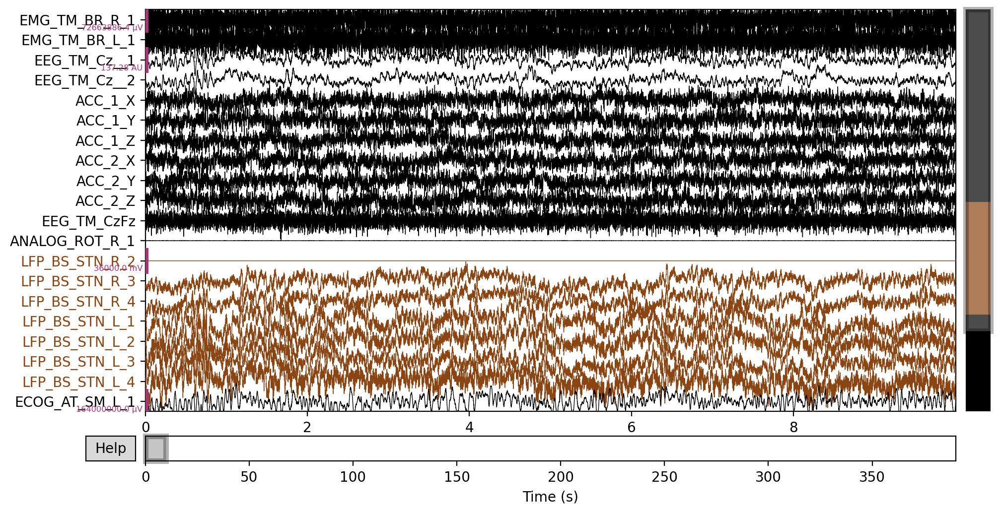

Channels marked as bad: none


In [37]:
raw.plot(scalings='auto')

# This is a double of 48: SelfpacedRotationR

# Next

In [46]:
i = 47

In [47]:
raws[i]

<RawBrainVision | sub-003_ses-EphysMedOn03_task-Rest_acq-StimOff_run-01_ieeg.eeg, 27 x 2468095 (602.6 s), ~35 kB, data not loaded>

In [48]:
raw = raws[i]
file = files[i]

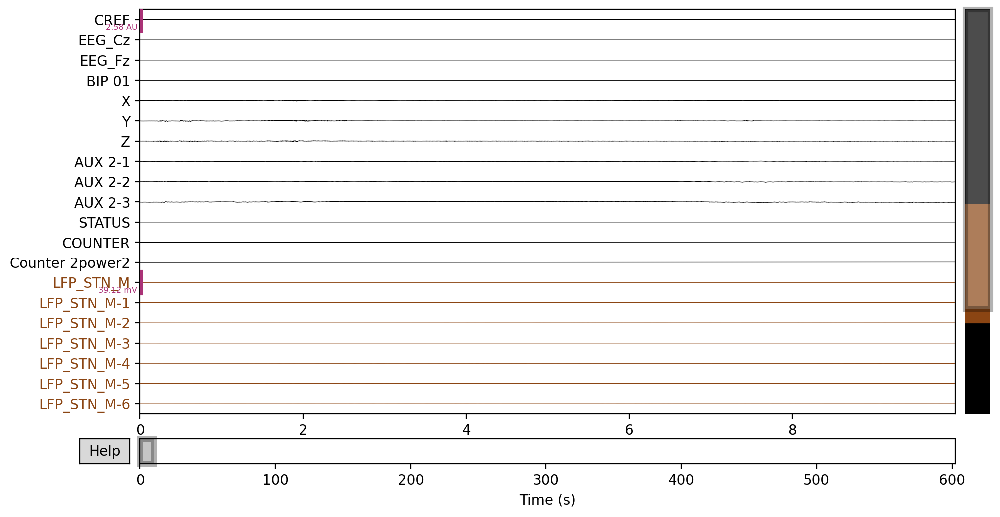

Channels marked as bad: ['X', 'Y', 'Z', 'AUX 2-1', 'AUX 2-2', 'AUX 2-3', 'COUNTER', 'STATUS']


In [49]:
raw.plot(scalings='auto')

In [50]:
raw.ch_names

['CREF',
 'LFP_STN_M',
 'LFP_STN_M-1',
 'LFP_STN_M-2',
 'LFP_STN_M-3',
 'LFP_STN_M-4',
 'LFP_STN_M-5',
 'LFP_STN_M-6',
 'LFP_STN_M-7',
 'EEG_Cz',
 'EEG_Fz',
 'ECOG_SM_A',
 'ECOG_SM_A-1',
 'ECOG_SM_A-2',
 'ECOG_SM_A-3',
 'ECOG_SM_A-4',
 'ECOG_SM_A-5',
 'BIP 01',
 'X',
 'Y',
 'Z',
 'AUX 2-1',
 'AUX 2-2',
 'AUX 2-3',
 'STATUS',
 'COUNTER',
 'Counter 2power2']

In [51]:
new_chs =  ['CREF',
            'LFP_R_1_STN_MT',
            'LFP_R_2_STN_MT',
             'LFP_R_3_STN_MT',
             'LFP_R_4_STN_MT',
             'LFP_L_1_STN_MT',
             'LFP_L_2_STN_MT',
             'LFP_L_3_STN_MT',
             'LFP_L_4_STN_MT',
            'EEG_Cz_AO',
             'EEG_Fz_AO',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
           'ECOG_L_3_SMC_AT',
           'ECOG_L_4_SMC_AT',
           'ECOG_L_5_SMC_AT',
           'ECOG_L_6_SMC_AT',
             'EMG_R_BR_AO',
            'ACC_R_X_D2_AO',
            'ACC_R_Y_D2_AO',
            'ACC_R_Z_D2_AO',
            'ACC_L_X_D2_AO',
            'ACC_L_Y_D2_AO',
            'ACC_L_Z_D2_AO',
             'STATUS',
             'COUNTER',
             'Counter 2power2'
            ]

In [52]:
picks =  ['LFP_R_1_STN_MT',
            'LFP_R_2_STN_MT',
             'LFP_R_3_STN_MT',
             'LFP_R_4_STN_MT',
             'LFP_L_1_STN_MT',
             'LFP_L_2_STN_MT',
             'LFP_L_3_STN_MT',
             'LFP_L_4_STN_MT',
            'EEG_Cz_AO',
             'EEG_Fz_AO',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
           'ECOG_L_3_SMC_AT',
           'ECOG_L_4_SMC_AT',
           'ECOG_L_5_SMC_AT',
           'ECOG_L_6_SMC_AT',
             'EMG_R_BR_AO',
            'ACC_R_X_D2_AO',
            'ACC_R_Y_D2_AO',
            'ACC_R_Z_D2_AO',
            'ACC_L_X_D2_AO',
            'ACC_L_Y_D2_AO',
            'ACC_L_Z_D2_AO']
raw = rename_chs(raw, new_chs, picks=picks)

LFP_R_1_STN_MT :  seeg
LFP_R_2_STN_MT :  seeg
LFP_R_3_STN_MT :  seeg
LFP_R_4_STN_MT :  seeg
LFP_L_1_STN_MT :  seeg
LFP_L_2_STN_MT :  seeg
LFP_L_3_STN_MT :  seeg
LFP_L_4_STN_MT :  seeg
EEG_Cz_AO :  eeg
EEG_Fz_AO :  eeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EMG_R_BR_AO :  emg
ACC_R_X_D2_AO :  misc
ACC_R_Y_D2_AO :  misc
ACC_R_Z_D2_AO :  misc
ACC_L_X_D2_AO :  misc
ACC_L_Y_D2_AO :  misc
ACC_L_Z_D2_AO :  misc


In [53]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-003\ses-EphysMedOn03\ieeg\dummy.vhdr...
Setting channel info structure...
LFP_R_1_STN_MT :  seeg
LFP_R_2_STN_MT :  seeg
LFP_R_3_STN_MT :  seeg
LFP_R_4_STN_MT :  seeg
LFP_L_1_STN_MT :  seeg
LFP_L_2_STN_MT :  seeg
LFP_L_3_STN_MT :  seeg
LFP_L_4_STN_MT :  seeg
EEG_Cz_AO :  eeg
EEG_Fz_AO :  eeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EMG_R_BR_AO :  emg
ACC_R_X_D2_AO :  misc
ACC_R_Y_D2_AO :  misc
ACC_R_Z_D2_AO :  misc
ACC_L_X_D2_AO :  misc
ACC_L_Y_D2_AO :  misc
ACC_L_Z_D2_AO :  misc
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-003\ses-EphysMedOn03\ieeg\dummy.vhdr...
Setting channel info structure...
Reading 0 ... 2468094  =      0.000 ...   602.562 secs...


c:\users\richa\github\mne-bids\mne_bids\read.py:156: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '


Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-003\ses-EphysMedOn03\ieeg\sub-003_ses-EphysMedOn03_task-Rest_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-003\ses-EphysMedOn03\ieeg\sub-003_ses-EphysMedOn03_task-Rest_acq-StimOff_run-01_channels.tsv.


c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-003_ses-EphysMedOn03_task-Rest_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-003\**\sub-003_ses-EphysMedOn03*events.tsv"
  warn(msg)


# Next

In [54]:
i = 48

In [55]:
raws[i]

<RawBrainVision | sub-003_ses-EphysMedOn03_task-SelfpacedRotationR_acq-StimOff_run-01_ieeg.eeg, 26 x 536676 (390.3 s), ~34 kB, data not loaded>

In [56]:
raw = raws[i]
file = files[i]

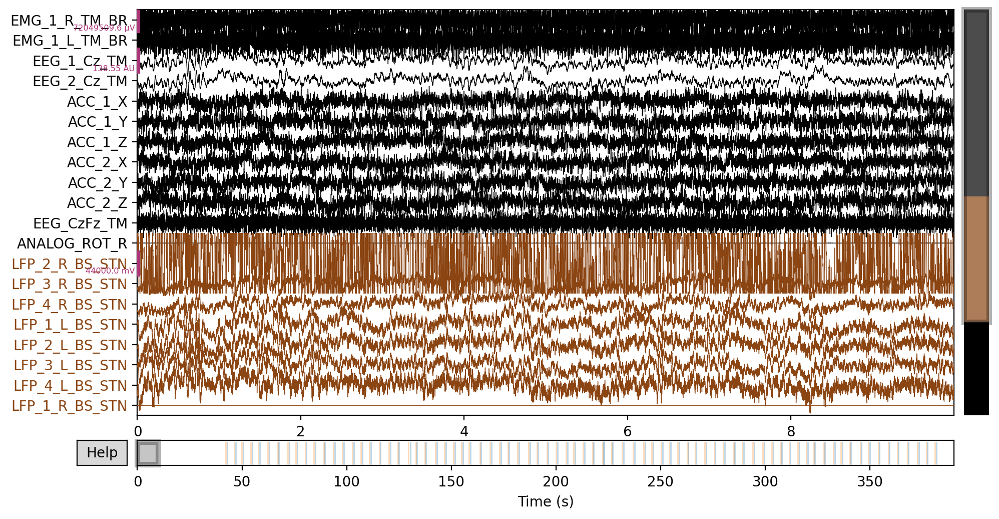

Channels marked as bad: none


In [57]:
raw.plot(scalings='auto')

In [58]:
raw.ch_names

['LFP_2_R_BS_STN',
 'LFP_3_R_BS_STN',
 'LFP_4_R_BS_STN',
 'LFP_1_L_BS_STN',
 'LFP_2_L_BS_STN',
 'LFP_3_L_BS_STN',
 'LFP_4_L_BS_STN',
 'EEG_1_Cz_TM',
 'EEG_2_Cz_TM',
 'ECOG_1_L_AT_SM',
 'ECOG_2_L_AT_SM',
 'ECOG_3_L_AT_SM',
 'ECOG_4_L_AT_SM',
 'ECOG_5_L_AT_SM',
 'ECOG_6_L_AT_SM',
 'ACC_1_X',
 'ACC_1_Y',
 'ACC_1_Z',
 'ACC_2_X',
 'ACC_2_Y',
 'ACC_2_Z',
 'EMG_1_R_TM_BR',
 'EMG_1_L_TM_BR',
 'EEG_CzFz_TM',
 'ANALOG_ROT_R',
 'LFP_1_R_BS_STN']

In [61]:
new_chs =  ['LFP_R_2_STN_MT',
             'LFP_R_3_STN_MT',
             'LFP_R_4_STN_MT',
             'LFP_L_1_STN_MT',
             'LFP_L_2_STN_MT',
             'LFP_L_3_STN_MT',
             'LFP_L_4_STN_MT',
             'EEG_Cz_AO',
             'EEG_Fz_AO',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
           'ECOG_L_3_SMC_AT',
           'ECOG_L_4_SMC_AT',
           'ECOG_L_5_SMC_AT',
           'ECOG_L_6_SMC_AT',
            'ACC_R_X_D2_AO',
            'ACC_R_Y_D2_AO',
            'ACC_R_Z_D2_AO',
            'ACC_L_X_D2_AO',
            'ACC_L_Y_D2_AO',
            'ACC_L_Z_D2_AO',
             'EMG_R_BR_AO',
             'EMG_L_BR_AO',
             'EEG_Cz_Fz_AO',
             'ANALOG_R_ROTA_CH',
            'LFP_R_1_STN_MT']

In [62]:
picks = None
raw = rename_chs(raw, new_chs, picks=picks)

LFP_R_2_STN_MT :  seeg
LFP_R_3_STN_MT :  seeg
LFP_R_4_STN_MT :  seeg
LFP_L_1_STN_MT :  seeg
LFP_L_2_STN_MT :  seeg
LFP_L_3_STN_MT :  seeg
LFP_L_4_STN_MT :  seeg
EEG_Cz_AO :  eeg
EEG_Fz_AO :  eeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
ACC_R_X_D2_AO :  misc
ACC_R_Y_D2_AO :  misc
ACC_R_Z_D2_AO :  misc
ACC_L_X_D2_AO :  misc
ACC_L_Y_D2_AO :  misc
ACC_L_Z_D2_AO :  misc
EMG_R_BR_AO :  emg
EMG_L_BR_AO :  emg
EEG_Cz_Fz_AO :  eeg
ANALOG_R_ROTA_C :  misc
LFP_R_1_STN_MT :  seeg


In [63]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Used Annotations descriptions: ['Movement_End', 'Movement_Onset']
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-003\ses-EphysMedOn03\ieeg\dummy.vhdr...
Setting channel info structure...
LFP_R_2_STN_MT :  seeg
LFP_R_3_STN_MT :  seeg
LFP_R_4_STN_MT :  seeg
LFP_L_1_STN_MT :  seeg
LFP_L_2_STN_MT :  seeg
LFP_L_3_STN_MT :  seeg
LFP_L_4_STN_MT :  seeg
EEG_Cz_AO :  eeg
EEG_Fz_AO :  eeg
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
ACC_R_X_D2_AO :  misc
ACC_R_Y_D2_AO :  misc
ACC_R_Z_D2_AO :  misc
ACC_L_X_D2_AO :  misc
ACC_L_Y_D2_AO :  misc
ACC_L_Z_D2_AO :  misc
EMG_R_BR_AO :  emg
EMG_L_BR_AO :  emg
EEG_Cz_Fz_AO :  eeg
ANALOG_R_ROTA_C :  misc
LFP_R_1_STN_MT :  seeg
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-003\ses-EphysMedOn03\ieeg\du

In [75]:
test_raw.reorder_channels(sorted(test_raw.ch_names))

<RawBrainVision | sub-003_ses-EphysMedOn03_task-SelfpacedRotationR_acq-StimOff_run-01_ieeg.eeg, 26 x 536676 (390.3 s), ~32 kB, data not loaded>

In [76]:
test_raw.ch_names

['ACC_L_X_D2_AO',
 'ACC_L_Y_D2_AO',
 'ACC_L_Z_D2_AO',
 'ACC_R_X_D2_AO',
 'ACC_R_Y_D2_AO',
 'ACC_R_Z_D2_AO',
 'ANALOG_R_ROTA_C',
 'ECOG_L_1_SMC_AT',
 'ECOG_L_2_SMC_AT',
 'ECOG_L_3_SMC_AT',
 'ECOG_L_4_SMC_AT',
 'ECOG_L_5_SMC_AT',
 'ECOG_L_6_SMC_AT',
 'EEG_Cz_AO',
 'EEG_Cz_Fz_AO',
 'EEG_Fz_AO',
 'EMG_L_BR_AO',
 'EMG_R_BR_AO',
 'LFP_L_1_STN_MT',
 'LFP_L_2_STN_MT',
 'LFP_L_3_STN_MT',
 'LFP_L_4_STN_MT',
 'LFP_R_1_STN_MT',
 'LFP_R_2_STN_MT',
 'LFP_R_3_STN_MT',
 'LFP_R_4_STN_MT']

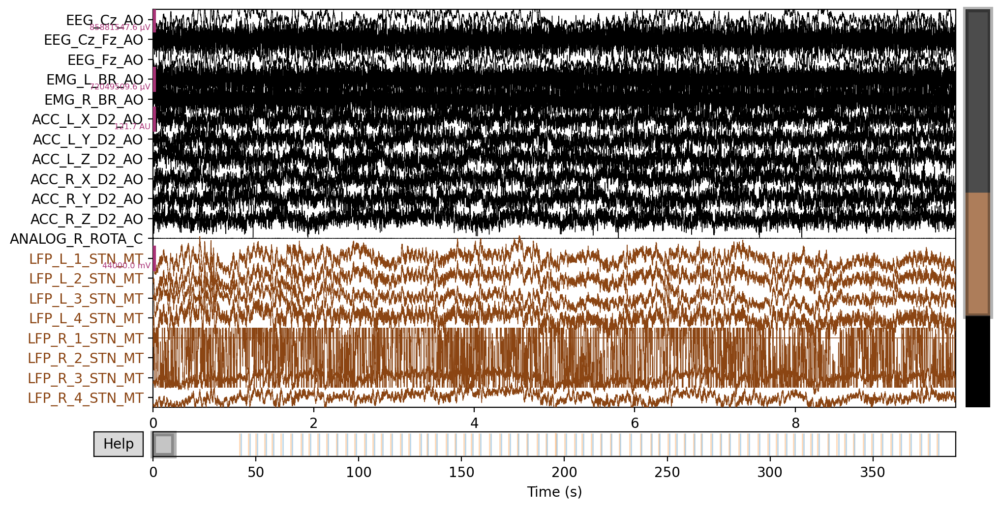

Channels marked as bad: none


In [77]:
test_raw.plot(scalings='auto')

# Next

In [140]:
i = 49

In [141]:
raws[i]

<RawBrainVision | sub-004_ses-EphysMedOff01_task-BlockRotationL_acq-StimOff_run-01_ieeg.eeg, 33 x 1137566 (277.6 s), ~41 kB, data not loaded>

In [145]:
file = files[i]
raw = mne_bids.read_raw_bids(file)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOff01\ieeg\sub-004_ses-EphysMedOff01_task-BlockRotationL_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOff01\ieeg\sub-004_ses-EphysMedOff01_task-BlockRotationL_acq-StimOff_run-01_channels.tsv.


c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOff01_task-BlockRotationL_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\**\sub-004_ses-EphysMedOff01*events.tsv"
  warn(msg)


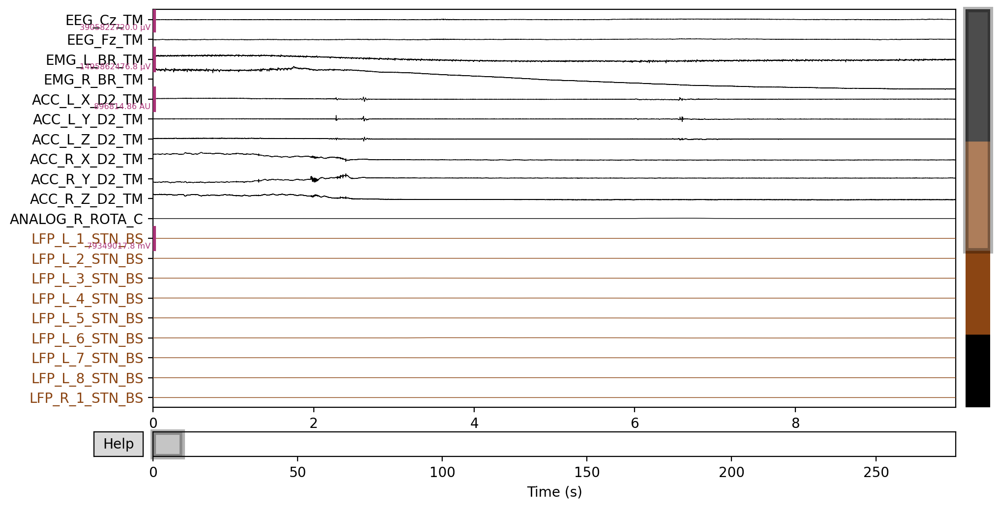

Channels marked as bad: none


In [143]:
raw.plot(scalings='auto')

In [146]:
raw.ch_names

['CREF',
 'LFP_BS_STN_R_1',
 'LFP_BS_STN_R_2',
 'LFP_BS_STN_R_3',
 'LFP_BS_STN_R_4',
 'LFP_BS_STN_R_5',
 'LFP_BS_STN_R_6',
 'LFP_BS_STN_R_7',
 'LFP_BS_STN_R_8',
 'LFP_BS_STN_L_1',
 'LFP_BS_STN_L_2',
 'LFP_BS_STN_L_3',
 'LFP_BS_STN_L_4',
 'LFP_BS_STN_L_5',
 'LFP_BS_STN_L_6',
 'LFP_BS_STN_L_7',
 'LFP_BS_STN_L_8',
 'ECOG_AT_SM_L_1',
 'ECOG_AT_SM_L_2',
 'ECOG_AT_SM_L_3',
 'ECOG_AT_SM_L_4',
 'ECOG_AT_SM_L_5',
 'ECOG_AT_SM_L_6',
 'EEG_TM_Cz',
 'EEG_TM_Fz',
 'EMG_TM_BR_R_1',
 'EMG_TM_BR_L_1',
 'X',
 'Y',
 'Z',
 'AUX_2_1',
 'AUX_2_2',
 'AUX_2_3',
 'AUX_3_1',
 'AUX_3_2',
 'AUX_3_3']

In [147]:
new_chs =  ['CREF',
             'LFP_R_1_STN_BS',
            'LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_R_8_STN_BS',
             'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
             'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
            'ECOG_L_3_SMC_AT',
            'ECOG_L_4_SMC_AT',
            'ECOG_L_5_SMC_AT',
            'ECOG_L_6_SMC_AT',
             'EEG_Cz_TM',
             'EEG_Fz_TM',
             'EMG_R_BR_TM',
             'EMG_L_BR_TM',
             'ACC_R_X_D2_TM',
            'ACC_R_Y_D2_TM',
            'ACC_R_Z_D2_TM',
           'ACC_L_X_D2_TM',
            'ACC_L_Y_D2_TM',
            'ACC_L_Z_D2_TM',
             'ANALOG_L_ROTA_CH',
             'AUX_3_2',
             'AUX_3_3']

In [148]:
picks = ['LFP_R_1_STN_BS',
            'LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_R_8_STN_BS',
             'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
             'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
            'ECOG_L_3_SMC_AT',
            'ECOG_L_4_SMC_AT',
            'ECOG_L_5_SMC_AT',
            'ECOG_L_6_SMC_AT',
             'EEG_Cz_TM',
             'EEG_Fz_TM',
             'EMG_R_BR_TM',
             'EMG_L_BR_TM',
             'ACC_R_X_D2_TM',
            'ACC_R_Y_D2_TM',
            'ACC_R_Z_D2_TM',
           'ACC_L_X_D2_TM',
            'ACC_L_Y_D2_TM',
            'ACC_L_Z_D2_TM',
             'ANALOG_L_ROTA_CH']
raw = rename_chs(raw, new_chs, picks=picks)

ACC_L_X_D2_TM :  misc
ACC_L_Y_D2_TM :  misc
ACC_L_Z_D2_TM :  misc
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc
ANALOG_L_ROTA_C :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg


In [149]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOff01\ieeg\dummy.vhdr...
Setting channel info structure...
ACC_L_X_D2_TM :  misc
ACC_L_Y_D2_TM :  misc
ACC_L_Z_D2_TM :  misc
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc
ANALOG_L_ROTA_C :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
Extracting parameters from C:\Users\richa\OneDrive - Char

c:\users\richa\github\mne-bids\mne_bids\read.py:156: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '


Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOff01\ieeg\sub-004_ses-EphysMedOff01_task-BlockRotationL_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOff01\ieeg\sub-004_ses-EphysMedOff01_task-BlockRotationL_acq-StimOff_run-01_channels.tsv.


c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOff01_task-BlockRotationL_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\**\sub-004_ses-EphysMedOff01*events.tsv"
  warn(msg)


# Next

In [89]:
i = 50

In [90]:
raws[i]

<RawBrainVision | sub-004_ses-EphysMedOff01_task-BlockRotationR_acq-StimOff_run-01_ieeg.eeg, 36 x 1151636 (281.0 s), ~44 kB, data not loaded>

In [91]:
raw = raws[i]
file = files[i]

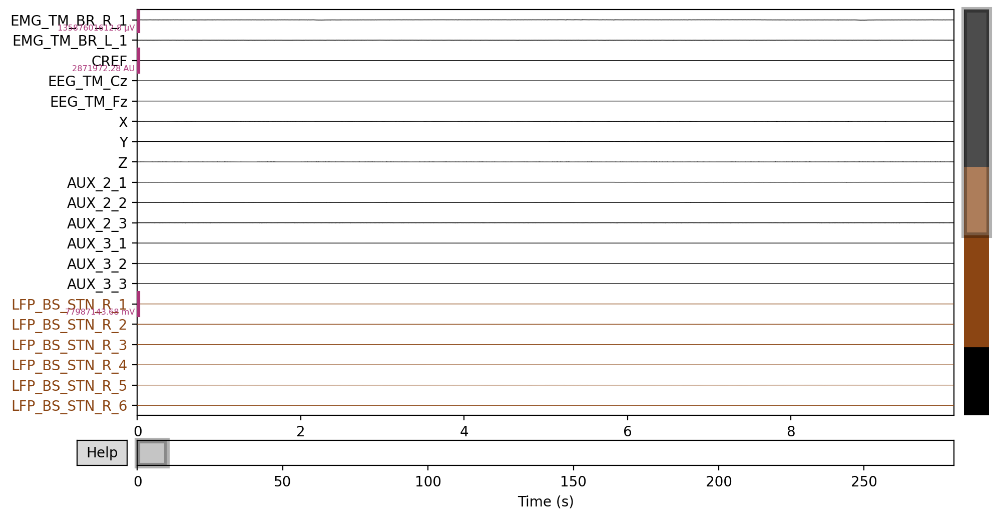

Channels marked as bad: none


In [92]:
raw.plot(scalings='auto')

In [93]:
raw.ch_names

['CREF',
 'LFP_BS_STN_R_1',
 'LFP_BS_STN_R_2',
 'LFP_BS_STN_R_3',
 'LFP_BS_STN_R_4',
 'LFP_BS_STN_R_5',
 'LFP_BS_STN_R_6',
 'LFP_BS_STN_R_7',
 'LFP_BS_STN_R_8',
 'LFP_BS_STN_L_1',
 'LFP_BS_STN_L_2',
 'LFP_BS_STN_L_3',
 'LFP_BS_STN_L_4',
 'LFP_BS_STN_L_5',
 'LFP_BS_STN_L_6',
 'LFP_BS_STN_L_7',
 'LFP_BS_STN_L_8',
 'ECOG_AT_SM_L_1',
 'ECOG_AT_SM_L_2',
 'ECOG_AT_SM_L_3',
 'ECOG_AT_SM_L_4',
 'ECOG_AT_SM_L_5',
 'ECOG_AT_SM_L_6',
 'EEG_TM_Cz',
 'EEG_TM_Fz',
 'EMG_TM_BR_R_1',
 'EMG_TM_BR_L_1',
 'X',
 'Y',
 'Z',
 'AUX_2_1',
 'AUX_2_2',
 'AUX_2_3',
 'AUX_3_1',
 'AUX_3_2',
 'AUX_3_3']

In [94]:
new_chs =  ['CREF',
             'LFP_R_1_STN_BS',
            'LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_R_8_STN_BS',
             'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
             'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
            'ECOG_L_3_SMC_AT',
            'ECOG_L_4_SMC_AT',
            'ECOG_L_5_SMC_AT',
            'ECOG_L_6_SMC_AT',
             'EEG_Cz_TM',
             'EEG_Fz_TM',
             'EMG_R_BR_TM',
             'EMG_L_BR_TM',
             'ACC_R_X_D2_TM',
            'ACC_R_Y_D2_TM',
            'ACC_R_Z_D2_TM',
           'ACC_L_X_D2_TM',
            'ACC_L_Y_D2_TM',
            'ACC_L_Z_D2_TM',
             'ANALOG_R_ROTA_CH',
             'AUX_3_2',
             'AUX_3_3']

In [95]:
picks = ['LFP_R_1_STN_BS',
            'LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_R_8_STN_BS',
             'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
             'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
            'ECOG_L_3_SMC_AT',
            'ECOG_L_4_SMC_AT',
            'ECOG_L_5_SMC_AT',
            'ECOG_L_6_SMC_AT',
             'EEG_Cz_TM',
             'EEG_Fz_TM',
             'EMG_R_BR_TM',
             'EMG_L_BR_TM',
             'ACC_R_X_D2_TM',
            'ACC_R_Y_D2_TM',
            'ACC_R_Z_D2_TM',
           'ACC_L_X_D2_TM',
            'ACC_L_Y_D2_TM',
            'ACC_L_Z_D2_TM',
             'ANALOG_R_ROTA_CH']
raw = rename_chs(raw, new_chs, picks=picks)

ACC_L_X_D2_TM :  misc
ACC_L_Y_D2_TM :  misc
ACC_L_Z_D2_TM :  misc
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc
ANALOG_R_ROTA_C :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg


In [96]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOff01\ieeg\dummy.vhdr...
Setting channel info structure...
ACC_L_X_D2_TM :  misc
ACC_L_Y_D2_TM :  misc
ACC_L_Z_D2_TM :  misc
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc
ANALOG_R_ROTA_C :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
Extracting parameters from C:\Users\richa\OneDrive - Char

c:\users\richa\github\mne-bids\mne_bids\read.py:156: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '


Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOff01\ieeg\sub-004_ses-EphysMedOff01_task-BlockRotationR_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOff01\ieeg\sub-004_ses-EphysMedOff01_task-BlockRotationR_acq-StimOff_run-01_channels.tsv.


c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOff01_task-BlockRotationR_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\**\sub-004_ses-EphysMedOff01*events.tsv"
  warn(msg)


# Next

In [97]:
i = 51

In [98]:
raws[i]

<RawBrainVision | sub-004_ses-EphysMedOff01_task-RestTransition_acq-StimOff_run-01_ieeg.eeg, 36 x 152876 (37.3 s), ~44 kB, data not loaded>

In [99]:
raw = raws[i]
file = files[i]

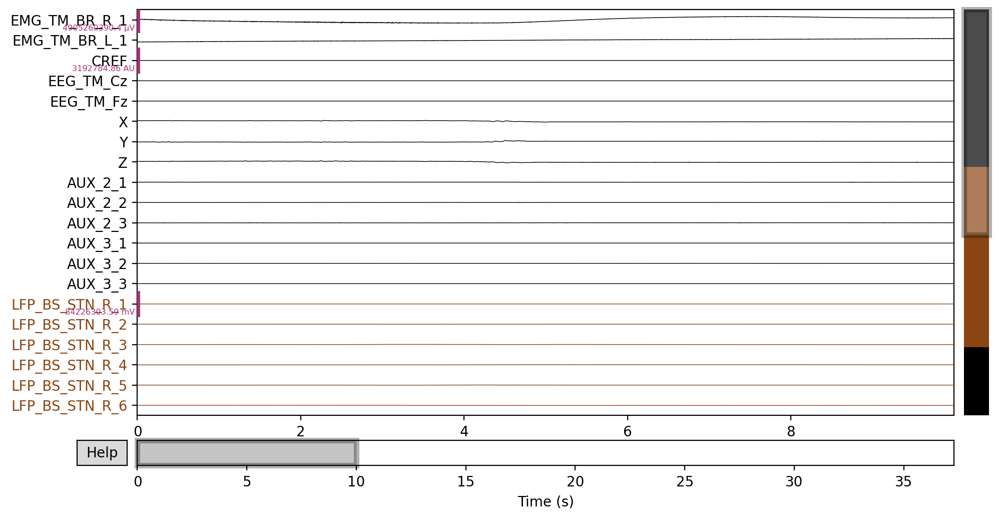

Channels marked as bad: none


In [103]:
raw.plot(scalings='auto')

In [101]:
raw.ch_names

['CREF',
 'LFP_BS_STN_R_1',
 'LFP_BS_STN_R_2',
 'LFP_BS_STN_R_3',
 'LFP_BS_STN_R_4',
 'LFP_BS_STN_R_5',
 'LFP_BS_STN_R_6',
 'LFP_BS_STN_R_7',
 'LFP_BS_STN_R_8',
 'LFP_BS_STN_L_1',
 'LFP_BS_STN_L_2',
 'LFP_BS_STN_L_3',
 'LFP_BS_STN_L_4',
 'LFP_BS_STN_L_5',
 'LFP_BS_STN_L_6',
 'LFP_BS_STN_L_7',
 'LFP_BS_STN_L_8',
 'ECOG_AT_SM_L_1',
 'ECOG_AT_SM_L_2',
 'ECOG_AT_SM_L_3',
 'ECOG_AT_SM_L_4',
 'ECOG_AT_SM_L_5',
 'ECOG_AT_SM_L_6',
 'EEG_TM_Cz',
 'EEG_TM_Fz',
 'EMG_TM_BR_R_1',
 'EMG_TM_BR_L_1',
 'X',
 'Y',
 'Z',
 'AUX_2_1',
 'AUX_2_2',
 'AUX_2_3',
 'AUX_3_1',
 'AUX_3_2',
 'AUX_3_3']

In [102]:
new_chs =  ['CREF',
             'LFP_R_1_STN_BS',
            'LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_R_8_STN_BS',
             'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
             'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
            'ECOG_L_3_SMC_AT',
            'ECOG_L_4_SMC_AT',
            'ECOG_L_5_SMC_AT',
            'ECOG_L_6_SMC_AT',
             'EEG_Cz_TM',
             'EEG_Fz_TM',
             'EMG_R_BR_TM',
             'EMG_L_BR_TM',
             'ACC_R_X_D2_TM',
            'ACC_R_Y_D2_TM',
            'ACC_R_Z_D2_TM',
           'ACC_L_X_D2_TM',
            'ACC_L_Y_D2_TM',
            'ACC_L_Z_D2_TM',
             'ANALOG_R_ROTA_CH',
             'AUX_3_2',
             'AUX_3_3']

In [104]:
picks = ['LFP_R_1_STN_BS',
            'LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_R_8_STN_BS',
             'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
             'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
            'ECOG_L_3_SMC_AT',
            'ECOG_L_4_SMC_AT',
            'ECOG_L_5_SMC_AT',
            'ECOG_L_6_SMC_AT',
             'EEG_Cz_TM',
             'EEG_Fz_TM',
             'EMG_R_BR_TM',
             'EMG_L_BR_TM',
             'ACC_R_X_D2_TM',
            'ACC_R_Y_D2_TM',
            'ACC_R_Z_D2_TM',
           'ACC_L_X_D2_TM',
            'ACC_L_Y_D2_TM',
            'ACC_L_Z_D2_TM']
raw = rename_chs(raw, new_chs, picks=picks)

ACC_L_X_D2_TM :  misc
ACC_L_Y_D2_TM :  misc
ACC_L_Z_D2_TM :  misc
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg


In [105]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOff01\ieeg\dummy.vhdr...
Setting channel info structure...
ACC_L_X_D2_TM :  misc
ACC_L_Y_D2_TM :  misc
ACC_L_Z_D2_TM :  misc
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizi

c:\users\richa\github\mne-bids\mne_bids\read.py:156: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOff01_task-RestTransition_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\**\sub-004_ses-EphysMedOff01*events.tsv"
  warn(msg)


# Next

In [106]:
i = 52

In [107]:
raws[i]

<RawBrainVision | sub-004_ses-EphysMedOff01_task-RestTransition_acq-StimOff_run-02_ieeg.eeg, 36 x 7388741 (1802.9 s), ~44 kB, data not loaded>

In [108]:
raw = raws[i]
file = files[i]

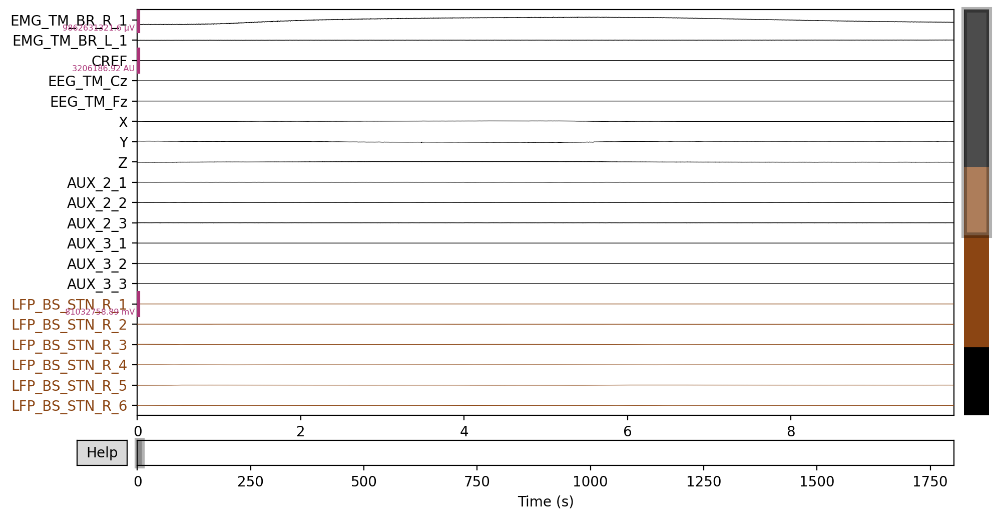

In [109]:
raw.plot(scalings='auto')

In [110]:
raw.ch_names

['CREF',
 'LFP_BS_STN_R_1',
 'LFP_BS_STN_R_2',
 'LFP_BS_STN_R_3',
 'LFP_BS_STN_R_4',
 'LFP_BS_STN_R_5',
 'LFP_BS_STN_R_6',
 'LFP_BS_STN_R_7',
 'LFP_BS_STN_R_8',
 'LFP_BS_STN_L_1',
 'LFP_BS_STN_L_2',
 'LFP_BS_STN_L_3',
 'LFP_BS_STN_L_4',
 'LFP_BS_STN_L_5',
 'LFP_BS_STN_L_6',
 'LFP_BS_STN_L_7',
 'LFP_BS_STN_L_8',
 'ECOG_AT_SM_L_1',
 'ECOG_AT_SM_L_2',
 'ECOG_AT_SM_L_3',
 'ECOG_AT_SM_L_4',
 'ECOG_AT_SM_L_5',
 'ECOG_AT_SM_L_6',
 'EEG_TM_Cz',
 'EEG_TM_Fz',
 'EMG_TM_BR_R_1',
 'EMG_TM_BR_L_1',
 'X',
 'Y',
 'Z',
 'AUX_2_1',
 'AUX_2_2',
 'AUX_2_3',
 'AUX_3_1',
 'AUX_3_2',
 'AUX_3_3']

In [111]:
new_chs =  ['CREF',
             'LFP_R_1_STN_BS',
            'LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_R_8_STN_BS',
             'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
             'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
            'ECOG_L_3_SMC_AT',
            'ECOG_L_4_SMC_AT',
            'ECOG_L_5_SMC_AT',
            'ECOG_L_6_SMC_AT',
             'EEG_Cz_TM',
             'EEG_Fz_TM',
             'EMG_R_BR_TM',
             'EMG_L_BR_TM',
             'ACC_R_X_D2_TM',
            'ACC_R_Y_D2_TM',
            'ACC_R_Z_D2_TM',
           'ACC_L_X_D2_TM',
            'ACC_L_Y_D2_TM',
            'ACC_L_Z_D2_TM',
             'ANALOG_R_ROTA_CH',
             'AUX_3_2',
             'AUX_3_3']

In [112]:
picks = ['LFP_R_1_STN_BS',
        'LFP_R_2_STN_BS',
        'LFP_R_3_STN_BS',
        'LFP_R_4_STN_BS',
        'LFP_R_5_STN_BS',
        'LFP_R_6_STN_BS',
        'LFP_R_7_STN_BS',
        'LFP_R_8_STN_BS',
        'LFP_L_1_STN_BS',
        'LFP_L_2_STN_BS',
        'LFP_L_3_STN_BS',
        'LFP_L_4_STN_BS',
        'LFP_L_5_STN_BS',
        'LFP_L_6_STN_BS',
        'LFP_L_7_STN_BS',
        'LFP_L_8_STN_BS',
        'ECOG_L_1_SMC_AT',
        'ECOG_L_2_SMC_AT',
        'ECOG_L_3_SMC_AT',
        'ECOG_L_4_SMC_AT',
        'ECOG_L_5_SMC_AT',
        'ECOG_L_6_SMC_AT',
        'EEG_Cz_TM',
        'EEG_Fz_TM',
        'EMG_R_BR_TM',
        'EMG_L_BR_TM',
        'ACC_R_X_D2_TM',
        'ACC_R_Y_D2_TM',
        'ACC_R_Z_D2_TM',
        'ACC_L_X_D2_TM',
        'ACC_L_Y_D2_TM',
        'ACC_L_Z_D2_TM']
raw = rename_chs(raw, new_chs, picks=picks)

ACC_L_X_D2_TM :  misc
ACC_L_Y_D2_TM :  misc
ACC_L_Z_D2_TM :  misc
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg


In [113]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOff01\ieeg\dummy.vhdr...
Setting channel info structure...
ACC_L_X_D2_TM :  misc
ACC_L_Y_D2_TM :  misc
ACC_L_Z_D2_TM :  misc
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizi

c:\users\richa\github\mne-bids\mne_bids\read.py:156: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '


Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOff01\ieeg\sub-004_ses-EphysMedOff01_task-RestTransition_acq-StimOff_run-02_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOff01\ieeg\sub-004_ses-EphysMedOff01_task-RestTransition_acq-StimOff_run-02_channels.tsv.


c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOff01_task-RestTransition_acq-StimOff_run-02.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\**\sub-004_ses-EphysMedOff01*events.tsv"
  warn(msg)


# Next

In [114]:
i = 53

In [115]:
raws[i]

<RawBrainVision | sub-004_ses-EphysMedOff01_task-Rest_acq-StimOff_run-01_ieeg.eeg, 36 x 1254431 (306.1 s), ~44 kB, data not loaded>

In [116]:
raw = raws[i]
file = files[i]

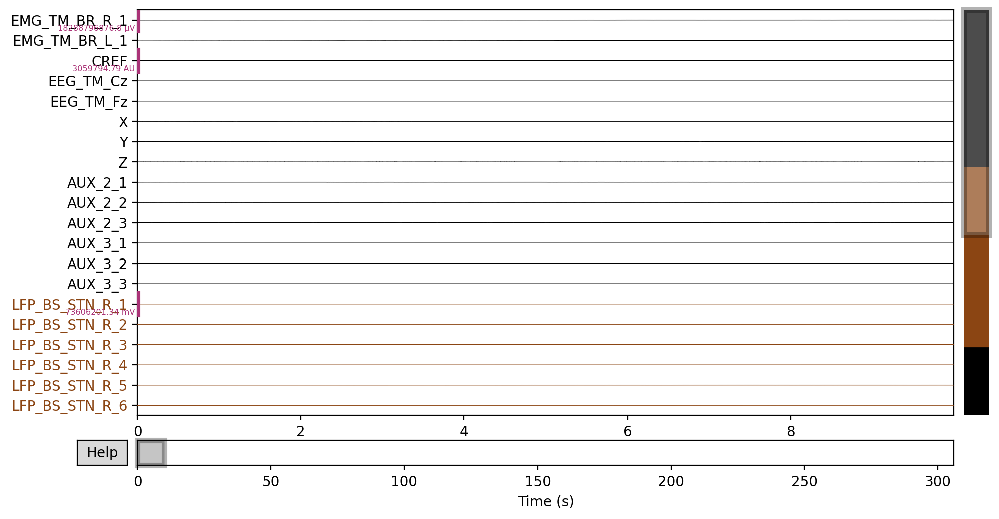

Channels marked as bad: none
Channels marked as bad: none


In [117]:
raw.plot(scalings='auto')

In [118]:
raw.ch_names

['CREF',
 'LFP_BS_STN_R_1',
 'LFP_BS_STN_R_2',
 'LFP_BS_STN_R_3',
 'LFP_BS_STN_R_4',
 'LFP_BS_STN_R_5',
 'LFP_BS_STN_R_6',
 'LFP_BS_STN_R_7',
 'LFP_BS_STN_R_8',
 'LFP_BS_STN_L_1',
 'LFP_BS_STN_L_2',
 'LFP_BS_STN_L_3',
 'LFP_BS_STN_L_4',
 'LFP_BS_STN_L_5',
 'LFP_BS_STN_L_6',
 'LFP_BS_STN_L_7',
 'LFP_BS_STN_L_8',
 'ECOG_AT_SM_L_1',
 'ECOG_AT_SM_L_2',
 'ECOG_AT_SM_L_3',
 'ECOG_AT_SM_L_4',
 'ECOG_AT_SM_L_5',
 'ECOG_AT_SM_L_6',
 'EEG_TM_Cz',
 'EEG_TM_Fz',
 'EMG_TM_BR_R_1',
 'EMG_TM_BR_L_1',
 'X',
 'Y',
 'Z',
 'AUX_2_1',
 'AUX_2_2',
 'AUX_2_3',
 'AUX_3_1',
 'AUX_3_2',
 'AUX_3_3']

In [119]:
new_chs =  ['CREF',
             'LFP_R_1_STN_BS',
            'LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_R_8_STN_BS',
             'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
             'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
            'ECOG_L_3_SMC_AT',
            'ECOG_L_4_SMC_AT',
            'ECOG_L_5_SMC_AT',
            'ECOG_L_6_SMC_AT',
             'EEG_Cz_TM',
             'EEG_Fz_TM',
             'EMG_R_BR_TM',
             'EMG_L_BR_TM',
             'ACC_R_X_D2_TM',
            'ACC_R_Y_D2_TM',
            'ACC_R_Z_D2_TM',
           'ACC_L_X_D2_TM',
            'ACC_L_Y_D2_TM',
            'ACC_L_Z_D2_TM',
             'ANALOG_R_ROTA_CH',
             'AUX_3_2',
             'AUX_3_3']

In [120]:
picks = ['LFP_R_1_STN_BS',
        'LFP_R_2_STN_BS',
        'LFP_R_3_STN_BS',
        'LFP_R_4_STN_BS',
        'LFP_R_5_STN_BS',
        'LFP_R_6_STN_BS',
        'LFP_R_7_STN_BS',
        'LFP_R_8_STN_BS',
        'LFP_L_1_STN_BS',
        'LFP_L_2_STN_BS',
        'LFP_L_3_STN_BS',
        'LFP_L_4_STN_BS',
        'LFP_L_5_STN_BS',
        'LFP_L_6_STN_BS',
        'LFP_L_7_STN_BS',
        'LFP_L_8_STN_BS',
        'ECOG_L_1_SMC_AT',
        'ECOG_L_2_SMC_AT',
        'ECOG_L_3_SMC_AT',
        'ECOG_L_4_SMC_AT',
        'ECOG_L_5_SMC_AT',
        'ECOG_L_6_SMC_AT',
        'EEG_Cz_TM',
        'EEG_Fz_TM',
        'EMG_R_BR_TM',
        'EMG_L_BR_TM',
        'ACC_R_X_D2_TM',
        'ACC_R_Y_D2_TM',
        'ACC_R_Z_D2_TM',
        'ACC_L_X_D2_TM',
        'ACC_L_Y_D2_TM',
        'ACC_L_Z_D2_TM']
raw = rename_chs(raw, new_chs, picks=picks)

ACC_L_X_D2_TM :  misc
ACC_L_Y_D2_TM :  misc
ACC_L_Z_D2_TM :  misc
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg


In [121]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOff01\ieeg\dummy.vhdr...
Setting channel info structure...
ACC_L_X_D2_TM :  misc
ACC_L_Y_D2_TM :  misc
ACC_L_Z_D2_TM :  misc
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizi

c:\users\richa\github\mne-bids\mne_bids\read.py:156: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '


Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOff01\ieeg\sub-004_ses-EphysMedOff01_task-Rest_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOff01\ieeg\sub-004_ses-EphysMedOff01_task-Rest_acq-StimOff_run-01_channels.tsv.


c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOff01_task-Rest_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\**\sub-004_ses-EphysMedOff01*events.tsv"
  warn(msg)


# Next

In [123]:
i = 54

In [124]:
raws[i]

<RawBrainVision | sub-004_ses-EphysMedOff01_task-Rest_acq-StimOff_run-02_ieeg.eeg, 36 x 770696 (188.0 s), ~44 kB, data not loaded>

In [125]:
raw = raws[i]
file = files[i]

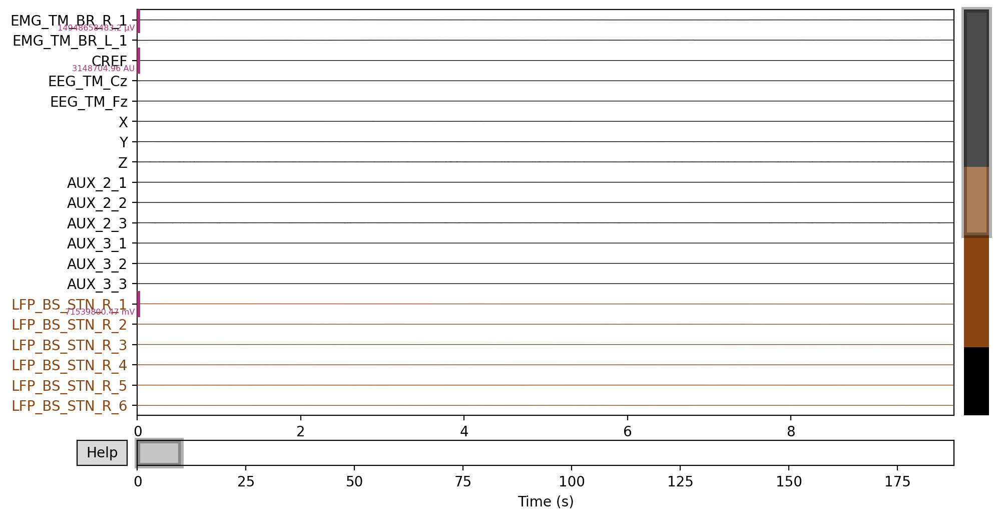

Channels marked as bad: none


In [126]:
raw.plot(scalings='auto')

In [127]:
raw.ch_names

['CREF',
 'LFP_BS_STN_R_1',
 'LFP_BS_STN_R_2',
 'LFP_BS_STN_R_3',
 'LFP_BS_STN_R_4',
 'LFP_BS_STN_R_5',
 'LFP_BS_STN_R_6',
 'LFP_BS_STN_R_7',
 'LFP_BS_STN_R_8',
 'LFP_BS_STN_L_1',
 'LFP_BS_STN_L_2',
 'LFP_BS_STN_L_3',
 'LFP_BS_STN_L_4',
 'LFP_BS_STN_L_5',
 'LFP_BS_STN_L_6',
 'LFP_BS_STN_L_7',
 'LFP_BS_STN_L_8',
 'ECOG_AT_SM_L_1',
 'ECOG_AT_SM_L_2',
 'ECOG_AT_SM_L_3',
 'ECOG_AT_SM_L_4',
 'ECOG_AT_SM_L_5',
 'ECOG_AT_SM_L_6',
 'EEG_TM_Cz',
 'EEG_TM_Fz',
 'EMG_TM_BR_R_1',
 'EMG_TM_BR_L_1',
 'X',
 'Y',
 'Z',
 'AUX_2_1',
 'AUX_2_2',
 'AUX_2_3',
 'AUX_3_1',
 'AUX_3_2',
 'AUX_3_3']

In [129]:
new_chs =  ['REF_MASTOID',
             'LFP_R_1_STN_BS',
            'LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_R_8_STN_BS',
             'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
             'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
            'ECOG_L_3_SMC_AT',
            'ECOG_L_4_SMC_AT',
            'ECOG_L_5_SMC_AT',
            'ECOG_L_6_SMC_AT',
             'EEG_Cz_TM',
             'EEG_Fz_TM',
             'EMG_R_BR_TM',
             'EMG_L_BR_TM',
             'ACC_R_X_D2_TM',
            'ACC_R_Y_D2_TM',
            'ACC_R_Z_D2_TM',
           'ACC_L_X_D2_TM',
            'ACC_L_Y_D2_TM',
            'ACC_L_Z_D2_TM',
             'ANALOG_R_ROTA_CH',
             'AUX_3_2',
             'AUX_3_3']

In [130]:
picks = ['REF_MASTOID',
        'LFP_R_1_STN_BS',
        'LFP_R_2_STN_BS',
        'LFP_R_3_STN_BS',
        'LFP_R_4_STN_BS',
        'LFP_R_5_STN_BS',
        'LFP_R_6_STN_BS',
        'LFP_R_7_STN_BS',
        'LFP_R_8_STN_BS',
        'LFP_L_1_STN_BS',
        'LFP_L_2_STN_BS',
        'LFP_L_3_STN_BS',
        'LFP_L_4_STN_BS',
        'LFP_L_5_STN_BS',
        'LFP_L_6_STN_BS',
        'LFP_L_7_STN_BS',
        'LFP_L_8_STN_BS',
        'ECOG_L_1_SMC_AT',
        'ECOG_L_2_SMC_AT',
        'ECOG_L_3_SMC_AT',
        'ECOG_L_4_SMC_AT',
        'ECOG_L_5_SMC_AT',
        'ECOG_L_6_SMC_AT',
        'EEG_Cz_TM',
        'EEG_Fz_TM',
        'EMG_R_BR_TM',
        'EMG_L_BR_TM',
        'ACC_R_X_D2_TM',
        'ACC_R_Y_D2_TM',
        'ACC_R_Z_D2_TM',
        'ACC_L_X_D2_TM',
        'ACC_L_Y_D2_TM',
        'ACC_L_Z_D2_TM']
raw = rename_chs(raw, new_chs, picks=picks)

ACC_L_X_D2_TM :  misc
ACC_L_Y_D2_TM :  misc
ACC_L_Z_D2_TM :  misc
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
REF_MASTOID :  misc


In [131]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOff01\ieeg\dummy.vhdr...
Setting channel info structure...
ACC_L_X_D2_TM :  misc
ACC_L_Y_D2_TM :  misc
ACC_L_Z_D2_TM :  misc
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
REF_MASTOID :  misc
Extracting parameters from C:\Users\richa\OneDrive - Charité 

c:\users\richa\github\mne-bids\mne_bids\read.py:156: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '


Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOff01\ieeg\sub-004_ses-EphysMedOff01_task-Rest_acq-StimOff_run-02_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOff01\ieeg\sub-004_ses-EphysMedOff01_task-Rest_acq-StimOff_run-02_channels.tsv.


c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOff01_task-Rest_acq-StimOff_run-02.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\**\sub-004_ses-EphysMedOff01*events.tsv"
  warn(msg)


# Next

In [132]:
i = 55

In [133]:
raws[i]

<RawBrainVision | sub-004_ses-EphysMedOff01_task-SelfpacedRotationL_acq-StimOff_run-01_ieeg.eeg, 36 x 1449521 (353.7 s), ~44 kB, data not loaded>

In [134]:
raw = raws[i]
file = files[i]

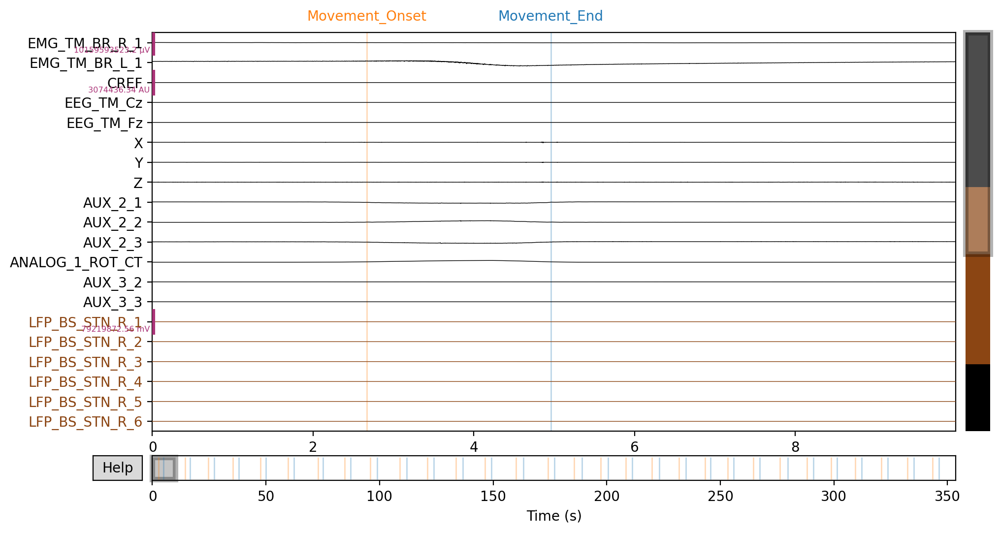

Channels marked as bad: none


In [135]:
raw.plot(scalings='auto')

In [136]:
raw.ch_names

['CREF',
 'LFP_BS_STN_R_1',
 'LFP_BS_STN_R_2',
 'LFP_BS_STN_R_3',
 'LFP_BS_STN_R_4',
 'LFP_BS_STN_R_5',
 'LFP_BS_STN_R_6',
 'LFP_BS_STN_R_7',
 'LFP_BS_STN_R_8',
 'LFP_BS_STN_L_1',
 'LFP_BS_STN_L_2',
 'LFP_BS_STN_L_3',
 'LFP_BS_STN_L_4',
 'LFP_BS_STN_L_5',
 'LFP_BS_STN_L_6',
 'LFP_BS_STN_L_7',
 'LFP_BS_STN_L_8',
 'ECOG_AT_SM_L_1',
 'ECOG_AT_SM_L_2',
 'ECOG_AT_SM_L_3',
 'ECOG_AT_SM_L_4',
 'ECOG_AT_SM_L_5',
 'ECOG_AT_SM_L_6',
 'EEG_TM_Cz',
 'EEG_TM_Fz',
 'EMG_TM_BR_R_1',
 'EMG_TM_BR_L_1',
 'X',
 'Y',
 'Z',
 'AUX_2_1',
 'AUX_2_2',
 'AUX_2_3',
 'ANALOG_1_ROT_CT',
 'AUX_3_2',
 'AUX_3_3']

In [137]:
new_chs =  ['CREF',
            'LFP_R_1_STN_BS',
            'LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_R_8_STN_BS',
            'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
            'ECOG_L_3_SMC_AT',
            'ECOG_L_4_SMC_AT',
            'ECOG_L_5_SMC_AT',
            'ECOG_L_6_SMC_AT',
             'EEG_Cz_TM',
             'EEG_Fz_TM',
             'EMG_R_BR_TM',
             'EMG_L_BR_TM',
             'ACC_R_X_D2_TM',
            'ACC_R_Y_D2_TM',
            'ACC_R_Z_D2_TM',
            'ACC_L_X_D2_TM',
            'ACC_L_Y_D2_TM',
            'ACC_L_Z_D2_TM',
             'ANALOG_L_ROTA_CH',
             'AUX_3_2',
             'AUX_3_3']

In [138]:
picks = ['LFP_R_1_STN_BS',
        'LFP_R_2_STN_BS',
        'LFP_R_3_STN_BS',
        'LFP_R_4_STN_BS',
        'LFP_R_5_STN_BS',
        'LFP_R_6_STN_BS',
        'LFP_R_7_STN_BS',
        'LFP_R_8_STN_BS',
        'LFP_L_1_STN_BS',
        'LFP_L_2_STN_BS',
        'LFP_L_3_STN_BS',
        'LFP_L_4_STN_BS',
        'LFP_L_5_STN_BS',
        'LFP_L_6_STN_BS',
        'LFP_L_7_STN_BS',
        'LFP_L_8_STN_BS',
        'ECOG_L_1_SMC_AT',
        'ECOG_L_2_SMC_AT',
        'ECOG_L_3_SMC_AT',
        'ECOG_L_4_SMC_AT',
        'ECOG_L_5_SMC_AT',
        'ECOG_L_6_SMC_AT',
        'EEG_Cz_TM',
        'EEG_Fz_TM',
        'EMG_R_BR_TM',
        'EMG_L_BR_TM',
        'ACC_R_X_D2_TM',
        'ACC_R_Y_D2_TM',
        'ACC_R_Z_D2_TM',
        'ACC_L_X_D2_TM',
        'ACC_L_Y_D2_TM',
        'ACC_L_Z_D2_TM',
        'ANALOG_L_ROTA_CH']
raw = rename_chs(raw, new_chs, picks=picks)

ACC_L_X_D2_TM :  misc
ACC_L_Y_D2_TM :  misc
ACC_L_Z_D2_TM :  misc
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc
ANALOG_L_ROTA_C :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg


In [139]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Used Annotations descriptions: ['Movement_End', 'Movement_Onset']
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOff01\ieeg\dummy.vhdr...
Setting channel info structure...
ACC_L_X_D2_TM :  misc
ACC_L_Y_D2_TM :  misc
ACC_L_Z_D2_TM :  misc
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc
ANALOG_L_ROTA_C :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS

# Next

In [168]:
i = 56

In [169]:
raws[i]

<RawBrainVision | sub-004_ses-EphysMedOff01_task-SelfpacedRotationR_acq-StimOff_run-01_ieeg.eeg, 36 x 2103146 (513.2 s), ~44 kB, data not loaded>

In [170]:
raw = raws[i]
file = files[i]

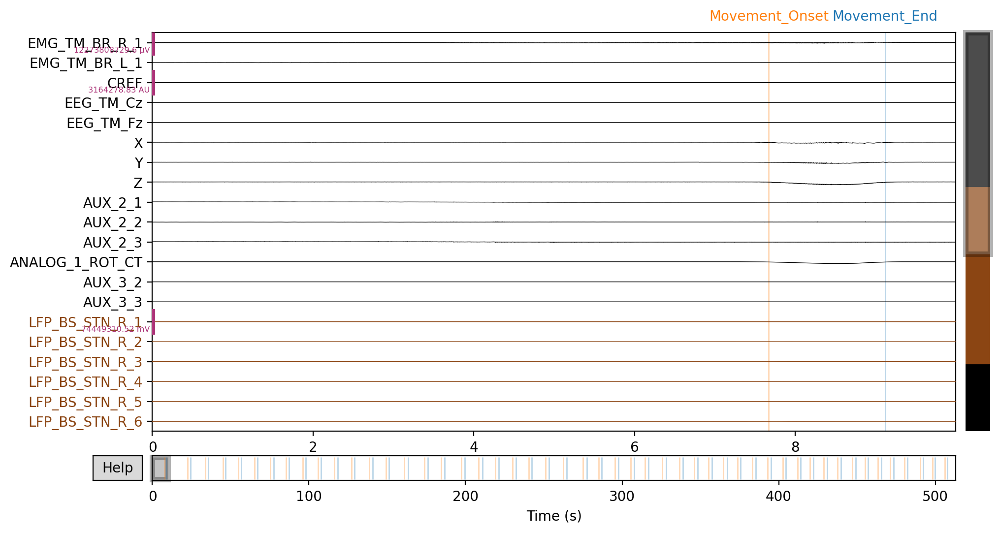

Channels marked as bad: none


In [172]:
raw.plot(scalings='auto')

In [173]:
raw.ch_names

['CREF',
 'LFP_BS_STN_R_1',
 'LFP_BS_STN_R_2',
 'LFP_BS_STN_R_3',
 'LFP_BS_STN_R_4',
 'LFP_BS_STN_R_5',
 'LFP_BS_STN_R_6',
 'LFP_BS_STN_R_7',
 'LFP_BS_STN_R_8',
 'LFP_BS_STN_L_1',
 'LFP_BS_STN_L_2',
 'LFP_BS_STN_L_3',
 'LFP_BS_STN_L_4',
 'LFP_BS_STN_L_5',
 'LFP_BS_STN_L_6',
 'LFP_BS_STN_L_7',
 'LFP_BS_STN_L_8',
 'ECOG_AT_SM_L_1',
 'ECOG_AT_SM_L_2',
 'ECOG_AT_SM_L_3',
 'ECOG_AT_SM_L_4',
 'ECOG_AT_SM_L_5',
 'ECOG_AT_SM_L_6',
 'EEG_TM_Cz',
 'EEG_TM_Fz',
 'EMG_TM_BR_R_1',
 'EMG_TM_BR_L_1',
 'X',
 'Y',
 'Z',
 'AUX_2_1',
 'AUX_2_2',
 'AUX_2_3',
 'ANALOG_1_ROT_CT',
 'AUX_3_2',
 'AUX_3_3']

In [174]:
new_chs =  ['CREF',
            'LFP_R_1_STN_BS',
            'LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_R_8_STN_BS',
            'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
            'ECOG_L_3_SMC_AT',
            'ECOG_L_4_SMC_AT',
            'ECOG_L_5_SMC_AT',
            'ECOG_L_6_SMC_AT',
             'EEG_Cz_TM',
             'EEG_Fz_TM',
             'EMG_R_BR_TM',
             'EMG_L_BR_TM',
             'ACC_R_X_D2_TM',
            'ACC_R_Y_D2_TM',
            'ACC_R_Z_D2_TM',
            'ACC_L_X_D2_TM',
            'ACC_L_Y_D2_TM',
            'ACC_L_Z_D2_TM',
             'ANALOG_R_ROTA_CH',
             'AUX_3_2',
             'AUX_3_3']

In [175]:
picks = ['LFP_R_1_STN_BS',
        'LFP_R_2_STN_BS',
        'LFP_R_3_STN_BS',
        'LFP_R_4_STN_BS',
        'LFP_R_5_STN_BS',
        'LFP_R_6_STN_BS',
        'LFP_R_7_STN_BS',
        'LFP_R_8_STN_BS',
        'LFP_L_1_STN_BS',
        'LFP_L_2_STN_BS',
        'LFP_L_3_STN_BS',
        'LFP_L_4_STN_BS',
        'LFP_L_5_STN_BS',
        'LFP_L_6_STN_BS',
        'LFP_L_7_STN_BS',
        'LFP_L_8_STN_BS',
        'ECOG_L_1_SMC_AT',
        'ECOG_L_2_SMC_AT',
        'ECOG_L_3_SMC_AT',
        'ECOG_L_4_SMC_AT',
        'ECOG_L_5_SMC_AT',
        'ECOG_L_6_SMC_AT',
        'EEG_Cz_TM',
        'EEG_Fz_TM',
        'EMG_R_BR_TM',
        'EMG_L_BR_TM',
        'ACC_R_X_D2_TM',
        'ACC_R_Y_D2_TM',
        'ACC_R_Z_D2_TM',
        'ACC_L_X_D2_TM',
        'ACC_L_Y_D2_TM',
        'ACC_L_Z_D2_TM',
        'ANALOG_R_ROTA_CH']
raw = rename_chs(raw, new_chs, picks=picks)

ACC_L_X_D2_TM :  misc
ACC_L_Y_D2_TM :  misc
ACC_L_Z_D2_TM :  misc
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc
ANALOG_R_ROTA_C :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg


In [176]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Used Annotations descriptions: ['Movement_End', 'Movement_Onset']
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOff01\ieeg\dummy.vhdr...
Setting channel info structure...
ACC_L_X_D2_TM :  misc
ACC_L_Y_D2_TM :  misc
ACC_L_Z_D2_TM :  misc
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc
ANALOG_R_ROTA_C :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS

# Next

In [177]:
i = 57

In [178]:
raws[i]

<RawBrainVision | sub-004_ses-EphysMedOff01_task-Speech_acq-StimOff_run-01_ieeg.eeg, 36 x 346496 (84.5 s), ~44 kB, data not loaded>

In [179]:
raw = raws[i]
file = files[i]

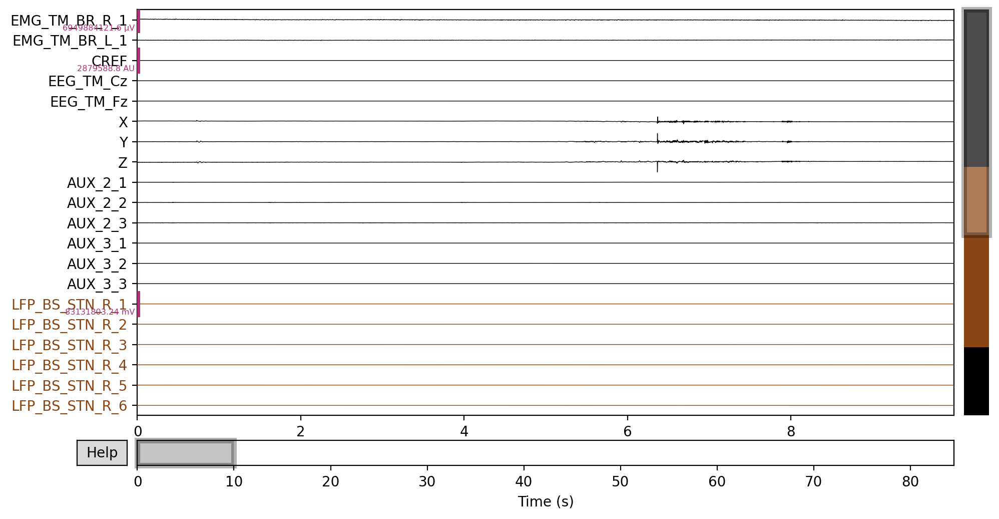

Channels marked as bad: none


In [180]:
raw.plot(scalings='auto')

In [181]:
raw.ch_names

['CREF',
 'LFP_BS_STN_R_1',
 'LFP_BS_STN_R_2',
 'LFP_BS_STN_R_3',
 'LFP_BS_STN_R_4',
 'LFP_BS_STN_R_5',
 'LFP_BS_STN_R_6',
 'LFP_BS_STN_R_7',
 'LFP_BS_STN_R_8',
 'LFP_BS_STN_L_1',
 'LFP_BS_STN_L_2',
 'LFP_BS_STN_L_3',
 'LFP_BS_STN_L_4',
 'LFP_BS_STN_L_5',
 'LFP_BS_STN_L_6',
 'LFP_BS_STN_L_7',
 'LFP_BS_STN_L_8',
 'ECOG_AT_SM_L_1',
 'ECOG_AT_SM_L_2',
 'ECOG_AT_SM_L_3',
 'ECOG_AT_SM_L_4',
 'ECOG_AT_SM_L_5',
 'ECOG_AT_SM_L_6',
 'EEG_TM_Cz',
 'EEG_TM_Fz',
 'EMG_TM_BR_R_1',
 'EMG_TM_BR_L_1',
 'X',
 'Y',
 'Z',
 'AUX_2_1',
 'AUX_2_2',
 'AUX_2_3',
 'AUX_3_1',
 'AUX_3_2',
 'AUX_3_3']

In [182]:
new_chs =  ['CREF',
            'LFP_R_1_STN_BS',
            'LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_R_8_STN_BS',
            'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
            'ECOG_L_3_SMC_AT',
            'ECOG_L_4_SMC_AT',
            'ECOG_L_5_SMC_AT',
            'ECOG_L_6_SMC_AT',
             'EEG_Cz_TM',
             'EEG_Fz_TM',
             'EMG_R_BR_TM',
             'EMG_L_BR_TM',
             'ACC_R_X_D2_TM',
            'ACC_R_Y_D2_TM',
            'ACC_R_Z_D2_TM',
            'ACC_L_X_D2_TM',
            'ACC_L_Y_D2_TM',
            'ACC_L_Z_D2_TM',
             'ANALOG_L_ROTA_CH',
             'AUX_3_2',
             'AUX_3_3']

In [183]:
picks = ['LFP_R_1_STN_BS',
        'LFP_R_2_STN_BS',
        'LFP_R_3_STN_BS',
        'LFP_R_4_STN_BS',
        'LFP_R_5_STN_BS',
        'LFP_R_6_STN_BS',
        'LFP_R_7_STN_BS',
        'LFP_R_8_STN_BS',
        'LFP_L_1_STN_BS',
        'LFP_L_2_STN_BS',
        'LFP_L_3_STN_BS',
        'LFP_L_4_STN_BS',
        'LFP_L_5_STN_BS',
        'LFP_L_6_STN_BS',
        'LFP_L_7_STN_BS',
        'LFP_L_8_STN_BS',
        'ECOG_L_1_SMC_AT',
        'ECOG_L_2_SMC_AT',
        'ECOG_L_3_SMC_AT',
        'ECOG_L_4_SMC_AT',
        'ECOG_L_5_SMC_AT',
        'ECOG_L_6_SMC_AT',
        'EEG_Cz_TM',
        'EEG_Fz_TM',
        'EMG_R_BR_TM',
        'EMG_L_BR_TM',
        'ACC_R_X_D2_TM',
        'ACC_R_Y_D2_TM',
        'ACC_R_Z_D2_TM',
        'ACC_L_X_D2_TM',
        'ACC_L_Y_D2_TM',
        'ACC_L_Z_D2_TM']
raw = rename_chs(raw, new_chs, picks=picks)

ACC_L_X_D2_TM :  misc
ACC_L_Y_D2_TM :  misc
ACC_L_Z_D2_TM :  misc
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg


In [184]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOff01\ieeg\dummy.vhdr...
Setting channel info structure...
ACC_L_X_D2_TM :  misc
ACC_L_Y_D2_TM :  misc
ACC_L_Z_D2_TM :  misc
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizi

c:\users\richa\github\mne-bids\mne_bids\read.py:156: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '


Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOff01\ieeg\sub-004_ses-EphysMedOff01_task-Speech_acq-StimOff_run-01_channels.tsv.


c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOff01_task-Speech_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\**\sub-004_ses-EphysMedOff01*events.tsv"
  warn(msg)


# Next

In [185]:
i = 58

In [186]:
raws[i]

<RawBrainVision | sub-004_ses-EphysMedOff01_task-UPDRSIII_acq-StimOff_run-01_ieeg.eeg, 36 x 1005791 (245.4 s), ~44 kB, data not loaded>

In [187]:
raw = raws[i]
file = files[i]

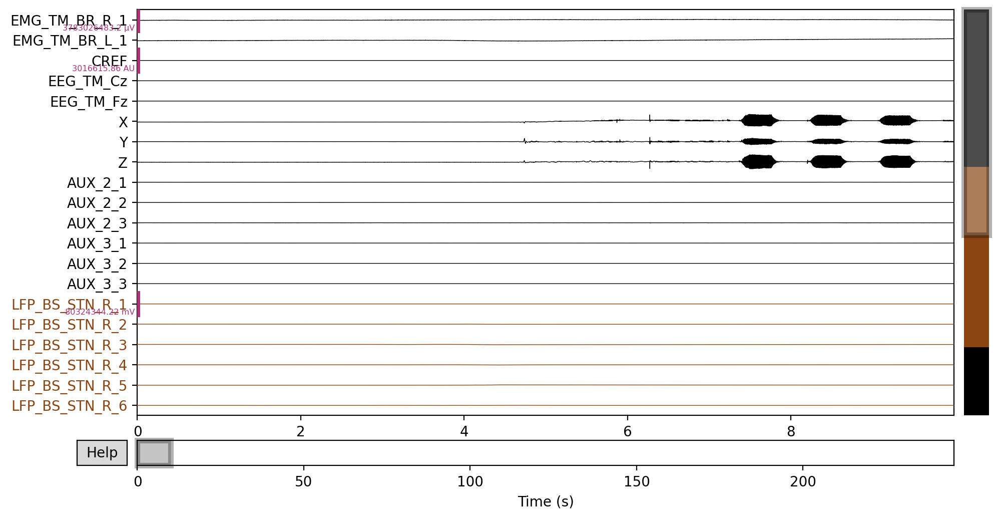

Channels marked as bad: none


In [188]:
raw.plot(scalings='auto')

In [189]:
raw.ch_names

['CREF',
 'LFP_BS_STN_R_1',
 'LFP_BS_STN_R_2',
 'LFP_BS_STN_R_3',
 'LFP_BS_STN_R_4',
 'LFP_BS_STN_R_5',
 'LFP_BS_STN_R_6',
 'LFP_BS_STN_R_7',
 'LFP_BS_STN_R_8',
 'LFP_BS_STN_L_1',
 'LFP_BS_STN_L_2',
 'LFP_BS_STN_L_3',
 'LFP_BS_STN_L_4',
 'LFP_BS_STN_L_5',
 'LFP_BS_STN_L_6',
 'LFP_BS_STN_L_7',
 'LFP_BS_STN_L_8',
 'ECOG_AT_SM_L_1',
 'ECOG_AT_SM_L_2',
 'ECOG_AT_SM_L_3',
 'ECOG_AT_SM_L_4',
 'ECOG_AT_SM_L_5',
 'ECOG_AT_SM_L_6',
 'EEG_TM_Cz',
 'EEG_TM_Fz',
 'EMG_TM_BR_R_1',
 'EMG_TM_BR_L_1',
 'X',
 'Y',
 'Z',
 'AUX_2_1',
 'AUX_2_2',
 'AUX_2_3',
 'AUX_3_1',
 'AUX_3_2',
 'AUX_3_3']

In [190]:
new_chs =  ['CREF',
            'LFP_R_1_STN_BS',
            'LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_R_8_STN_BS',
            'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
            'ECOG_L_3_SMC_AT',
            'ECOG_L_4_SMC_AT',
            'ECOG_L_5_SMC_AT',
            'ECOG_L_6_SMC_AT',
             'EEG_Cz_TM',
             'EEG_Fz_TM',
             'EMG_R_BR_TM',
             'EMG_L_BR_TM',
             'ACC_R_X_D2_TM',
            'ACC_R_Y_D2_TM',
            'ACC_R_Z_D2_TM',
            'ACC_L_X_D2_TM',
            'ACC_L_Y_D2_TM',
            'ACC_L_Z_D2_TM',
             'ANALOG_L_ROTA_CH',
             'AUX_3_2',
             'AUX_3_3']

In [191]:
picks = ['LFP_R_1_STN_BS',
        'LFP_R_2_STN_BS',
        'LFP_R_3_STN_BS',
        'LFP_R_4_STN_BS',
        'LFP_R_5_STN_BS',
        'LFP_R_6_STN_BS',
        'LFP_R_7_STN_BS',
        'LFP_R_8_STN_BS',
        'LFP_L_1_STN_BS',
        'LFP_L_2_STN_BS',
        'LFP_L_3_STN_BS',
        'LFP_L_4_STN_BS',
        'LFP_L_5_STN_BS',
        'LFP_L_6_STN_BS',
        'LFP_L_7_STN_BS',
        'LFP_L_8_STN_BS',
        'ECOG_L_1_SMC_AT',
        'ECOG_L_2_SMC_AT',
        'ECOG_L_3_SMC_AT',
        'ECOG_L_4_SMC_AT',
        'ECOG_L_5_SMC_AT',
        'ECOG_L_6_SMC_AT',
        'EEG_Cz_TM',
        'EEG_Fz_TM',
        'EMG_R_BR_TM',
        'EMG_L_BR_TM',
        'ACC_R_X_D2_TM',
        'ACC_R_Y_D2_TM',
        'ACC_R_Z_D2_TM',
        'ACC_L_X_D2_TM',
        'ACC_L_Y_D2_TM',
        'ACC_L_Z_D2_TM']
raw = rename_chs(raw, new_chs, picks=picks)

ACC_L_X_D2_TM :  misc
ACC_L_Y_D2_TM :  misc
ACC_L_Z_D2_TM :  misc
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg


In [192]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOff01\ieeg\dummy.vhdr...
Setting channel info structure...
ACC_L_X_D2_TM :  misc
ACC_L_Y_D2_TM :  misc
ACC_L_Z_D2_TM :  misc
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizi

c:\users\richa\github\mne-bids\mne_bids\read.py:156: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '


Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOff01\ieeg\sub-004_ses-EphysMedOff01_task-UPDRSIII_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOff01\ieeg\sub-004_ses-EphysMedOff01_task-UPDRSIII_acq-StimOff_run-01_channels.tsv.


c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOff01_task-UPDRSIII_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\**\sub-004_ses-EphysMedOff01*events.tsv"
  warn(msg)


# Next

In [203]:
i = 59

In [204]:
raws[i]

<RawBrainVision | sub-004_ses-EphysMedOn01_task-BlockRotationL_acq-StimOff_run-01_ieeg.eeg, 33 x 1207706 (294.7 s), ~41 kB, data not loaded>

In [205]:
raw = raws[i]
file = files[i]
raw = mne_bids.read_raw_bids(file)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-BlockRotationL_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-BlockRotationL_acq-StimOff_run-01_channels.tsv.


c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOn01_task-BlockRotationL_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\**\sub-004_ses-EphysMedOn01*events.tsv"
  warn(msg)


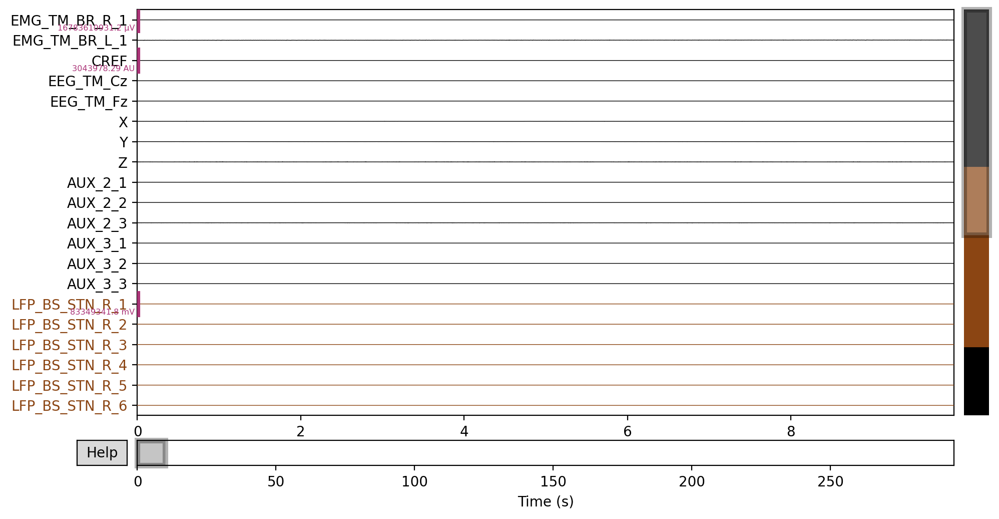

Channels marked as bad: ['AUX_2_1', 'AUX_2_2', 'AUX_2_3', 'AUX_3_2', 'AUX_3_3']


In [206]:
raw.plot(scalings='auto')

In [207]:
raw.ch_names

['CREF',
 'LFP_BS_STN_R_1',
 'LFP_BS_STN_R_2',
 'LFP_BS_STN_R_3',
 'LFP_BS_STN_R_4',
 'LFP_BS_STN_R_5',
 'LFP_BS_STN_R_6',
 'LFP_BS_STN_R_7',
 'LFP_BS_STN_R_8',
 'LFP_BS_STN_L_1',
 'LFP_BS_STN_L_2',
 'LFP_BS_STN_L_3',
 'LFP_BS_STN_L_4',
 'LFP_BS_STN_L_5',
 'LFP_BS_STN_L_6',
 'LFP_BS_STN_L_7',
 'LFP_BS_STN_L_8',
 'ECOG_AT_SM_L_1',
 'ECOG_AT_SM_L_2',
 'ECOG_AT_SM_L_3',
 'ECOG_AT_SM_L_4',
 'ECOG_AT_SM_L_5',
 'ECOG_AT_SM_L_6',
 'EEG_TM_Cz',
 'EEG_TM_Fz',
 'EMG_TM_BR_R_1',
 'EMG_TM_BR_L_1',
 'X',
 'Y',
 'Z',
 'AUX_2_1',
 'AUX_2_2',
 'AUX_2_3',
 'AUX_3_1',
 'AUX_3_2',
 'AUX_3_3']

In [208]:
new_chs =  ['CREF',
            'LFP_R_1_STN_BS',
            'LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_R_8_STN_BS',
            'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
            'ECOG_L_3_SMC_AT',
            'ECOG_L_4_SMC_AT',
            'ECOG_L_5_SMC_AT',
            'ECOG_L_6_SMC_AT',
             'EEG_Cz_TM',
             'EEG_Fz_TM',
             'EMG_R_BR_TM',
             'EMG_L_BR_TM',
             'ACC_R_X_D2_TM',
            'ACC_R_Y_D2_TM',
            'ACC_R_Z_D2_TM',
            'ACC_L_X_D2_TM',
            'ACC_L_Y_D2_TM',
            'ACC_L_Z_D2_TM',
             'ANALOG_L_ROTA_CH',
             'AUX_3_2',
             'AUX_3_3']

In [209]:
picks = ['LFP_R_1_STN_BS',
        'LFP_R_2_STN_BS',
        'LFP_R_3_STN_BS',
        'LFP_R_4_STN_BS',
        'LFP_R_5_STN_BS',
        'LFP_R_6_STN_BS',
        'LFP_R_7_STN_BS',
        'LFP_R_8_STN_BS',
        'LFP_L_1_STN_BS',
        'LFP_L_2_STN_BS',
        'LFP_L_3_STN_BS',
        'LFP_L_4_STN_BS',
        'LFP_L_5_STN_BS',
        'LFP_L_6_STN_BS',
        'LFP_L_7_STN_BS',
        'LFP_L_8_STN_BS',
        'ECOG_L_1_SMC_AT',
        'ECOG_L_2_SMC_AT',
        'ECOG_L_3_SMC_AT',
        'ECOG_L_4_SMC_AT',
        'ECOG_L_5_SMC_AT',
        'ECOG_L_6_SMC_AT',
        'EEG_Cz_TM',
        'EEG_Fz_TM',
        'EMG_R_BR_TM',
        'EMG_L_BR_TM',
        'ACC_R_X_D2_TM',
        'ACC_R_Y_D2_TM',
        'ACC_R_Z_D2_TM',
        'ACC_L_X_D2_TM',
        'ACC_L_Y_D2_TM',
        'ACC_L_Z_D2_TM',
        'ANALOG_L_ROTA_CH']
raw = rename_chs(raw, new_chs, picks=picks)

ACC_L_X_D2_TM :  misc
ACC_L_Y_D2_TM :  misc
ACC_L_Z_D2_TM :  misc
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc
ANALOG_L_ROTA_C :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg


In [210]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn01\ieeg\dummy.vhdr...
Setting channel info structure...
ACC_L_X_D2_TM :  misc
ACC_L_Y_D2_TM :  misc
ACC_L_Z_D2_TM :  misc
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc
ANALOG_L_ROTA_C :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
Extracting parameters from C:\Users\richa\OneDrive - Chari

c:\users\richa\github\mne-bids\mne_bids\read.py:156: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '


Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-BlockRotationL_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-BlockRotationL_acq-StimOff_run-01_channels.tsv.


c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOn01_task-BlockRotationL_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\**\sub-004_ses-EphysMedOn01*events.tsv"
  warn(msg)


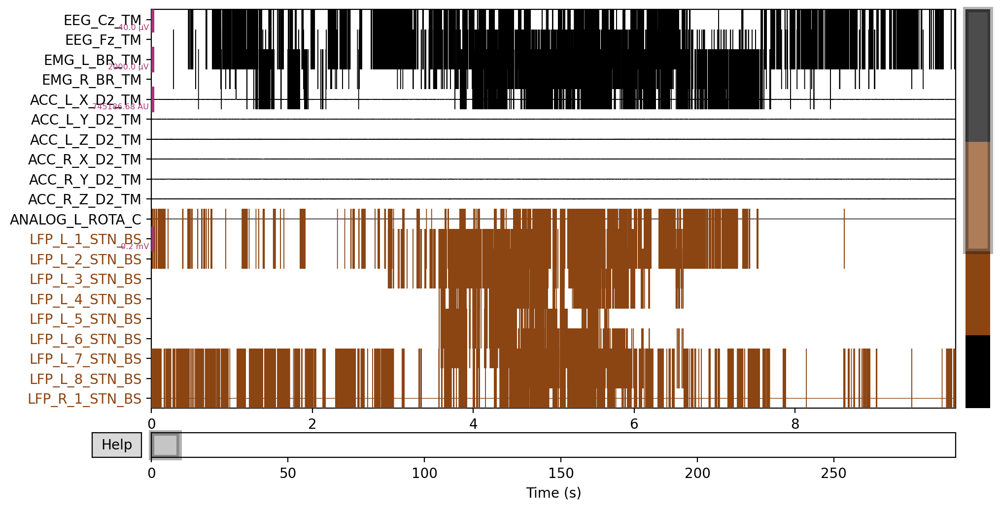

Channels marked as bad: ['LFP_L_1_STN_BS', 'LFP_L_2_STN_BS', 'LFP_L_3_STN_BS', 'LFP_L_4_STN_BS']


In [211]:
test_raw.plot()

# Next

In [212]:
i = 60

In [213]:
raws[i]

<RawBrainVision | sub-004_ses-EphysMedOn01_task-BlockRotationR_acq-StimOff_run-01_ieeg.eeg, 36 x 1183136 (288.7 s), ~44 kB, data not loaded>

In [214]:
raw = raws[i]
file = files[i]
raw = mne_bids.read_raw_bids(file)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-BlockRotationR_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-BlockRotationR_acq-StimOff_run-01_channels.tsv.


c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOn01_task-BlockRotationR_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\**\sub-004_ses-EphysMedOn01*events.tsv"
  warn(msg)


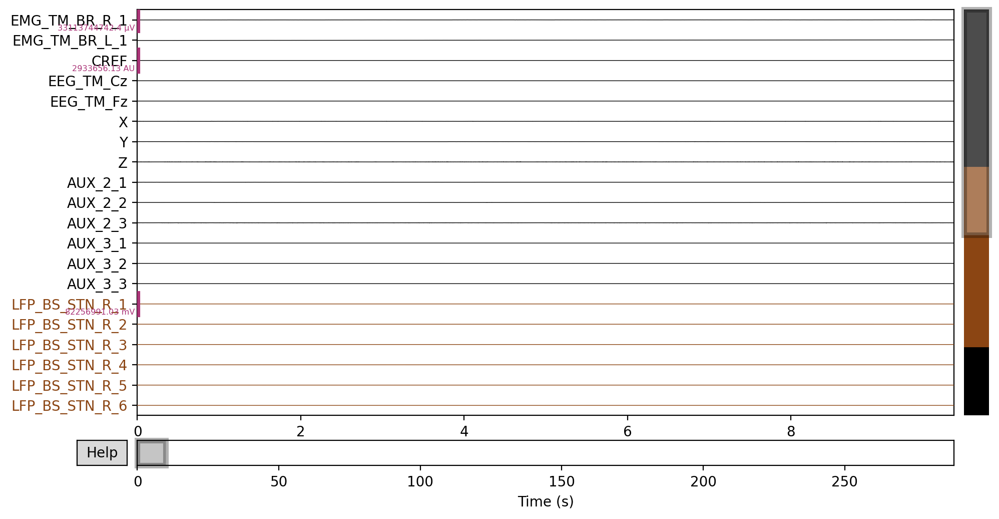

Channels marked as bad: none


In [215]:
raw.plot(scalings='auto')

In [216]:
raw.ch_names

['CREF',
 'LFP_BS_STN_R_1',
 'LFP_BS_STN_R_2',
 'LFP_BS_STN_R_3',
 'LFP_BS_STN_R_4',
 'LFP_BS_STN_R_5',
 'LFP_BS_STN_R_6',
 'LFP_BS_STN_R_7',
 'LFP_BS_STN_R_8',
 'LFP_BS_STN_L_1',
 'LFP_BS_STN_L_2',
 'LFP_BS_STN_L_3',
 'LFP_BS_STN_L_4',
 'LFP_BS_STN_L_5',
 'LFP_BS_STN_L_6',
 'LFP_BS_STN_L_7',
 'LFP_BS_STN_L_8',
 'ECOG_AT_SM_L_1',
 'ECOG_AT_SM_L_2',
 'ECOG_AT_SM_L_3',
 'ECOG_AT_SM_L_4',
 'ECOG_AT_SM_L_5',
 'ECOG_AT_SM_L_6',
 'EEG_TM_Cz',
 'EEG_TM_Fz',
 'EMG_TM_BR_R_1',
 'EMG_TM_BR_L_1',
 'X',
 'Y',
 'Z',
 'AUX_2_1',
 'AUX_2_2',
 'AUX_2_3',
 'AUX_3_1',
 'AUX_3_2',
 'AUX_3_3']

In [217]:
new_chs =  ['CREF',
            'LFP_R_1_STN_BS',
            'LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_R_8_STN_BS',
            'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
            'ECOG_L_3_SMC_AT',
            'ECOG_L_4_SMC_AT',
            'ECOG_L_5_SMC_AT',
            'ECOG_L_6_SMC_AT',
             'EEG_Cz_TM',
             'EEG_Fz_TM',
             'EMG_R_BR_TM',
             'EMG_L_BR_TM',
             'ACC_R_X_D2_TM',
            'ACC_R_Y_D2_TM',
            'ACC_R_Z_D2_TM',
            'ACC_L_X_D2_TM',
            'ACC_L_Y_D2_TM',
            'ACC_L_Z_D2_TM',
             'ANALOG_R_ROTA_CH',
             'AUX_3_2',
             'AUX_3_3']

In [218]:
picks = ['LFP_R_1_STN_BS',
        'LFP_R_2_STN_BS',
        'LFP_R_3_STN_BS',
        'LFP_R_4_STN_BS',
        'LFP_R_5_STN_BS',
        'LFP_R_6_STN_BS',
        'LFP_R_7_STN_BS',
        'LFP_R_8_STN_BS',
        'LFP_L_1_STN_BS',
        'LFP_L_2_STN_BS',
        'LFP_L_3_STN_BS',
        'LFP_L_4_STN_BS',
        'LFP_L_5_STN_BS',
        'LFP_L_6_STN_BS',
        'LFP_L_7_STN_BS',
        'LFP_L_8_STN_BS',
        'ECOG_L_1_SMC_AT',
        'ECOG_L_2_SMC_AT',
        'ECOG_L_3_SMC_AT',
        'ECOG_L_4_SMC_AT',
        'ECOG_L_5_SMC_AT',
        'ECOG_L_6_SMC_AT',
        'EEG_Cz_TM',
        'EEG_Fz_TM',
        'EMG_R_BR_TM',
        'EMG_L_BR_TM',
        'ACC_R_X_D2_TM',
        'ACC_R_Y_D2_TM',
        'ACC_R_Z_D2_TM',
        'ACC_L_X_D2_TM',
        'ACC_L_Y_D2_TM',
        'ACC_L_Z_D2_TM',
        'ANALOG_R_ROTA_CH']
raw = rename_chs(raw, new_chs, picks=picks)

ACC_L_X_D2_TM :  misc
ACC_L_Y_D2_TM :  misc
ACC_L_Z_D2_TM :  misc
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc
ANALOG_R_ROTA_C :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg


In [219]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn01\ieeg\dummy.vhdr...
Setting channel info structure...
ACC_L_X_D2_TM :  misc
ACC_L_Y_D2_TM :  misc
ACC_L_Z_D2_TM :  misc
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc
ANALOG_R_ROTA_C :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
Extracting parameters from C:\Users\richa\OneDrive - Chari

c:\users\richa\github\mne-bids\mne_bids\read.py:156: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '


Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-BlockRotationR_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-BlockRotationR_acq-StimOff_run-01_channels.tsv.


c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOn01_task-BlockRotationR_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\**\sub-004_ses-EphysMedOn01*events.tsv"
  warn(msg)


# Next

In [233]:
i = 61

In [234]:
raws[i]

<RawBrainVision | sub-004_ses-EphysMedOn01_task-Rest_acq-StimOff_run-01_ieeg.eeg, 36 x 1001276 (244.3 s), ~44 kB, data not loaded>

In [235]:
raw = raws[i]
file = files[i]
raw = mne_bids.read_raw_bids(file)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-Rest_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-Rest_acq-StimOff_run-01_channels.tsv.


c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOn01_task-Rest_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\**\sub-004_ses-EphysMedOn01*events.tsv"
  warn(msg)


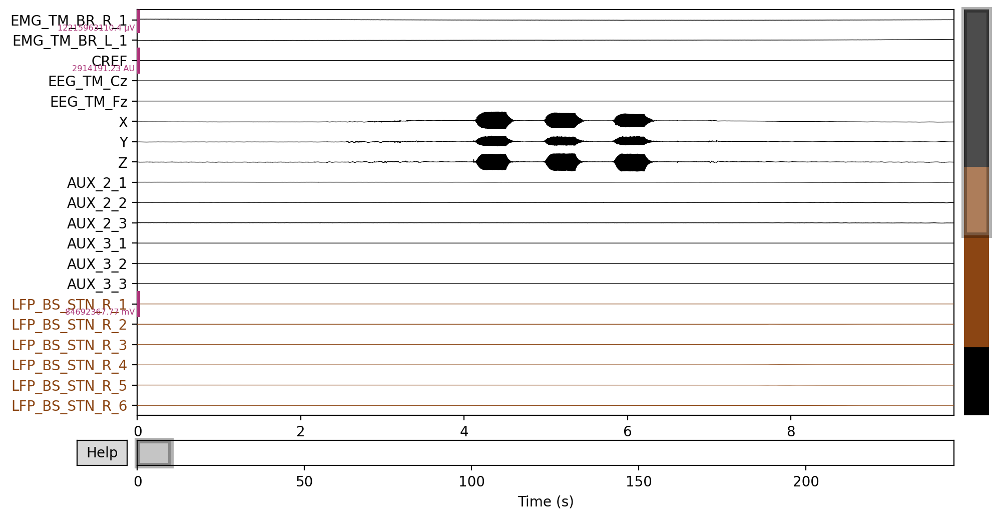

Channels marked as bad: none


In [236]:
raw.plot(scalings='auto')

In [225]:
raw.ch_names

['CREF',
 'LFP_BS_STN_R_1',
 'LFP_BS_STN_R_2',
 'LFP_BS_STN_R_3',
 'LFP_BS_STN_R_4',
 'LFP_BS_STN_R_5',
 'LFP_BS_STN_R_6',
 'LFP_BS_STN_R_7',
 'LFP_BS_STN_R_8',
 'LFP_BS_STN_L_1',
 'LFP_BS_STN_L_2',
 'LFP_BS_STN_L_3',
 'LFP_BS_STN_L_4',
 'LFP_BS_STN_L_5',
 'LFP_BS_STN_L_6',
 'LFP_BS_STN_L_7',
 'LFP_BS_STN_L_8',
 'ECOG_AT_SM_L_1',
 'ECOG_AT_SM_L_2',
 'ECOG_AT_SM_L_3',
 'ECOG_AT_SM_L_4',
 'ECOG_AT_SM_L_5',
 'ECOG_AT_SM_L_6',
 'EEG_TM_Cz',
 'EEG_TM_Fz',
 'EMG_TM_BR_R_1',
 'EMG_TM_BR_L_1',
 'X',
 'Y',
 'Z',
 'AUX_2_1',
 'AUX_2_2',
 'AUX_2_3',
 'AUX_3_1',
 'AUX_3_2',
 'AUX_3_3']

In [226]:
new_chs =  ['CREF',
            'LFP_R_1_STN_BS',
            'LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_R_8_STN_BS',
            'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
            'ECOG_L_3_SMC_AT',
            'ECOG_L_4_SMC_AT',
            'ECOG_L_5_SMC_AT',
            'ECOG_L_6_SMC_AT',
             'EEG_Cz_TM',
             'EEG_Fz_TM',
             'EMG_R_BR_TM',
             'EMG_L_BR_TM',
             'ACC_R_X_D2_TM',
            'ACC_R_Y_D2_TM',
            'ACC_R_Z_D2_TM',
            'ACC_L_X_D2_TM',
            'ACC_L_Y_D2_TM',
            'ACC_L_Z_D2_TM',
             'ANALOG_R_ROTA_CH',
             'AUX_3_2',
             'AUX_3_3']

In [227]:
picks = ['LFP_R_1_STN_BS',
        'LFP_R_2_STN_BS',
        'LFP_R_3_STN_BS',
        'LFP_R_4_STN_BS',
        'LFP_R_5_STN_BS',
        'LFP_R_6_STN_BS',
        'LFP_R_7_STN_BS',
        'LFP_R_8_STN_BS',
        'LFP_L_1_STN_BS',
        'LFP_L_2_STN_BS',
        'LFP_L_3_STN_BS',
        'LFP_L_4_STN_BS',
        'LFP_L_5_STN_BS',
        'LFP_L_6_STN_BS',
        'LFP_L_7_STN_BS',
        'LFP_L_8_STN_BS',
        'ECOG_L_1_SMC_AT',
        'ECOG_L_2_SMC_AT',
        'ECOG_L_3_SMC_AT',
        'ECOG_L_4_SMC_AT',
        'ECOG_L_5_SMC_AT',
        'ECOG_L_6_SMC_AT',
        'EEG_Cz_TM',
        'EEG_Fz_TM',
        'EMG_R_BR_TM',
        'EMG_L_BR_TM',
        'ACC_R_X_D2_TM',
        'ACC_R_Y_D2_TM',
        'ACC_R_Z_D2_TM',
        'ACC_L_X_D2_TM',
        'ACC_L_Y_D2_TM',
        'ACC_L_Z_D2_TM']
raw = rename_chs(raw, new_chs, picks=picks)

ACC_L_X_D2_TM :  misc
ACC_L_Y_D2_TM :  misc
ACC_L_Z_D2_TM :  misc
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg


In [228]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn01\ieeg\dummy.vhdr...
Setting channel info structure...
ACC_L_X_D2_TM :  misc
ACC_L_Y_D2_TM :  misc
ACC_L_Z_D2_TM :  misc
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin

c:\users\richa\github\mne-bids\mne_bids\read.py:156: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '


Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-Rest_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-Rest_acq-StimOff_run-01_channels.tsv.


c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOn01_task-Rest_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\**\sub-004_ses-EphysMedOn01*events.tsv"
  warn(msg)


# Next

In [237]:
i = 62

In [238]:
raws[i]

<RawBrainVision | sub-004_ses-EphysMedOn01_task-Rest_acq-StimOff_run-02_ieeg.eeg, 36 x 1234586 (301.2 s), ~44 kB, data not loaded>

In [239]:
raw = raws[i]
file = files[i]
raw = mne_bids.read_raw_bids(file)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-Rest_acq-StimOff_run-02_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-Rest_acq-StimOff_run-02_channels.tsv.


c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOn01_task-Rest_acq-StimOff_run-02.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\**\sub-004_ses-EphysMedOn01*events.tsv"
  warn(msg)


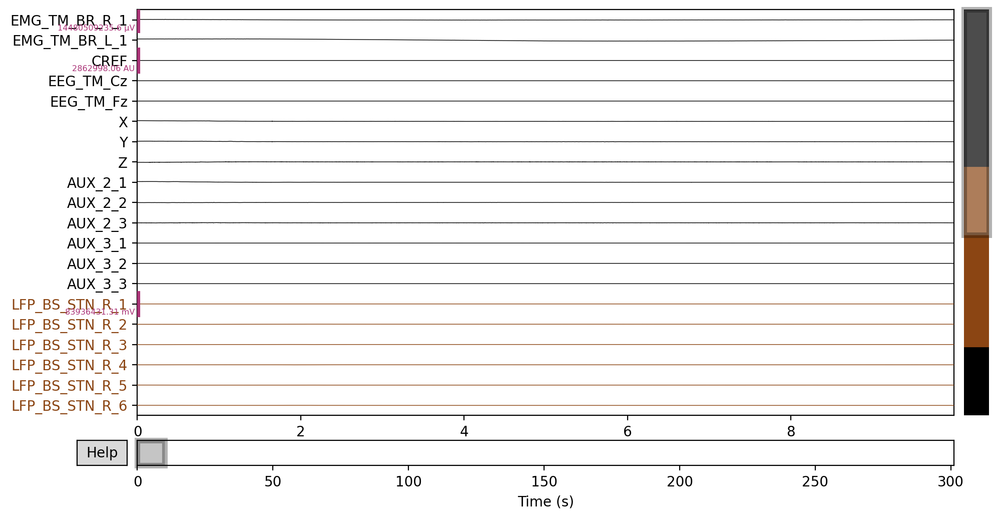

Channels marked as bad: none


In [240]:
raw.plot(scalings='auto')

In [241]:
raw.ch_names

['CREF',
 'LFP_BS_STN_R_1',
 'LFP_BS_STN_R_2',
 'LFP_BS_STN_R_3',
 'LFP_BS_STN_R_4',
 'LFP_BS_STN_R_5',
 'LFP_BS_STN_R_6',
 'LFP_BS_STN_R_7',
 'LFP_BS_STN_R_8',
 'LFP_BS_STN_L_1',
 'LFP_BS_STN_L_2',
 'LFP_BS_STN_L_3',
 'LFP_BS_STN_L_4',
 'LFP_BS_STN_L_5',
 'LFP_BS_STN_L_6',
 'LFP_BS_STN_L_7',
 'LFP_BS_STN_L_8',
 'ECOG_AT_SM_L_1',
 'ECOG_AT_SM_L_2',
 'ECOG_AT_SM_L_3',
 'ECOG_AT_SM_L_4',
 'ECOG_AT_SM_L_5',
 'ECOG_AT_SM_L_6',
 'EEG_TM_Cz',
 'EEG_TM_Fz',
 'EMG_TM_BR_R_1',
 'EMG_TM_BR_L_1',
 'X',
 'Y',
 'Z',
 'AUX_2_1',
 'AUX_2_2',
 'AUX_2_3',
 'AUX_3_1',
 'AUX_3_2',
 'AUX_3_3']

In [242]:
new_chs =  ['CREF',
            'LFP_R_1_STN_BS',
            'LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_R_8_STN_BS',
            'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
            'ECOG_L_3_SMC_AT',
            'ECOG_L_4_SMC_AT',
            'ECOG_L_5_SMC_AT',
            'ECOG_L_6_SMC_AT',
             'EEG_Cz_TM',
             'EEG_Fz_TM',
             'EMG_R_BR_TM',
             'EMG_L_BR_TM',
             'ACC_R_X_D2_TM',
            'ACC_R_Y_D2_TM',
            'ACC_R_Z_D2_TM',
            'ACC_L_X_D2_TM',
            'ACC_L_Y_D2_TM',
            'ACC_L_Z_D2_TM',
             'ANALOG_R_ROTA_CH',
             'AUX_3_2',
             'AUX_3_3']

In [243]:
picks = ['LFP_R_1_STN_BS',
        'LFP_R_2_STN_BS',
        'LFP_R_3_STN_BS',
        'LFP_R_4_STN_BS',
        'LFP_R_5_STN_BS',
        'LFP_R_6_STN_BS',
        'LFP_R_7_STN_BS',
        'LFP_R_8_STN_BS',
        'LFP_L_1_STN_BS',
        'LFP_L_2_STN_BS',
        'LFP_L_3_STN_BS',
        'LFP_L_4_STN_BS',
        'LFP_L_5_STN_BS',
        'LFP_L_6_STN_BS',
        'LFP_L_7_STN_BS',
        'LFP_L_8_STN_BS',
        'ECOG_L_1_SMC_AT',
        'ECOG_L_2_SMC_AT',
        'ECOG_L_3_SMC_AT',
        'ECOG_L_4_SMC_AT',
        'ECOG_L_5_SMC_AT',
        'ECOG_L_6_SMC_AT',
        'EEG_Cz_TM',
        'EEG_Fz_TM',
        'EMG_R_BR_TM',
        'EMG_L_BR_TM',
        'ACC_R_X_D2_TM',
        'ACC_R_Y_D2_TM',
        'ACC_R_Z_D2_TM',
        'ACC_L_X_D2_TM',
        'ACC_L_Y_D2_TM',
        'ACC_L_Z_D2_TM']
raw = rename_chs(raw, new_chs, picks=picks)

ACC_L_X_D2_TM :  misc
ACC_L_Y_D2_TM :  misc
ACC_L_Z_D2_TM :  misc
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg


In [244]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn01\ieeg\dummy.vhdr...
Setting channel info structure...
ACC_L_X_D2_TM :  misc
ACC_L_Y_D2_TM :  misc
ACC_L_Z_D2_TM :  misc
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin

c:\users\richa\github\mne-bids\mne_bids\read.py:156: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '


Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-Rest_acq-StimOff_run-02_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-Rest_acq-StimOff_run-02_channels.tsv.


c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOn01_task-Rest_acq-StimOff_run-02.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\**\sub-004_ses-EphysMedOn01*events.tsv"
  warn(msg)


# Next

In [245]:
i = 63

In [246]:
raws[i]

<RawBrainVision | sub-004_ses-EphysMedOn01_task-Rest_acq-StimOff_run-03_ieeg.eeg, 35 x 738773 (180.3 s), ~43 kB, data not loaded>

In [247]:
raw = raws[i]
file = files[i]
raw = mne_bids.read_raw_bids(file)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-Rest_acq-StimOff_run-03_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-Rest_acq-StimOff_run-03_channels.tsv.


c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOn01_task-Rest_acq-StimOff_run-03.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\**\sub-004_ses-EphysMedOn01*events.tsv"
  warn(msg)


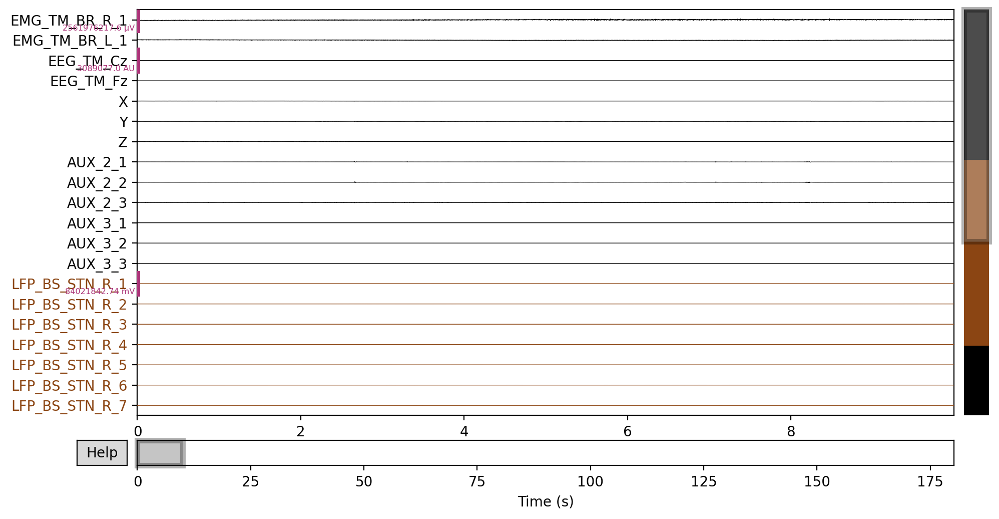

Channels marked as bad: none


In [248]:
raw.plot(scalings='auto')

In [252]:
raw = mne.add_reference_channels(raw.load_data(), ['REF_COMMONAVG'])

Reading 0 ... 738772  =      0.000 ...   180.260 secs...


In [254]:
raw = raw.set_channel_types({'REF_COMMONAVG': 'misc'})

In [255]:
raw.ch_names

['LFP_BS_STN_R_1',
 'LFP_BS_STN_R_2',
 'LFP_BS_STN_R_3',
 'LFP_BS_STN_R_4',
 'LFP_BS_STN_R_5',
 'LFP_BS_STN_R_6',
 'LFP_BS_STN_R_7',
 'LFP_BS_STN_R_8',
 'LFP_BS_STN_L_1',
 'LFP_BS_STN_L_2',
 'LFP_BS_STN_L_3',
 'LFP_BS_STN_L_4',
 'LFP_BS_STN_L_5',
 'LFP_BS_STN_L_6',
 'LFP_BS_STN_L_7',
 'LFP_BS_STN_L_8',
 'ECOG_AT_SM_L_1',
 'ECOG_AT_SM_L_2',
 'ECOG_AT_SM_L_3',
 'ECOG_AT_SM_L_4',
 'ECOG_AT_SM_L_5',
 'ECOG_AT_SM_L_6',
 'EEG_TM_Cz',
 'EEG_TM_Fz',
 'EMG_TM_BR_R_1',
 'EMG_TM_BR_L_1',
 'X',
 'Y',
 'Z',
 'AUX_2_1',
 'AUX_2_2',
 'AUX_2_3',
 'AUX_3_1',
 'AUX_3_2',
 'AUX_3_3',
 'REF_COMMONAVG']

In [256]:
new_chs =  ['LFP_R_1_STN_BS',
            'LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_R_8_STN_BS',
            'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
            'ECOG_L_3_SMC_AT',
            'ECOG_L_4_SMC_AT',
            'ECOG_L_5_SMC_AT',
            'ECOG_L_6_SMC_AT',
             'EEG_Cz_TM',
             'EEG_Fz_TM',
             'EMG_R_BR_TM',
             'EMG_L_BR_TM',
             'ACC_R_X_D2_TM',
            'ACC_R_Y_D2_TM',
            'ACC_R_Z_D2_TM',
            'ACC_L_X_D2_TM',
            'ACC_L_Y_D2_TM',
            'ACC_L_Z_D2_TM',
             'ANALOG_R_ROTA_CH',
             'AUX_3_2',
             'AUX_3_3',
           'REF_COMMONAVG']

In [257]:
picks = ['LFP_R_1_STN_BS',
        'LFP_R_2_STN_BS',
        'LFP_R_3_STN_BS',
        'LFP_R_4_STN_BS',
        'LFP_R_5_STN_BS',
        'LFP_R_6_STN_BS',
        'LFP_R_7_STN_BS',
        'LFP_R_8_STN_BS',
        'LFP_L_1_STN_BS',
        'LFP_L_2_STN_BS',
        'LFP_L_3_STN_BS',
        'LFP_L_4_STN_BS',
        'LFP_L_5_STN_BS',
        'LFP_L_6_STN_BS',
        'LFP_L_7_STN_BS',
        'LFP_L_8_STN_BS',
        'ECOG_L_1_SMC_AT',
        'ECOG_L_2_SMC_AT',
        'ECOG_L_3_SMC_AT',
        'ECOG_L_4_SMC_AT',
        'ECOG_L_5_SMC_AT',
        'ECOG_L_6_SMC_AT',
        'EEG_Cz_TM',
        'EEG_Fz_TM',
        'EMG_R_BR_TM',
        'EMG_L_BR_TM',
        'ACC_R_X_D2_TM',
        'ACC_R_Y_D2_TM',
        'ACC_R_Z_D2_TM',
        'ACC_L_X_D2_TM',
        'ACC_L_Y_D2_TM',
        'ACC_L_Z_D2_TM',
        'REF_COMMONAVG']
raw = rename_chs(raw, new_chs, picks=picks)

ACC_L_X_D2_TM :  misc
ACC_L_Y_D2_TM :  misc
ACC_L_Z_D2_TM :  misc
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
REF_COMMONAVG :  misc


In [258]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn01\ieeg\dummy.vhdr...
Setting channel info structure...
ACC_L_X_D2_TM :  misc
ACC_L_Y_D2_TM :  misc
ACC_L_Z_D2_TM :  misc
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
REF_COMMONAVG :  misc
Extracting parameters from C:\Users\richa\OneDrive - Charité

c:\users\richa\github\mne-bids\mne_bids\read.py:156: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '


Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-Rest_acq-StimOff_run-03_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-Rest_acq-StimOff_run-03_channels.tsv.


c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOn01_task-Rest_acq-StimOff_run-03.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\**\sub-004_ses-EphysMedOn01*events.tsv"
  warn(msg)


# Next

In [259]:
i = 64

In [261]:
raws[i]

<RawBrainVision | sub-004_ses-EphysMedOn01_task-Rest_acq-StimOff_run-04_ieeg.eeg, 36 x 864251 (210.9 s), ~44 kB, data not loaded>

In [262]:
raw = raws[i]
file = files[i]
raw = mne_bids.read_raw_bids(file)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-Rest_acq-StimOff_run-04_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-Rest_acq-StimOff_run-04_channels.tsv.


c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOn01_task-Rest_acq-StimOff_run-04.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\**\sub-004_ses-EphysMedOn01*events.tsv"
  warn(msg)


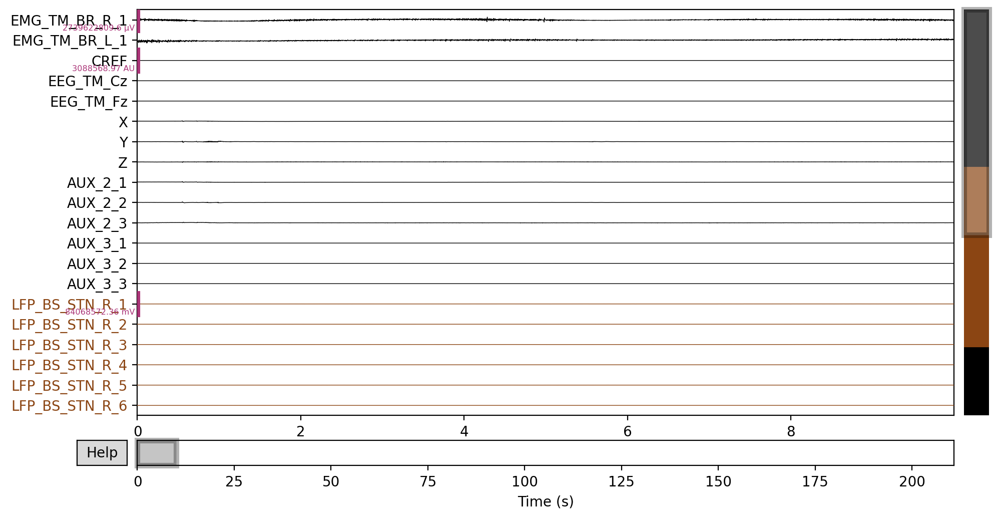

Channels marked as bad: none


In [263]:
raw.plot(scalings='auto')

In [264]:
raw.ch_names

['CREF',
 'LFP_BS_STN_R_1',
 'LFP_BS_STN_R_2',
 'LFP_BS_STN_R_3',
 'LFP_BS_STN_R_4',
 'LFP_BS_STN_R_5',
 'LFP_BS_STN_R_6',
 'LFP_BS_STN_R_7',
 'LFP_BS_STN_R_8',
 'LFP_BS_STN_L_1',
 'LFP_BS_STN_L_2',
 'LFP_BS_STN_L_3',
 'LFP_BS_STN_L_4',
 'LFP_BS_STN_L_5',
 'LFP_BS_STN_L_6',
 'LFP_BS_STN_L_7',
 'LFP_BS_STN_L_8',
 'ECOG_AT_SM_L_1',
 'ECOG_AT_SM_L_2',
 'ECOG_AT_SM_L_3',
 'ECOG_AT_SM_L_4',
 'ECOG_AT_SM_L_5',
 'ECOG_AT_SM_L_6',
 'EEG_TM_Cz',
 'EEG_TM_Fz',
 'EMG_TM_BR_R_1',
 'EMG_TM_BR_L_1',
 'X',
 'Y',
 'Z',
 'AUX_2_1',
 'AUX_2_2',
 'AUX_2_3',
 'AUX_3_1',
 'AUX_3_2',
 'AUX_3_3']

In [265]:
new_chs =  ['REF_MASTOID',
            'LFP_R_1_STN_BS',
            'LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_R_8_STN_BS',
            'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
            'ECOG_L_3_SMC_AT',
            'ECOG_L_4_SMC_AT',
            'ECOG_L_5_SMC_AT',
            'ECOG_L_6_SMC_AT',
             'EEG_Cz_TM',
             'EEG_Fz_TM',
             'EMG_R_BR_TM',
             'EMG_L_BR_TM',
             'ACC_R_X_D2_TM',
            'ACC_R_Y_D2_TM',
            'ACC_R_Z_D2_TM',
            'ACC_L_X_D2_TM',
            'ACC_L_Y_D2_TM',
            'ACC_L_Z_D2_TM',
             'ANALOG_R_ROTA_CH',
             'AUX_3_2',
             'AUX_3_3']

In [266]:
picks = ['REF_MASTOID',
         'LFP_R_1_STN_BS',
        'LFP_R_2_STN_BS',
        'LFP_R_3_STN_BS',
        'LFP_R_4_STN_BS',
        'LFP_R_5_STN_BS',
        'LFP_R_6_STN_BS',
        'LFP_R_7_STN_BS',
        'LFP_R_8_STN_BS',
        'LFP_L_1_STN_BS',
        'LFP_L_2_STN_BS',
        'LFP_L_3_STN_BS',
        'LFP_L_4_STN_BS',
        'LFP_L_5_STN_BS',
        'LFP_L_6_STN_BS',
        'LFP_L_7_STN_BS',
        'LFP_L_8_STN_BS',
        'ECOG_L_1_SMC_AT',
        'ECOG_L_2_SMC_AT',
        'ECOG_L_3_SMC_AT',
        'ECOG_L_4_SMC_AT',
        'ECOG_L_5_SMC_AT',
        'ECOG_L_6_SMC_AT',
        'EEG_Cz_TM',
        'EEG_Fz_TM',
        'EMG_R_BR_TM',
        'EMG_L_BR_TM',
        'ACC_R_X_D2_TM',
        'ACC_R_Y_D2_TM',
        'ACC_R_Z_D2_TM',
        'ACC_L_X_D2_TM',
        'ACC_L_Y_D2_TM',
        'ACC_L_Z_D2_TM']
raw = rename_chs(raw, new_chs, picks=picks)

ACC_L_X_D2_TM :  misc
ACC_L_Y_D2_TM :  misc
ACC_L_Z_D2_TM :  misc
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
REF_MASTOID :  misc


In [267]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn01\ieeg\dummy.vhdr...
Setting channel info structure...
ACC_L_X_D2_TM :  misc
ACC_L_Y_D2_TM :  misc
ACC_L_Z_D2_TM :  misc
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
REF_MASTOID :  misc
Extracting parameters from C:\Users\richa\OneDrive - Charité -

c:\users\richa\github\mne-bids\mne_bids\read.py:156: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '


Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-Rest_acq-StimOff_run-04_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-Rest_acq-StimOff_run-04_channels.tsv.


c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOn01_task-Rest_acq-StimOff_run-04.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\**\sub-004_ses-EphysMedOn01*events.tsv"
  warn(msg)


# Next

In [268]:
i = 65

In [269]:
raws[i]

<RawBrainVision | sub-004_ses-EphysMedOn01_task-SelfpacedRotationL_acq-StimOff_run-01_ieeg.eeg, 36 x 1485221 (362.4 s), ~44 kB, data not loaded>

In [270]:
raw = raws[i]
file = files[i]
raw = mne_bids.read_raw_bids(file)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-SelfpacedRotationL_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading events from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-SelfpacedRotationL_acq-StimOff_run-01_events.tsv.
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-SelfpacedRotationL_acq-StimOff_run-01_channels.tsv.


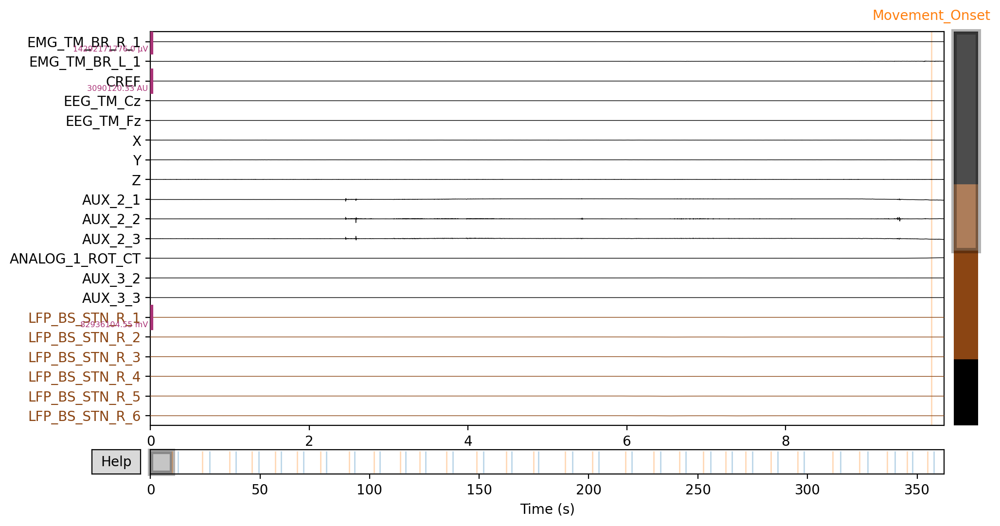

Channels marked as bad: none


In [271]:
raw.plot(scalings='auto')

In [272]:
raw.ch_names

['CREF',
 'LFP_BS_STN_R_1',
 'LFP_BS_STN_R_2',
 'LFP_BS_STN_R_3',
 'LFP_BS_STN_R_4',
 'LFP_BS_STN_R_5',
 'LFP_BS_STN_R_6',
 'LFP_BS_STN_R_7',
 'LFP_BS_STN_R_8',
 'LFP_BS_STN_L_1',
 'LFP_BS_STN_L_2',
 'LFP_BS_STN_L_3',
 'LFP_BS_STN_L_4',
 'LFP_BS_STN_L_5',
 'LFP_BS_STN_L_6',
 'LFP_BS_STN_L_7',
 'LFP_BS_STN_L_8',
 'ECOG_AT_SM_L_1',
 'ECOG_AT_SM_L_2',
 'ECOG_AT_SM_L_3',
 'ECOG_AT_SM_L_4',
 'ECOG_AT_SM_L_5',
 'ECOG_AT_SM_L_6',
 'EEG_TM_Cz',
 'EEG_TM_Fz',
 'EMG_TM_BR_R_1',
 'EMG_TM_BR_L_1',
 'X',
 'Y',
 'Z',
 'AUX_2_1',
 'AUX_2_2',
 'AUX_2_3',
 'ANALOG_1_ROT_CT',
 'AUX_3_2',
 'AUX_3_3']

In [274]:
new_chs =  ['CREF',
            'LFP_R_1_STN_BS',
            'LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_R_8_STN_BS',
            'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
            'ECOG_L_3_SMC_AT',
            'ECOG_L_4_SMC_AT',
            'ECOG_L_5_SMC_AT',
            'ECOG_L_6_SMC_AT',
             'EEG_Cz_TM',
             'EEG_Fz_TM',
             'EMG_R_BR_TM',
             'EMG_L_BR_TM',
             'ACC_R_X_D2_TM',
            'ACC_R_Y_D2_TM',
            'ACC_R_Z_D2_TM',
            'ACC_L_X_D2_TM',
            'ACC_L_Y_D2_TM',
            'ACC_L_Z_D2_TM',
             'ANALOG_L_ROTA_CH',
             'AUX_3_2',
             'AUX_3_3']

In [275]:
picks = ['LFP_R_1_STN_BS',
        'LFP_R_2_STN_BS',
        'LFP_R_3_STN_BS',
        'LFP_R_4_STN_BS',
        'LFP_R_5_STN_BS',
        'LFP_R_6_STN_BS',
        'LFP_R_7_STN_BS',
        'LFP_R_8_STN_BS',
        'LFP_L_1_STN_BS',
        'LFP_L_2_STN_BS',
        'LFP_L_3_STN_BS',
        'LFP_L_4_STN_BS',
        'LFP_L_5_STN_BS',
        'LFP_L_6_STN_BS',
        'LFP_L_7_STN_BS',
        'LFP_L_8_STN_BS',
        'ECOG_L_1_SMC_AT',
        'ECOG_L_2_SMC_AT',
        'ECOG_L_3_SMC_AT',
        'ECOG_L_4_SMC_AT',
        'ECOG_L_5_SMC_AT',
        'ECOG_L_6_SMC_AT',
        'EEG_Cz_TM',
        'EEG_Fz_TM',
        'EMG_R_BR_TM',
        'EMG_L_BR_TM',
        'ACC_R_X_D2_TM',
        'ACC_R_Y_D2_TM',
        'ACC_R_Z_D2_TM',
        'ACC_L_X_D2_TM',
        'ACC_L_Y_D2_TM',
        'ACC_L_Z_D2_TM',
        'ANALOG_L_ROTA_CH']
raw = rename_chs(raw, new_chs, picks=picks)

ACC_L_X_D2_TM :  misc
ACC_L_Y_D2_TM :  misc
ACC_L_Z_D2_TM :  misc
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc
ANALOG_L_ROTA_C :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg


In [276]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Used Annotations descriptions: ['Movement_End', 'Movement_Onset']
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn01\ieeg\dummy.vhdr...
Setting channel info structure...
ACC_L_X_D2_TM :  misc
ACC_L_Y_D2_TM :  misc
ACC_L_Z_D2_TM :  misc
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc
ANALOG_L_ROTA_C :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS 

# Next

In [293]:
i = 66

In [294]:
raws[i]

<RawBrainVision | sub-004_ses-EphysMedOn01_task-SelfpacedRotationR_acq-StimOff_run-01_ieeg.eeg, 36 x 1477871 (360.6 s), ~44 kB, data not loaded>

In [295]:
raw = raws[i]
file = files[i]
raw = mne_bids.read_raw_bids(file)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-SelfpacedRotationR_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading events from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-SelfpacedRotationR_acq-StimOff_run-01_events.tsv.
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-SelfpacedRotationR_acq-StimOff_run-01_channels.tsv.


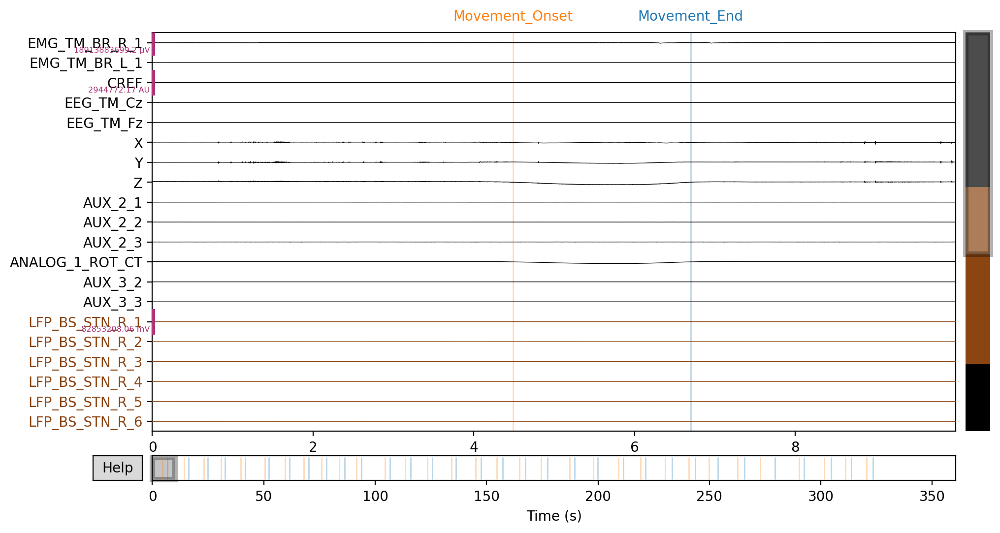

Channels marked as bad: none


In [296]:
raw.plot(scalings='auto')

In [297]:
raw.ch_names

['CREF',
 'LFP_BS_STN_R_1',
 'LFP_BS_STN_R_2',
 'LFP_BS_STN_R_3',
 'LFP_BS_STN_R_4',
 'LFP_BS_STN_R_5',
 'LFP_BS_STN_R_6',
 'LFP_BS_STN_R_7',
 'LFP_BS_STN_R_8',
 'LFP_BS_STN_L_1',
 'LFP_BS_STN_L_2',
 'LFP_BS_STN_L_3',
 'LFP_BS_STN_L_4',
 'LFP_BS_STN_L_5',
 'LFP_BS_STN_L_6',
 'LFP_BS_STN_L_7',
 'LFP_BS_STN_L_8',
 'ECOG_AT_SM_L_1',
 'ECOG_AT_SM_L_2',
 'ECOG_AT_SM_L_3',
 'ECOG_AT_SM_L_4',
 'ECOG_AT_SM_L_5',
 'ECOG_AT_SM_L_6',
 'EEG_TM_Cz',
 'EEG_TM_Fz',
 'EMG_TM_BR_R_1',
 'EMG_TM_BR_L_1',
 'X',
 'Y',
 'Z',
 'AUX_2_1',
 'AUX_2_2',
 'AUX_2_3',
 'ANALOG_1_ROT_CT',
 'AUX_3_2',
 'AUX_3_3']

In [298]:
new_chs =  ['CREF',
            'LFP_R_1_STN_BS',
            'LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_R_8_STN_BS',
            'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
            'ECOG_L_3_SMC_AT',
            'ECOG_L_4_SMC_AT',
            'ECOG_L_5_SMC_AT',
            'ECOG_L_6_SMC_AT',
             'EEG_Cz_TM',
             'EEG_Fz_TM',
             'EMG_R_BR_TM',
             'EMG_L_BR_TM',
             'ACC_R_X_D2_TM',
            'ACC_R_Y_D2_TM',
            'ACC_R_Z_D2_TM',
            'ACC_L_X_D2_TM',
            'ACC_L_Y_D2_TM',
            'ACC_L_Z_D2_TM',
             'ANALOG_R_ROTA_CH',
             'AUX_3_2',
             'AUX_3_3']

In [299]:
picks = ['LFP_R_1_STN_BS',
        'LFP_R_2_STN_BS',
        'LFP_R_3_STN_BS',
        'LFP_R_4_STN_BS',
        'LFP_R_5_STN_BS',
        'LFP_R_6_STN_BS',
        'LFP_R_7_STN_BS',
        'LFP_R_8_STN_BS',
        'LFP_L_1_STN_BS',
        'LFP_L_2_STN_BS',
        'LFP_L_3_STN_BS',
        'LFP_L_4_STN_BS',
        'LFP_L_5_STN_BS',
        'LFP_L_6_STN_BS',
        'LFP_L_7_STN_BS',
        'LFP_L_8_STN_BS',
        'ECOG_L_1_SMC_AT',
        'ECOG_L_2_SMC_AT',
        'ECOG_L_3_SMC_AT',
        'ECOG_L_4_SMC_AT',
        'ECOG_L_5_SMC_AT',
        'ECOG_L_6_SMC_AT',
        'EEG_Cz_TM',
        'EEG_Fz_TM',
        'EMG_R_BR_TM',
        'EMG_L_BR_TM',
        'ACC_R_X_D2_TM',
        'ACC_R_Y_D2_TM',
        'ACC_R_Z_D2_TM',
        'ACC_L_X_D2_TM',
        'ACC_L_Y_D2_TM',
        'ACC_L_Z_D2_TM',
        'ANALOG_R_ROTA_CH']
raw = rename_chs(raw, new_chs, picks=picks)

ACC_L_X_D2_TM :  misc
ACC_L_Y_D2_TM :  misc
ACC_L_Z_D2_TM :  misc
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc
ANALOG_R_ROTA_C :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg


In [300]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Used Annotations descriptions: ['Movement_End', 'Movement_Onset']
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn01\ieeg\dummy.vhdr...
Setting channel info structure...
ACC_L_X_D2_TM :  misc
ACC_L_Y_D2_TM :  misc
ACC_L_Z_D2_TM :  misc
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc
ANALOG_R_ROTA_C :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS 

# Next

In [285]:
i = 67

In [286]:
raws[i]

<RawBrainVision | sub-004_ses-EphysMedOn01_task-Speech_acq-StimOff_run-01_ieeg.eeg, 36 x 235196 (57.4 s), ~44 kB, data not loaded>

In [287]:
raw = raws[i]
file = files[i]
raw = mne_bids.read_raw_bids(file)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-Speech_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-Speech_acq-StimOff_run-01_channels.tsv.


c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOn01_task-Speech_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\**\sub-004_ses-EphysMedOn01*events.tsv"
  warn(msg)


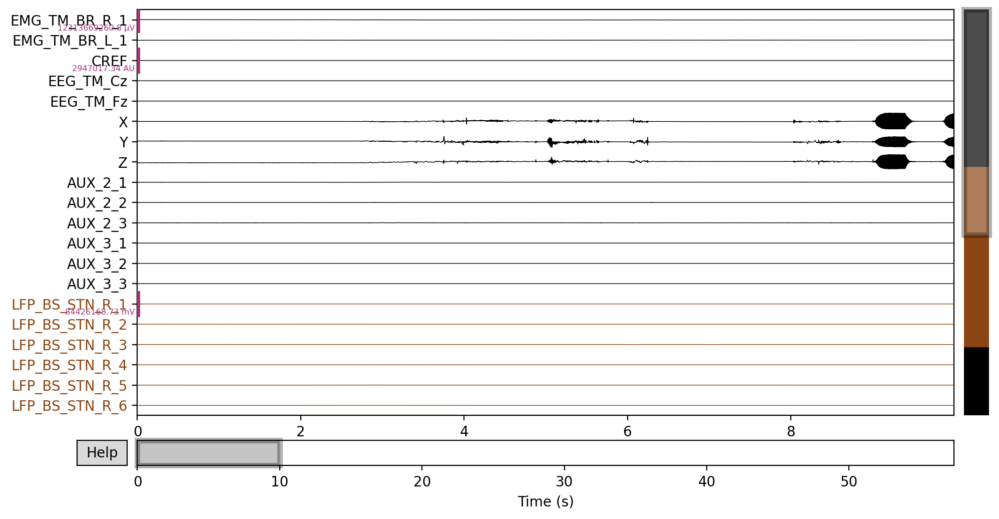

Channels marked as bad: none


In [288]:
raw.plot(scalings='auto')

In [289]:
raw.ch_names

['CREF',
 'LFP_BS_STN_R_1',
 'LFP_BS_STN_R_2',
 'LFP_BS_STN_R_3',
 'LFP_BS_STN_R_4',
 'LFP_BS_STN_R_5',
 'LFP_BS_STN_R_6',
 'LFP_BS_STN_R_7',
 'LFP_BS_STN_R_8',
 'LFP_BS_STN_L_1',
 'LFP_BS_STN_L_2',
 'LFP_BS_STN_L_3',
 'LFP_BS_STN_L_4',
 'LFP_BS_STN_L_5',
 'LFP_BS_STN_L_6',
 'LFP_BS_STN_L_7',
 'LFP_BS_STN_L_8',
 'ECOG_AT_SM_L_1',
 'ECOG_AT_SM_L_2',
 'ECOG_AT_SM_L_3',
 'ECOG_AT_SM_L_4',
 'ECOG_AT_SM_L_5',
 'ECOG_AT_SM_L_6',
 'EEG_TM_Cz',
 'EEG_TM_Fz',
 'EMG_TM_BR_R_1',
 'EMG_TM_BR_L_1',
 'X',
 'Y',
 'Z',
 'AUX_2_1',
 'AUX_2_2',
 'AUX_2_3',
 'AUX_3_1',
 'AUX_3_2',
 'AUX_3_3']

In [290]:
new_chs =  ['CREF',
            'LFP_R_1_STN_BS',
            'LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_R_8_STN_BS',
            'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
            'ECOG_L_3_SMC_AT',
            'ECOG_L_4_SMC_AT',
            'ECOG_L_5_SMC_AT',
            'ECOG_L_6_SMC_AT',
             'EEG_Cz_TM',
             'EEG_Fz_TM',
             'EMG_R_BR_TM',
             'EMG_L_BR_TM',
             'ACC_R_X_D2_TM',
            'ACC_R_Y_D2_TM',
            'ACC_R_Z_D2_TM',
            'ACC_L_X_D2_TM',
            'ACC_L_Y_D2_TM',
            'ACC_L_Z_D2_TM',
             'ANALOG_R_ROTA_CH',
             'AUX_3_2',
             'AUX_3_3']

In [291]:
picks = ['LFP_R_1_STN_BS',
        'LFP_R_2_STN_BS',
        'LFP_R_3_STN_BS',
        'LFP_R_4_STN_BS',
        'LFP_R_5_STN_BS',
        'LFP_R_6_STN_BS',
        'LFP_R_7_STN_BS',
        'LFP_R_8_STN_BS',
        'LFP_L_1_STN_BS',
        'LFP_L_2_STN_BS',
        'LFP_L_3_STN_BS',
        'LFP_L_4_STN_BS',
        'LFP_L_5_STN_BS',
        'LFP_L_6_STN_BS',
        'LFP_L_7_STN_BS',
        'LFP_L_8_STN_BS',
        'ECOG_L_1_SMC_AT',
        'ECOG_L_2_SMC_AT',
        'ECOG_L_3_SMC_AT',
        'ECOG_L_4_SMC_AT',
        'ECOG_L_5_SMC_AT',
        'ECOG_L_6_SMC_AT',
        'EEG_Cz_TM',
        'EEG_Fz_TM',
        'EMG_R_BR_TM',
        'EMG_L_BR_TM',
        'ACC_R_X_D2_TM',
        'ACC_R_Y_D2_TM',
        'ACC_R_Z_D2_TM',
        'ACC_L_X_D2_TM',
        'ACC_L_Y_D2_TM',
        'ACC_L_Z_D2_TM']
raw = rename_chs(raw, new_chs, picks=picks)

ACC_L_X_D2_TM :  misc
ACC_L_Y_D2_TM :  misc
ACC_L_Z_D2_TM :  misc
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg


In [292]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn01\ieeg\dummy.vhdr...
Setting channel info structure...
ACC_L_X_D2_TM :  misc
ACC_L_Y_D2_TM :  misc
ACC_L_Z_D2_TM :  misc
ACC_R_X_D2_TM :  misc
ACC_R_Y_D2_TM :  misc
ACC_R_Z_D2_TM :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin

c:\users\richa\github\mne-bids\mne_bids\read.py:156: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOn01_task-Speech_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\**\sub-004_ses-EphysMedOn01*events.tsv"
  warn(msg)


Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-Speech_acq-StimOff_run-01_channels.tsv.


# Next

In [301]:
i = 68

In [302]:
raws[i]

<RawBrainVision | sub-004_ses-EphysMedOn02_task-BlockRotationL_acq-StimOff_run-01_ieeg.eeg, 27 x 374791 (272.5 s), ~35 kB, data not loaded>

In [303]:
raw = raws[i]
file = files[i]
raw = mne_bids.read_raw_bids(file)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn02\ieeg\sub-004_ses-EphysMedOn02_task-BlockRotationL_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn02\ieeg\sub-004_ses-EphysMedOn02_task-BlockRotationL_acq-StimOff_run-01_channels.tsv.


c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOn02_task-BlockRotationL_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\**\sub-004_ses-EphysMedOn02*events.tsv"
  warn(msg)


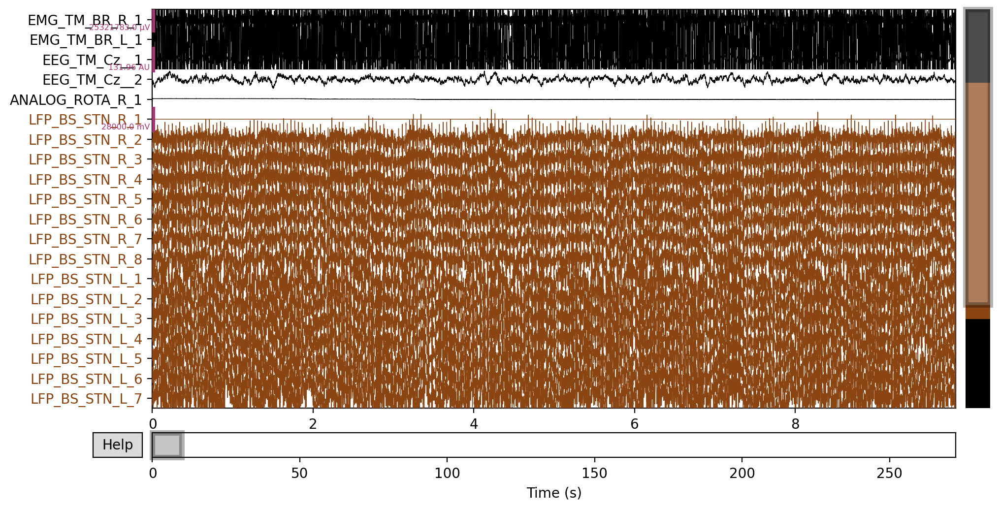

Channels marked as bad: none


In [304]:
raw.plot(scalings='auto')

In [305]:
raw.ch_names

['LFP_BS_STN_R_1',
 'LFP_BS_STN_R_2',
 'LFP_BS_STN_R_3',
 'LFP_BS_STN_R_4',
 'LFP_BS_STN_R_5',
 'LFP_BS_STN_R_6',
 'LFP_BS_STN_R_7',
 'LFP_BS_STN_R_8',
 'LFP_BS_STN_L_1',
 'LFP_BS_STN_L_2',
 'LFP_BS_STN_L_3',
 'LFP_BS_STN_L_4',
 'LFP_BS_STN_L_5',
 'LFP_BS_STN_L_6',
 'LFP_BS_STN_L_7',
 'LFP_BS_STN_L_8',
 'ECOG_AT_SM_L_1',
 'ECOG_AT_SM_L_2',
 'ECOG_AT_SM_L_3',
 'ECOG_AT_SM_L_4',
 'ECOG_AT_SM_L_5',
 'ECOG_AT_SM_L_6',
 'EEG_TM_Cz__1',
 'EEG_TM_Cz__2',
 'EMG_TM_BR_R_1',
 'EMG_TM_BR_L_1',
 'ANALOG_ROTA_R_1']

In [306]:
new_chs =  ['LFP_R_1_STN_BS',
            'LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_R_8_STN_BS',
            'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
            'ECOG_L_3_SMC_AT',
            'ECOG_L_4_SMC_AT',
            'ECOG_L_5_SMC_AT',
            'ECOG_L_6_SMC_AT',
             'EEG_Cz_TM',
             'EEG_Fz_TM',
             'EMG_R_BR_TM',
             'EMG_L_BR_TM',
             'ANALOG_L_ROTA_CH']

In [307]:
picks = None
raw = rename_chs(raw, new_chs, picks=picks)

ANALOG_L_ROTA_C :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg


In [308]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn02\ieeg\dummy.vhdr...
Setting channel info structure...
ANALOG_L_ROTA_C :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn02\ieeg\dummy.vhdr...
Setting channel info s

c:\users\richa\github\mne-bids\mne_bids\read.py:156: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '


Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOn02\ieeg\sub-004_ses-EphysMedOn02_task-BlockRotationL_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOn02\ieeg\sub-004_ses-EphysMedOn02_task-BlockRotationL_acq-StimOff_run-01_channels.tsv.


c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOn02_task-BlockRotationL_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\**\sub-004_ses-EphysMedOn02*events.tsv"
  warn(msg)


# Next

In [309]:
i = 69

In [310]:
raws[i]

<RawBrainVision | sub-004_ses-EphysMedOn02_task-BlockRotationR_acq-StimOff_run-01_ieeg.eeg, 27 x 381573 (277.4 s), ~35 kB, data not loaded>

In [311]:
raw = raws[i]
file = files[i]
raw = mne_bids.read_raw_bids(file)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn02\ieeg\sub-004_ses-EphysMedOn02_task-BlockRotationR_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn02\ieeg\sub-004_ses-EphysMedOn02_task-BlockRotationR_acq-StimOff_run-01_channels.tsv.


c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOn02_task-BlockRotationR_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\**\sub-004_ses-EphysMedOn02*events.tsv"
  warn(msg)


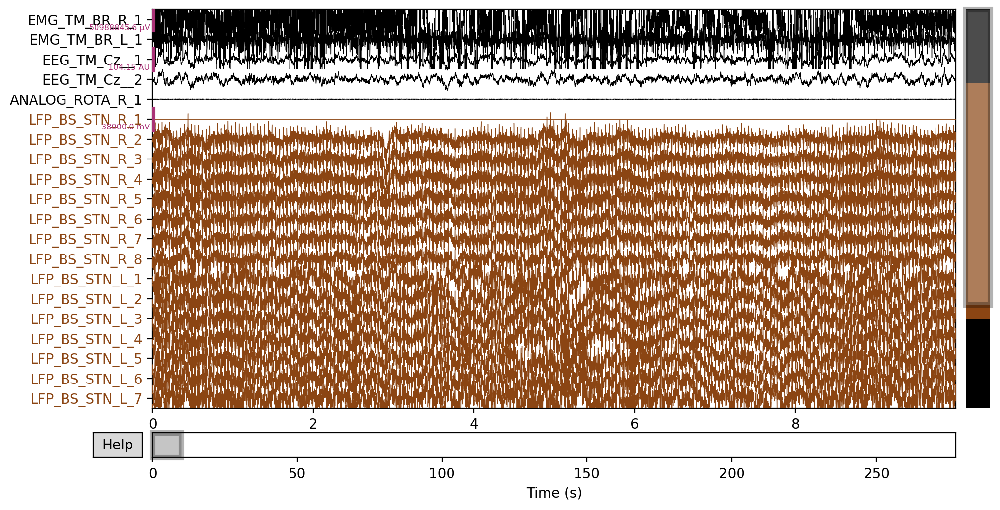

Channels marked as bad: none


In [312]:
raw.plot(scalings='auto')

In [313]:
raw.ch_names

['LFP_BS_STN_R_1',
 'LFP_BS_STN_R_2',
 'LFP_BS_STN_R_3',
 'LFP_BS_STN_R_4',
 'LFP_BS_STN_R_5',
 'LFP_BS_STN_R_6',
 'LFP_BS_STN_R_7',
 'LFP_BS_STN_R_8',
 'LFP_BS_STN_L_1',
 'LFP_BS_STN_L_2',
 'LFP_BS_STN_L_3',
 'LFP_BS_STN_L_4',
 'LFP_BS_STN_L_5',
 'LFP_BS_STN_L_6',
 'LFP_BS_STN_L_7',
 'LFP_BS_STN_L_8',
 'ECOG_AT_SM_L_1',
 'ECOG_AT_SM_L_2',
 'ECOG_AT_SM_L_3',
 'ECOG_AT_SM_L_4',
 'ECOG_AT_SM_L_5',
 'ECOG_AT_SM_L_6',
 'EEG_TM_Cz__1',
 'EEG_TM_Cz__2',
 'EMG_TM_BR_R_1',
 'EMG_TM_BR_L_1',
 'ANALOG_ROTA_R_1']

In [314]:
new_chs =  ['LFP_R_1_STN_BS',
            'LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_R_8_STN_BS',
            'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
            'ECOG_L_3_SMC_AT',
            'ECOG_L_4_SMC_AT',
            'ECOG_L_5_SMC_AT',
            'ECOG_L_6_SMC_AT',
             'EEG_Cz_TM',
             'EEG_Fz_TM',
             'EMG_R_BR_TM',
             'EMG_L_BR_TM',
             'ANALOG_R_ROTA_CH']

In [315]:
picks = None
raw = rename_chs(raw, new_chs, picks=picks)

ANALOG_R_ROTA_C :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg


In [316]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn02\ieeg\dummy.vhdr...
Setting channel info structure...
ANALOG_R_ROTA_C :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn02\ieeg\dummy.vhdr...
Setting channel info s

c:\users\richa\github\mne-bids\mne_bids\read.py:156: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '


Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOn02\ieeg\sub-004_ses-EphysMedOn02_task-BlockRotationR_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOn02\ieeg\sub-004_ses-EphysMedOn02_task-BlockRotationR_acq-StimOff_run-01_channels.tsv.


c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOn02_task-BlockRotationR_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\**\sub-004_ses-EphysMedOn02*events.tsv"
  warn(msg)


# Next

In [317]:
i = 70

In [318]:
raws[i]

<RawBrainVision | sub-004_ses-EphysMedOn02_task-BlockRotationR_acq-StimOn_run-01_ieeg.eeg, 26 x 398596 (289.8 s), ~34 kB, data not loaded>

In [319]:
raw = raws[i]
file = files[i]
raw = mne_bids.read_raw_bids(file)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn02\ieeg\sub-004_ses-EphysMedOn02_task-BlockRotationR_acq-StimOn_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn02\ieeg\sub-004_ses-EphysMedOn02_task-BlockRotationR_acq-StimOn_run-01_channels.tsv.


c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOn02_task-BlockRotationR_acq-StimOn_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\**\sub-004_ses-EphysMedOn02*events.tsv"
  warn(msg)


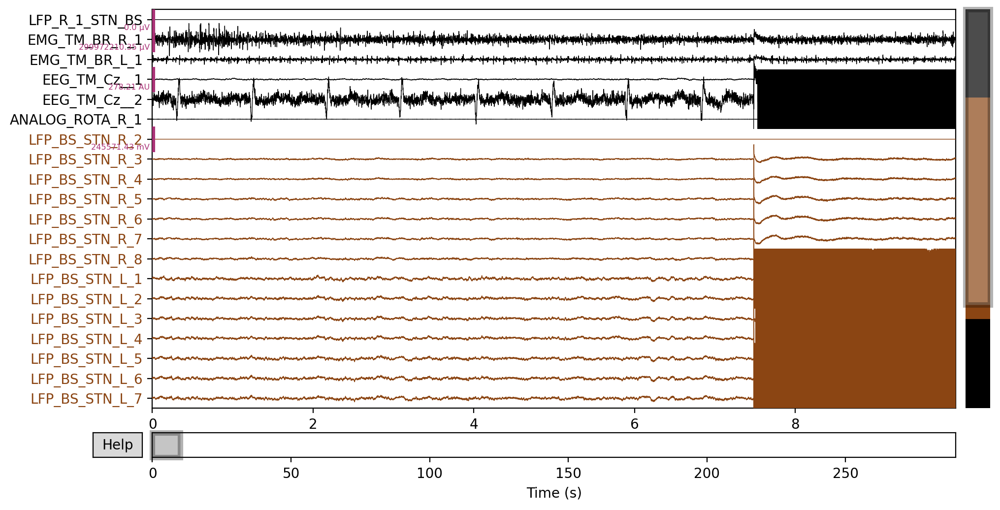

Channels marked as bad: none


In [325]:
raw.plot(scalings='auto')

In [321]:
raw.ch_names

['LFP_BS_STN_R_2',
 'LFP_BS_STN_R_3',
 'LFP_BS_STN_R_4',
 'LFP_BS_STN_R_5',
 'LFP_BS_STN_R_6',
 'LFP_BS_STN_R_7',
 'LFP_BS_STN_R_8',
 'LFP_BS_STN_L_1',
 'LFP_BS_STN_L_2',
 'LFP_BS_STN_L_3',
 'LFP_BS_STN_L_4',
 'LFP_BS_STN_L_5',
 'LFP_BS_STN_L_6',
 'LFP_BS_STN_L_7',
 'LFP_BS_STN_L_8',
 'ECOG_AT_SM_L_1',
 'ECOG_AT_SM_L_2',
 'ECOG_AT_SM_L_3',
 'ECOG_AT_SM_L_4',
 'ECOG_AT_SM_L_5',
 'ECOG_AT_SM_L_6',
 'EEG_TM_Cz__1',
 'EEG_TM_Cz__2',
 'EMG_TM_BR_R_1',
 'EMG_TM_BR_L_1',
 'ANALOG_ROTA_R_1']

In [323]:
raw = mne.add_reference_channels(raw.load_data(), ['LFP_R_1_STN_BS'])

Reading 0 ... 398595  =      0.000 ...   289.779 secs...


In [327]:
raw.ch_names

['LFP_BS_STN_R_2',
 'LFP_BS_STN_R_3',
 'LFP_BS_STN_R_4',
 'LFP_BS_STN_R_5',
 'LFP_BS_STN_R_6',
 'LFP_BS_STN_R_7',
 'LFP_BS_STN_R_8',
 'LFP_BS_STN_L_1',
 'LFP_BS_STN_L_2',
 'LFP_BS_STN_L_3',
 'LFP_BS_STN_L_4',
 'LFP_BS_STN_L_5',
 'LFP_BS_STN_L_6',
 'LFP_BS_STN_L_7',
 'LFP_BS_STN_L_8',
 'ECOG_AT_SM_L_1',
 'ECOG_AT_SM_L_2',
 'ECOG_AT_SM_L_3',
 'ECOG_AT_SM_L_4',
 'ECOG_AT_SM_L_5',
 'ECOG_AT_SM_L_6',
 'EEG_TM_Cz__1',
 'EEG_TM_Cz__2',
 'EMG_TM_BR_R_1',
 'EMG_TM_BR_L_1',
 'ANALOG_ROTA_R_1',
 'LFP_R_1_STN_BS']

In [328]:
new_chs =  ['LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_R_8_STN_BS',
            'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
            'ECOG_L_3_SMC_AT',
            'ECOG_L_4_SMC_AT',
            'ECOG_L_5_SMC_AT',
            'ECOG_L_6_SMC_AT',
             'EEG_Cz_TM',
             'EEG_Fz_TM',
             'EMG_R_BR_TM',
             'EMG_L_BR_TM',
             'ANALOG_R_ROTA_CH',
            'LFP_R_1_STN_BS']

In [329]:
picks = None
raw = rename_chs(raw, new_chs, picks=picks)

ANALOG_R_ROTA_C :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg


In [330]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn02\ieeg\dummy.vhdr...
Setting channel info structure...
ANALOG_R_ROTA_C :  misc
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn02\ieeg\dummy.vhdr...
Setting channel info s

c:\users\richa\github\mne-bids\mne_bids\read.py:156: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '


Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOn02\ieeg\sub-004_ses-EphysMedOn02_task-BlockRotationR_acq-StimOn_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOn02\ieeg\sub-004_ses-EphysMedOn02_task-BlockRotationR_acq-StimOn_run-01_channels.tsv.


c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOn02_task-BlockRotationR_acq-StimOn_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\**\sub-004_ses-EphysMedOn02*events.tsv"
  warn(msg)


# Next

In [331]:
i = 71

In [332]:
raws[i]

<RawBrainVision | sub-004_ses-EphysMedOn02_task-Rest_acq-StimOff_run-01_ieeg.eeg, 26 x 423513 (307.9 s), ~34 kB, data not loaded>

In [333]:
raw = raws[i]
file = files[i]

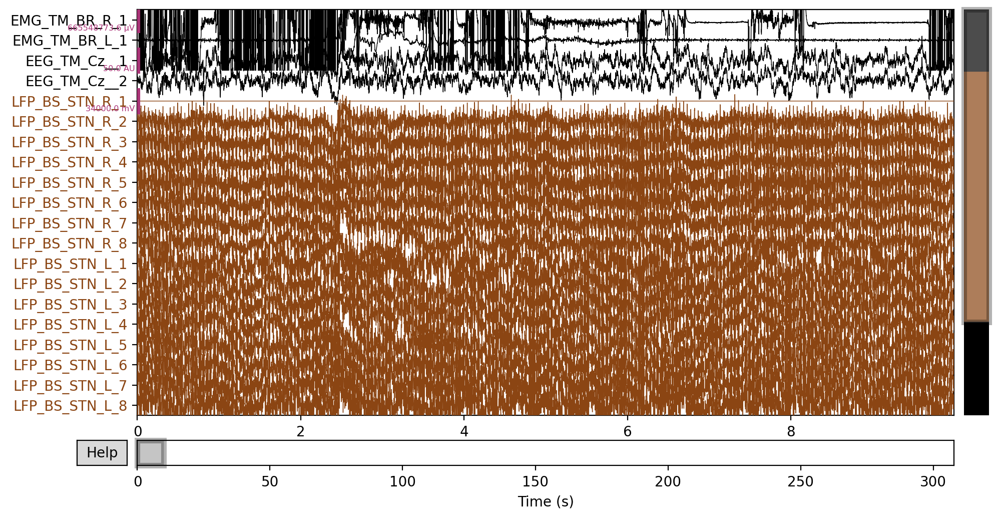

Channels marked as bad: none


In [334]:
raw.plot(scalings='auto')

In [335]:
raw.ch_names

['LFP_BS_STN_R_1',
 'LFP_BS_STN_R_2',
 'LFP_BS_STN_R_3',
 'LFP_BS_STN_R_4',
 'LFP_BS_STN_R_5',
 'LFP_BS_STN_R_6',
 'LFP_BS_STN_R_7',
 'LFP_BS_STN_R_8',
 'LFP_BS_STN_L_1',
 'LFP_BS_STN_L_2',
 'LFP_BS_STN_L_3',
 'LFP_BS_STN_L_4',
 'LFP_BS_STN_L_5',
 'LFP_BS_STN_L_6',
 'LFP_BS_STN_L_7',
 'LFP_BS_STN_L_8',
 'ECOG_AT_SM_L_1',
 'ECOG_AT_SM_L_2',
 'ECOG_AT_SM_L_3',
 'ECOG_AT_SM_L_4',
 'ECOG_AT_SM_L_5',
 'ECOG_AT_SM_L_6',
 'EEG_TM_Cz__1',
 'EEG_TM_Cz__2',
 'EMG_TM_BR_R_1',
 'EMG_TM_BR_L_1']

In [336]:
new_chs =  ['LFP_R_1_STN_BS',
            'LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_R_8_STN_BS',
            'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
            'ECOG_L_3_SMC_AT',
            'ECOG_L_4_SMC_AT',
            'ECOG_L_5_SMC_AT',
            'ECOG_L_6_SMC_AT',
             'EEG_Cz_TM',
             'EEG_Fz_TM',
             'EMG_R_BR_TM',
             'EMG_L_BR_TM']

In [337]:
picks = None
raw = rename_chs(raw, new_chs, picks=picks)

ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg


In [338]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn02\ieeg\dummy.vhdr...
Setting channel info structure...
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn02\ieeg\dummy.vhdr...
Setting channel info structure...
Reading 0 ..

c:\users\richa\github\mne-bids\mne_bids\read.py:156: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '


Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOn02\ieeg\sub-004_ses-EphysMedOn02_task-Rest_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOn02\ieeg\sub-004_ses-EphysMedOn02_task-Rest_acq-StimOff_run-01_channels.tsv.


c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOn02_task-Rest_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\**\sub-004_ses-EphysMedOn02*events.tsv"
  warn(msg)


# Next

In [339]:
i = 72

In [340]:
raws[i]

<RawBrainVision | sub-004_ses-EphysMedOn02_task-Rest_acq-StimOn_run-01_ieeg.eeg, 25 x 277595 (201.8 s), ~33 kB, data not loaded>

In [341]:
raw = raws[i]
file = files[i]

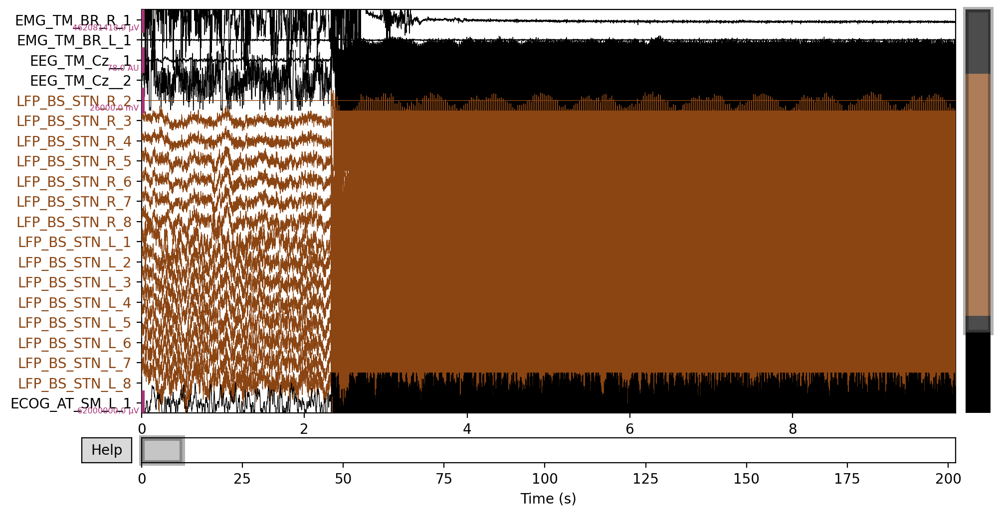

Channels marked as bad: none


In [342]:
raw.plot(scalings='auto')

In [343]:
raw.ch_names

['LFP_BS_STN_R_2',
 'LFP_BS_STN_R_3',
 'LFP_BS_STN_R_4',
 'LFP_BS_STN_R_5',
 'LFP_BS_STN_R_6',
 'LFP_BS_STN_R_7',
 'LFP_BS_STN_R_8',
 'LFP_BS_STN_L_1',
 'LFP_BS_STN_L_2',
 'LFP_BS_STN_L_3',
 'LFP_BS_STN_L_4',
 'LFP_BS_STN_L_5',
 'LFP_BS_STN_L_6',
 'LFP_BS_STN_L_7',
 'LFP_BS_STN_L_8',
 'ECOG_AT_SM_L_1',
 'ECOG_AT_SM_L_2',
 'ECOG_AT_SM_L_3',
 'ECOG_AT_SM_L_4',
 'ECOG_AT_SM_L_5',
 'ECOG_AT_SM_L_6',
 'EEG_TM_Cz__1',
 'EEG_TM_Cz__2',
 'EMG_TM_BR_R_1',
 'EMG_TM_BR_L_1']

In [344]:
raw = mne.add_reference_channels(raw.load_data(), ['LFP_R_1_STN_BS'])

Reading 0 ... 277594  =      0.000 ...   201.811 secs...


In [345]:
raw.ch_names

['LFP_BS_STN_R_2',
 'LFP_BS_STN_R_3',
 'LFP_BS_STN_R_4',
 'LFP_BS_STN_R_5',
 'LFP_BS_STN_R_6',
 'LFP_BS_STN_R_7',
 'LFP_BS_STN_R_8',
 'LFP_BS_STN_L_1',
 'LFP_BS_STN_L_2',
 'LFP_BS_STN_L_3',
 'LFP_BS_STN_L_4',
 'LFP_BS_STN_L_5',
 'LFP_BS_STN_L_6',
 'LFP_BS_STN_L_7',
 'LFP_BS_STN_L_8',
 'ECOG_AT_SM_L_1',
 'ECOG_AT_SM_L_2',
 'ECOG_AT_SM_L_3',
 'ECOG_AT_SM_L_4',
 'ECOG_AT_SM_L_5',
 'ECOG_AT_SM_L_6',
 'EEG_TM_Cz__1',
 'EEG_TM_Cz__2',
 'EMG_TM_BR_R_1',
 'EMG_TM_BR_L_1',
 'LFP_R_1_STN_BS']

In [346]:
new_chs =  ['LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_R_8_STN_BS',
            'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
            'ECOG_L_3_SMC_AT',
            'ECOG_L_4_SMC_AT',
            'ECOG_L_5_SMC_AT',
            'ECOG_L_6_SMC_AT',
             'EEG_Cz_TM',
             'EEG_Fz_TM',
             'EMG_R_BR_TM',
             'EMG_L_BR_TM',
            'LFP_R_1_STN_BS']

In [347]:
picks = None
raw = rename_chs(raw, new_chs, picks=picks)

ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg


In [348]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn02\ieeg\dummy.vhdr...
Setting channel info structure...
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn02\ieeg\dummy.vhdr...
Setting channel info structure...
Reading 0 ..

c:\users\richa\github\mne-bids\mne_bids\read.py:156: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOn02_task-Rest_acq-StimOn_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\**\sub-004_ses-EphysMedOn02*events.tsv"
  warn(msg)


Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOn02\ieeg\sub-004_ses-EphysMedOn02_task-Rest_acq-StimOn_run-01_channels.tsv.


# Next

In [349]:
i = 73

In [350]:
raws[i]

<RawBrainVision | sub-004_ses-EphysMedOn02_task-Rest_acq-StimOn_run-02_ieeg.eeg, 25 x 259202 (188.4 s), ~33 kB, data not loaded>

In [351]:
raw = raws[i]
file = files[i]

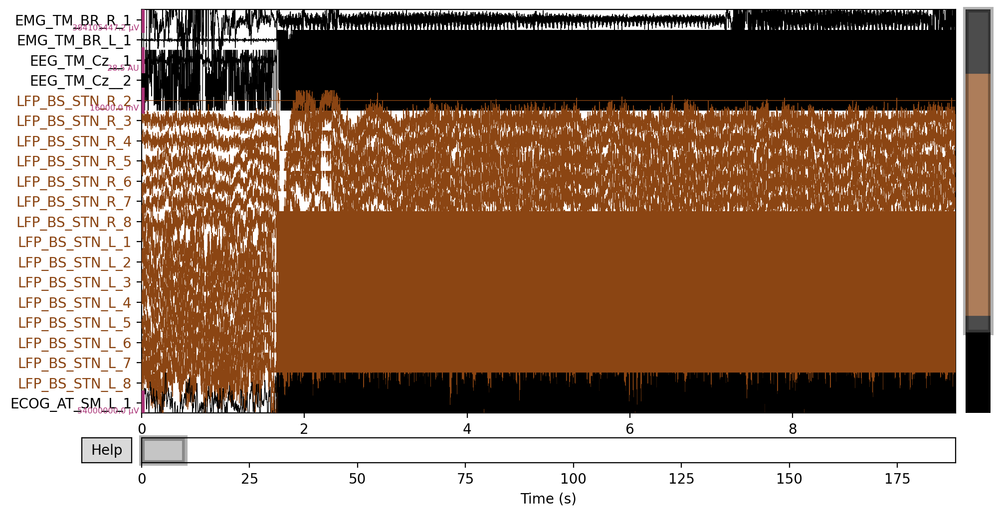

Channels marked as bad: none


In [352]:
raw.plot(scalings='auto')

In [353]:
raw.ch_names

['LFP_BS_STN_R_2',
 'LFP_BS_STN_R_3',
 'LFP_BS_STN_R_4',
 'LFP_BS_STN_R_5',
 'LFP_BS_STN_R_6',
 'LFP_BS_STN_R_7',
 'LFP_BS_STN_R_8',
 'LFP_BS_STN_L_1',
 'LFP_BS_STN_L_2',
 'LFP_BS_STN_L_3',
 'LFP_BS_STN_L_4',
 'LFP_BS_STN_L_5',
 'LFP_BS_STN_L_6',
 'LFP_BS_STN_L_7',
 'LFP_BS_STN_L_8',
 'ECOG_AT_SM_L_1',
 'ECOG_AT_SM_L_2',
 'ECOG_AT_SM_L_3',
 'ECOG_AT_SM_L_4',
 'ECOG_AT_SM_L_5',
 'ECOG_AT_SM_L_6',
 'EEG_TM_Cz__1',
 'EEG_TM_Cz__2',
 'EMG_TM_BR_R_1',
 'EMG_TM_BR_L_1']

In [354]:
raw = mne.add_reference_channels(raw.load_data(), ['LFP_R_1_STN_BS'])

Reading 0 ... 259201  =      0.000 ...   188.439 secs...


In [355]:
raw.ch_names

['LFP_BS_STN_R_2',
 'LFP_BS_STN_R_3',
 'LFP_BS_STN_R_4',
 'LFP_BS_STN_R_5',
 'LFP_BS_STN_R_6',
 'LFP_BS_STN_R_7',
 'LFP_BS_STN_R_8',
 'LFP_BS_STN_L_1',
 'LFP_BS_STN_L_2',
 'LFP_BS_STN_L_3',
 'LFP_BS_STN_L_4',
 'LFP_BS_STN_L_5',
 'LFP_BS_STN_L_6',
 'LFP_BS_STN_L_7',
 'LFP_BS_STN_L_8',
 'ECOG_AT_SM_L_1',
 'ECOG_AT_SM_L_2',
 'ECOG_AT_SM_L_3',
 'ECOG_AT_SM_L_4',
 'ECOG_AT_SM_L_5',
 'ECOG_AT_SM_L_6',
 'EEG_TM_Cz__1',
 'EEG_TM_Cz__2',
 'EMG_TM_BR_R_1',
 'EMG_TM_BR_L_1',
 'LFP_R_1_STN_BS']

In [356]:
new_chs =  ['LFP_R_2_STN_BS',
            'LFP_R_3_STN_BS',
            'LFP_R_4_STN_BS',
            'LFP_R_5_STN_BS',
            'LFP_R_6_STN_BS',
            'LFP_R_7_STN_BS',
            'LFP_R_8_STN_BS',
            'LFP_L_1_STN_BS',
            'LFP_L_2_STN_BS',
            'LFP_L_3_STN_BS',
            'LFP_L_4_STN_BS',
            'LFP_L_5_STN_BS',
            'LFP_L_6_STN_BS',
            'LFP_L_7_STN_BS',
            'LFP_L_8_STN_BS',
            'ECOG_L_1_SMC_AT',
            'ECOG_L_2_SMC_AT',
            'ECOG_L_3_SMC_AT',
            'ECOG_L_4_SMC_AT',
            'ECOG_L_5_SMC_AT',
            'ECOG_L_6_SMC_AT',
             'EEG_Cz_TM',
             'EEG_Fz_TM',
             'EMG_R_BR_TM',
             'EMG_L_BR_TM',
            'LFP_R_1_STN_BS']

In [357]:
picks = None
raw = rename_chs(raw, new_chs, picks=picks)

ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg


In [358]:
test_raw = bids_rewrite_file(raw, file, out_path, True)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn02\ieeg\dummy.vhdr...
Setting channel info structure...
ECOG_L_1_SMC_AT :  ecog
ECOG_L_2_SMC_AT :  ecog
ECOG_L_3_SMC_AT :  ecog
ECOG_L_4_SMC_AT :  ecog
ECOG_L_5_SMC_AT :  ecog
ECOG_L_6_SMC_AT :  ecog
EEG_Cz_TM :  eeg
EEG_Fz_TM :  eeg
EMG_L_BR_TM :  emg
EMG_R_BR_TM :  emg
LFP_L_1_STN_BS :  seeg
LFP_L_2_STN_BS :  seeg
LFP_L_3_STN_BS :  seeg
LFP_L_4_STN_BS :  seeg
LFP_L_5_STN_BS :  seeg
LFP_L_6_STN_BS :  seeg
LFP_L_7_STN_BS :  seeg
LFP_L_8_STN_BS :  seeg
LFP_R_1_STN_BS :  seeg
LFP_R_2_STN_BS :  seeg
LFP_R_3_STN_BS :  seeg
LFP_R_4_STN_BS :  seeg
LFP_R_5_STN_BS :  seeg
LFP_R_6_STN_BS :  seeg
LFP_R_7_STN_BS :  seeg
LFP_R_8_STN_BS :  seeg
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata\sub-004\ses-EphysMedOn02\ieeg\dummy.vhdr...
Setting channel info structure...
Reading 0 ..

c:\users\richa\github\mne-bids\mne_bids\read.py:156: RuntimeWarning: No events found or provided. Please add annotations to the raw data, or provide the events_data and event_id parameters. If this is resting state data it is recommended to name the task "rest".
  warn('No events found or provided. Please add annotations '
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOn02_task-Rest_acq-StimOn_run-02.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\**\sub-004_ses-EphysMedOn02*events.tsv"
  warn(msg)


# Check channel naming

In [364]:
new_files = get_all_files(path=out_path,
    suffix="vhdr",
    get_bids=True,
    prefix=None,
    bids_root=out_path,
    verbose=True)

Corresponding files found:
0 : sub-001_ses-EphysMedOff01_task-BlockRotationR_acq-StimOffOn_run-01_ieeg.vhdr
1 : sub-001_ses-EphysMedOff01_task-Rest_acq-StimOff_run-01_ieeg.vhdr
2 : sub-001_ses-EphysMedOff01_task-Rest_acq-StimOff_run-02_ieeg.vhdr
3 : sub-001_ses-EphysMedOff01_task-Rest_acq-StimOn_run-01_ieeg.vhdr
4 : sub-001_ses-EphysMedOff01_task-Rest_acq-StimOn_run-02_ieeg.vhdr
5 : sub-001_ses-EphysMedOff01_task-Visuomotor_acq-StimOff_run-01_ieeg.vhdr
6 : sub-001_ses-EphysMedOff01_task-Visuomotor_acq-StimOn_run-01_ieeg.vhdr
7 : sub-001_ses-EphysMedOn01_task-BlockRotationWheel_acq-StimOff_run-01_ieeg.vhdr
8 : sub-001_ses-EphysMedOn01_task-FreeDrawing_acq-StimOff_run-01_ieeg.vhdr
9 : sub-001_ses-EphysMedOn01_task-Rest_acq-StimOff_run-01_ieeg.vhdr
10 : sub-001_ses-EphysMedOn01_task-Rest_acq-StimOn_run-01_ieeg.vhdr
11 : sub-001_ses-EphysMedOn01_task-SelfpacedForceWheel_acq-StimOff_run-01_ieeg.vhdr
12 : sub-001_ses-EphysMedOn02_task-BlockRotationL_acq-StimOffOn_run-01_ieeg.vhdr
13 : sub-00

In [365]:
channels = []
for file in new_files:
    raw = mne_bids.read_raw_bids(file, verbose=False)
    for ch in raw.ch_names:
            if ch not in channels:
                channels.append(ch)

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\ses-EphysMedOff01\ieeg\sub-001_ses-EphysMedOff01_task-BlockRotationR_acq-StimOffOn_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\ses-EphysMedOff01\ieeg\sub-001_ses-EphysMedOff01_task-BlockRotationR_acq-StimOffOn_run-01_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\ses-EphysMedOff01\ieeg\sub-001_ses-EphysMedOff01_task-Rest_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\ses-EphysMedOff01\ieeg\sub-001_ses-EphysMedOff01_task-Rest_acq-StimOff_run-01_channels.tsv.


c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-001_ses-EphysMedOff01_task-BlockRotationR_acq-StimOffOn_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\**\sub-001_ses-EphysMedOff01*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-001_ses-EphysMedOff01_task-Rest_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\**\sub-001_ses-EphysMedOff01*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-001_ses-EphysMedOff01_task-Rest_acq-StimOff_run-02.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\ra

Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\ses-EphysMedOff01\ieeg\sub-001_ses-EphysMedOff01_task-Rest_acq-StimOn_run-01_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\ses-EphysMedOff01\ieeg\sub-001_ses-EphysMedOff01_task-Rest_acq-StimOn_run-02_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\ses-EphysMedOff01\ieeg\sub-001_ses-EphysMedOff01_task-Rest_acq-StimOn_run-02_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\ses-EphysMedOff01\ieeg\sub-001_ses-EphysMedOff01_task-Visuomotor_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading events from C

c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-001_ses-EphysMedOff01_task-Rest_acq-StimOn_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\**\sub-001_ses-EphysMedOff01*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-001_ses-EphysMedOff01_task-Rest_acq-StimOn_run-02.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\**\sub-001_ses-EphysMedOff01*events.tsv"
  warn(msg)


Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\ses-EphysMedOff01\ieeg\sub-001_ses-EphysMedOff01_task-Visuomotor_acq-StimOn_run-01_ieeg.vhdr...
Setting channel info structure...
Reading events from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\ses-EphysMedOff01\ieeg\sub-001_ses-EphysMedOff01_task-Visuomotor_acq-StimOn_run-01_events.tsv.
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\ses-EphysMedOff01\ieeg\sub-001_ses-EphysMedOff01_task-Visuomotor_acq-StimOn_run-01_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\ses-EphysMedOn01\ieeg\sub-001_ses-EphysMedOn01_task-BlockRotationWheel_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Readi

c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-001_ses-EphysMedOn01_task-BlockRotationWheel_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\**\sub-001_ses-EphysMedOn01*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-001_ses-EphysMedOn01_task-FreeDrawing_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\**\sub-001_ses-EphysMedOn01*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-001_ses-EphysMedOn01_task-Rest_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LF

Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\ses-EphysMedOn01\ieeg\sub-001_ses-EphysMedOn01_task-Rest_acq-StimOn_run-01_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\ses-EphysMedOn01\ieeg\sub-001_ses-EphysMedOn01_task-SelfpacedForceWheel_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\ses-EphysMedOn01\ieeg\sub-001_ses-EphysMedOn01_task-SelfpacedForceWheel_acq-StimOff_run-01_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\ses-EphysMedOn02\ieeg\sub-001_ses-EphysMedOn02_task-BlockRotationL_acq-StimOffOn_run-01_ieeg.vhdr...
Setting channel info stru

c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-001_ses-EphysMedOn01_task-Rest_acq-StimOn_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\**\sub-001_ses-EphysMedOn01*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-001_ses-EphysMedOn01_task-SelfpacedForceWheel_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\**\sub-001_ses-EphysMedOn01*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-001_ses-EphysMedOn02_task-BlockRotationL_acq-StimOffOn_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_EC

Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\ses-EphysMedOn02\ieeg\sub-001_ses-EphysMedOn02_task-BlockRotationR_acq-StimOff_run-01_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\ses-EphysMedOn02\ieeg\sub-001_ses-EphysMedOn02_task-ContinuousStopping_acq-StimOffOn_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\ses-EphysMedOn02\ieeg\sub-001_ses-EphysMedOn02_task-ContinuousStopping_acq-StimOffOn_run-01_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\ses-EphysMedOn02\ieeg\sub-001_ses-EphysMedOn02_task-Rest_acq-StimOff_run-01_iee

c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-001_ses-EphysMedOn02_task-BlockRotationR_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\**\sub-001_ses-EphysMedOn02*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-001_ses-EphysMedOn02_task-ContinuousStopping_acq-StimOffOn_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\**\sub-001_ses-EphysMedOn02*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-001_ses-EphysMedOn02_task-Rest_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_EC

Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\ses-EphysMedOn02\ieeg\sub-001_ses-EphysMedOn02_task-Rest_acq-StimOn_run-01_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\ses-EphysMedOn02\ieeg\sub-001_ses-EphysMedOn02_task-Rest_acq-StimOn_run-02_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\ses-EphysMedOn02\ieeg\sub-001_ses-EphysMedOn02_task-Rest_acq-StimOn_run-02_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\ses-EphysMedOff01\ieeg\sub-002_ses-EphysMedOff01_task-Rest_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\User

c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-001_ses-EphysMedOn02_task-Rest_acq-StimOn_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\**\sub-001_ses-EphysMedOn02*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-001_ses-EphysMedOn02_task-Rest_acq-StimOn_run-02.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-001\**\sub-001_ses-EphysMedOn02*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-002_ses-EphysMedOff01_task-Rest_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\

Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\ses-EphysMedOff01\ieeg\sub-002_ses-EphysMedOff01_task-Rest_acq-StimOff_run-02_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\ses-EphysMedOff02\ieeg\sub-002_ses-EphysMedOff02_task-Evoked_acq-StimOn_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\ses-EphysMedOff02\ieeg\sub-002_ses-EphysMedOff02_task-Evoked_acq-StimOn_run-01_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\ses-EphysMedOff02\ieeg\sub-002_ses-EphysMedOff02_task-Evoked_acq-StimOn_run-02_ieeg.vhdr...
Setting channel info structure...
Reading channel info 

c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-002_ses-EphysMedOff02_task-Evoked_acq-StimOn_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\**\sub-002_ses-EphysMedOff02*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-002_ses-EphysMedOff02_task-Evoked_acq-StimOn_run-02.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\**\sub-002_ses-EphysMedOff02*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-002_ses-EphysMedOff02_task-Evoked_acq-StimOn_run-03.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new

Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\ses-EphysMedOff02\ieeg\sub-002_ses-EphysMedOff02_task-Rest_acq-StimOff_run-01_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\ses-EphysMedOff02\ieeg\sub-002_ses-EphysMedOff02_task-Rest_acq-StimOff_run-02_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\ses-EphysMedOff02\ieeg\sub-002_ses-EphysMedOff02_task-Rest_acq-StimOff_run-02_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\ses-EphysMedOff02\ieeg\sub-002_ses-EphysMedOff02_task-Rest_acq-StimOff_run-03_ieeg.vhdr...
Setting channel info str

c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-002_ses-EphysMedOff02_task-Rest_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\**\sub-002_ses-EphysMedOff02*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-002_ses-EphysMedOff02_task-Rest_acq-StimOff_run-02.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\**\sub-002_ses-EphysMedOff02*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-002_ses-EphysMedOff02_task-Rest_acq-StimOff_run-03.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\su

Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\ses-EphysMedOff02\ieeg\sub-002_ses-EphysMedOff02_task-SelfpacedRotationR_acq-StimOff_run-01_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\ses-EphysMedOff02\ieeg\sub-002_ses-EphysMedOff02_task-Speech_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\ses-EphysMedOff02\ieeg\sub-002_ses-EphysMedOff02_task-Speech_acq-StimOff_run-01_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\ses-EphysMedOff03\ieeg\sub-002_ses-EphysMedOff03_task-Rest_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Readin

c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-002_ses-EphysMedOff02_task-Speech_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\**\sub-002_ses-EphysMedOff02*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-002_ses-EphysMedOff03_task-Rest_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\**\sub-002_ses-EphysMedOff03*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-002_ses-EphysMedOff03_task-Rest_acq-StimOff_run-02.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\

Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\ses-EphysMedOff03\ieeg\sub-002_ses-EphysMedOff03_task-Rest_acq-StimOff_run-03_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\ses-EphysMedOff03\ieeg\sub-002_ses-EphysMedOff03_task-Rest_acq-StimOff_run-04_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\ses-EphysMedOff03\ieeg\sub-002_ses-EphysMedOff03_task-Rest_acq-StimOff_run-04_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\ses-EphysMedOff03\ieeg\sub-002_ses-EphysMedOff03_task-Rest_acq-StimOn_run-01_ieeg.vhdr...
Setting channel info stru

c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-002_ses-EphysMedOff03_task-Rest_acq-StimOff_run-03.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\**\sub-002_ses-EphysMedOff03*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-002_ses-EphysMedOff03_task-Rest_acq-StimOff_run-04.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\**\sub-002_ses-EphysMedOff03*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-002_ses-EphysMedOff03_task-Rest_acq-StimOn_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub

Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\ses-EphysMedOff03\ieeg\sub-002_ses-EphysMedOff03_task-Rest_acq-StimOn_run-02_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\ses-EphysMedOff03\ieeg\sub-002_ses-EphysMedOff03_task-SelfpacedRotationR_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading events from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\ses-EphysMedOff03\ieeg\sub-002_ses-EphysMedOff03_task-SelfpacedRotationR_acq-StimOff_run-01_events.tsv.
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-002\ses-EphysMedOff03\ieeg\sub-002_ses-EphysMedOff03_task-SelfpacedRotationR_acq-StimOff_run-01_channels.tsv.
Extracting parameters fro

c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-003_ses-EphysMedOff01_task-BlockRotationR_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-003\**\sub-003_ses-EphysMedOff01*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-003_ses-EphysMedOff01_task-Rest_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-003\**\sub-003_ses-EphysMedOff01*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-003_ses-EphysMedOff01_task-Rest_acq-StimOff_run-02.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawd

Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-003\ses-EphysMedOff01\ieeg\sub-003_ses-EphysMedOff01_task-Rest_acq-StimOff_run-03_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-003\ses-EphysMedOff01\ieeg\sub-003_ses-EphysMedOff01_task-SelfpacedRotationR_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading events from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-003\ses-EphysMedOff01\ieeg\sub-003_ses-EphysMedOff01_task-SelfpacedRotationR_acq-StimOff_run-01_events.tsv.
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-003\ses-EphysMedOff01\ieeg\sub-003_ses-EphysMedOff01_task-SelfpacedRotationR_acq-StimOff_run-01_channels.tsv.
Extracting parameters fr

c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-003_ses-EphysMedOff01_task-Rest_acq-StimOff_run-03.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-003\**\sub-003_ses-EphysMedOff01*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-003_ses-EphysMedOff01_task-UPDRSIII_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-003\**\sub-003_ses-EphysMedOff01*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-003_ses-EphysMedOff01_task-UPDRSIII_acq-StimOff_run-02.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdat

Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-003\ses-EphysMedOff01\ieeg\sub-003_ses-EphysMedOff01_task-UPDRSIII_acq-StimOff_run-02_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-003\ses-EphysMedOn01\ieeg\sub-003_ses-EphysMedOn01_task-Rest_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-003\ses-EphysMedOn01\ieeg\sub-003_ses-EphysMedOn01_task-Rest_acq-StimOff_run-01_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-003\ses-EphysMedOn02\ieeg\sub-003_ses-EphysMedOn02_task-RestAndSpeech_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel i

c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-003_ses-EphysMedOn01_task-Rest_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-003\**\sub-003_ses-EphysMedOn01*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-003_ses-EphysMedOn02_task-RestAndSpeech_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-003\**\sub-003_ses-EphysMedOn02*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-003_ses-EphysMedOn02_task-UPDRSIII_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdat

Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-003\ses-EphysMedOn03\ieeg\sub-003_ses-EphysMedOn03_task-Rest_acq-StimOff_run-01_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-003\ses-EphysMedOn03\ieeg\sub-003_ses-EphysMedOn03_task-SelfpacedRotationR_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading events from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-003\ses-EphysMedOn03\ieeg\sub-003_ses-EphysMedOn03_task-SelfpacedRotationR_acq-StimOff_run-01_events.tsv.
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-003\ses-EphysMedOn03\ieeg\sub-003_ses-EphysMedOn03_task-SelfpacedRotationR_acq-StimOff_run-01_channels.tsv

c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-003_ses-EphysMedOn03_task-Rest_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-003\**\sub-003_ses-EphysMedOn03*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOff01_task-BlockRotationL_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\**\sub-004_ses-EphysMedOff01*events.tsv"
  warn(msg)


Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOff01\ieeg\sub-004_ses-EphysMedOff01_task-BlockRotationR_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOff01\ieeg\sub-004_ses-EphysMedOff01_task-BlockRotationR_acq-StimOff_run-01_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOff01\ieeg\sub-004_ses-EphysMedOff01_task-RestTransition_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOff01\ieeg\sub-004_ses-EphysMedOff01_task-RestTransition_acq-StimOff_run-0

c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOff01_task-BlockRotationR_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\**\sub-004_ses-EphysMedOff01*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOff01_task-RestTransition_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\**\sub-004_ses-EphysMedOff01*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOff01_task-RestTransition_acq-StimOff_run-02.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_

Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOff01\ieeg\sub-004_ses-EphysMedOff01_task-RestTransition_acq-StimOff_run-02_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOff01\ieeg\sub-004_ses-EphysMedOff01_task-Rest_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOff01\ieeg\sub-004_ses-EphysMedOff01_task-Rest_acq-StimOff_run-01_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOff01\ieeg\sub-004_ses-EphysMedOff01_task-Rest_acq-StimOff_run-02_ieeg.vhdr...
Setting channel info structure...
Reading channe

c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOff01_task-Rest_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\**\sub-004_ses-EphysMedOff01*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOff01_task-Rest_acq-StimOff_run-02.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\**\sub-004_ses-EphysMedOff01*events.tsv"
  warn(msg)


Setting channel info structure...
Reading events from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOff01\ieeg\sub-004_ses-EphysMedOff01_task-SelfpacedRotationR_acq-StimOff_run-01_events.tsv.
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOff01\ieeg\sub-004_ses-EphysMedOff01_task-SelfpacedRotationR_acq-StimOff_run-01_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOff01\ieeg\sub-004_ses-EphysMedOff01_task-Speech_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOff01\ieeg\sub-004_ses-EphysMedOff01_task-Speech_acq-StimOff_run-01_channels.tsv.


c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOff01_task-Speech_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\**\sub-004_ses-EphysMedOff01*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOff01_task-UPDRSIII_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\**\sub-004_ses-EphysMedOff01*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOn01_task-BlockRotationL_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP

Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-BlockRotationR_acq-StimOff_run-01_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-Rest_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-Rest_acq-StimOff_run-01_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-Rest_acq-StimOff_run-02_ieeg.vhdr...
Setting channel info structure...
Reading channel info f

c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOn01_task-Rest_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\**\sub-004_ses-EphysMedOn01*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOn01_task-Rest_acq-StimOff_run-02.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\**\sub-004_ses-EphysMedOn01*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOn01_task-Rest_acq-StimOff_run-03.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004

Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-SelfpacedRotationL_acq-StimOff_run-01_ieeg.vhdr...
Setting channel info structure...
Reading events from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-SelfpacedRotationL_acq-StimOff_run-01_events.tsv.
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-SelfpacedRotationL_acq-StimOff_run-01_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOn01\ieeg\sub-004_ses-EphysMedOn01_task-SelfpacedRotationR_acq-StimOff_run-01_ieeg.vhdr...
Setting channel in

c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOn01_task-Speech_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\**\sub-004_ses-EphysMedOn01*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOn02_task-BlockRotationL_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\**\sub-004_ses-EphysMedOn02*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOn02_task-BlockRotationR_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_L

Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOn02\ieeg\sub-004_ses-EphysMedOn02_task-Rest_acq-StimOff_run-01_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOn02\ieeg\sub-004_ses-EphysMedOn02_task-Rest_acq-StimOn_run-01_ieeg.vhdr...
Setting channel info structure...
Reading channel info from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOn02\ieeg\sub-004_ses-EphysMedOn02_task-Rest_acq-StimOn_run-01_channels.tsv.
Extracting parameters from C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\ses-EphysMedOn02\ieeg\sub-004_ses-EphysMedOn02_task-Rest_acq-StimOn_run-02_ieeg.vhdr...
Setting channel info structure...
R

c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOn02_task-Rest_acq-StimOff_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\**\sub-004_ses-EphysMedOn02*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOn02_task-Rest_acq-StimOn_run-01.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\**\sub-004_ses-EphysMedOn02*events.tsv"
  warn(msg)
c:\users\richa\github\mne-bids\mne_bids\path.py:1138: RuntimeWarning: Did not find any events.tsv associated with sub-004_ses-EphysMedOn02_task-Rest_acq-StimOn_run-02.

The search_str was "C:\Users\richa\OneDrive - Charité - Universitätsmedizin Berlin\Data\BIDS_Berlin_ECOG_LFP\rawdata_new\sub-004\*

In [367]:
for ch in sorted(channels):
    print(ch)

ACC_L_X_D2_AO
ACC_L_X_D2_TM
ACC_L_Y_D2_AO
ACC_L_Y_D2_TM
ACC_L_Z_D2_AO
ACC_L_Z_D2_TM
ACC_R_X_D2_AO
ACC_R_X_D2_TM
ACC_R_Y_D2_AO
ACC_R_Y_D2_TM
ACC_R_Z_D2_AO
ACC_R_Z_D2_TM
ANALOG_1
ANALOG_1_ROTA_A
ANALOG_1_ROTA_C
ANALOG_2
ANALOG_2_ROTA_A
ANALOG_2_ROTA_C
ANALOG_L_ROTA_C
ANALOG_ROTAWHEE
ANALOG_R_ROTA_C
ECOG_L_1_2_SMC_
ECOG_L_1_3_SMC_
ECOG_L_1_4_SMC_
ECOG_L_1_5_SMC_
ECOG_L_1_6_SMC_
ECOG_L_1_SMC_AT
ECOG_L_2_SMC_AT
ECOG_L_3_SMC_AT
ECOG_L_4_SMC_AT
ECOG_L_5_SMC_AT
ECOG_L_6_SMC_AT
EEG_AO
EEG_Cz_AO
EEG_Cz_Fz_AO
EEG_Cz_TM
EEG_Fz_AO
EEG_Fz_TM
EMG_1_BR_AO
EMG_1_FDI_AO
EMG_2_BR_AO
EMG_2_FDI_AO
EMG_L_1_AO
EMG_L_2_AO
EMG_L_BR_AO
EMG_L_BR_TM
EMG_R_1_AO
EMG_R_2_AO
EMG_R_BR_AO
EMG_R_BR_TM
LFP_L_1_2_STN_B
LFP_L_1_3_STN_B
LFP_L_1_4_STN_B
LFP_L_1_5_STN_B
LFP_L_1_6_STN_B
LFP_L_1_7_STN_B
LFP_L_1_8_STN_B
LFP_L_1_STN_BS
LFP_L_1_STN_MT
LFP_L_234_STN_B
LFP_L_2_STN_BS
LFP_L_2_STN_MT
LFP_L_3_STN_BS
LFP_L_3_STN_MT
LFP_L_4_STN_BS
LFP_L_4_STN_MT
LFP_L_567_STN_B
LFP_L_5_STN_BS
LFP_L_6_STN_BS
LFP_L_7_STN_BS
LFP_L_8_STN_BS
